In [1]:
import os
import sys
import pickle
import numpy as np
import matplotlib.pyplot as plt

from tqdm import tqdm
from scipy.linalg import block_diag

module_path = os.path.abspath(os.path.join('../../src'))
if module_path not in sys.path:
    sys.path.append(module_path)
    
module_path = os.path.abspath(os.path.join('../../data'))
if module_path not in sys.path:
    sys.path.append(module_path)
    
from dynamics import Dynamics
from utils import get_form_initial_conditions
from gauss_newton import GaussNewton

In [2]:
# Position estimation error
def position_estimation_error(X_est, X_true):
    return np.linalg.norm(X_est[:3, :, :] - X_true[:3, :, :], axis=0).flatten(), np.linalg.norm(X_est[6:9, :, :] - X_true[6:9, :, :], axis=0).flatten(), np.linalg.norm(X_est[12:15, :, :] - X_true[12:15, :, :], axis=0).flatten(), np.linalg.norm(X_est[18:21, :, :] - X_true[18:21, :, :], axis=0).flatten()

In [3]:
# Simulation parameters
dt = 60.0  # Time step [s]
K = 395  # Duration [min]
M = 1  # Number of Monte-Carlo simulations
N = 4  # Number of satellites
formation = 1
n_x = 6 
n_p = 3  
n = N * n_x
o = 3 + 3 + 2 + 1 
H = 100 # Window size [min]
invalid_rmse = 1e20 # [m]
grad_norm_order_mag = True
grad_norm_tol = 1e-6
max_iterations = 20
dyn = Dynamics()

In [4]:
# Observation noise
r_chief_pos = 1e-1  # [m]
R_chief = np.diag(np.concatenate([r_chief_pos * np.ones(3)])) ** 2
r_deputy_pos = 1e0  # [m]
R_deputies = np.diag(np.concatenate([r_deputy_pos * np.ones(6)])) ** 2
R = block_diag(R_chief, R_deputies)

# Initial deviation noise
p_pos_initial = 1e2  # [m]
p_vel_initial = 1e-2  # [m / s]
P_0 = np.diag(np.concatenate([p_pos_initial * np.ones(3), p_vel_initial * np.ones(3)])) ** 2
P_0 = block_diag(P_0, P_0, P_0, P_0)

In [5]:
def plots(k, algorithm_class):
    iterations = np.arange(0, algorithm_class.iterations + 1)

    fig, axs = plt.subplots(1, 2, figsize=(12, 5))

    # Plot 1
    axs[0].semilogy(iterations, 1 / H * np.array(algorithm_class.cost_values), '.-')
    axs[0].set_xlabel(r'$n$')
    axs[0].set_ylabel(r'$\frac{1}{H}J(x_n)$')
    axs[0].set_title('Normalized Cost Function') 
    axs[0].grid()

    # Plot 2
    axs[1].semilogy(iterations, 1 / H * np.array(algorithm_class.gradient_norm_values), '.-')
    axs[1].set_xlabel(r'$n$')
    axs[1].set_ylabel(r'$\frac{1}{H}||\nabla J(x_n)||_2$')
    axs[1].set_title('Normalized Gradient Norm')
    axs[1].grid()
    
    fig.suptitle(f'Solving MHE problem J(k) with k = {k}', fontsize=14)

    plt.tight_layout()
    plt.show()

In [6]:
# Seed for reproducibility
np.random.seed(42)

# Initial conditions for the state vector and true state vectors
X_initial = get_form_initial_conditions(formation)
with open(f"../../data/tudatpy_form{formation}.pkl", "rb") as file:
    X_true = pickle.load(file)[:, :, :K]

# Initial position estimation error
X_est = np.zeros_like(X_true)
X_est[:, :, 0] = X_initial + np.random.multivariate_normal(np.zeros(n), P_0).reshape((n, 1))
for k in range(K - 1):
    X_est[:, :, k + 1] = dyn.f(dt, X_est[:, :, k])
position_estimation_error_1_initial, position_estimation_error_2_initial, position_estimation_error_3_initial, position_estimation_error_4_initial = position_estimation_error(X_est, X_true)

# Algorithm class to use
centralized_newton = GaussNewton(H, K, o, R, grad_norm_order_mag, grad_norm_tol, max_iterations)

# Observations
Y = np.zeros((o, 1, K))
for k in range(K):
    Y[:, :, k] = centralized_newton.h(X_true[:, :, k]) + np.random.multivariate_normal(np.zeros(o), R).reshape((o, 1))

Windows:   0%|          | 0/296 [00:00<?, ?it/s]

[Gauss-Newton] Before applying the algorithm
Cost function: 36614251298.47105
Gradient norm: 311958721208.48193
Global estimation error: 429.50490519551005
Initial conditions estimation errors: 272.4697073631671 m, 173.20827048054102 m, 227.7797328342984 m, 168.37460816595575 m
Position estimation errors: 4077.0994623194115 m, 4220.842880714037 m, 1993.7093937520663 m, 1013.148696625402 m

[Gauss-Newton] Iteration 1
Cost function: 146771353.1354011 (-99.60%)
Gradient norm: 593834198.8304979 (-99.81%)
Global estimation error: 4143.9611378109585 (864.82%)
Initial conditions estimation errors: 45.07624809121012 m, 1546.374712387233 m, 2784.0410505869763 m, 2651.073195574997 m
Position estimation errors: 96.49408597150757 m, 1220.2542719031976 m, 1712.3013355940743 m, 1561.9891113380615 m

[Gauss-Newton] Iteration 2
Cost function: 19036591.753621567 (-87.03%)
Gradient norm: 373422977.8923347 (-37.12%)
Global estimation error: 1437.1227362459288 (-65.32%)
Initial conditions estimation error

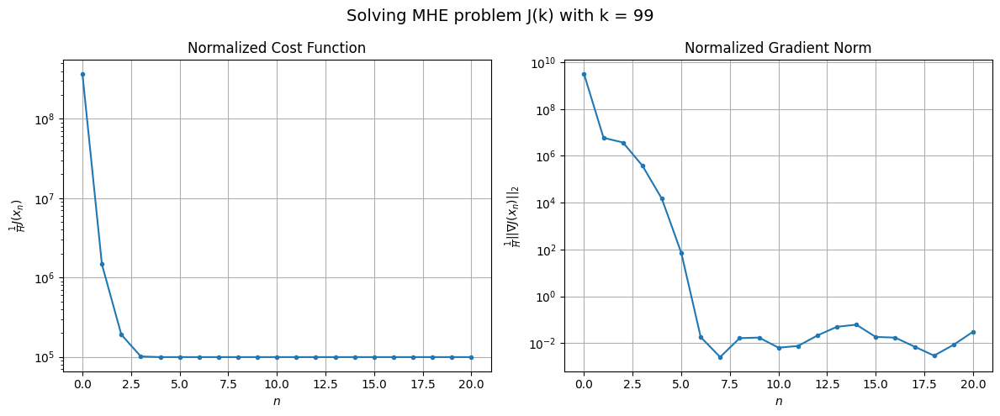

Windows:   0%|          | 1/296 [00:52<4:19:07, 52.70s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10337674.63649289
Gradient norm: 3074377.112936173
Global estimation error: 80.74691926800482
Initial conditions estimation errors: 40.76497000568353 m, 39.99017499733115 m, 40.667769113026175 m, 40.06414435042796 m
Position estimation errors: 101.03318123943278 m, 100.57387525527484 m, 101.41095878388188 m, 101.26949143669968 m

[Gauss-Newton] Iteration 1
Cost function: 10324407.417358628 (-0.13%)
Gradient norm: 2470.0990495015367 (-99.92%)
Global estimation error: 84.00321622257124 (4.03%)
Initial conditions estimation errors: 42.51853950840019 m, 41.720650366454684 m, 42.34107972384731 m, 41.41577292994582 m
Position estimation errors: 99.35624999561348 m, 98.76447704193353 m, 99.61901753218494 m, 99.51130047220848 m

[Gauss-Newton] Iteration 2
Cost function: 10324407.417500956 (0.00%)
Gradient norm: 2.1293326979531684 (-99.91%)
Global estimation error: 84.00376105838542 (0.00%)
Initial conditions estimation errors: 42.5185

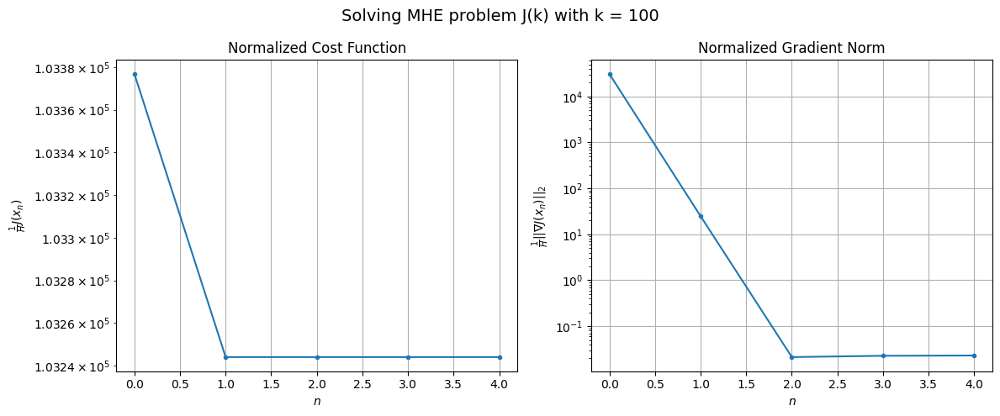

Windows:   1%|          | 2/296 [01:04<2:19:07, 28.39s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10774661.132821584
Gradient norm: 5351680.748158977
Global estimation error: 76.19106146539188
Initial conditions estimation errors: 38.54644937462196 m, 37.80423125218664 m, 38.38277460513825 m, 37.640384901679845 m
Position estimation errors: 103.85523272263978 m, 103.39967754034784 m, 104.12222372079685 m, 104.06708066266158 m

[Gauss-Newton] Iteration 1
Cost function: 10761421.478921754 (-0.12%)
Gradient norm: 2387.624131360967 (-99.96%)
Global estimation error: 79.3646797379066 (4.17%)
Initial conditions estimation errors: 40.10562121380997 m, 39.53980275624285 m, 39.98211226318614 m, 39.09309674567798 m
Position estimation errors: 102.09653560118115 m, 101.66182185836153 m, 102.39082973127589 m, 102.22081672383094 m

[Gauss-Newton] Iteration 2
Cost function: 10761421.479136698 (0.00%)
Gradient norm: 2.8615990319938085 (-99.88%)
Global estimation error: 79.36467010929927 (-0.00%)
Initial conditions estimation errors: 40.1

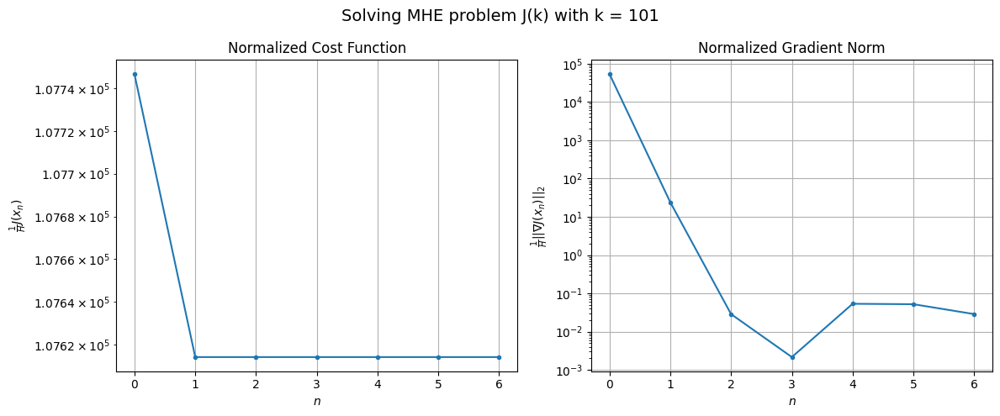

Windows:   1%|          | 3/296 [01:20<1:51:43, 22.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11248392.49958077
Gradient norm: 7963189.922554645
Global estimation error: 71.62466749993584
Initial conditions estimation errors: 36.17631867452288 m, 35.66199556415955 m, 36.06658966583198 m, 35.33762121856696 m
Position estimation errors: 106.59092853709868 m, 106.28685581010258 m, 106.88617642614832 m, 106.77832745318037 m

[Gauss-Newton] Iteration 1
Cost function: 11235046.319700234 (-0.12%)
Gradient norm: 2341.908959285983 (-99.97%)
Global estimation error: 74.39201016584661 (3.86%)
Initial conditions estimation errors: 37.61034963569647 m, 37.27159412326933 m, 37.50746758428911 m, 36.38139644243911 m
Position estimation errors: 104.74581369192941 m, 104.60036328615898 m, 105.02372002036098 m, 104.90139781000286 m

[Gauss-Newton] Iteration 2
Cost function: 11235046.319985539 (0.00%)
Gradient norm: 1.047443058497487 (-99.96%)
Global estimation error: 74.391910423189 (-0.00%)
Initial conditions estimation errors: 37.61034

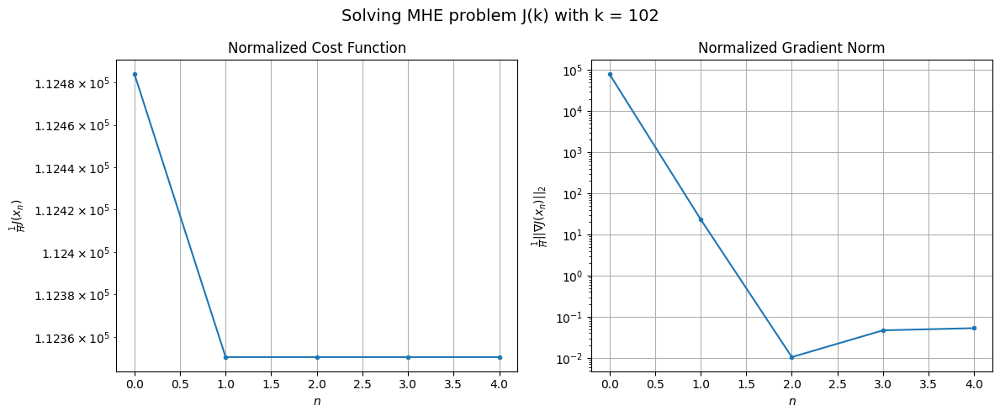

Windows:   1%|▏         | 4/296 [01:32<1:30:20, 18.56s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11759645.381168578
Gradient norm: 11535362.336975284
Global estimation error: 66.75808274888001
Initial conditions estimation errors: 33.73089614835808 m, 33.45376032579481 m, 33.64237516838293 m, 32.678294673465224 m
Position estimation errors: 109.21549561923801 m, 109.1966943532685 m, 109.48634712537229 m, 109.4252518386342 m

[Gauss-Newton] Iteration 1
Cost function: 11745807.282858996 (-0.12%)
Gradient norm: 2351.3477354333854 (-99.98%)
Global estimation error: 69.37644920036591 (3.92%)
Initial conditions estimation errors: 35.118444518645994 m, 34.836005157096395 m, 34.87347267828289 m, 33.91230591060451 m
Position estimation errors: 107.25422059009385 m, 107.12417696560402 m, 107.56737431892705 m, 107.4785884787856 m

[Gauss-Newton] Iteration 2
Cost function: 11745807.282980414 (0.00%)
Gradient norm: 7.807364774543697 (-99.67%)
Global estimation error: 69.37645934004101 (0.00%)
Initial conditions estimation errors: 35.1

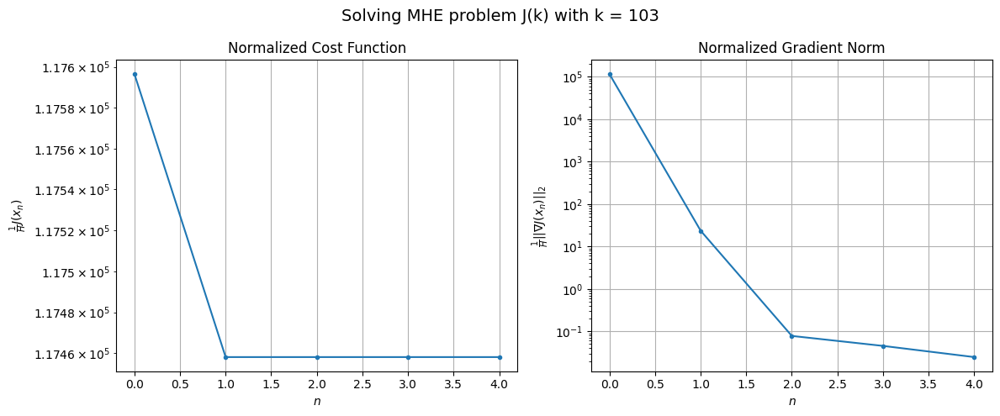

Windows:   2%|▏         | 5/296 [01:44<1:18:25, 16.17s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12307407.997763712
Gradient norm: 15703124.672347326
Global estimation error: 61.90412549473496
Initial conditions estimation errors: 31.319243866681035 m, 31.095581192122886 m, 31.10743838849081 m, 30.275249771810696 m
Position estimation errors: 111.76382621423343 m, 111.76620817400006 m, 112.07808462610728 m, 112.04732182719815 m

[Gauss-Newton] Iteration 1
Cost function: 12292774.888093999 (-0.12%)
Gradient norm: 2378.355408464152 (-99.98%)
Global estimation error: 64.8625621751999 (4.78%)
Initial conditions estimation errors: 32.7611214387947 m, 32.691616966839426 m, 32.72869252319579 m, 31.526544387115514 m
Position estimation errors: 109.66814339357414 m, 109.8836857167788 m, 110.01429947723034 m, 110.06490942118559 m

[Gauss-Newton] Iteration 2
Cost function: 12292774.888120161 (0.00%)
Gradient norm: 4.057296017712321 (-99.83%)
Global estimation error: 64.8625463385584 (-0.00%)
Initial conditions estimation errors: 32.

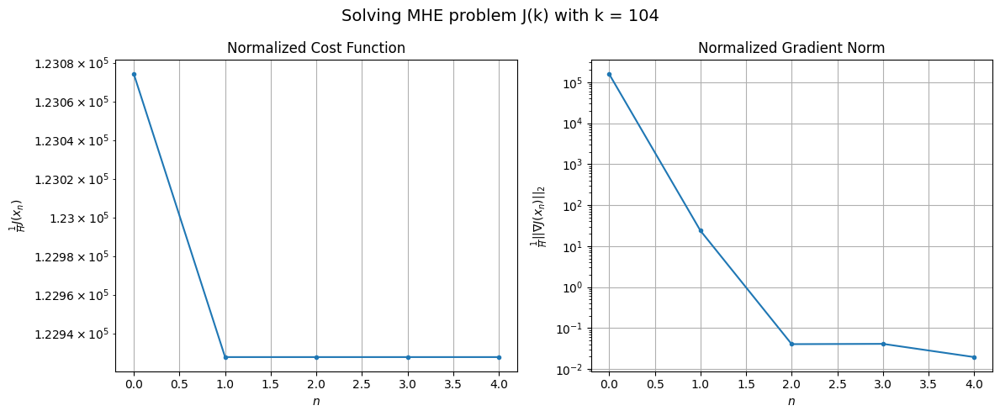

Windows:   2%|▏         | 6/296 [01:56<1:11:05, 14.71s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12895124.434865216
Gradient norm: 20036483.151588287
Global estimation error: 57.58482209150792
Initial conditions estimation errors: 29.06541826688564 m, 29.061217855359143 m, 29.050528136355613 m, 27.976840586123974 m
Position estimation errors: 114.33945435049941 m, 114.67678790186865 m, 114.67173987016224 m, 114.77891785971572 m

[Gauss-Newton] Iteration 1
Cost function: 12879306.024195315 (-0.12%)
Gradient norm: 2463.148365669063 (-99.99%)
Global estimation error: 61.02072997095308 (5.97%)
Initial conditions estimation errors: 30.671098801720326 m, 30.720825557840246 m, 30.678303092074795 m, 29.96434890138818 m
Position estimation errors: 112.08437559933176 m, 112.16187196400965 m, 112.38069508311283 m, 112.48615531361767 m

[Gauss-Newton] Iteration 2
Cost function: 12879306.023716262 (-0.00%)
Gradient norm: 1.4153127448271123 (-99.94%)
Global estimation error: 61.02064928383127 (-0.00%)
Initial conditions estimation erro

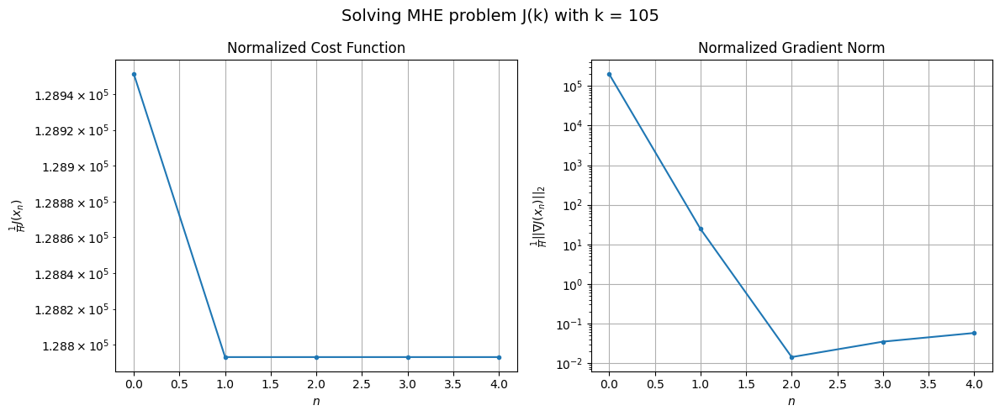

Windows:   2%|▏         | 7/296 [02:08<1:07:04, 13.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13517228.944990698
Gradient norm: 25024473.468813654
Global estimation error: 53.96747827350363
Initial conditions estimation errors: 27.10487716692609 m, 27.20065877589666 m, 27.127804441300576 m, 26.49533182785102 m
Position estimation errors: 117.02249385818217 m, 117.22107216902359 m, 117.31576812182352 m, 117.46693812836297 m

[Gauss-Newton] Iteration 1
Cost function: 13499875.167366084 (-0.13%)
Gradient norm: 2626.4350664738367 (-99.99%)
Global estimation error: 57.782540214260436 (7.07%)
Initial conditions estimation errors: 28.999022181607845 m, 29.093063569570706 m, 29.0130065611001 m, 28.455197202939107 m
Position estimation errors: 114.59164599779864 m, 114.5958172482836 m, 114.86887101363737 m, 115.04222986920094 m

[Gauss-Newton] Iteration 2
Cost function: 13499875.16696696 (-0.00%)
Gradient norm: 3.557946099085906 (-99.86%)
Global estimation error: 57.78245538036244 (-0.00%)
Initial conditions estimation errors: 

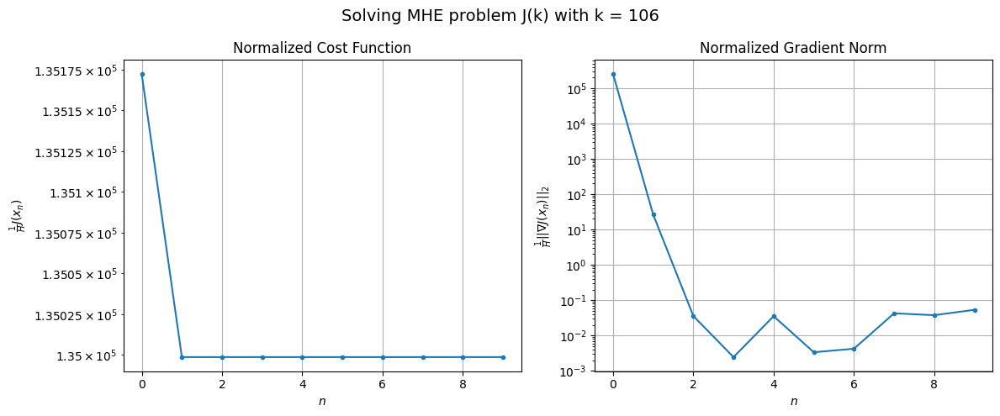

Windows:   3%|▎         | 8/296 [02:30<1:19:44, 16.61s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14177305.78881968
Gradient norm: 29475469.647153392
Global estimation error: 51.04132486510507
Initial conditions estimation errors: 25.596447148496175 m, 25.727225726474263 m, 25.62742559079876 m, 25.12704153266629 m
Position estimation errors: 119.81767073214871 m, 119.94680004259737 m, 120.09190869277253 m, 120.30561706084893 m

[Gauss-Newton] Iteration 1
Cost function: 14158228.964607418 (-0.13%)
Gradient norm: 2792.7584031387155 (-99.99%)
Global estimation error: 55.61565615647913 (8.96%)
Initial conditions estimation errors: 27.866895945027817 m, 27.99705178850533 m, 27.789091574906944 m, 27.576295012405062 m
Position estimation errors: 117.20293574418037 m, 117.28518499837341 m, 117.58757509068136 m, 117.78205251244115 m

[Gauss-Newton] Iteration 2
Cost function: 14158228.964924557 (0.00%)
Gradient norm: 0.5711310056942768 (-99.98%)
Global estimation error: 55.61561547531921 (-0.00%)
Initial conditions estimation errors

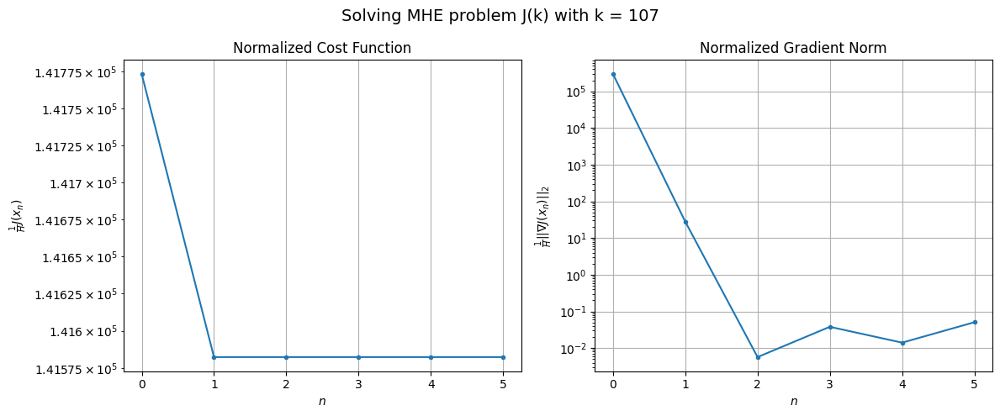

Windows:   3%|▎         | 9/296 [02:45<1:16:01, 15.90s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14871840.69222921
Gradient norm: 33970089.586002775
Global estimation error: 49.15642060916346
Initial conditions estimation errors: 24.609689576104564 m, 24.76984465862637 m, 24.55645983044493 m, 24.374939729898074 m
Position estimation errors: 122.65107457840584 m, 122.86280159676316 m, 123.04034792119893 m, 123.26634853978135 m

[Gauss-Newton] Iteration 1
Cost function: 14850667.841868646 (-0.14%)
Gradient norm: 3016.5379761093436 (-99.99%)
Global estimation error: 54.559540508641575 (10.99%)
Initial conditions estimation errors: 27.352956267310557 m, 27.407457368828954 m, 27.34802532259424 m, 27.008525150491106 m
Position estimation errors: 119.83950736230186 m, 120.08220686281658 m, 120.24285610250182 m, 120.42248844679851 m

[Gauss-Newton] Iteration 2
Cost function: 14850667.841814443 (-0.00%)
Gradient norm: 5.173194618636127 (-99.83%)
Global estimation error: 54.559520501555276 (-0.00%)
Initial conditions estimation err

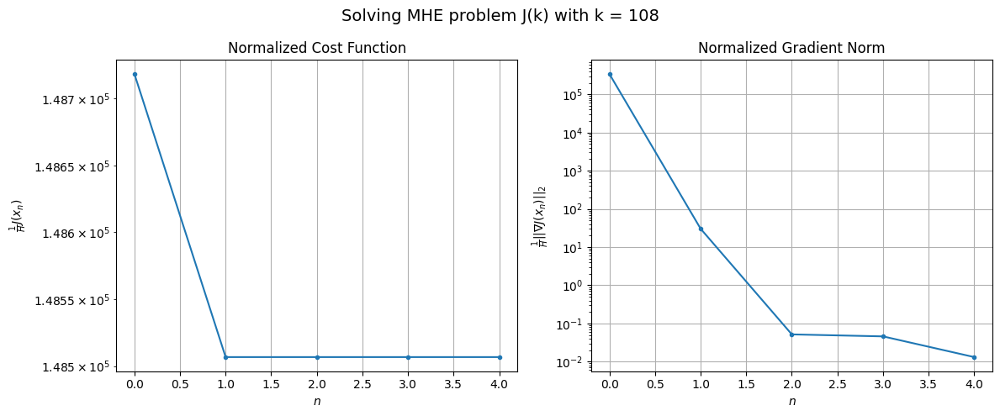

Windows:   3%|▎         | 10/296 [02:56<1:09:22, 14.55s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15597129.497521063
Gradient norm: 38189727.05741872
Global estimation error: 48.15617253326096
Initial conditions estimation errors: 24.12923933485634 m, 24.204407281993742 m, 24.14223521668388 m, 23.834465903942096 m
Position estimation errors: 125.41453325841022 m, 125.7896057800816 m, 125.81797010161094 m, 126.04144346631973 m

[Gauss-Newton] Iteration 1
Cost function: 15573613.897022542 (-0.15%)
Gradient norm: 3259.5104965355417 (-99.99%)
Global estimation error: 54.68922269093906 (13.57%)
Initial conditions estimation errors: 27.38506324555175 m, 27.48209046282602 m, 27.358195892580426 m, 27.1517523429217 m
Position estimation errors: 122.3988800553667 m, 122.75238308375715 m, 122.70678809613966 m, 122.91218317133053 m

[Gauss-Newton] Iteration 2
Cost function: 15573613.89719512 (0.00%)
Gradient norm: 4.057781184385518 (-99.88%)
Global estimation error: 54.68922116142482 (-0.00%)
Initial conditions estimation errors: 27.3

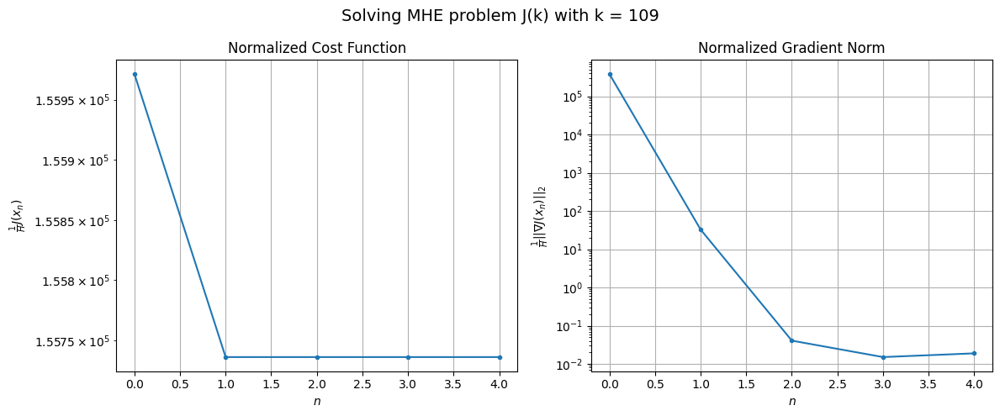

Windows:   4%|▎         | 11/296 [03:08<1:05:02, 13.69s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 16355890.693457628
Gradient norm: 42822856.55440531
Global estimation error: 48.150951349583
Initial conditions estimation errors: 24.100387697685168 m, 24.19957065494782 m, 24.0924147938058 m, 23.908321394328652 m
Position estimation errors: 128.03252579492292 m, 128.51804738384166 m, 128.35210959528263 m, 128.60234278325441 m

[Gauss-Newton] Iteration 1
Cost function: 16329948.860386983 (-0.16%)
Gradient norm: 3501.0139520708326 (-99.99%)
Global estimation error: 55.564009445178726 (15.40%)
Initial conditions estimation errors: 27.82972093714664 m, 27.820036672874668 m, 27.85944270162979 m, 27.617882864741492 m
Position estimation errors: 124.80667082504276 m, 125.51595582737572 m, 125.18815625528948 m, 125.54347030750667 m

[Gauss-Newton] Iteration 2
Cost function: 16329948.86040829 (0.00%)
Gradient norm: 0.8842824470855 (-99.97%)
Global estimation error: 55.56391467833088 (-0.00%)
Initial conditions estimation errors: 27.8

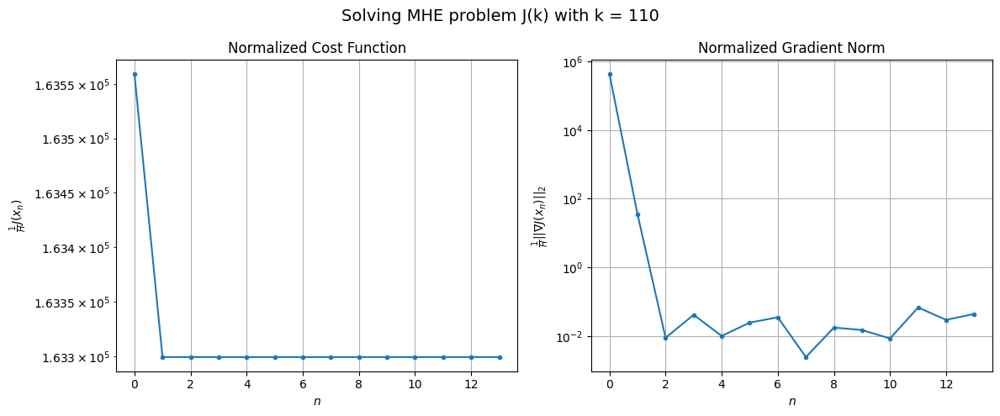

Windows:   4%|▍         | 12/296 [03:40<1:30:55, 19.21s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 17143676.85257899
Gradient norm: 47591251.4448639
Global estimation error: 49.007310001158295
Initial conditions estimation errors: 24.55141033132152 m, 24.517521321928793 m, 24.589123547359872 m, 24.355658141579397 m
Position estimation errors: 130.46134643022097 m, 131.28609092072082 m, 130.850972689597 m, 131.24192534752171 m

[Gauss-Newton] Iteration 1
Cost function: 17115202.39112096 (-0.17%)
Gradient norm: 3757.9087922905023 (-99.99%)
Global estimation error: 57.41485493497261 (17.16%)
Initial conditions estimation errors: 28.72176269680005 m, 28.844681026884334 m, 28.83247527657889 m, 28.428587673589885 m
Position estimation errors: 127.0232403510979 m, 127.72588953683048 m, 127.45574271708375 m, 127.87434101295187 m

[Gauss-Newton] Iteration 2
Cost function: 17115202.39100728 (-0.00%)
Gradient norm: 4.061574092359082 (-99.89%)
Global estimation error: 57.414999093484504 (0.00%)
Initial conditions estimation errors: 28.

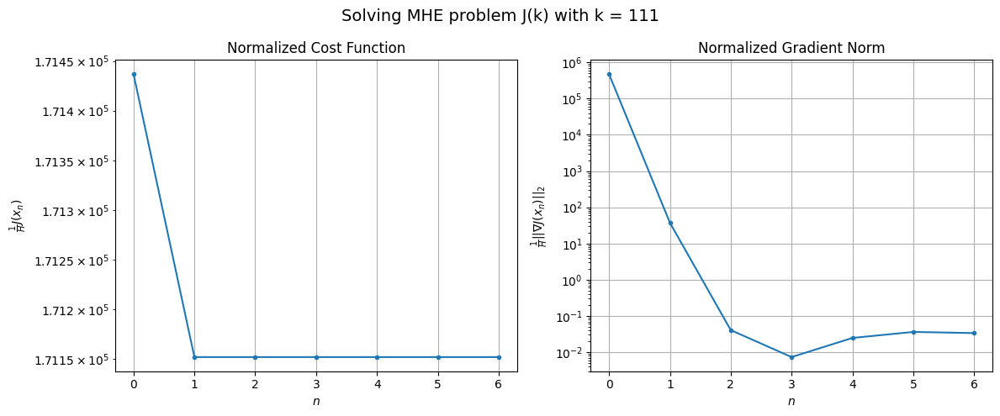

Windows:   4%|▍         | 13/296 [03:56<1:26:50, 18.41s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 17952061.879762996
Gradient norm: 52318924.308788955
Global estimation error: 51.2105102617255
Initial conditions estimation errors: 25.63194042321149 m, 25.71195170484606 m, 25.735831293910884 m, 25.339134714454804 m
Position estimation errors: 132.67349697956683 m, 133.4934423607424 m, 133.10561862656638 m, 133.5603273340702 m

[Gauss-Newton] Iteration 1
Cost function: 17921066.557056505 (-0.17%)
Gradient norm: 3988.914429410936 (-99.99%)
Global estimation error: 60.32747339512616 (17.80%)
Initial conditions estimation errors: 30.166124189011036 m, 30.224254839643137 m, 30.08973924102475 m, 30.174477174636504 m
Position estimation errors: 129.0249846844169 m, 129.9258240185218 m, 129.6326034171381 m, 129.9549962623674 m

[Gauss-Newton] Iteration 2
Cost function: 17921066.55775093 (0.00%)
Gradient norm: 4.401216296896952 (-99.89%)
Global estimation error: 60.32730732543238 (-0.00%)
Initial conditions estimation errors: 30.166

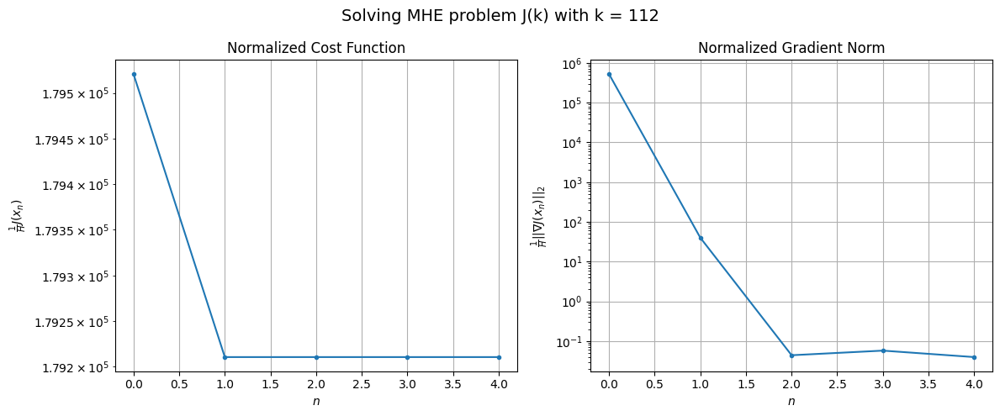

Windows:   5%|▍         | 14/296 [04:09<1:17:52, 16.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 18780498.98683695
Gradient norm: 57384302.097693466
Global estimation error: 54.69781475267495
Initial conditions estimation errors: 27.379455343260453 m, 27.374821020427145 m, 27.28446672516102 m, 27.356621486094678 m
Position estimation errors: 134.6720719769852 m, 135.67751791463314 m, 135.28847769258982 m, 135.63945475884245 m

[Gauss-Newton] Iteration 1
Cost function: 18746627.084373873 (-0.18%)
Gradient norm: 4257.194583783146 (-99.99%)
Global estimation error: 64.59108200255919 (18.09%)
Initial conditions estimation errors: 32.23252550068945 m, 32.273349749450894 m, 32.3897983603183 m, 32.28613172131487 m
Position estimation errors: 130.79772958539354 m, 131.50800737647765 m, 131.1293231094322 m, 131.59766397311 m

[Gauss-Newton] Iteration 2
Cost function: 18746627.085258655 (0.00%)
Gradient norm: 0.6290175996030427 (-99.99%)
Global estimation error: 64.59149322606699 (0.00%)
Initial conditions estimation errors: 32.232

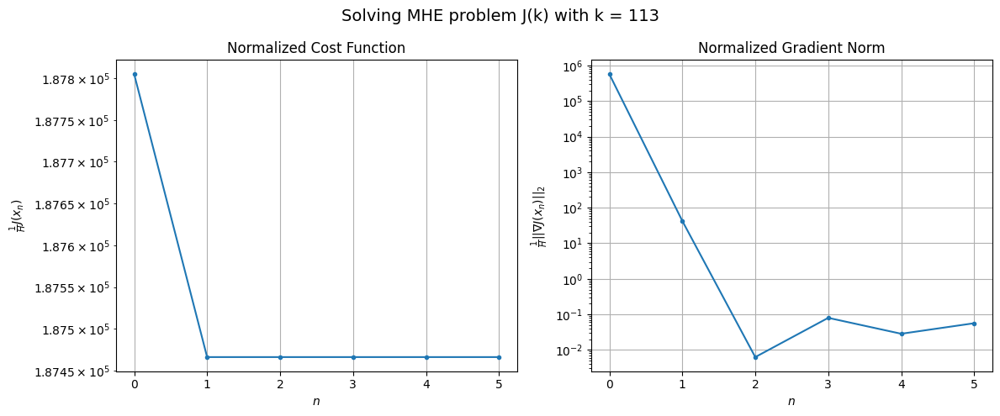

Windows:   5%|▌         | 15/296 [04:23<1:14:29, 15.91s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 19625240.842268758
Gradient norm: 61930854.79615057
Global estimation error: 59.50715315799033
Initial conditions estimation errors: 29.719072471524793 m, 29.702285237155955 m, 29.851348667184425 m, 29.741255217734707 m
Position estimation errors: 136.4987061982959 m, 137.3196069067521 m, 136.8448078397727 m, 137.33848912016492 m

[Gauss-Newton] Iteration 1
Cost function: 19588639.766966015 (-0.19%)
Gradient norm: 4509.766297253357 (-99.99%)
Global estimation error: 69.85768066270761 (17.39%)
Initial conditions estimation errors: 34.797638033566805 m, 34.86709580451679 m, 35.015807033218856 m, 35.03413819937141 m
Position estimation errors: 132.40633104531847 m, 133.1951644197845 m, 132.679947671761 m, 133.18560252812188 m

[Gauss-Newton] Iteration 2
Cost function: 19588639.766516887 (-0.00%)
Gradient norm: 1.253128562873038 (-99.97%)
Global estimation error: 69.85769594428442 (0.00%)
Initial conditions estimation errors: 34.7

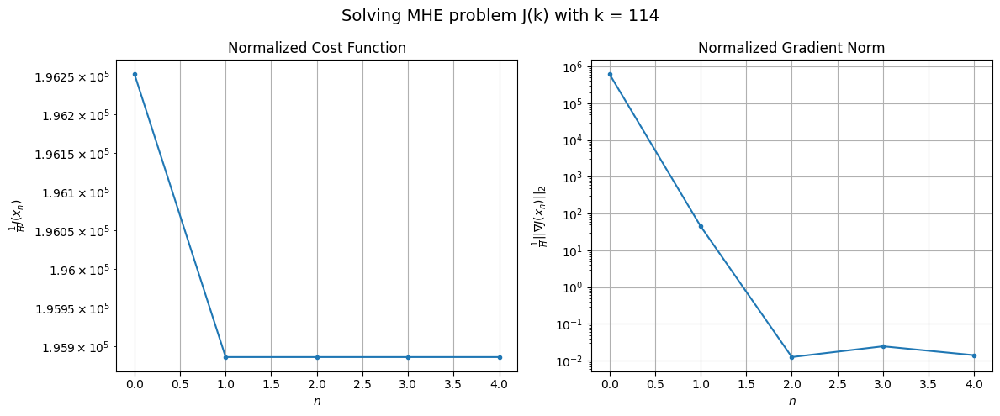

Windows:   5%|▌         | 16/296 [04:36<1:09:47, 14.95s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 20484804.301695887
Gradient norm: 67201896.18395698
Global estimation error: 65.09837757599196
Initial conditions estimation errors: 32.453775136423126 m, 32.457743636204896 m, 32.63829395972503 m, 32.64631599338188 m
Position estimation errors: 138.26278555924696 m, 139.15230337185412 m, 138.55679416481024 m, 139.07681180089418 m

[Gauss-Newton] Iteration 1
Cost function: 20444773.019047923 (-0.20%)
Gradient norm: 4865.2628759345 (-99.99%)
Global estimation error: 75.60178927378674 (16.13%)
Initial conditions estimation errors: 37.777621623565985 m, 37.67985032101459 m, 37.70419774271647 m, 38.04073203369872 m
Position estimation errors: 133.9214207935804 m, 134.71573541653538 m, 134.43192739491306 m, 134.84686885365298 m

[Gauss-Newton] Iteration 2
Cost function: 20444773.0194557 (0.00%)
Gradient norm: 3.4754699847499464 (-99.93%)
Global estimation error: 75.60184076630345 (0.00%)
Initial conditions estimation errors: 37.777

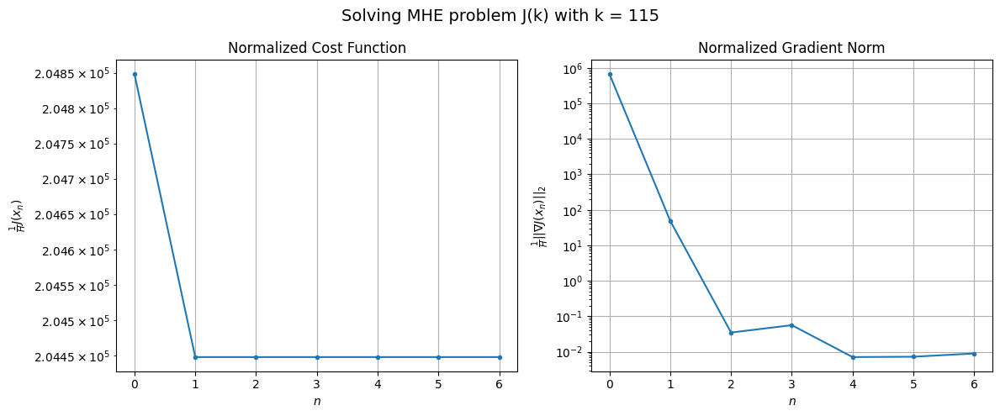

Windows:   6%|▌         | 17/296 [04:52<1:11:52, 15.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 21354472.472348135
Gradient norm: 71839413.29446752
Global estimation error: 70.94976036319157
Initial conditions estimation errors: 35.48285093903213 m, 35.334562237402665 m, 35.38393123980063 m, 35.69700575080316 m
Position estimation errors: 140.009365834035 m, 140.9018287572892 m, 140.5438169179834 m, 140.96095713011067 m

[Gauss-Newton] Iteration 1
Cost function: 21311221.49789123 (-0.20%)
Gradient norm: 5194.515668511084 (-99.99%)
Global estimation error: 82.11498608924524 (15.74%)
Initial conditions estimation errors: 41.004509241097374 m, 40.85240411679105 m, 41.03635340244858 m, 41.33513269478884 m
Position estimation errors: 135.43260194015105 m, 136.38975483105602 m, 135.95888318880807 m, 136.42079174247445 m

[Gauss-Newton] Iteration 2
Cost function: 21311221.49753888 (-0.00%)
Gradient norm: 4.323776982191564 (-99.92%)
Global estimation error: 82.11484210343669 (-0.00%)
Initial conditions estimation errors: 41.0044

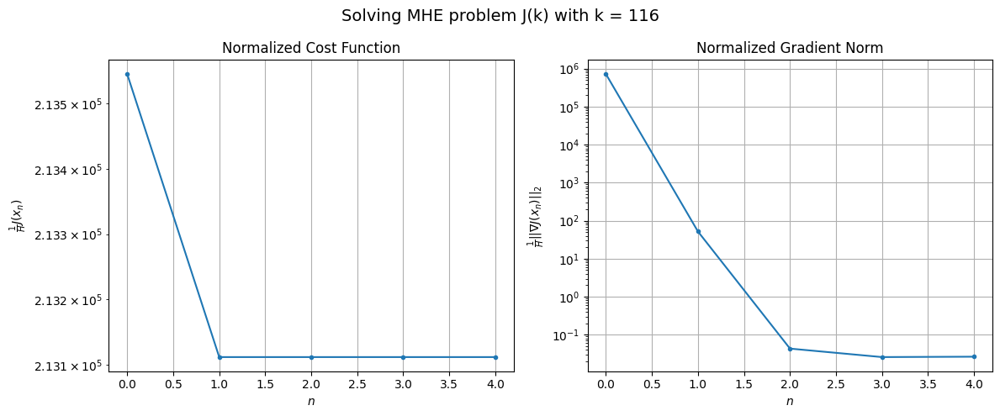

Windows:   6%|▌         | 18/296 [05:05<1:07:32, 14.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 22229892.46546915
Gradient norm: 76743196.1446345
Global estimation error: 77.34207634366655
Initial conditions estimation errors: 38.649611648499054 m, 38.45096615794209 m, 38.649839331765556 m, 38.932135090254185 m
Position estimation errors: 141.74902806649678 m, 142.78822157161449 m, 142.2871161645384 m, 142.74987581933664 m

[Gauss-Newton] Iteration 1
Cost function: 22183157.82456591 (-0.21%)
Gradient norm: 5538.323455845548 (-99.99%)
Global estimation error: 89.12009994100323 (15.23%)
Initial conditions estimation errors: 44.37810307353182 m, 44.616479551883934 m, 44.48172970633526 m, 44.762866161681856 m
Position estimation errors: 136.92989133830898 m, 137.48255486202177 m, 137.35091771987572 m, 137.79995762431284 m

[Gauss-Newton] Iteration 2
Cost function: 22183157.825319048 (0.00%)
Gradient norm: 0.9820221430972276 (-99.98%)
Global estimation error: 89.12065320644261 (0.00%)
Initial conditions estimation errors: 44.

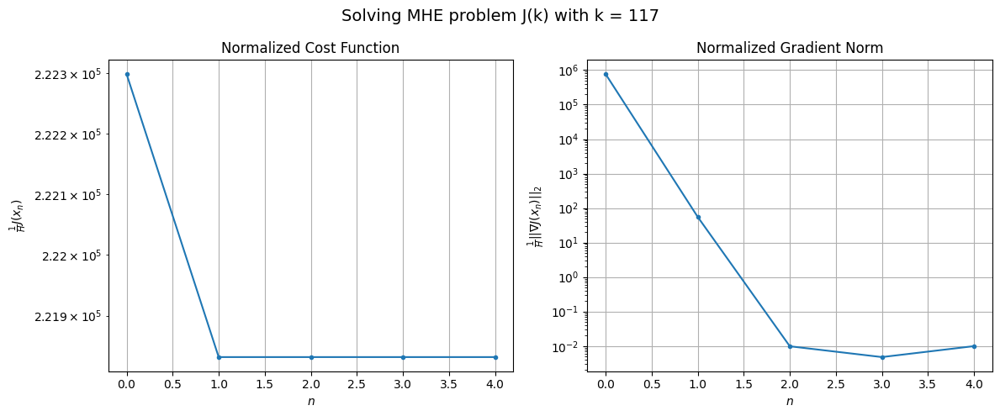

Windows:   6%|▋         | 19/296 [05:17<1:03:57, 13.85s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 23111987.23915547
Gradient norm: 81648307.66107643
Global estimation error: 84.09436219230346
Initial conditions estimation errors: 41.8998047366194 m, 42.074413436682356 m, 41.97163320625411 m, 42.24199815012749 m
Position estimation errors: 143.39164890230225 m, 144.0393579592392 m, 143.82419927542048 m, 144.27630339794746 m

[Gauss-Newton] Iteration 1
Cost function: 23061516.77262526 (-0.22%)
Gradient norm: 5980.198921100822 (-99.99%)
Global estimation error: 95.96313329562615 (14.11%)
Initial conditions estimation errors: 47.847209754198566 m, 47.906358323838106 m, 47.992946286075494 m, 48.17900665686065 m
Position estimation errors: 138.32674472401334 m, 139.153883806635 m, 138.78739564841834 m, 139.2860837544427 m

[Gauss-Newton] Iteration 2
Cost function: 23061516.77184966 (-0.00%)
Gradient norm: 0.8632534560270863 (-99.99%)
Global estimation error: 95.96288274751814 (-0.00%)
Initial conditions estimation errors: 47.847

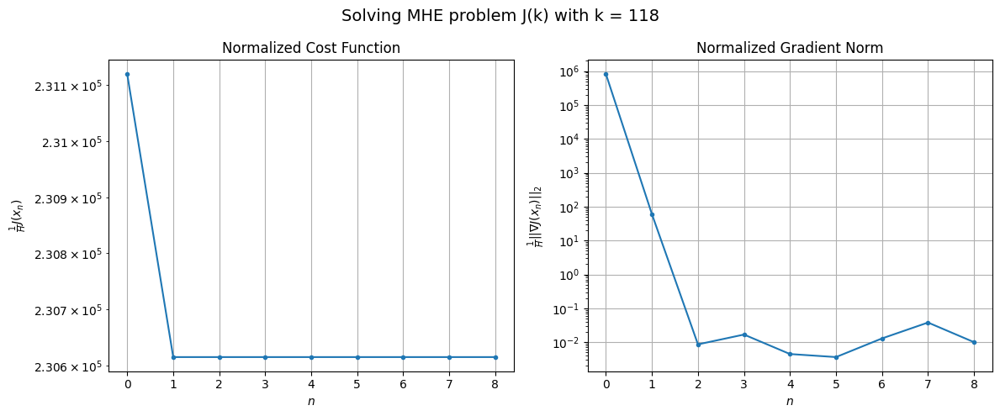

Windows:   7%|▋         | 20/296 [05:39<1:14:30, 16.20s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 23994206.583913732
Gradient norm: 86275082.50538535
Global estimation error: 90.69090344514971
Initial conditions estimation errors: 45.2360412422923 m, 45.25085879971243 m, 45.35460514348987 m, 45.53955398301898 m
Position estimation errors: 144.8081258685844 m, 145.7084485437832 m, 145.2627429797743 m, 145.7688397758099 m

[Gauss-Newton] Iteration 1
Cost function: 23939792.035483878 (-0.23%)
Gradient norm: 6444.192113754444 (-99.99%)
Global estimation error: 102.99381474913174 (13.57%)
Initial conditions estimation errors: 51.41804745362569 m, 51.34909054639901 m, 51.50139658507608 m, 51.71824361774432 m
Position estimation errors: 139.501226089762 m, 140.4081295507545 m, 140.03200437151213 m, 140.48602270093335 m

[Gauss-Newton] Iteration 2
Cost function: 23939792.03539385 (-0.00%)
Gradient norm: 2.2531713639128044 (-99.97%)
Global estimation error: 102.99375269571999 (-0.00%)
Initial conditions estimation errors: 51.418023

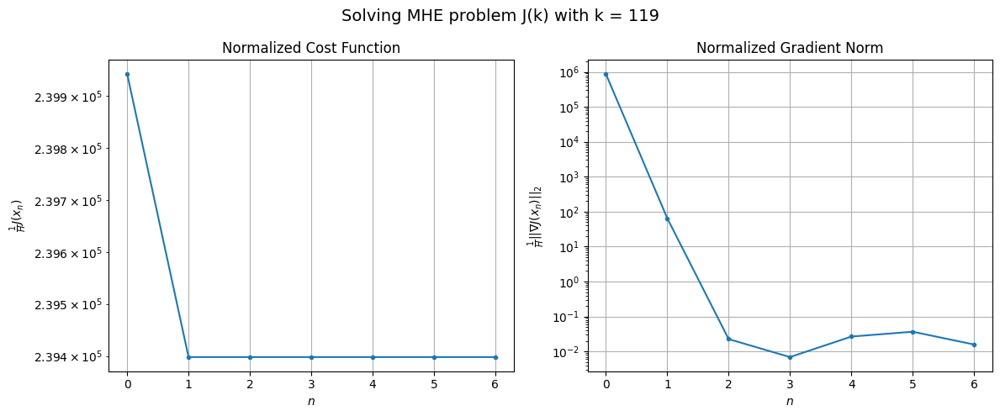

Windows:   7%|▋         | 21/296 [05:56<1:15:17, 16.43s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 24870055.09938537
Gradient norm: 88970202.57621534
Global estimation error: 97.42814058349383
Initial conditions estimation errors: 48.64971980413659 m, 48.554207545094926 m, 48.71677844571455 m, 48.93464674537217 m
Position estimation errors: 145.85359897129945 m, 146.82817029395596 m, 146.37104214295815 m, 146.84037501255446 m

[Gauss-Newton] Iteration 1
Cost function: 24812228.309359547 (-0.23%)
Gradient norm: 6893.334065573621 (-99.99%)
Global estimation error: 109.8439212112131 (12.74%)
Initial conditions estimation errors: 55.05248251992118 m, 54.69318693179868 m, 55.08155227074515 m, 54.85959697589767 m
Position estimation errors: 140.34797990189432 m, 141.47685055685693 m, 140.82820312242507 m, 141.57219760461967 m

[Gauss-Newton] Iteration 2
Cost function: 24812228.308173213 (-0.00%)
Gradient norm: 1.496886071755324 (-99.98%)
Global estimation error: 109.84372336850099 (-0.00%)
Initial conditions estimation errors: 55

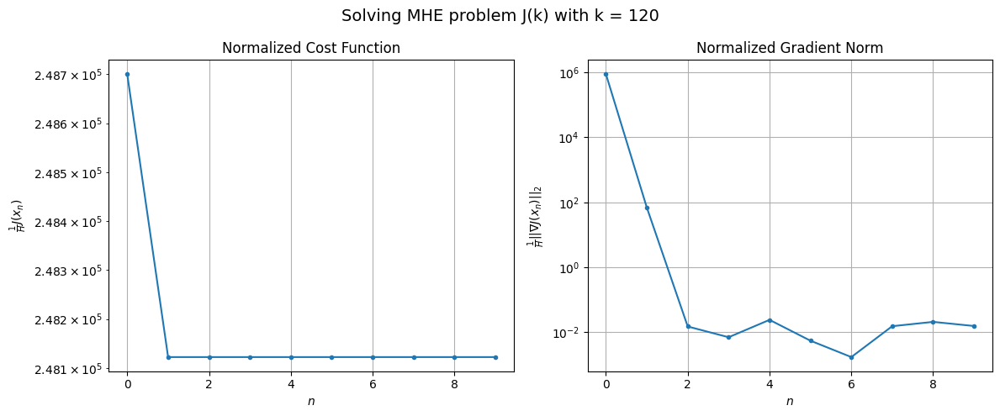

Windows:   7%|▋         | 22/296 [06:19<1:24:19, 18.47s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 25730019.987459313
Gradient norm: 90902818.21573046
Global estimation error: 103.8040443245795
Initial conditions estimation errors: 52.02259399551633 m, 51.6647644852066 m, 52.055347231646834 m, 51.864295265166994 m
Position estimation errors: 146.39376792484845 m, 147.57656942828558 m, 146.84513034929574 m, 147.60161564612955 m

[Gauss-Newton] Iteration 1
Cost function: 25669032.039171945 (-0.24%)
Gradient norm: 7372.661636593625 (-99.99%)
Global estimation error: 117.03125818778756 (12.74%)
Initial conditions estimation errors: 58.6576284652597 m, 58.343944367097144 m, 58.616014216499806 m, 58.444209556801646 m
Position estimation errors: 140.72149717757807 m, 141.9387308856393 m, 141.38750552897372 m, 142.13553513051176 m

[Gauss-Newton] Iteration 2
Cost function: 25669032.03953318 (0.00%)
Gradient norm: 2.073371232572083 (-99.97%)
Global estimation error: 117.03122606156055 (-0.00%)
Initial conditions estimation errors: 5

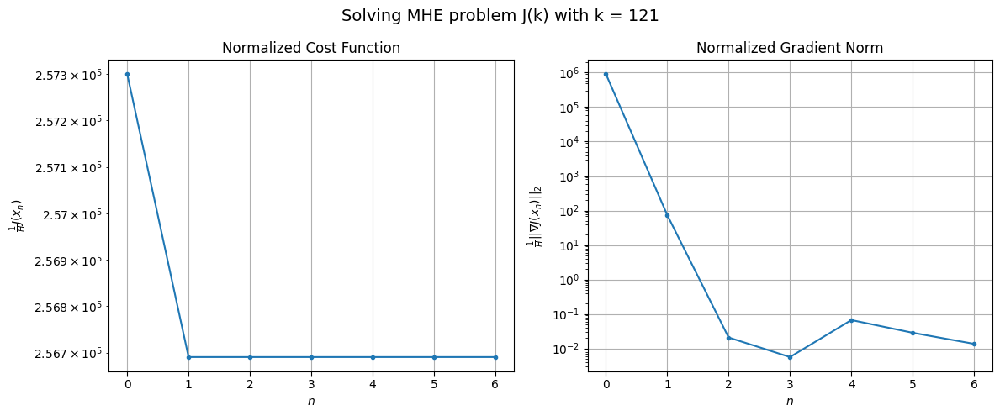

Windows:   8%|▊         | 23/296 [06:36<1:22:17, 18.09s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 26565770.003010772
Gradient norm: 92105939.36762632
Global estimation error: 110.17334642532995
Initial conditions estimation errors: 55.2071480761138 m, 54.90249546942562 m, 55.187081151970546 m, 55.049198016864416 m
Position estimation errors: 146.2490128407571 m, 147.5151823382552 m, 146.8837906522253 m, 147.64639742713143 m

[Gauss-Newton] Iteration 1
Cost function: 26501661.356926233 (-0.24%)
Gradient norm: 7900.846763713698 (-99.99%)
Global estimation error: 124.12061643620332 (12.66%)
Initial conditions estimation errors: 62.10540835295944 m, 61.84537518057516 m, 62.25967722285027 m, 62.02983064650254 m
Position estimation errors: 140.43706457482074 m, 141.67665285464548 m, 140.90121735316237 m, 141.77134773008348 m

[Gauss-Newton] Iteration 2
Cost function: 26501661.357381478 (0.00%)
Gradient norm: 2.4519743233196114 (-99.97%)
Global estimation error: 124.12058371090833 (-0.00%)
Initial conditions estimation errors: 62

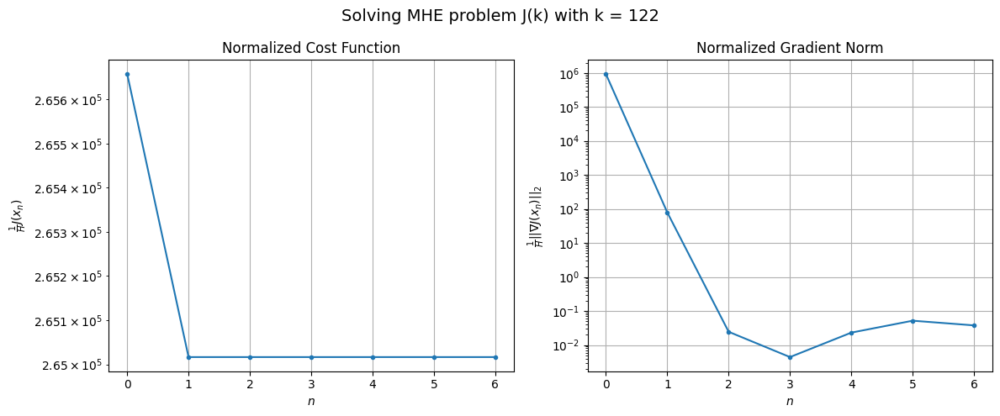

Windows:   8%|▊         | 24/296 [06:53<1:20:43, 17.81s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 27362416.78055736
Gradient norm: 92233812.40160139
Global estimation error: 116.15597795456003
Initial conditions estimation errors: 58.09797644087365 m, 57.852274719203365 m, 58.27405687739822 m, 58.086572246847396 m
Position estimation errors: 145.23160461137292 m, 146.51438945953862 m, 145.658068893861 m, 146.55158688946565 m

[Gauss-Newton] Iteration 1
Cost function: 27295953.175967284 (-0.24%)
Gradient norm: 8390.792203135192 (-99.99%)
Global estimation error: 130.5028181963009 (12.35%)
Initial conditions estimation errors: 65.2402208775632 m, 65.10301609282554 m, 65.36977287398746 m, 65.29203889594021 m
Position estimation errors: 139.33507657018814 m, 140.30134467460059 m, 139.6753318298702 m, 140.60879744562527 m

[Gauss-Newton] Iteration 2
Cost function: 27295953.176367972 (0.00%)
Gradient norm: 0.4698978643982911 (-99.99%)
Global estimation error: 130.5028146709929 (-0.00%)
Initial conditions estimation errors: 65.24

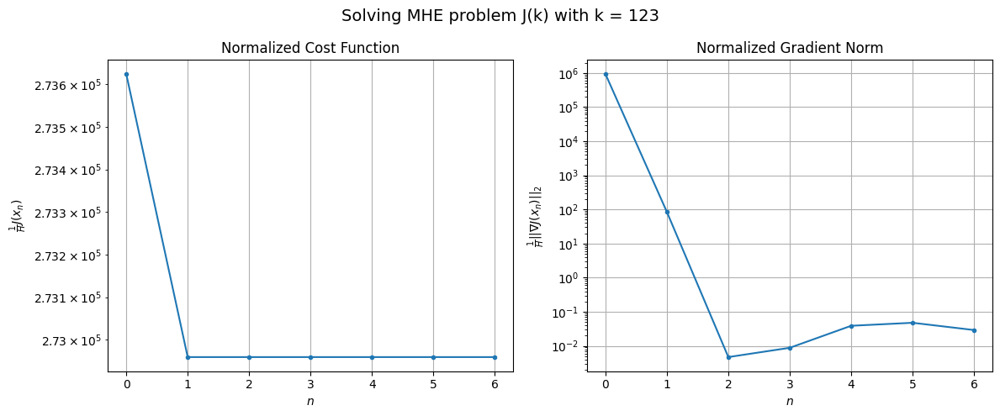

Windows:   8%|▊         | 25/296 [07:13<1:22:33, 18.28s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 28108547.27776751
Gradient norm: 91133490.67697033
Global estimation error: 121.26370414966654
Initial conditions estimation errors: 60.59298787367104 m, 60.46931084363929 m, 60.74666065511253 m, 60.71766064231928 m
Position estimation errors: 143.2313335983099 m, 144.23667500045468 m, 143.54694626983684 m, 144.4964930813263 m

[Gauss-Newton] Iteration 1
Cost function: 28040440.431524683 (-0.24%)
Gradient norm: 8878.778116516576 (-99.99%)
Global estimation error: 136.04406146619448 (12.19%)
Initial conditions estimation errors: 67.96174831766726 m, 67.92277626910979 m, 68.04267333984517 m, 68.16030050278546 m
Position estimation errors: 137.29700180635692 m, 138.06797202774342 m, 137.6333236673848 m, 138.45620734318595 m

[Gauss-Newton] Iteration 2
Cost function: 28040440.430410903 (-0.00%)
Gradient norm: 0.23011046933727658 (-100.00%)
Global estimation error: 136.04404179467025 (-0.00%)
Initial conditions estimation errors: 6

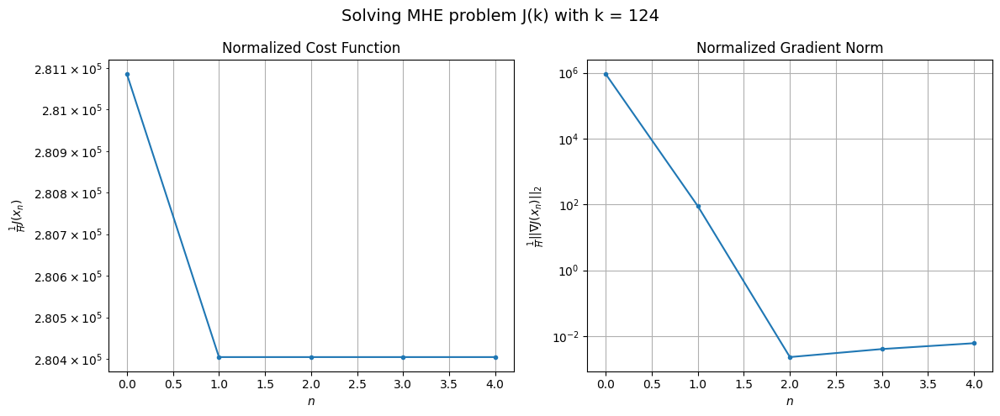

Windows:   9%|▉         | 26/296 [07:26<1:15:06, 16.69s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 28790782.356514674
Gradient norm: 89231063.72204116
Global estimation error: 125.42191826590481
Initial conditions estimation errors: 62.62297920043615 m, 62.59433709360299 m, 62.733108846687884 m, 62.89249121715113 m
Position estimation errors: 140.2117354596725 m, 141.0189820871529 m, 140.5327885461808 m, 141.37158184362386 m

[Gauss-Newton] Iteration 1
Cost function: 28722061.39226858 (-0.24%)
Gradient norm: 9279.834834945283 (-99.99%)
Global estimation error: 140.5650732059706 (12.07%)
Initial conditions estimation errors: 70.17448616570347 m, 70.14384125577111 m, 70.28953643260601 m, 70.5211849706481 m
Position estimation errors: 134.28995747868333 m, 134.90907198318416 m, 134.43085287783612 m, 135.3781271162657 m

[Gauss-Newton] Iteration 2
Cost function: 28722061.391608287 (-0.00%)
Gradient norm: 3.1488109511513214 (-99.97%)
Global estimation error: 140.56502432356524 (-0.00%)
Initial conditions estimation errors: 70.17

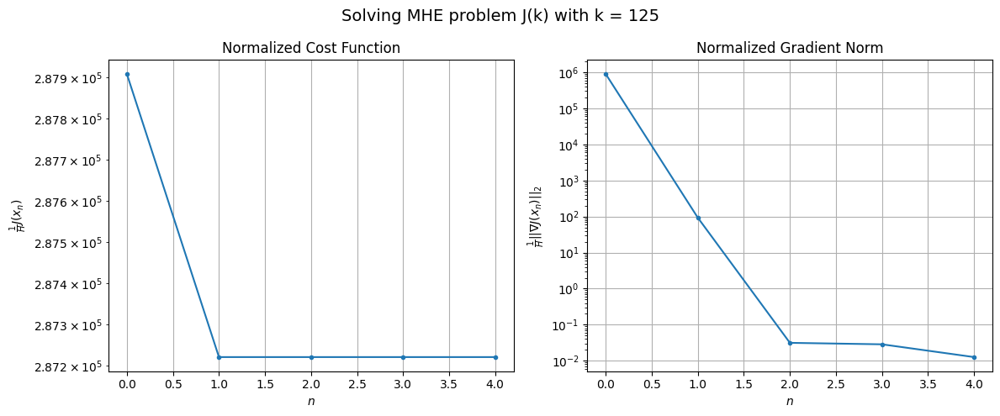

Windows:   9%|▉         | 27/296 [07:39<1:10:39, 15.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 29399254.936931994
Gradient norm: 87539573.99463314
Global estimation error: 128.51245762944964
Initial conditions estimation errors: 64.12063468832274 m, 64.10085660755003 m, 64.26171926741908 m, 64.54016943764076 m
Position estimation errors: 136.22729228504895 m, 136.882869574447 m, 136.3612858061523 m, 137.3126045798756 m

[Gauss-Newton] Iteration 1
Cost function: 29330491.422156572 (-0.23%)
Gradient norm: 9593.02652390374 (-99.99%)
Global estimation error: 144.01114343670903 (12.06%)
Initial conditions estimation errors: 71.82752195170966 m, 71.76815699503717 m, 71.81852157012435 m, 72.60418052873511 m
Position estimation errors: 130.34202107455656 m, 131.15437021234067 m, 130.64109061560777 m, 131.0524602424354 m

[Gauss-Newton] Iteration 2
Cost function: 29330491.42226903 (0.00%)
Gradient norm: 0.4515333291267679 (-100.00%)
Global estimation error: 144.0110811522902 (-0.00%)
Initial conditions estimation errors: 71.8274

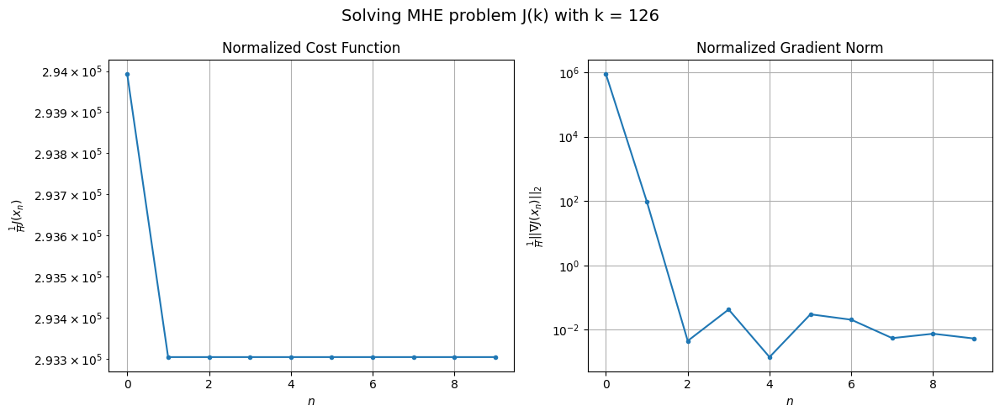

Windows:   9%|▉         | 28/296 [08:03<1:21:06, 18.16s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 29936514.166537944
Gradient norm: 85813435.50577244
Global estimation error: 130.59945901857094
Initial conditions estimation errors: 65.09940823963322 m, 65.06272089024435 m, 65.12318671333233 m, 65.90912584108783 m
Position estimation errors: 131.37980331994012 m, 132.23258897805707 m, 131.69204955543606 m, 132.11417935796058 m

[Gauss-Newton] Iteration 1
Cost function: 29868326.26669854 (-0.23%)
Gradient norm: 9846.807231282222 (-99.99%)
Global estimation error: 146.04764517063313 (11.83%)
Initial conditions estimation errors: 72.90784396202692 m, 72.77786712777544 m, 72.78306419510807 m, 73.6225193906347 m
Position estimation errors: 125.54458415481655 m, 126.36593288673345 m, 125.90550595942786 m, 126.2086423335706 m

[Gauss-Newton] Iteration 2
Cost function: 29868326.266995538 (0.00%)
Gradient norm: 1.0649753533004391 (-99.99%)
Global estimation error: 146.04758599540293 (-0.00%)
Initial conditions estimation errors: 72.

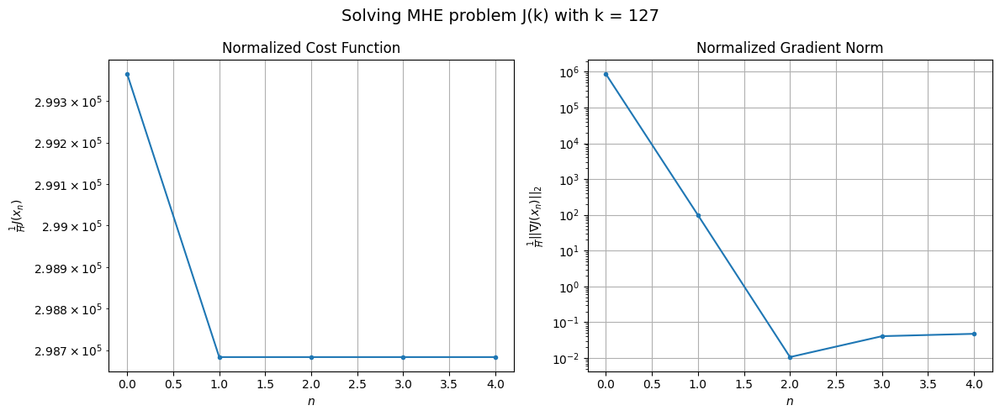

Windows:  10%|▉         | 29/296 [08:16<1:13:48, 16.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 30396851.977647707
Gradient norm: 83488013.59754743
Global estimation error: 131.56320641913288
Initial conditions estimation errors: 65.64375460239981 m, 65.54182108935805 m, 65.55456668181496 m, 66.38185280478586 m
Position estimation errors: 125.81567651834534 m, 126.67886200496648 m, 126.200287274816 m, 126.50895459068839 m

[Gauss-Newton] Iteration 1
Cost function: 30330268.272082526 (-0.22%)
Gradient norm: 9905.04721061199 (-99.99%)
Global estimation error: 147.30677262072484 (11.97%)
Initial conditions estimation errors: 73.47383518223423 m, 73.42230296394523 m, 73.48546392045861 m, 74.22824329171003 m
Position estimation errors: 120.06541989909095 m, 120.79224668672529 m, 120.330553201238 m, 120.74459395361202 m

[Gauss-Newton] Iteration 2
Cost function: 30330268.27229191 (0.00%)
Gradient norm: 1.7032977478465523 (-99.98%)
Global estimation error: 147.3067298426416 (-0.00%)
Initial conditions estimation errors: 73.4738

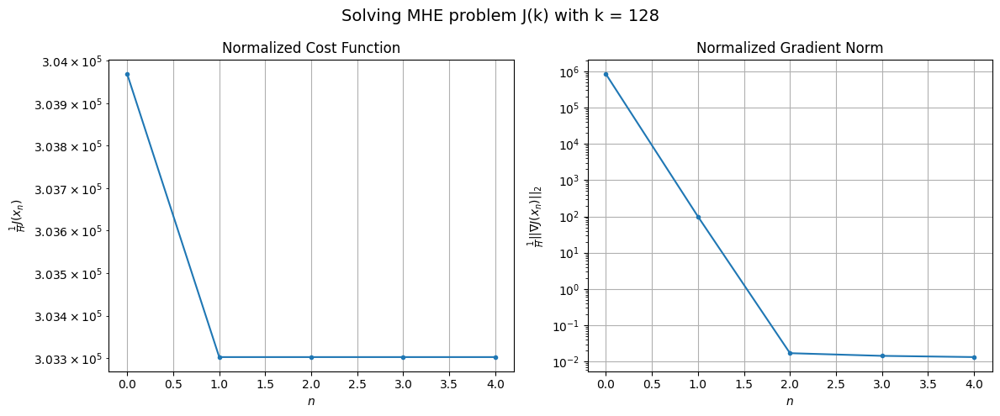

Windows:  10%|█         | 30/296 [08:30<1:10:33, 15.92s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 30776782.006294284
Gradient norm: 81241869.7819117
Global estimation error: 132.2056004704131
Initial conditions estimation errors: 65.90387829668063 m, 65.88264137517368 m, 65.94439304747723 m, 66.67622975542403 m
Position estimation errors: 119.71935638586775 m, 120.47269653009022 m, 119.99220215391333 m, 120.40674005191435 m

[Gauss-Newton] Iteration 1
Cost function: 30712301.533414815 (-0.21%)
Gradient norm: 9898.76170606393 (-99.99%)
Global estimation error: 147.70138880862527 (11.72%)
Initial conditions estimation errors: 73.70455845510108 m, 73.55618100805381 m, 73.66244332776415 m, 74.47528770204143 m
Position estimation errors: 114.07340430079748 m, 114.90850573985196 m, 114.33794582961339 m, 114.66699854935895 m

[Gauss-Newton] Iteration 2
Cost function: 30712301.53414245 (0.00%)
Gradient norm: 0.5165767240500161 (-99.99%)
Global estimation error: 147.70133197443548 (-0.00%)
Initial conditions estimation errors: 73.7

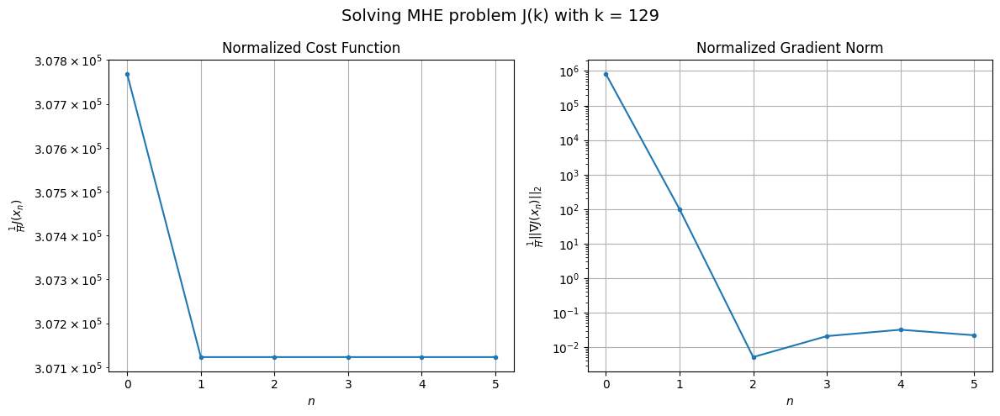

Windows:  10%|█         | 31/296 [08:45<1:08:56, 15.61s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 31081241.471209254
Gradient norm: 78159966.1048643
Global estimation error: 132.531384324766
Initial conditions estimation errors: 66.10392516068423 m, 65.99873081227616 m, 66.08515961659874 m, 66.87052075316181 m
Position estimation errors: 113.22606227817568 m, 114.09263817444396 m, 113.5053275206125 m, 113.83313787071677 m

[Gauss-Newton] Iteration 1
Cost function: 31019592.717930995 (-0.20%)
Gradient norm: 9717.357105776644 (-99.99%)
Global estimation error: 147.91108476046125 (11.60%)
Initial conditions estimation errors: 73.79482457267915 m, 73.73088410933168 m, 73.79086839478845 m, 74.50220228449614 m
Position estimation errors: 107.71358179533705 m, 108.46951261131348 m, 107.9630065845358 m, 108.45403869087019 m

[Gauss-Newton] Iteration 2
Cost function: 31019592.717055146 (-0.00%)
Gradient norm: 4.423892291422304 (-99.95%)
Global estimation error: 147.9110476415018 (-0.00%)
Initial conditions estimation errors: 73.794

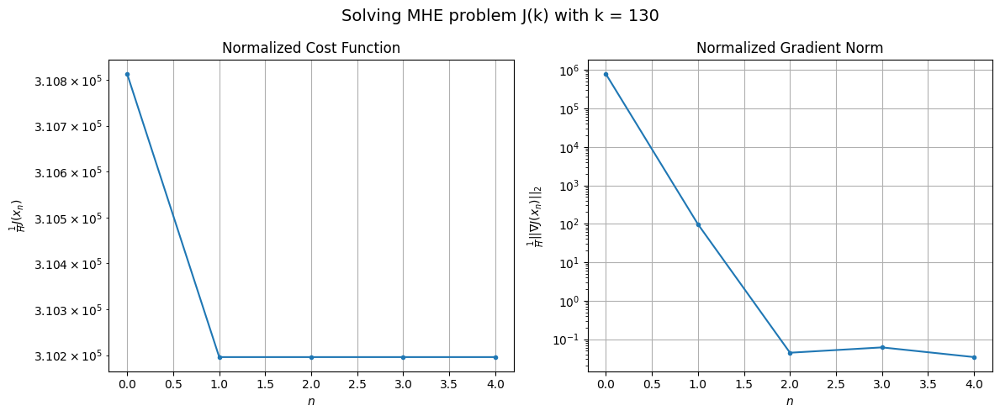

Windows:  11%|█         | 32/296 [08:58<1:04:32, 14.67s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 31314836.612978637
Gradient norm: 74659331.66252238
Global estimation error: 133.17031946797667
Initial conditions estimation errors: 66.40975693828204 m, 66.38922646298975 m, 66.42318679763542 m, 67.115000980907 m
Position estimation errors: 106.41713492757545 m, 107.1922998496 m, 106.67698217192954 m, 107.15880273011544 m

[Gauss-Newton] Iteration 1
Cost function: 31256457.097152308 (-0.19%)
Gradient norm: 9417.175682141242 (-99.99%)
Global estimation error: 148.22217418502714 (11.30%)
Initial conditions estimation errors: 73.92580690470817 m, 73.92431005864914 m, 73.89277383450062 m, 74.69772016394815 m
Position estimation errors: 101.05967719098814 m, 101.7878390055119 m, 101.27584721716983 m, 101.65302552019757 m

[Gauss-Newton] Iteration 2
Cost function: 31256457.096353408 (-0.00%)
Gradient norm: 3.925884716411309 (-99.96%)
Global estimation error: 148.22213307009392 (-0.00%)
Initial conditions estimation errors: 73.9257

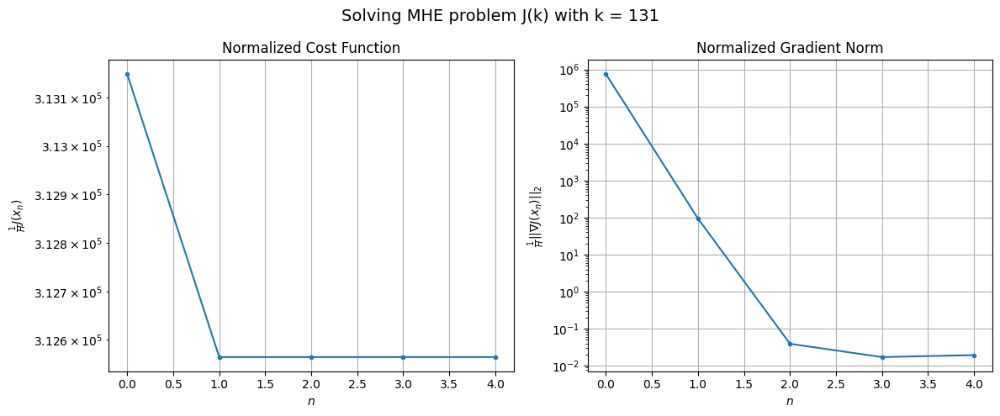

Windows:  11%|█         | 33/296 [09:10<1:01:20, 13.99s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 31475912.6877853
Gradient norm: 71240525.80807349
Global estimation error: 134.17425792177642
Initial conditions estimation errors: 66.89291276943915 m, 66.93687703562667 m, 66.873592153742 m, 67.64146215755106 m
Position estimation errors: 99.30600650991295 m, 100.04315511455158 m, 99.53334106710741 m, 99.90426904084198 m

[Gauss-Newton] Iteration 1
Cost function: 31421021.216483805 (-0.17%)
Gradient norm: 9039.433513648908 (-99.99%)
Global estimation error: 148.82418193416598 (10.92%)
Initial conditions estimation errors: 74.19435628940471 m, 74.33965531044821 m, 74.13015991004187 m, 74.98055294395668 m
Position estimation errors: 94.12559630138354 m, 94.7887690435173 m, 94.35114591719952 m, 94.75267816423192 m

[Gauss-Newton] Iteration 2
Cost function: 31421021.21558218 (-0.00%)
Gradient norm: 1.8315850840699062 (-99.98%)
Global estimation error: 148.82414782406624 (-0.00%)
Initial conditions estimation errors: 74.194339034

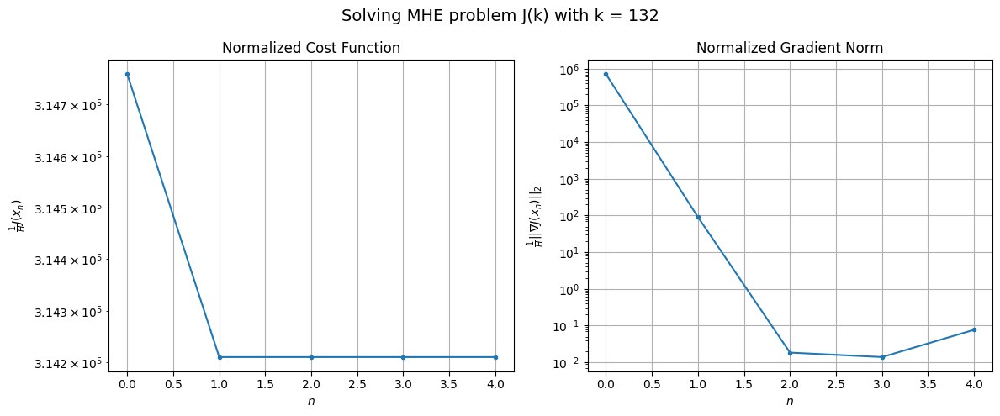

Windows:  11%|█▏        | 34/296 [09:23<59:54, 13.72s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 31566316.063383877
Gradient norm: 66340530.29789097
Global estimation error: 135.46440768374498
Initial conditions estimation errors: 67.50642146869517 m, 67.69253080313428 m, 67.45690593852136 m, 68.26932909235349 m
Position estimation errors: 91.87536115581503 m, 92.53366788265795 m, 92.12055515803179 m, 92.50696269673311 m

[Gauss-Newton] Iteration 1
Cost function: 31515347.8676843 (-0.16%)
Gradient norm: 8582.32463950129 (-99.99%)
Global estimation error: 149.5801817544535 (10.42%)
Initial conditions estimation errors: 74.54426632054457 m, 74.78930579551185 m, 74.56285342900864 m, 75.26116230080252 m
Position estimation errors: 86.90500218930575 m, 87.44683358554971 m, 87.17305042713522 m, 87.50124386046423 m

[Gauss-Newton] Iteration 2
Cost function: 31515347.868793633 (0.00%)
Gradient norm: 5.396764479125612 (-99.94%)
Global estimation error: 149.58015201278315 (-0.00%)
Initial conditions estimation errors: 74.5442513168

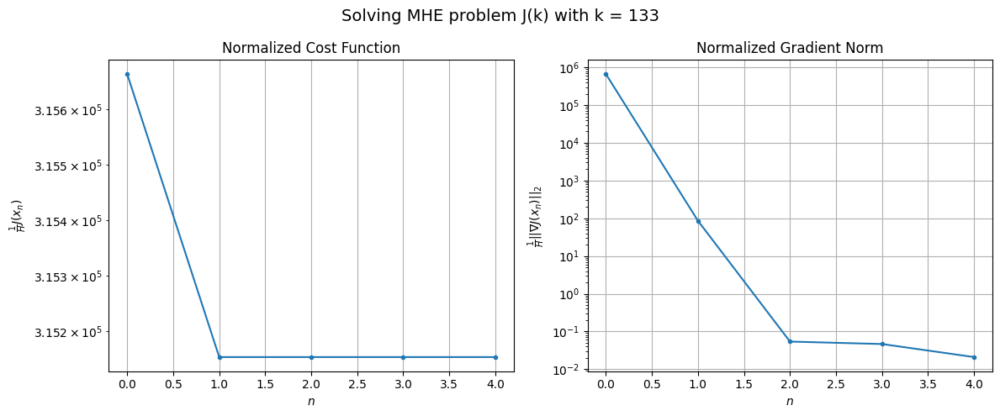

Windows:  12%|█▏        | 35/296 [09:35<57:41, 13.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 31590993.462536924
Gradient norm: 61809425.67915913
Global estimation error: 136.69796403105573
Initial conditions estimation errors: 68.09572010823683 m, 68.37083196149737 m, 68.13619769993278 m, 68.79042445961461 m
Position estimation errors: 84.12611827020832 m, 84.65212958850272 m, 84.40432536408727 m, 84.73158996328131 m

[Gauss-Newton] Iteration 1
Cost function: 31543523.9619941 (-0.15%)
Gradient norm: 8144.241725886523 (-99.99%)
Global estimation error: 150.27230011892303 (9.93%)
Initial conditions estimation errors: 74.88441788354437 m, 75.13182517750413 m, 74.93673606091934 m, 75.58904968950067 m
Position estimation errors: 79.35444345771687 m, 80.0754059058455 m, 79.64699169141292 m, 80.12263165465397 m

[Gauss-Newton] Iteration 2
Cost function: 31543523.9625231 (0.00%)
Gradient norm: 0.24168262897534282 (-100.00%)
Global estimation error: 150.27227980609575 (-0.00%)
Initial conditions estimation errors: 74.884405176

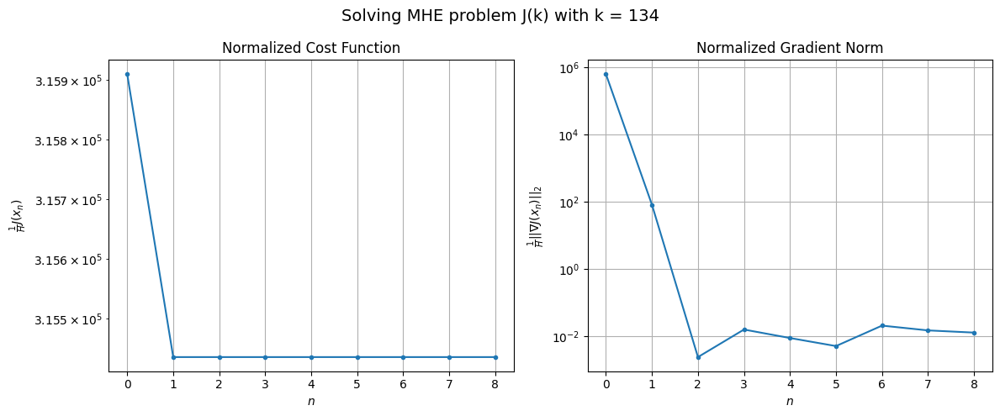

Windows:  12%|█▏        | 36/296 [09:56<1:07:39, 15.61s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 31552363.329686366
Gradient norm: 57401179.01062579
Global estimation error: 137.6444555030669
Initial conditions estimation errors: 68.5547304629908 m, 68.84757967927975 m, 68.63075272480897 m, 69.25319727031098 m
Position estimation errors: 76.03986281566351 m, 76.74097168058236 m, 76.34849328385559 m, 76.8139703728524 m

[Gauss-Newton] Iteration 1
Cost function: 31508590.782851428 (-0.14%)
Gradient norm: 7624.4715948774565 (-99.99%)
Global estimation error: 150.64422878481906 (9.44%)
Initial conditions estimation errors: 75.06426153837006 m, 75.28346560261694 m, 75.13951899643655 m, 75.79852320363071 m
Position estimation errors: 71.47769926249308 m, 72.16174300404899 m, 71.7029961585565 m, 72.05211633198077 m

[Gauss-Newton] Iteration 2
Cost function: 31508590.782702148 (-0.00%)
Gradient norm: 0.9369479782353707 (-99.99%)
Global estimation error: 150.64422381157752 (-0.00%)
Initial conditions estimation errors: 75.06425113

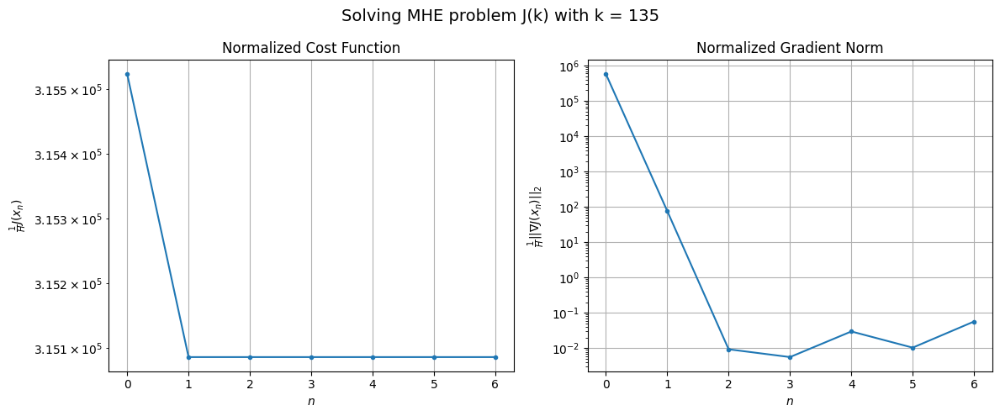

Windows:  12%|█▎        | 37/296 [10:14<1:09:59, 16.21s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 31455519.487473626
Gradient norm: 51961746.60163572
Global estimation error: 138.10391207910976
Initial conditions estimation errors: 68.78447947810618 m, 69.04643557869947 m, 68.87813707406269 m, 69.49610164239748 m
Position estimation errors: 67.65972193097276 m, 68.32377439682652 m, 67.90306922200514 m, 68.24290987281766 m

[Gauss-Newton] Iteration 1
Cost function: 31415680.930121645 (-0.13%)
Gradient norm: 7047.097893798937 (-99.99%)
Global estimation error: 150.41251962233338 (8.91%)
Initial conditions estimation errors: 74.98302241348348 m, 75.18340437912536 m, 74.96448020672973 m, 75.69133920753494 m
Position estimation errors: 63.31735193237962 m, 64.10985904820784 m, 63.506019624552096 m, 63.94450504309647 m

[Gauss-Newton] Iteration 2
Cost function: 31415680.930075243 (-0.00%)
Gradient norm: 3.84010032858943 (-99.95%)
Global estimation error: 150.41253277530265 (0.00%)
Initial conditions estimation errors: 74.9830142

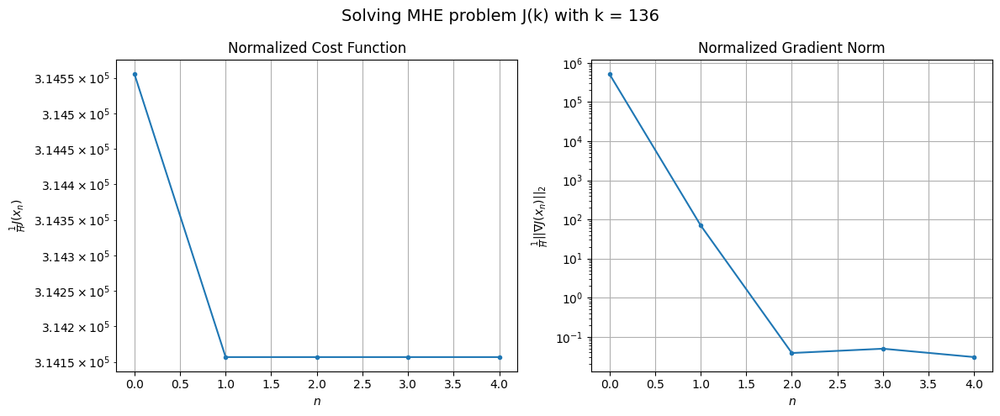

Windows:  13%|█▎        | 38/296 [10:27<1:05:04, 15.14s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 31309753.32470825
Gradient norm: 47780243.808446914
Global estimation error: 137.99138783513362
Initial conditions estimation errors: 68.75948076305927 m, 69.01631337546289 m, 68.75464376410957 m, 69.44951453699692 m
Position estimation errors: 59.07685528335453 m, 59.839315969435596 m, 59.30275059022921 m, 59.70411143950604 m

[Gauss-Newton] Iteration 1
Cost function: 31273515.47376834 (-0.12%)
Gradient norm: 6451.830236936066 (-99.99%)
Global estimation error: 149.75873794017787 (8.53%)
Initial conditions estimation errors: 74.64460585576857 m, 74.8719751690153 m, 74.6169261121583 m, 75.38095708273974 m
Position estimation errors: 54.914343720321 m, 55.79073410117026 m, 55.057346274978265 m, 55.707608303782344 m

[Gauss-Newton] Iteration 2
Cost function: 31273515.473721575 (-0.00%)
Gradient norm: 0.7257146906359739 (-99.99%)
Global estimation error: 149.75873775015617 (-0.00%)
Initial conditions estimation errors: 74.6446000

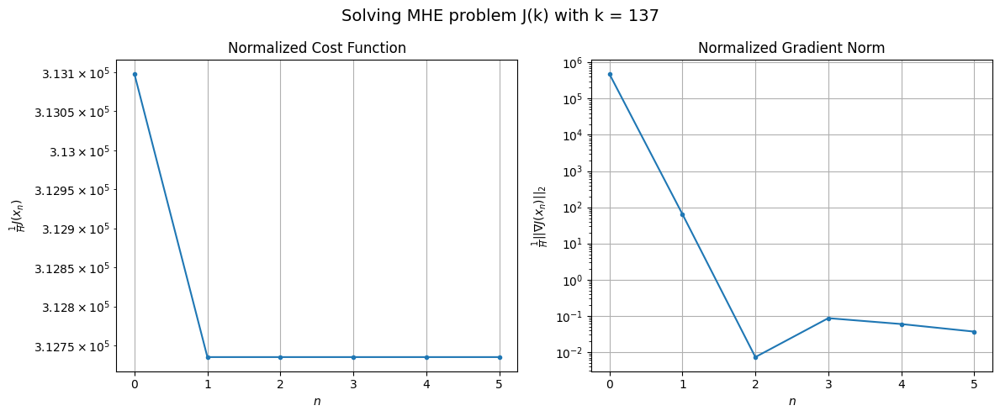

Windows:  13%|█▎        | 39/296 [10:42<1:04:40, 15.10s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 31122795.31212256
Gradient norm: 42592376.344974674
Global estimation error: 137.61300412549957
Initial conditions estimation errors: 68.55488824582051 m, 68.8520570654397 m, 68.53236140105699 m, 69.28352833743844 m
Position estimation errors: 50.39301115812821 m, 51.21484520980594 m, 50.58334068100975 m, 51.153520859190444 m

[Gauss-Newton] Iteration 1
Cost function: 31090561.85669321 (-0.10%)
Gradient norm: 5749.992341941578 (-99.99%)
Global estimation error: 148.69812863254077 (8.06%)
Initial conditions estimation errors: 74.07154765869518 m, 74.37437090641616 m, 74.11964234743498 m, 74.82777861892245 m
Position estimation errors: 46.41343920215504 m, 47.32206578013613 m, 46.590806181826544 m, 47.30014017140536 m

[Gauss-Newton] Iteration 2
Cost function: 31090561.856802665 (0.00%)
Gradient norm: 2.3827443641470465 (-99.96%)
Global estimation error: 148.69811442820705 (-0.00%)
Initial conditions estimation errors: 74.071544

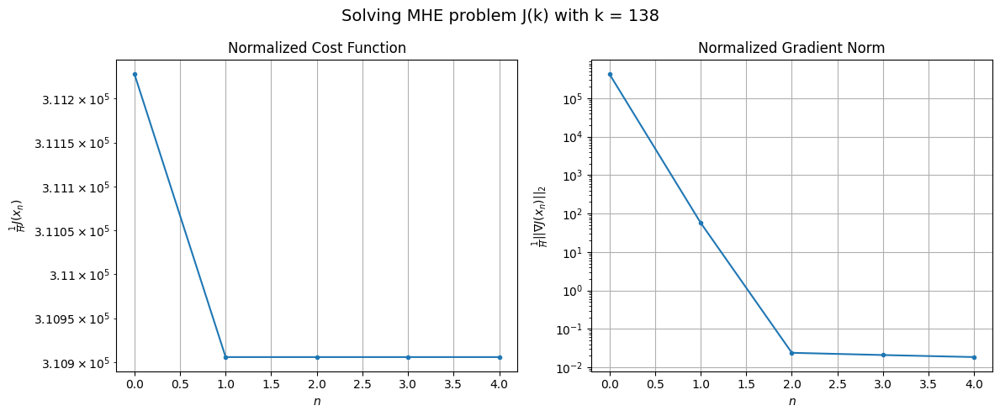

Windows:  14%|█▎        | 40/296 [10:54<1:00:51, 14.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 30902511.03976283
Gradient norm: 38041698.25041929
Global estimation error: 137.08337755048169
Initial conditions estimation errors: 68.2440087435005 m, 68.62596437332392 m, 68.29635355630225 m, 68.99728343185092 m
Position estimation errors: 41.87289344187603 m, 42.68434011916376 m, 42.087010965711364 m, 42.68017726810165 m

[Gauss-Newton] Iteration 1
Cost function: 30873599.234388977 (-0.09%)
Gradient norm: 5118.575904403521 (-99.99%)
Global estimation error: 147.2815437985067 (7.44%)
Initial conditions estimation errors: 73.42425220297653 m, 73.73844649771944 m, 73.28842888523104 m, 74.1087506658554 m
Position estimation errors: 37.998102227154725 m, 38.72781306322543 m, 38.25270276147879 m, 38.686681663041064 m

[Gauss-Newton] Iteration 2
Cost function: 30873599.233893555 (-0.00%)
Gradient norm: 2.0781273045588775 (-99.96%)
Global estimation error: 147.28151591466812 (-0.00%)
Initial conditions estimation errors: 73.424251

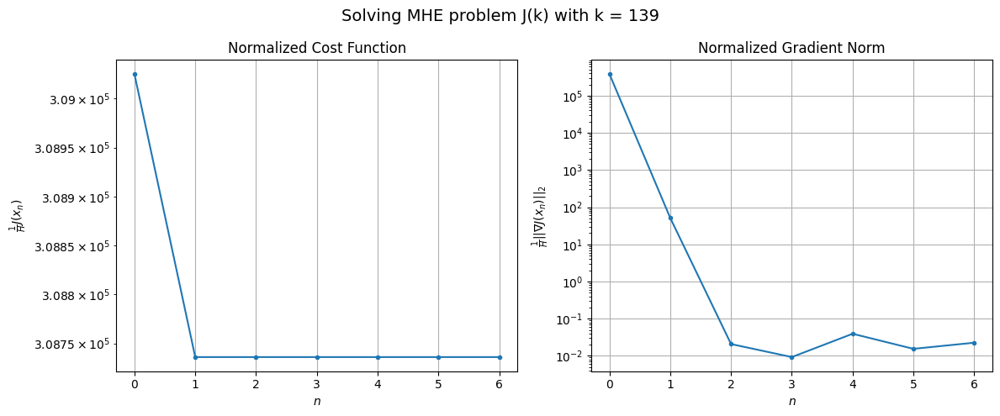

Windows:  14%|█▍        | 41/296 [11:11<1:04:41, 15.22s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 30660625.207668025
Gradient norm: 33870992.44039558
Global estimation error: 136.45500380518672
Initial conditions estimation errors: 67.99782889417389 m, 68.38347701138773 m, 67.87099296043863 m, 68.65438705663558 m
Position estimation errors: 33.90600068701866 m, 34.48796033447526 m, 34.23548925006521 m, 34.48668355919788 m

[Gauss-Newton] Iteration 1
Cost function: 30634831.76057554 (-0.08%)
Gradient norm: 4459.533575395483 (-99.99%)
Global estimation error: 146.0621365601182 (7.04%)
Initial conditions estimation errors: 72.82320496671673 m, 73.16862327287694 m, 72.62298477312083 m, 73.50585829876316 m
Position estimation errors: 30.051835195663273 m, 30.662141236793165 m, 30.301817293389263 m, 30.452026224101196 m

[Gauss-Newton] Iteration 2
Cost function: 30634831.759841155 (-0.00%)
Gradient norm: 2.0428061862339475 (-99.95%)
Global estimation error: 146.06214793173515 (0.00%)
Initial conditions estimation errors: 72.8232

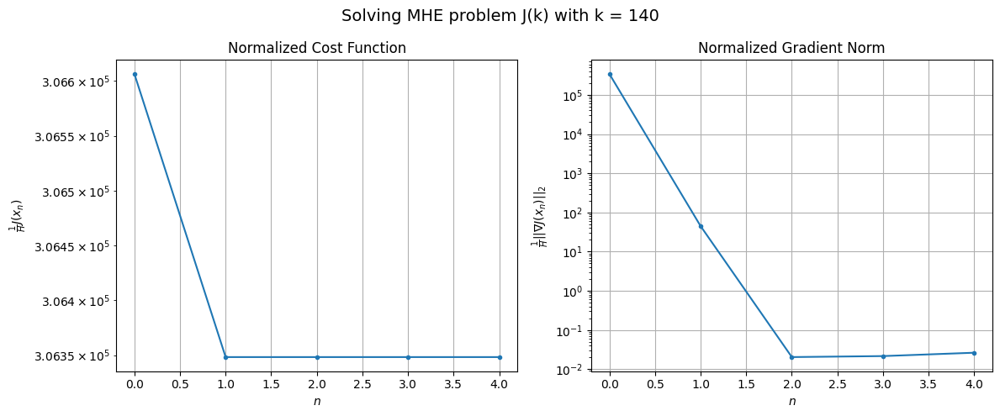

Windows:  14%|█▍        | 42/296 [11:24<1:01:14, 14.47s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 30406896.11257742
Gradient norm: 29677244.60556996
Global estimation error: 136.30304405410007
Initial conditions estimation errors: 67.93658655924415 m, 68.35847601037246 m, 67.7396035389665 m, 68.56776722333902 m
Position estimation errors: 27.256546022126646 m, 27.614699092366404 m, 27.605438220813447 m, 27.456400920036902 m

[Gauss-Newton] Iteration 1
Cost function: 30384114.19676461 (-0.07%)
Gradient norm: 3753.627814903121 (-99.99%)
Global estimation error: 145.3453475897166 (6.63%)
Initial conditions estimation errors: 72.38611647161565 m, 72.92802225623772 m, 72.24339883497736 m, 73.12895558600232 m
Position estimation errors: 23.38646338379703 m, 23.751183342663893 m, 23.66914938753324 m, 23.640039310402013 m

[Gauss-Newton] Iteration 2
Cost function: 30384114.196047004 (-0.00%)
Gradient norm: 2.312115351631813 (-99.94%)
Global estimation error: 145.34538665717093 (0.00%)
Initial conditions estimation errors: 72.38611

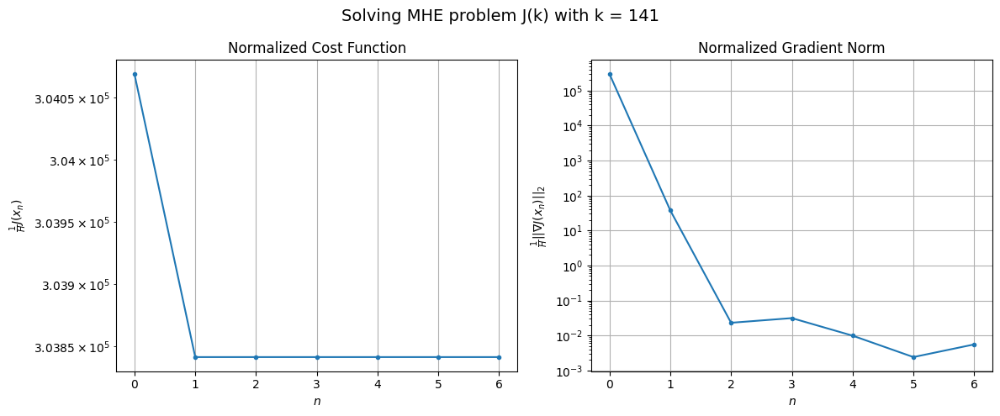

Windows:  15%|█▍        | 43/296 [11:42<1:05:05, 15.43s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 30149820.799740378
Gradient norm: 26039652.331751574
Global estimation error: 136.94979531820078
Initial conditions estimation errors: 68.18668854849155 m, 68.80357548699318 m, 68.03133075592856 m, 68.87352933854595 m
Position estimation errors: 23.26591465845663 m, 23.205902414953517 m, 23.651930499116805 m, 23.165956630988546 m

[Gauss-Newton] Iteration 1
Cost function: 30129321.21424231 (-0.07%)
Gradient norm: 3113.880132715449 (-99.99%)
Global estimation error: 145.17753212052904 (6.01%)
Initial conditions estimation errors: 72.29769073196626 m, 72.8936574958034 m, 72.16044885391388 m, 72.9991430093002 m
Position estimation errors: 19.4867156249905 m, 19.37901083774995 m, 19.78287453795449 m, 19.36869013101971 m

[Gauss-Newton] Iteration 2
Cost function: 30129321.214188617 (-0.00%)
Gradient norm: 10.068288178449261 (-99.68%)
Global estimation error: 145.17746899117668 (-0.00%)
Initial conditions estimation errors: 72.29769

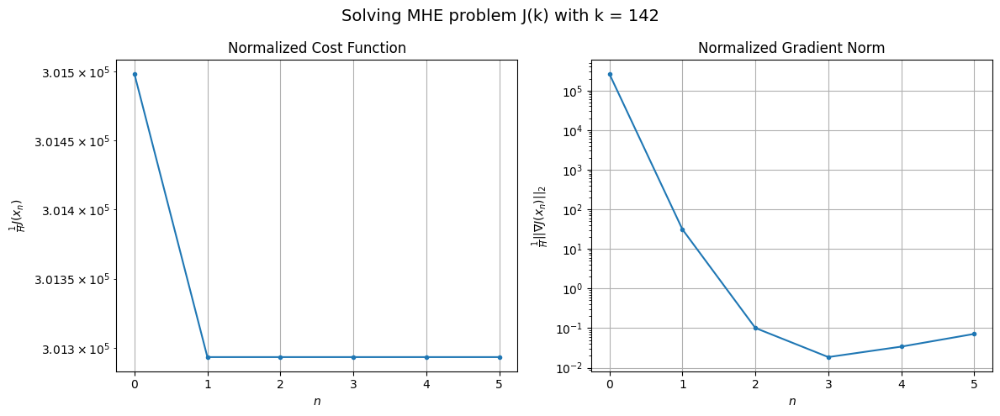

Windows:  15%|█▍        | 44/296 [11:57<1:04:20, 15.32s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 29895412.47449423
Gradient norm: 22407257.118664626
Global estimation error: 138.40496595306084
Initial conditions estimation errors: 68.91970327931152 m, 69.58074205404023 m, 68.77008024155813 m, 69.53519264725689 m
Position estimation errors: 23.268939622384703 m, 22.752892405905325 m, 23.60077286256775 m, 22.85320863473822 m

[Gauss-Newton] Iteration 1
Cost function: 29876719.59658692 (-0.06%)
Gradient norm: 2526.5813170369174 (-99.99%)
Global estimation error: 145.92681722056656 (5.43%)
Initial conditions estimation errors: 72.71700574104992 m, 73.3198597487213 m, 72.53858598918728 m, 73.27454214971685 m
Position estimation errors: 20.00587656494117 m, 19.427064539695913 m, 20.32857711374748 m, 19.5636751654175 m

[Gauss-Newton] Iteration 2
Cost function: 29876719.596012995 (-0.00%)
Gradient norm: 5.675723298808598 (-99.78%)
Global estimation error: 145.92681627715817 (-0.00%)
Initial conditions estimation errors: 72.71701

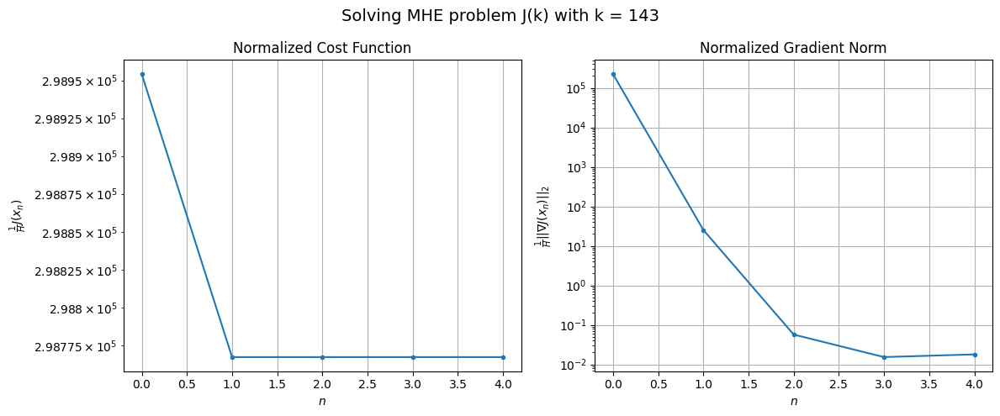

Windows:  15%|█▌        | 45/296 [12:10<1:01:03, 14.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 29649115.967291817
Gradient norm: 18911442.544992488
Global estimation error: 140.95652443330025
Initial conditions estimation errors: 70.23520835915532 m, 70.90450042162206 m, 70.05727288297754 m, 70.71229415117993 m
Position estimation errors: 27.113292676040746 m, 26.314972874433444 m, 27.40287688967107 m, 26.50721477170403 m

[Gauss-Newton] Iteration 1
Cost function: 29631610.716730352 (-0.06%)
Gradient norm: 1945.264575213175 (-99.99%)
Global estimation error: 148.05321183490813 (5.03%)
Initial conditions estimation errors: 73.7638198206328 m, 74.51329839917686 m, 73.5512706079861 m, 74.27360875469786 m
Position estimation errors: 24.487181174164135 m, 23.57459345996859 m, 24.74985183886334 m, 23.811175193242498 m

[Gauss-Newton] Iteration 2
Cost function: 29631610.71683122 (0.00%)
Gradient norm: 2.155415684646088 (-99.89%)
Global estimation error: 148.05318748465396 (-0.00%)
Initial conditions estimation errors: 73.76382

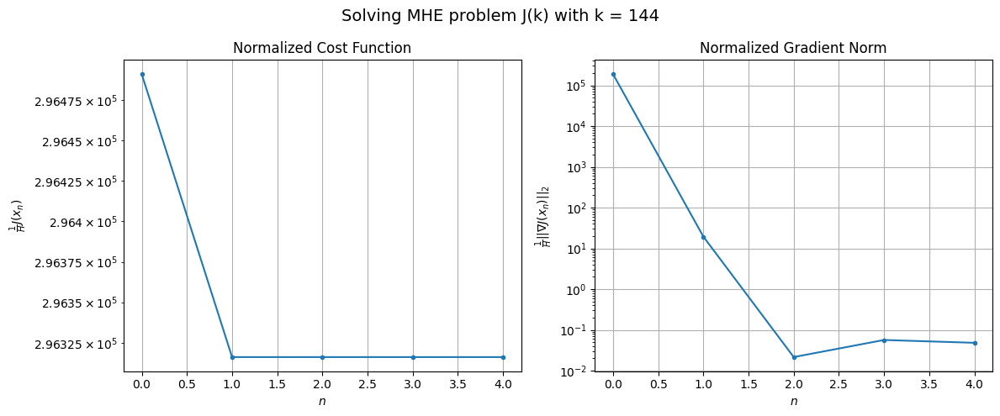

Windows:  16%|█▌        | 46/296 [12:23<59:02, 14.17s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 29415030.926345088
Gradient norm: 14996144.558274833
Global estimation error: 144.8410523778061
Initial conditions estimation errors: 72.16405144007462 m, 72.95870330594899 m, 71.95855853823375 m, 72.5962700128551 m
Position estimation errors: 33.282965413847535 m, 32.31298740784602 m, 33.51455697571563 m, 32.55113932582911 m

[Gauss-Newton] Iteration 1
Cost function: 29398073.417871863 (-0.06%)
Gradient norm: 1459.2090519234898 (-99.99%)
Global estimation error: 151.54054365910753 (4.63%)
Initial conditions estimation errors: 75.48308363172421 m, 76.29077211820501 m, 75.28833447871969 m, 76.01425679420558 m
Position estimation errors: 31.058688354715926 m, 29.919231321794065 m, 31.23688709215413 m, 30.149912919333396 m

[Gauss-Newton] Iteration 2
Cost function: 29398073.418287653 (0.00%)
Gradient norm: 0.8241869759198884 (-99.94%)
Global estimation error: 151.54068489330842 (0.00%)
Initial conditions estimation errors: 75.483

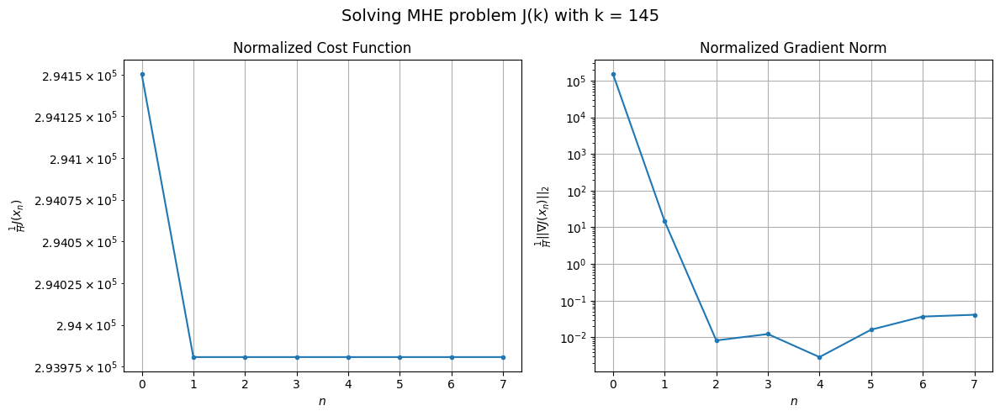

Windows:  16%|█▌        | 47/296 [12:42<1:05:06, 15.69s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 29194611.102344897
Gradient norm: 11349127.168428646
Global estimation error: 149.94285859259043
Initial conditions estimation errors: 74.678638727188 m, 75.5472877066717 m, 74.49340798636429 m, 75.16149586077752 m
Position estimation errors: 40.52790004730415 m, 39.38020633139555 m, 40.68963977541568 m, 39.60146834238161 m

[Gauss-Newton] Iteration 1
Cost function: 29177602.389184352 (-0.06%)
Gradient norm: 1005.0647354051935 (-99.99%)
Global estimation error: 156.24617659273613 (4.20%)
Initial conditions estimation errors: 77.84399877024931 m, 78.67465761942275 m, 77.65073715157125 m, 78.31850102923053 m
Position estimation errors: 38.45508041500817 m, 37.29277868619462 m, 38.53875037342478 m, 37.56860739421613 m

[Gauss-Newton] Iteration 2
Cost function: 29177602.389179062 (-0.00%)
Gradient norm: 0.8718664215627422 (-99.91%)
Global estimation error: 156.24613264968266 (-0.00%)
Initial conditions estimation errors: 77.844009

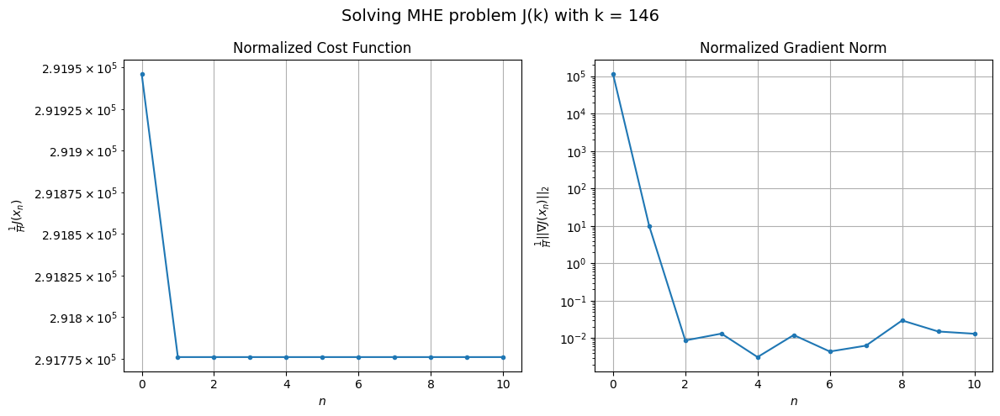

Windows:  16%|█▌        | 48/296 [13:10<1:20:03, 19.37s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 28990025.134641342
Gradient norm: 7012677.0686587645
Global estimation error: 155.98720714462775
Initial conditions estimation errors: 77.70919193754403 m, 78.59134987513552 m, 77.53853945844175 m, 78.13078008886761 m
Position estimation errors: 48.18285381072471 m, 47.036737051529066 m, 48.25788179164194 m, 47.30882030534529 m

[Gauss-Newton] Iteration 1
Cost function: 28972341.33029255 (-0.06%)
Gradient norm: 619.3049741257342 (-99.99%)
Global estimation error: 162.09024075241817 (3.91%)
Initial conditions estimation errors: 80.78345936010952 m, 81.56182996642099 m, 80.68883171897856 m, 81.14315091661881 m
Position estimation errors: 46.09874975783196 m, 45.018748760997866 m, 46.03859627753316 m, 45.35370347679831 m

[Gauss-Newton] Iteration 2
Cost function: 28972341.330523893 (0.00%)
Gradient norm: 7.394824354253407 (-98.81%)
Global estimation error: 162.0901047393664 (-0.00%)
Initial conditions estimation errors: 80.783469

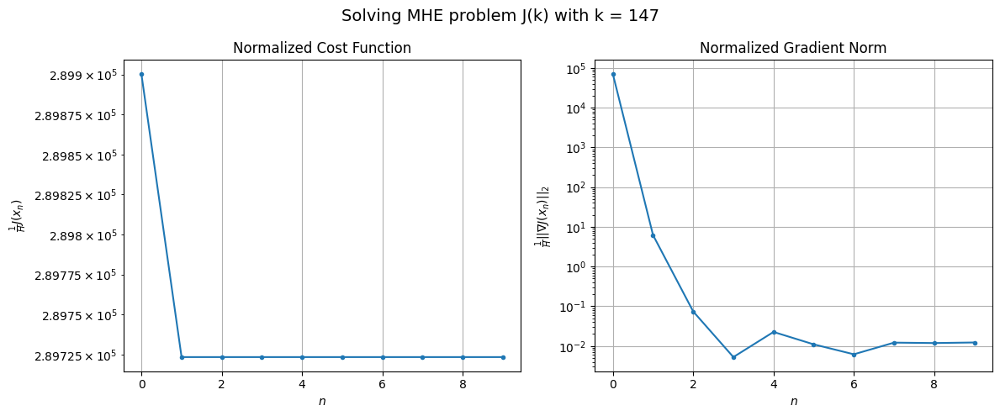

Windows:  17%|█▋        | 49/296 [13:36<1:27:34, 21.27s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 28801760.904432204
Gradient norm: 1955129.1178811828
Global estimation error: 162.86304392879873
Initial conditions estimation errors: 81.16921201832753 m, 81.98684111694898 m, 81.10325841715229 m, 81.46353674699411 m
Position estimation errors: 55.926264294645236 m, 54.871370927766264 m, 55.86417743864603 m, 55.206206301020565 m

[Gauss-Newton] Iteration 1
Cost function: 28782920.72923906 (-0.07%)
Gradient norm: 314.78965052062847 (-99.98%)
Global estimation error: 168.95385789467795 (3.74%)
Initial conditions estimation errors: 84.19983992750633 m, 85.03793861518024 m, 84.15386045139866 m, 84.51287674259633 m
Position estimation errors: 53.733768833336576 m, 52.62543873388886 m, 53.6837494082228 m, 52.97596350291605 m

[Gauss-Newton] Iteration 2
Cost function: 28782920.72876077 (-0.00%)
Gradient norm: 5.4757899691147 (-98.26%)
Global estimation error: 168.953995465947 (0.00%)
Initial conditions estimation errors: 84.19985008

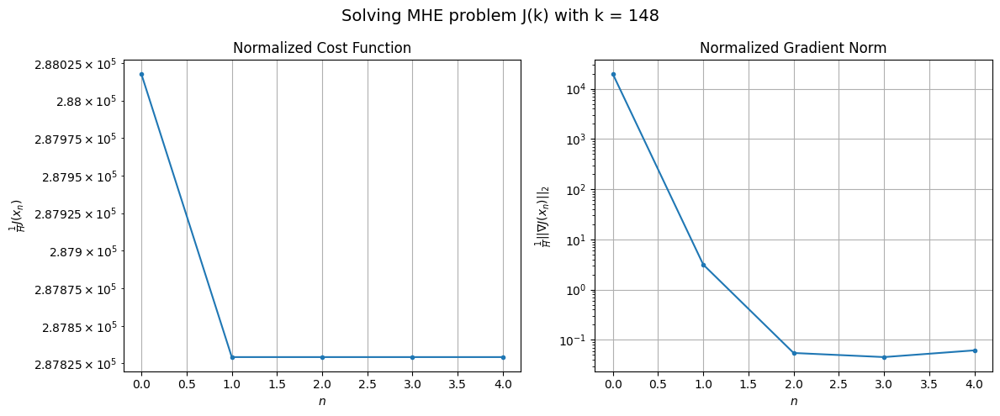

Windows:  17%|█▋        | 50/296 [13:49<1:16:38, 18.69s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 28628202.134966254
Gradient norm: 2704836.3713864596
Global estimation error: 170.44846038309382
Initial conditions estimation errors: 84.94891229210576 m, 85.81690058019579 m, 84.91943100403496 m, 85.20840275896299 m
Position estimation errors: 63.59446923471243 m, 62.5163114468547 m, 63.54411916005326 m, 62.85978689166709 m

[Gauss-Newton] Iteration 1
Cost function: 28607522.557852603 (-0.07%)
Gradient norm: 185.77125398734586 (-99.99%)
Global estimation error: 176.53796896690014 (3.57%)
Initial conditions estimation errors: 87.99852036347013 m, 88.88146399157083 m, 87.99033896080678 m, 88.20238722045542 m
Position estimation errors: 61.226282945980365 m, 60.14735405981249 m, 61.13783954424645 m, 60.607737579886106 m

[Gauss-Newton] Iteration 2
Cost function: 28607522.557951402 (0.00%)
Gradient norm: 2.323266427354729 (-98.75%)
Global estimation error: 176.53796531490863 (-0.00%)
Initial conditions estimation errors: 87.9985

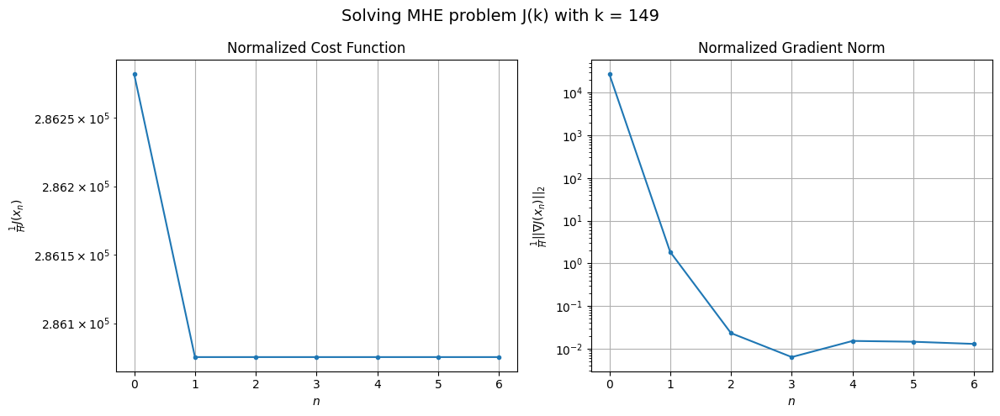

Windows:  17%|█▋        | 51/296 [14:06<1:14:40, 18.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 28471476.716640566
Gradient norm: 7979548.806944466
Global estimation error: 178.4608085504267
Initial conditions estimation errors: 88.9677983832064 m, 89.86357002708051 m, 88.9746405436236 m, 89.1123358400061 m
Position estimation errors: 71.08429759168628 m, 70.04203863657047 m, 70.9989009905291 m, 70.49398753405181 m

[Gauss-Newton] Iteration 1
Cost function: 28448395.11554731 (-0.08%)
Gradient norm: 287.05224098811806 (-100.00%)
Global estimation error: 184.81622321254548 (3.56%)
Initial conditions estimation errors: 92.08232603871693 m, 92.96322045159839 m, 92.19751130092959 m, 92.38670960095405 m
Position estimation errors: 68.49562433742462 m, 67.44802363331729 m, 68.25587016974725 m, 67.56695797664962 m

[Gauss-Newton] Iteration 2
Cost function: 28448395.115233094 (-0.00%)
Gradient norm: 5.567268508086283 (-98.06%)
Global estimation error: 184.81627922521133 (0.00%)
Initial conditions estimation errors: 92.08233450099

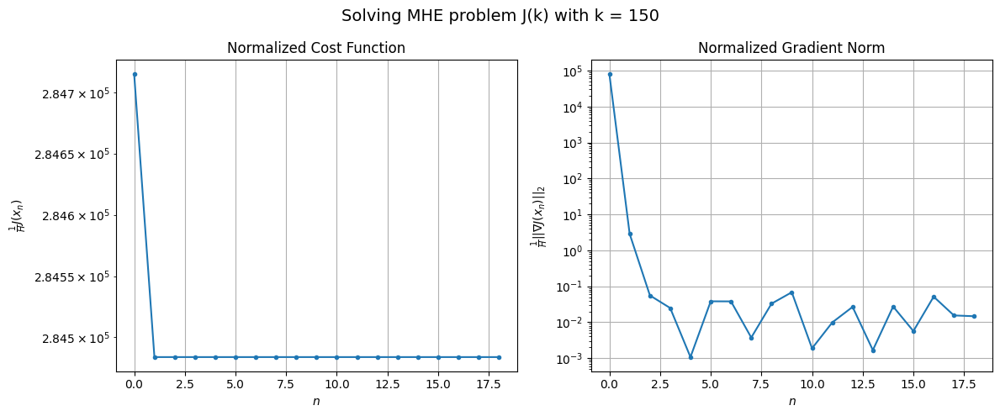

Windows:  18%|█▊        | 52/296 [14:53<1:49:09, 26.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 28332299.158153813
Gradient norm: 12602489.450495303
Global estimation error: 186.9755599177693
Initial conditions estimation errors: 93.16089279811028 m, 94.04491449738663 m, 93.29362496191227 m, 93.44907485710935 m
Position estimation errors: 78.32142620628501 m, 77.31226954696372 m, 78.08378006810646 m, 77.40710586333537 m

[Gauss-Newton] Iteration 1
Cost function: 28306447.91437062 (-0.09%)
Gradient norm: 416.32553616833786 (-100.00%)
Global estimation error: 193.23008567339835 (3.35%)
Initial conditions estimation errors: 96.36705840013732 m, 97.16333863305131 m, 96.30249729493251 m, 96.62472575447734 m
Position estimation errors: 75.48768058974997 m, 74.54965637975883 m, 75.45676610537564 m, 74.5891917532454 m

[Gauss-Newton] Iteration 2
Cost function: 28306447.91425454 (-0.00%)
Gradient norm: 1.1677345259541063 (-99.72%)
Global estimation error: 193.23002449245146 (-0.00%)
Initial conditions estimation errors: 96.367065

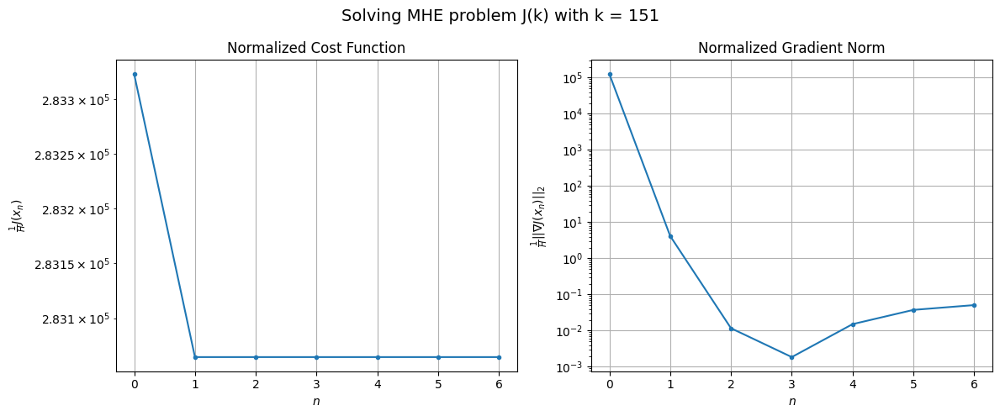

Windows:  18%|█▊        | 53/296 [15:11<1:38:20, 24.28s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 28203583.74318704
Gradient norm: 17276100.10168983
Global estimation error: 195.44388481530586
Initial conditions estimation errors: 97.47651189312981 m, 98.26841481219603 m, 97.42109322996849 m, 97.71929975026369 m
Position estimation errors: 85.25460822093073 m, 84.35627422140197 m, 85.22140892801698 m, 84.37405441219798 m

[Gauss-Newton] Iteration 1
Cost function: 28174413.733228277 (-0.10%)
Gradient norm: 501.92924851234005 (-100.00%)
Global estimation error: 202.08376105145004 (3.40%)
Initial conditions estimation errors: 100.81473915662345 m, 101.64295203330393 m, 100.73871021629883 m, 100.9684466000478 m
Position estimation errors: 82.15914669734664 m, 81.20736076948207 m, 82.11563102389839 m, 81.37653613166293 m

[Gauss-Newton] Iteration 2
Cost function: 28174413.733095467 (-0.00%)
Gradient norm: 1.5981291979076053 (-99.68%)
Global estimation error: 202.08378865350477 (0.00%)
Initial conditions estimation errors: 100.8

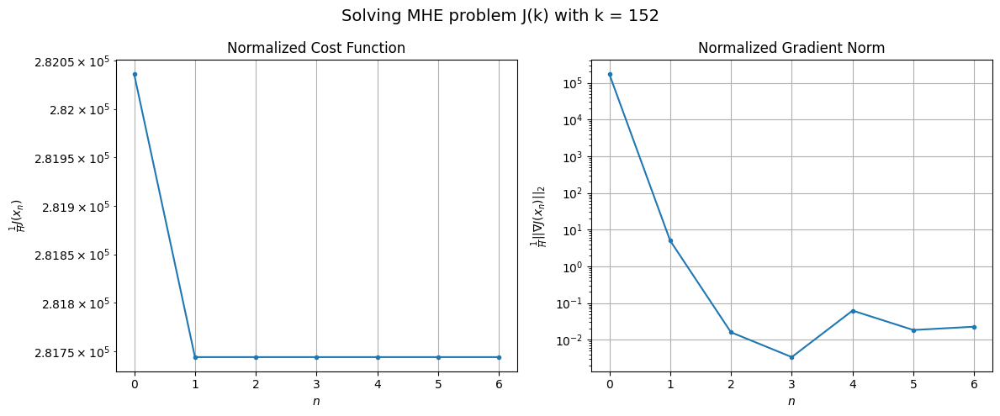

Windows:  18%|█▊        | 54/296 [15:29<1:30:02, 22.32s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 28086973.495482
Gradient norm: 22283318.314835258
Global estimation error: 204.23746029645264
Initial conditions estimation errors: 101.89676159352274 m, 102.71336738510435 m, 101.82923608137168 m, 102.03300638354533 m
Position estimation errors: 91.8458514729512 m, 90.93760392946753 m, 91.79958914316961 m, 91.08253164932106 m

[Gauss-Newton] Iteration 1
Cost function: 28054121.42265722 (-0.12%)
Gradient norm: 529.1340333853439 (-100.00%)
Global estimation error: 211.0910214161649 (3.36%)
Initial conditions estimation errors: 105.38733895869079 m, 106.21666250280889 m, 105.17118690451092 m, 105.40371400615638 m
Position estimation errors: 88.47730096541956 m, 87.58940732025239 m, 88.59858630216115 m, 87.86726210095684 m

[Gauss-Newton] Iteration 2
Cost function: 28054121.422752008 (0.00%)
Gradient norm: 3.2718073030728316 (-99.38%)
Global estimation error: 211.09109599345337 (0.00%)
Initial conditions estimation errors: 105.38

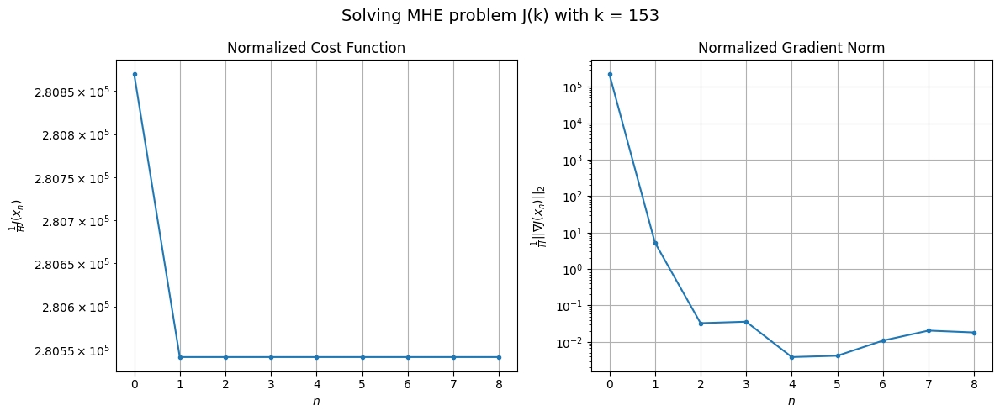

Windows:  19%|█▊        | 55/296 [15:52<1:30:19, 22.49s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 27979250.371340193
Gradient norm: 27507641.53126891
Global estimation error: 213.0843200965477
Initial conditions estimation errors: 106.3939950267288 m, 107.20027359167086 m, 106.1817031482146 m, 106.38970407781865 m
Position estimation errors: 98.06438010506866 m, 97.22258129281101 m, 98.17569004678377 m, 97.47223539462003 m

[Gauss-Newton] Iteration 1
Cost function: 27942290.457232174 (-0.13%)
Gradient norm: 517.4921205910948 (-100.00%)
Global estimation error: 220.21108732414663 (3.34%)
Initial conditions estimation errors: 110.0542664813273 m, 110.73198030857613 m, 109.66129250045513 m, 109.97175623865144 m
Position estimation errors: 94.40546100216706 m, 93.66428146069852 m, 94.65212351989344 m, 93.8511240768153 m

[Gauss-Newton] Iteration 2
Cost function: 27942290.4573057 (0.00%)
Gradient norm: 6.46571740218388 (-98.75%)
Global estimation error: 220.21101758637388 (-0.00%)
Initial conditions estimation errors: 110.05426

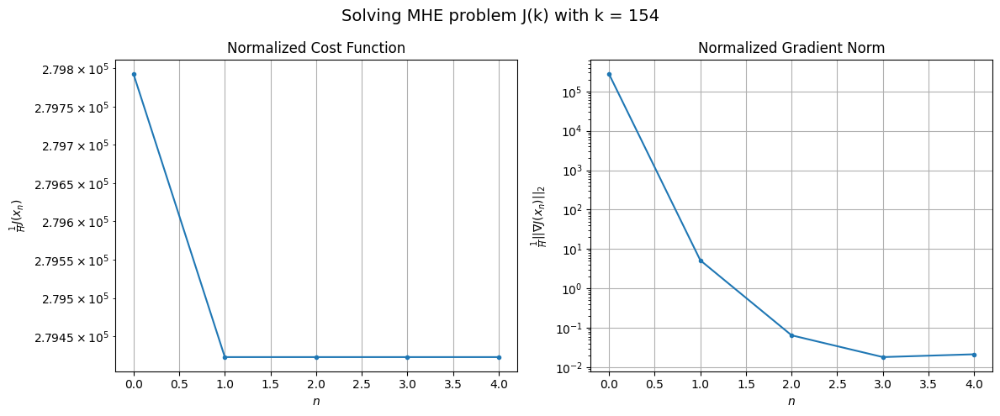

Windows:  19%|█▉        | 56/296 [16:04<1:18:07, 19.53s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 27876509.37494647
Gradient norm: 32373130.873090614
Global estimation error: 221.9522529363047
Initial conditions estimation errors: 110.93331544426762 m, 111.58336792022291 m, 110.54757784750302 m, 110.83757255221228 m
Position estimation errors: 103.86364918088955 m, 103.16575800134238 m, 104.09041981589066 m, 103.32406897894074 m

[Gauss-Newton] Iteration 1
Cost function: 27835128.527678978 (-0.15%)
Gradient norm: 452.7386668390819 (-100.00%)
Global estimation error: 229.73339323090786 (3.51%)
Initial conditions estimation errors: 114.7791026016588 m, 115.48063215080798 m, 114.4729075561125 m, 114.73162968496221 m
Position estimation errors: 99.913635271587 m, 99.19015740108158 m, 100.09189074337243 m, 99.32700060054788 m

[Gauss-Newton] Iteration 2
Cost function: 27835128.527735375 (0.00%)
Gradient norm: 2.682064007872202 (-99.41%)
Global estimation error: 229.73346646194915 (0.00%)
Initial conditions estimation errors: 11

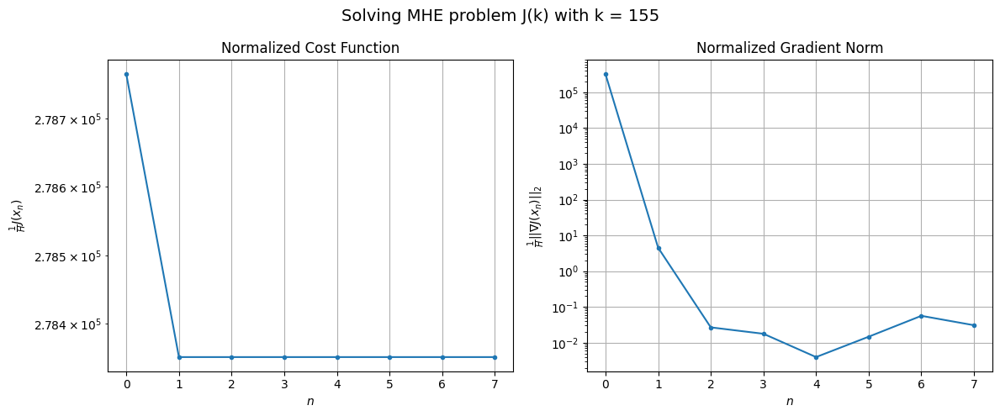

Windows:  19%|█▉        | 57/296 [16:25<1:18:52, 19.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 27772624.129287906
Gradient norm: 37137831.83238762
Global estimation error: 231.0861740705731
Initial conditions estimation errors: 115.46355957688539 m, 116.13117017377078 m, 115.16391223006272 m, 115.41141651354869 m
Position estimation errors: 109.19536458152697 m, 108.51922964788385 m, 109.35364597365295 m, 108.62361890731698 m

[Gauss-Newton] Iteration 1
Cost function: 27726803.64266377 (-0.16%)
Gradient norm: 346.0802695162319 (-100.00%)
Global estimation error: 239.10197406067346 (3.47%)
Initial conditions estimation errors: 119.49588090367872 m, 120.0983921389873 m, 119.13641299296955 m, 119.47118478691009 m
Position estimation errors: 104.96791535460859 m, 104.38250730091846 m, 105.21590080045567 m, 104.36792016789305 m

[Gauss-Newton] Iteration 2
Cost function: 27726803.642743725 (0.00%)
Gradient norm: 2.4760104872235584 (-99.28%)
Global estimation error: 239.1019705201033 (-0.00%)
Initial conditions estimation erro

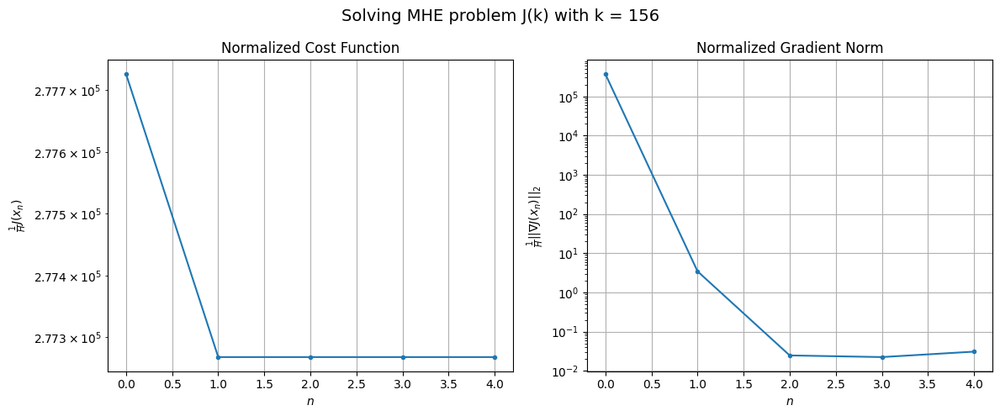

Windows:  20%|█▉        | 58/296 [16:38<1:10:32, 17.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 27660646.577723987
Gradient norm: 42095911.318658285
Global estimation error: 239.92628073590276
Initial conditions estimation errors: 119.91430403454203 m, 120.47872485531275 m, 119.56399554707082 m, 119.89368315237394 m
Position estimation errors: 114.01458576661972 m, 113.47716033743782 m, 114.23770913234382 m, 113.42862810505488 m

[Gauss-Newton] Iteration 1
Cost function: 27609985.372556247 (-0.18%)
Gradient norm: 250.40105130760506 (-100.00%)
Global estimation error: 248.30398155389653 (3.49%)
Initial conditions estimation errors: 124.14564339621343 m, 124.6508365747448 m, 123.68410739525572 m, 124.12544021092594 m
Position estimation errors: 109.49844356741144 m, 108.99736937267369 m, 109.80749372910752 m, 108.90450545532948 m

[Gauss-Newton] Iteration 2
Cost function: 27609985.372591667 (0.00%)
Gradient norm: 3.3045096928313056 (-98.68%)
Global estimation error: 248.3038787048686 (-0.00%)
Initial conditions estimation 

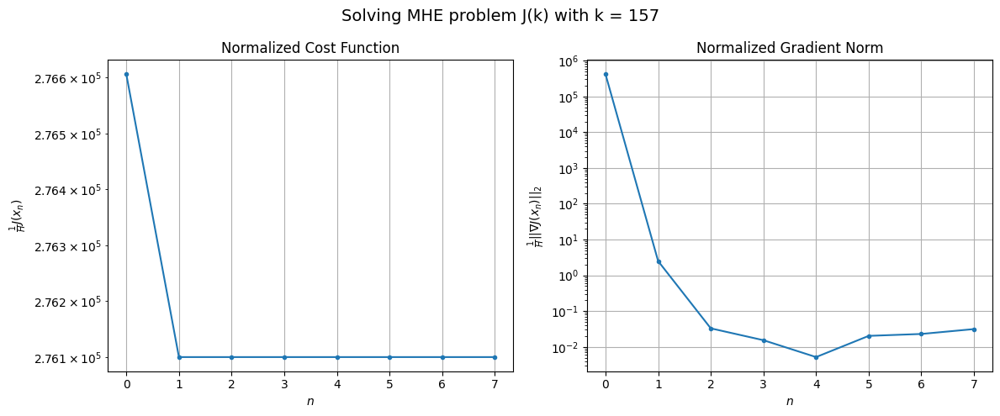

Windows:  20%|█▉        | 59/296 [16:59<1:14:49, 18.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 27542074.624000885
Gradient norm: 46884805.69892986
Global estimation error: 248.48622866955466
Initial conditions estimation errors: 124.24323338563045 m, 124.7083605726679 m, 123.79435165484249 m, 124.2247897052109 m
Position estimation errors: 118.26183550595204 m, 117.80819084334561 m, 118.5400067223273 m, 117.68665821222957 m

[Gauss-Newton] Iteration 1
Cost function: 27486690.400788084 (-0.20%)
Gradient norm: 264.0392986313888 (-100.00%)
Global estimation error: 257.5328404545616 (3.64%)
Initial conditions estimation errors: 128.66688506106368 m, 129.21827133286243 m, 128.28969149782742 m, 128.88902486718223 m
Position estimation errors: 113.47275214185326 m, 112.96186316744092 m, 113.68795531009302 m, 112.62506483748086 m

[Gauss-Newton] Iteration 2
Cost function: 27486690.40092611 (0.00%)
Gradient norm: 4.122873989385731 (-98.44%)
Global estimation error: 257.5329499119633 (0.00%)
Initial conditions estimation errors: 

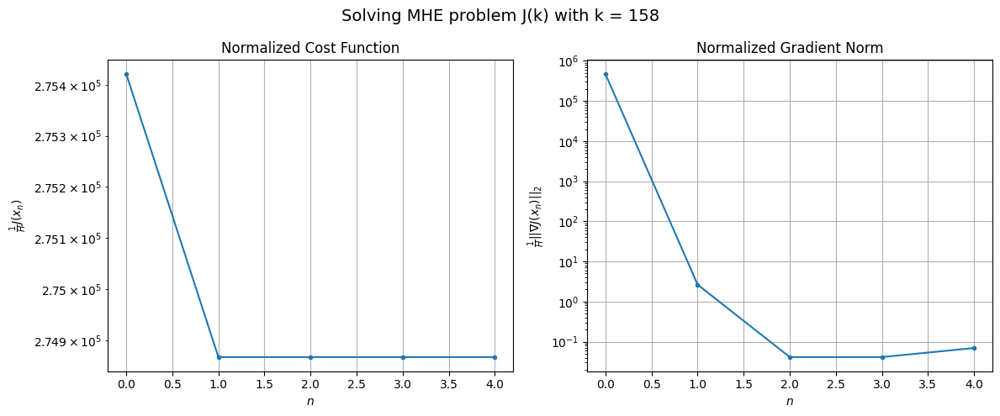

Windows:  20%|██        | 60/296 [17:13<1:07:50, 17.25s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 27403669.30272806
Gradient norm: 52063490.31049918
Global estimation error: 257.010626328914
Initial conditions estimation errors: 128.41051451470346 m, 128.91850804991358 m, 128.04726479930486 m, 128.64334465917148 m
Position estimation errors: 121.93555851185113 m, 121.4773546032875 m, 122.11904195421761 m, 121.10208423582702 m

[Gauss-Newton] Iteration 1
Cost function: 27343693.29006636 (-0.22%)
Gradient norm: 440.24681497746184 (-100.00%)
Global estimation error: 266.092161585003 (3.53%)
Initial conditions estimation errors: 133.01567601018226 m, 133.4694973226024 m, 132.51637504684396 m, 133.180946911404 m
Position estimation errors: 116.8830838838798 m, 116.49396652874343 m, 117.20837717922751 m, 116.12605002802661 m

[Gauss-Newton] Iteration 2
Cost function: 27343693.289912608 (-0.00%)
Gradient norm: 3.5515844816257345 (-99.19%)
Global estimation error: 266.09210905498696 (-0.00%)
Initial conditions estimation errors: 1

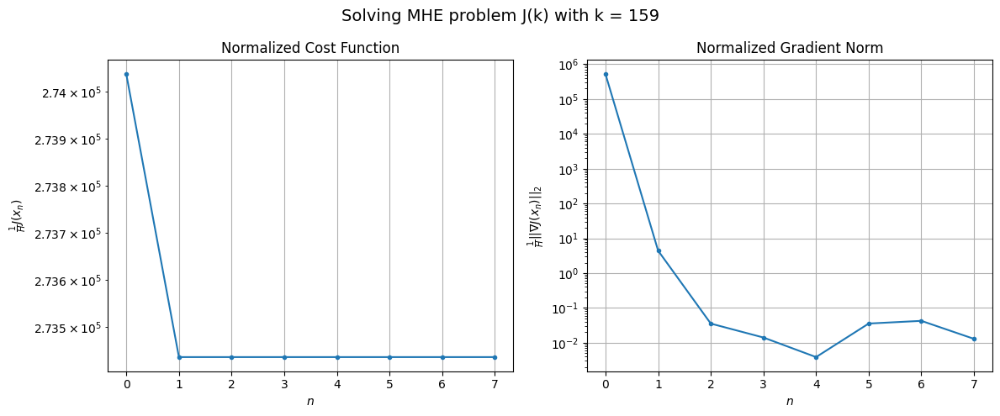

Windows:  21%|██        | 61/296 [17:35<1:13:45, 18.83s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 27242078.638762377
Gradient norm: 56824124.97804634
Global estimation error: 264.820802637532
Initial conditions estimation errors: 132.3820362080637 m, 132.79360153142682 m, 131.90418521072618 m, 132.5601457658741 m
Position estimation errors: 125.05955390210833 m, 124.72297013262599 m, 125.34715356855949 m, 124.313308328233 m

[Gauss-Newton] Iteration 1
Cost function: 27177558.605861567 (-0.24%)
Gradient norm: 704.2697530637167 (-100.00%)
Global estimation error: 274.2956722858771 (3.58%)
Initial conditions estimation errors: 137.1656398181574 m, 137.55108895940222 m, 136.60410033196533 m, 137.2687667229406 m
Position estimation errors: 119.7511456176158 m, 119.45577594966531 m, 120.10346381377634 m, 119.17124909065743 m

[Gauss-Newton] Iteration 2
Cost function: 27177558.605937466 (0.00%)
Gradient norm: 3.4452445328447268 (-99.51%)
Global estimation error: 274.295630431765 (-0.00%)
Initial conditions estimation errors: 137.

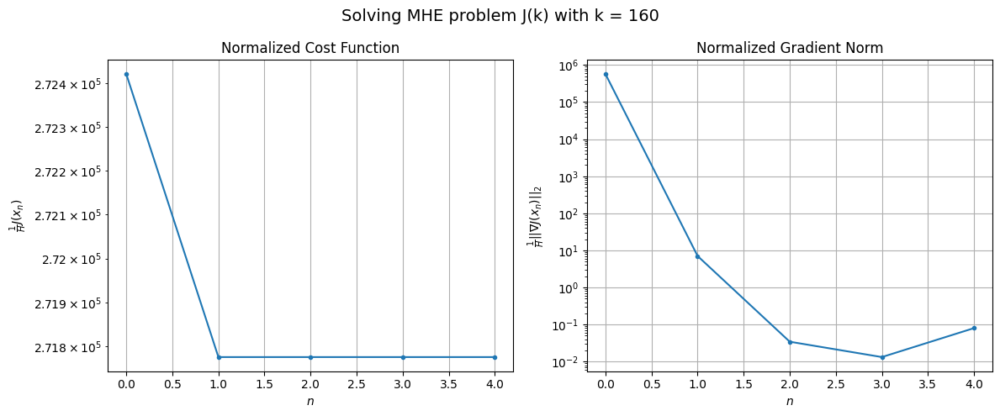

Windows:  21%|██        | 62/296 [17:49<1:07:20, 17.27s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 27053254.307501122
Gradient norm: 62260145.631146066
Global estimation error: 272.207227631675
Initial conditions estimation errors: 136.12761582397366 m, 136.47007604232016 m, 135.59217041464944 m, 136.22305845032048 m
Position estimation errors: 127.66506797128127 m, 127.42358935226942 m, 127.974919681382 m, 127.11532823353255 m

[Gauss-Newton] Iteration 1
Cost function: 26984039.290844936 (-0.26%)
Gradient norm: 1004.9033271672128 (-100.00%)
Global estimation error: 282.01374182211106 (3.60%)
Initial conditions estimation errors: 141.08783316595708 m, 141.33717911088823 m, 140.60001015738803 m, 141.00144147482283 m
Position estimation errors: 122.09165511720767 m, 121.94572013798513 m, 122.37750614041197 m, 121.8063558787219 m

[Gauss-Newton] Iteration 2
Cost function: 26984039.290503312 (-0.00%)
Gradient norm: 8.732956063403776 (-99.13%)
Global estimation error: 282.01361207574274 (-0.00%)
Initial conditions estimation err

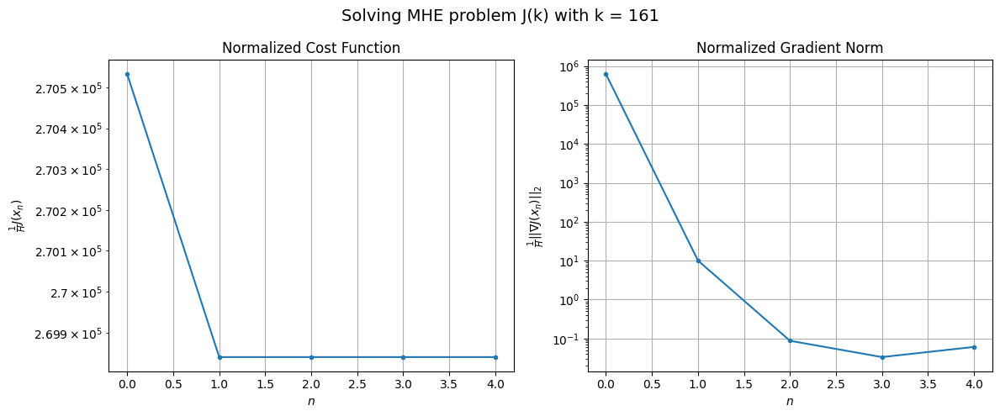

Windows:  21%|██▏       | 63/296 [18:03<1:03:12, 16.28s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 26831446.66312541
Gradient norm: 67509224.52675104
Global estimation error: 279.03717151470903
Initial conditions estimation errors: 139.6113740027651 m, 139.81761445868224 m, 139.14649590177547 m, 139.4979826468346 m
Position estimation errors: 129.740853515032 m, 129.64806411252042 m, 129.99056149160594 m, 129.50588896442034 m

[Gauss-Newton] Iteration 1
Cost function: 26757730.35700076 (-0.27%)
Gradient norm: 1347.3434249749728 (-100.00%)
Global estimation error: 289.0014239255274 (3.57%)
Initial conditions estimation errors: 144.7375780643961 m, 144.84922895967017 m, 144.1536883552566 m, 144.26109889268972 m
Position estimation errors: 123.90939880633476 m, 123.92537836460606 m, 124.25701962807325 m, 124.12306033675372 m

[Gauss-Newton] Iteration 2
Cost function: 26757730.35702618 (0.00%)
Gradient norm: 0.2849596694419023 (-99.98%)
Global estimation error: 289.00133301308864 (-0.00%)
Initial conditions estimation errors: 1

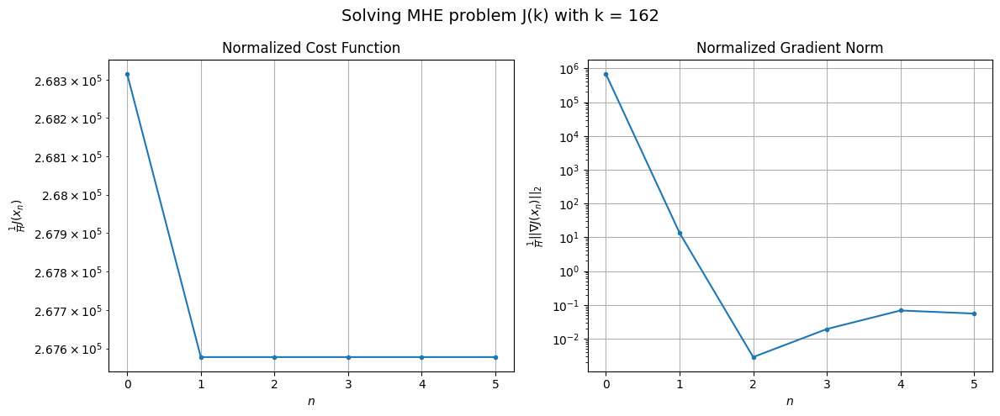

Windows:  22%|██▏       | 64/296 [18:19<1:02:55, 16.28s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 26571576.114895124
Gradient norm: 71769202.58925164
Global estimation error: 285.0704806654532
Initial conditions estimation errors: 142.7907975169911 m, 142.8533309966558 m, 142.22945027858196 m, 142.26618643576296 m
Position estimation errors: 131.24674272397175 m, 131.32064864598524 m, 131.55194763301023 m, 131.53163080231778 m

[Gauss-Newton] Iteration 1
Cost function: 26493869.4179888 (-0.29%)
Gradient norm: 1700.4154704989164 (-100.00%)
Global estimation error: 295.6437535989019 (3.71%)
Initial conditions estimation errors: 148.06765521241013 m, 148.07979596069976 m, 147.44088086549706 m, 147.69817633565575 m
Position estimation errors: 125.18113362358422 m, 125.26632185582451 m, 125.52957222637701 m, 125.2737211564224 m

[Gauss-Newton] Iteration 2
Cost function: 26493869.417733207 (-0.00%)
Gradient norm: 2.398701819616638 (-99.86%)
Global estimation error: 295.6437004641256 (-0.00%)
Initial conditions estimation errors:

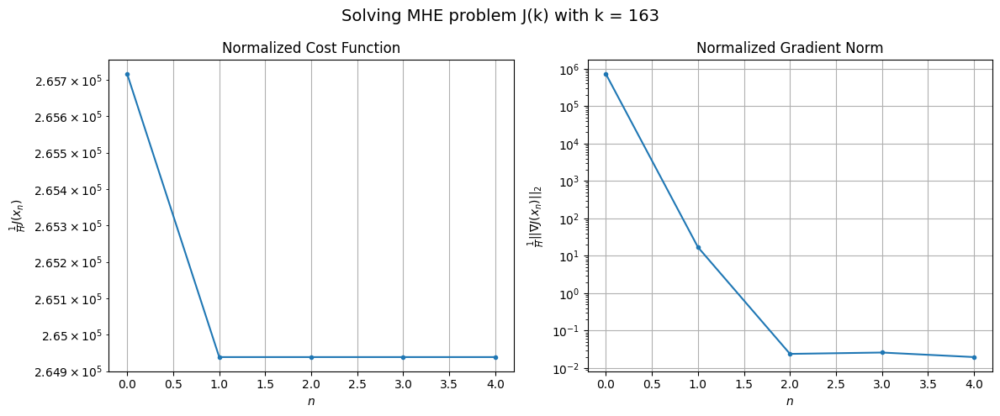

Windows:  22%|██▏       | 65/296 [18:34<1:00:45, 15.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 26269403.999252513
Gradient norm: 76088316.64941804
Global estimation error: 290.74442707004886
Initial conditions estimation errors: 145.63746993092587 m, 145.59738723879863 m, 145.03362250846394 m, 145.2194488465471 m
Position estimation errors: 132.12645861845374 m, 132.2648936113173 m, 132.42428456398508 m, 132.29017182911258 m

[Gauss-Newton] Iteration 1
Cost function: 26187966.088582847 (-0.31%)
Gradient norm: 2079.0998985321794 (-100.00%)
Global estimation error: 301.51371886179834 (3.70%)
Initial conditions estimation errors: 151.05471733609485 m, 151.03124021815944 m, 150.39683932198648 m, 150.5434845657178 m
Position estimation errors: 125.83570557787421 m, 125.94343693189595 m, 126.15692877044032 m, 126.05983613048525 m

[Gauss-Newton] Iteration 2
Cost function: 26187966.088973492 (0.00%)
Gradient norm: 1.0992315922813365 (-99.95%)
Global estimation error: 301.51371468610955 (-0.00%)
Initial conditions estimation er

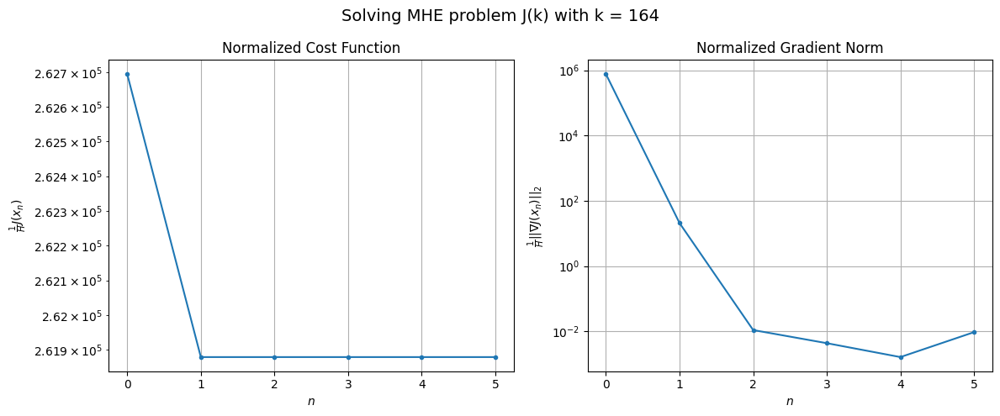

Windows:  22%|██▏       | 66/296 [18:52<1:03:53, 16.67s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 25924265.8405362
Gradient norm: 79671928.81008516
Global estimation error: 295.68812738474355
Initial conditions estimation errors: 148.1588729912181 m, 148.08370049891226 m, 147.5279221240805 m, 147.60465731827173 m
Position estimation errors: 132.29920463233293 m, 132.45417045191064 m, 132.55539106492407 m, 132.58358729645823 m

[Gauss-Newton] Iteration 1
Cost function: 25839592.08379847 (-0.33%)
Gradient norm: 2486.9658618990943 (-100.00%)
Global estimation error: 306.54408643248206 (3.67%)
Initial conditions estimation errors: 153.70082054890915 m, 153.53766326214281 m, 152.90254954650467 m, 152.9454782827884 m
Position estimation errors: 125.80358368329455 m, 126.01964057426721 m, 126.12277968260304 m, 126.28501076325276 m

[Gauss-Newton] Iteration 2
Cost function: 25839592.083833713 (0.00%)
Gradient norm: 3.4759267666896183 (-99.86%)
Global estimation error: 306.54403796174637 (-0.00%)
Initial conditions estimation error

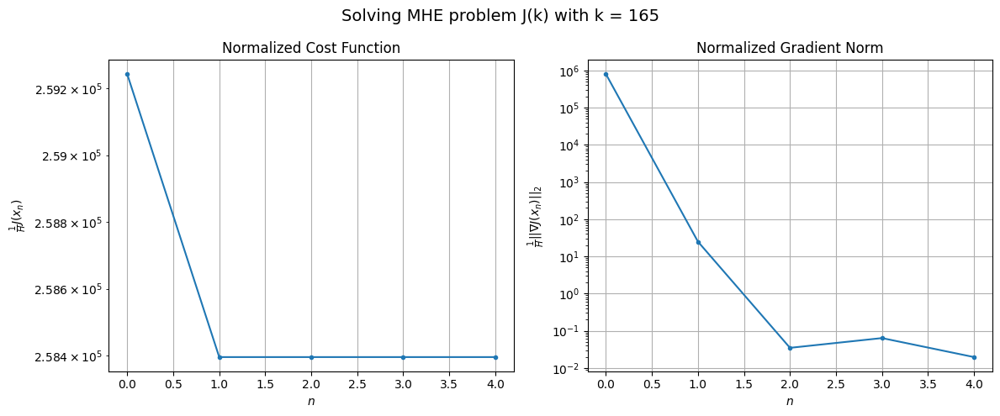

Windows:  23%|██▎       | 67/296 [19:09<1:03:33, 16.65s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 25526257.14211249
Gradient norm: 82364126.70208377
Global estimation error: 299.86782115724304
Initial conditions estimation errors: 150.37980796359994 m, 150.1636089880643 m, 149.61593566450748 m, 149.57463459945333 m
Position estimation errors: 131.698639375109 m, 131.9504007246653 m, 131.91845308219945 m, 132.23355580090293 m

[Gauss-Newton] Iteration 1
Cost function: 25439066.57231206 (-0.34%)
Gradient norm: 2862.9560257070825 (-100.00%)
Global estimation error: 311.10373743350306 (3.75%)
Initial conditions estimation errors: 156.02938573362715 m, 155.68916083181938 m, 155.3147384134555 m, 155.17270698967312 m
Position estimation errors: 125.03423830402195 m, 125.38518117585423 m, 125.29694362374327 m, 125.59652981454487 m

[Gauss-Newton] Iteration 2
Cost function: 25439066.572209314 (-0.00%)
Gradient norm: 3.7225644406149336 (-99.87%)
Global estimation error: 311.1036303376442 (-0.00%)
Initial conditions estimation errors

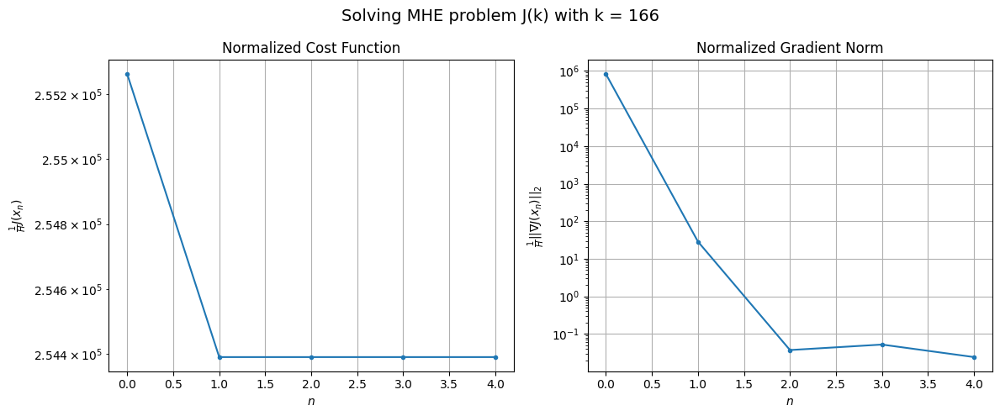

Windows:  23%|██▎       | 68/296 [19:25<1:02:44, 16.51s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 25068782.571101833
Gradient norm: 83831326.57227966
Global estimation error: 303.66986015635473
Initial conditions estimation errors: 152.32010196162472 m, 151.94176688539616 m, 151.64525736072088 m, 151.4310668639834 m
Position estimation errors: 130.2820493825638 m, 130.65047150247818 m, 130.44806561520363 m, 130.87919635202866 m

[Gauss-Newton] Iteration 1
Cost function: 24979713.715599425 (-0.36%)
Gradient norm: 3304.6294558166114 (-100.00%)
Global estimation error: 315.00975495363764 (3.73%)
Initial conditions estimation errors: 158.06063710918053 m, 157.62554386799005 m, 157.35443623330582 m, 156.97685080544449 m
Position estimation errors: 123.48174826928914 m, 123.89572853753295 m, 123.68530111930694 m, 124.26053700177839 m

[Gauss-Newton] Iteration 2
Cost function: 24979713.7155481 (-0.00%)
Gradient norm: 3.6717644542402583 (-99.89%)
Global estimation error: 315.00972874652047 (-0.00%)
Initial conditions estimation er

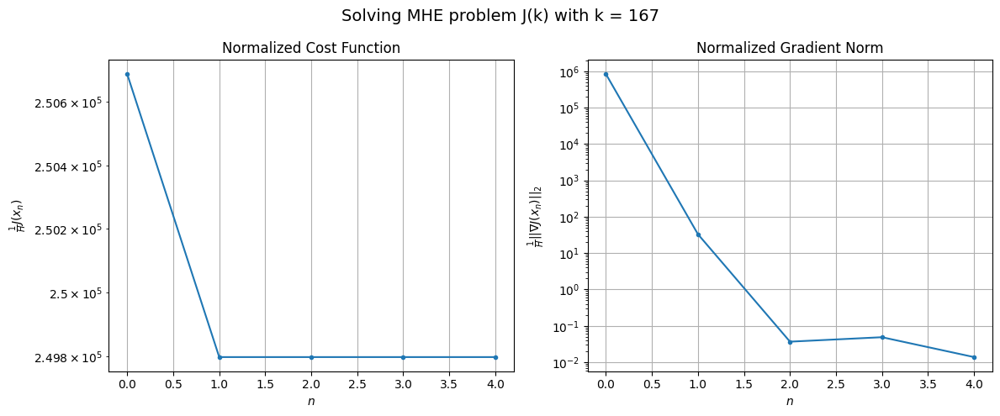

Windows:  23%|██▎       | 69/296 [19:42<1:02:11, 16.44s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 24546470.087708432
Gradient norm: 83939464.31173134
Global estimation error: 306.82787680198743
Initial conditions estimation errors: 153.97637013772984 m, 153.5036357068011 m, 153.3090983433455 m, 152.8644992394566 m
Position estimation errors: 128.01909251590394 m, 128.44552963652896 m, 128.12479173768708 m, 128.8209088294001 m

[Gauss-Newton] Iteration 1
Cost function: 24456404.525990874 (-0.37%)
Gradient norm: 3690.4237444358896 (-100.00%)
Global estimation error: 318.412837239476 (3.78%)
Initial conditions estimation errors: 159.78653732471187 m, 159.28255382124124 m, 159.05903068019717 m, 158.6955159473453 m
Position estimation errors: 121.13247593351879 m, 121.51061067671978 m, 121.20607179221672 m, 121.85482552317536 m

[Gauss-Newton] Iteration 2
Cost function: 24456404.526721008 (0.00%)
Gradient norm: 0.968605391070161 (-99.97%)
Global estimation error: 318.4127877242757 (-0.00%)
Initial conditions estimation errors: 

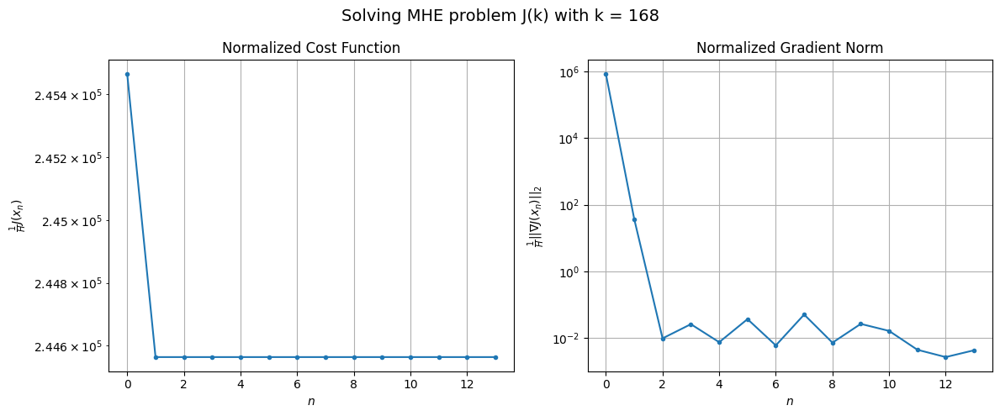

Windows:  24%|██▎       | 70/296 [20:26<1:33:45, 24.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 23959453.638904028
Gradient norm: 83781418.79523712
Global estimation error: 309.49079315041485
Initial conditions estimation errors: 155.32436045966898 m, 154.79447421549932 m, 154.6457013412215 m, 154.2149271045866 m
Position estimation errors: 124.93195602508979 m, 125.29628202922719 m, 124.88241469823485 m, 125.65427924186044 m

[Gauss-Newton] Iteration 1
Cost function: 23869280.850004416 (-0.38%)
Gradient norm: 4034.5254989311197 (-100.00%)
Global estimation error: 321.2588402318711 (3.80%)
Initial conditions estimation errors: 161.17455872189856 m, 160.68976604771714 m, 160.4785841903062 m, 160.1730236026352 m
Position estimation errors: 118.002866512162 m, 118.34950826918114 m, 118.0327557825841 m, 118.5692464753755 m

[Gauss-Newton] Iteration 2
Cost function: 23869280.850013785 (0.00%)
Gradient norm: 0.546421013499355 (-99.99%)
Global estimation error: 321.25883435915796 (-0.00%)
Initial conditions estimation errors: 1

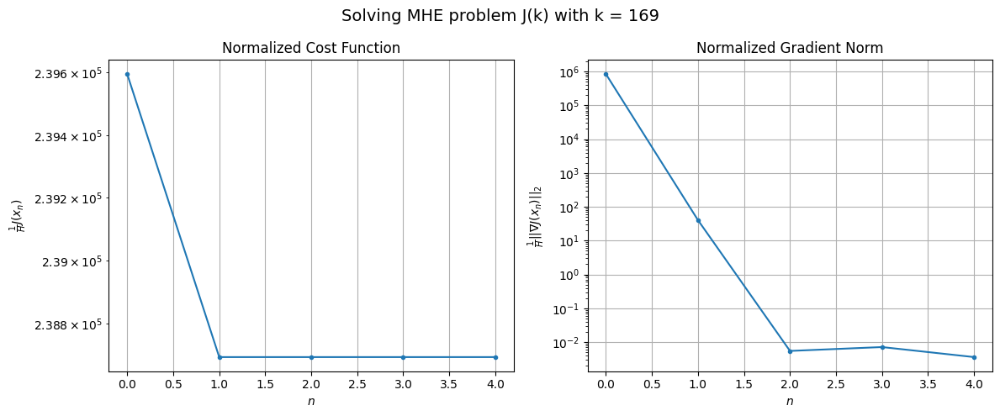

Windows:  24%|██▍       | 71/296 [20:40<1:21:19, 21.69s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 23302358.72545831
Gradient norm: 82389800.22042426
Global estimation error: 311.6036912546221
Initial conditions estimation errors: 156.3381566905021 m, 155.83335709091992 m, 155.69478204486958 m, 155.33932608115606 m
Position estimation errors: 121.07391783158678 m, 121.39790327295204 m, 120.9835908959583 m, 121.61098193567992 m

[Gauss-Newton] Iteration 1
Cost function: 23212750.82755182 (-0.38%)
Gradient norm: 4364.329949162149 (-99.99%)
Global estimation error: 323.48982995519003 (3.81%)
Initial conditions estimation errors: 162.20901990881754 m, 161.76396657354152 m, 161.63860615845644 m, 161.3668100569742 m
Position estimation errors: 114.14318692499765 m, 114.4265299353199 m, 114.04290001174799 m, 114.51554187820173 m

[Gauss-Newton] Iteration 2
Cost function: 23212750.827142794 (-0.00%)
Gradient norm: 3.227632955323206 (-99.93%)
Global estimation error: 323.4897922415004 (-0.00%)
Initial conditions estimation errors: 1

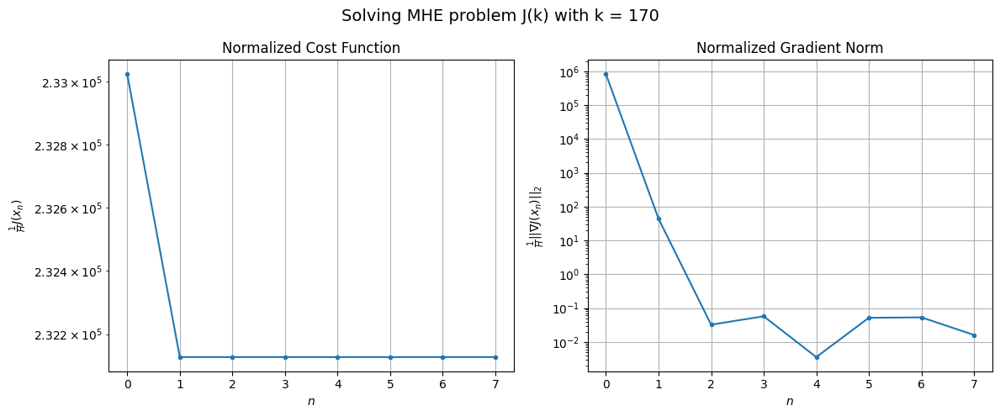

Windows:  24%|██▍       | 72/296 [21:01<1:19:47, 21.37s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 22579866.129712638
Gradient norm: 80380251.26275039
Global estimation error: 313.14629255103154
Initial conditions estimation errors: 157.02025393420405 m, 156.56585401662701 m, 156.50909304170787 m, 156.1961464343461 m
Position estimation errors: 116.5145995546294 m, 116.76138853495011 m, 116.29418373986798 m, 116.83711745326876 m

[Gauss-Newton] Iteration 1
Cost function: 22491930.537577953 (-0.39%)
Gradient norm: 4590.9836680868775 (-99.99%)
Global estimation error: 324.8798874486643 (3.75%)
Initial conditions estimation errors: 162.87354841510057 m, 162.48242004478016 m, 162.41676867065487 m, 161.98568116962775 m
Position estimation errors: 109.63584361015936 m, 109.8792975699278 m, 109.49914001963252 m, 110.13562355614846 m

[Gauss-Newton] Iteration 2
Cost function: 22491930.53782293 (0.00%)
Gradient norm: 2.1639582029348277 (-99.95%)
Global estimation error: 324.8798739848334 (-0.00%)
Initial conditions estimation errors

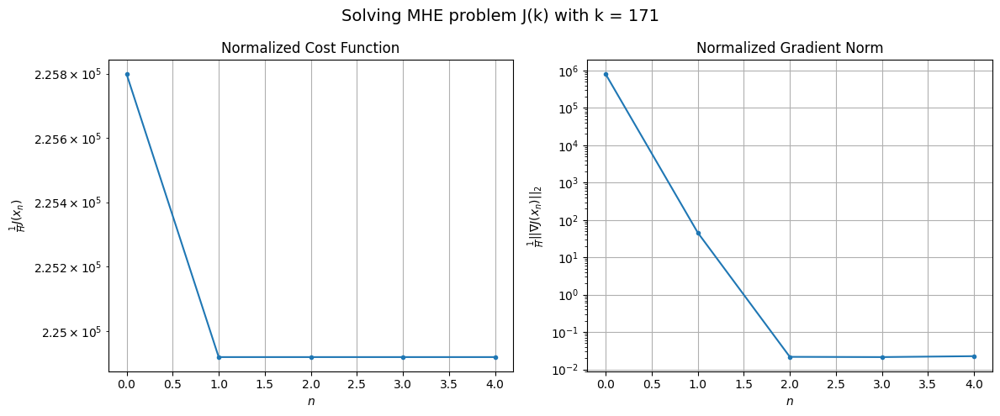

Windows:  25%|██▍       | 73/296 [21:14<1:10:25, 18.95s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 21787028.603937026
Gradient norm: 77744198.36121482
Global estimation error: 313.89091565671526
Initial conditions estimation errors: 157.3651939225978 m, 156.96449534384323 m, 156.96224513384112 m, 156.48851582913994 m
Position estimation errors: 111.34357870735161 m, 111.55454025093502 m, 111.11455065660937 m, 111.80540770648375 m

[Gauss-Newton] Iteration 1
Cost function: 21701484.091113854 (-0.39%)
Gradient norm: 4757.523694553765 (-99.99%)
Global estimation error: 325.3956481785017 (3.67%)
Initial conditions estimation errors: 163.1694008845553 m, 162.68132343316464 m, 162.66149101145828 m, 162.27769346143228 m
Position estimation errors: 104.55185394392755 m, 104.8816193928301 m, 104.36475453007553 m, 105.06425922454018 m

[Gauss-Newton] Iteration 2
Cost function: 21701484.091524802 (0.00%)
Gradient norm: 5.480108442382392 (-99.88%)
Global estimation error: 325.39570016851843 (0.00%)
Initial conditions estimation errors:

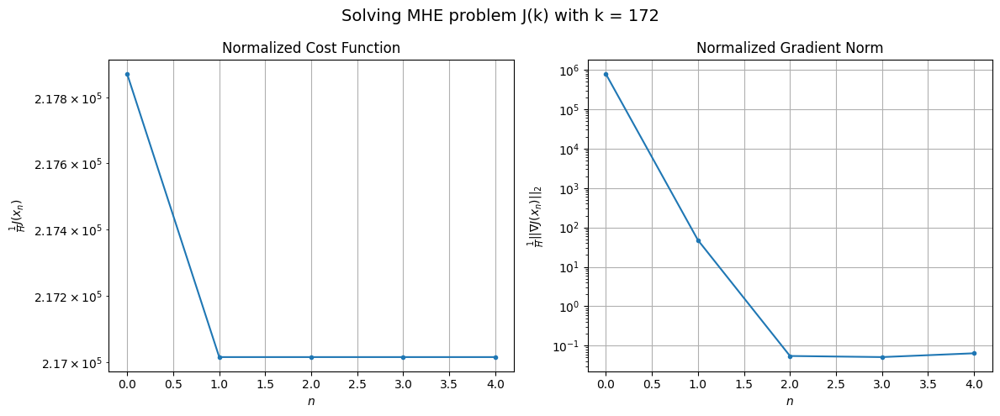

Windows:  25%|██▌       | 74/296 [21:28<1:03:57, 17.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 20928488.96595134
Gradient norm: 74803214.40603362
Global estimation error: 313.8241136529158
Initial conditions estimation errors: 157.3707531227924 m, 156.8674832592487 m, 156.9206406040609 m, 156.48793002370672 m
Position estimation errors: 105.63685591643794 m, 105.92751148965077 m, 105.33983574506388 m, 106.10412368209911 m

[Gauss-Newton] Iteration 1
Cost function: 20845901.638801195 (-0.39%)
Gradient norm: 4862.236532705766 (-99.99%)
Global estimation error: 325.123185634805 (3.60%)
Initial conditions estimation errors: 163.09853397122347 m, 162.5059509348154 m, 162.53522895564961 m, 162.10494314438313 m
Position estimation errors: 98.96212181119074 m, 99.39491343253063 m, 98.82959078866823 m, 99.51970883298812 m

[Gauss-Newton] Iteration 2
Cost function: 20845901.638810832 (0.00%)
Gradient norm: 1.2442484724370497 (-99.97%)
Global estimation error: 325.12324486381993 (0.00%)
Initial conditions estimation errors: 163.09

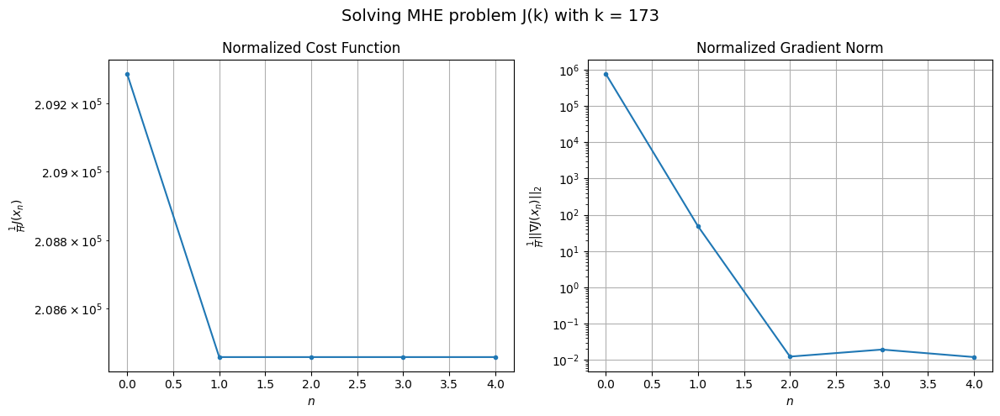

Windows:  25%|██▌       | 75/296 [21:41<59:18, 16.10s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 20010335.90073931
Gradient norm: 71528383.59827049
Global estimation error: 313.0172291743573
Initial conditions estimation errors: 157.03188921982832 m, 156.42071971261606 m, 156.5236440224841 m, 156.05646888620922 m
Position estimation errors: 99.46401349451575 m, 99.86029283192482 m, 99.23226011815824 m, 99.96102942491397 m

[Gauss-Newton] Iteration 1
Cost function: 19931244.3678529 (-0.40%)
Gradient norm: 4839.596438907588 (-99.99%)
Global estimation error: 324.145076421725 (3.56%)
Initial conditions estimation errors: 162.65593727148473 m, 161.92875701859373 m, 162.14376764931032 m, 161.5595618477627 m
Position estimation errors: 92.93502189737495 m, 93.61968747379656 m, 92.74206265039868 m, 93.7368329133792 m

[Gauss-Newton] Iteration 2
Cost function: 19931244.367900223 (0.00%)
Gradient norm: 6.424886309787065 (-99.87%)
Global estimation error: 324.1451799250262 (0.00%)
Initial conditions estimation errors: 162.655939230

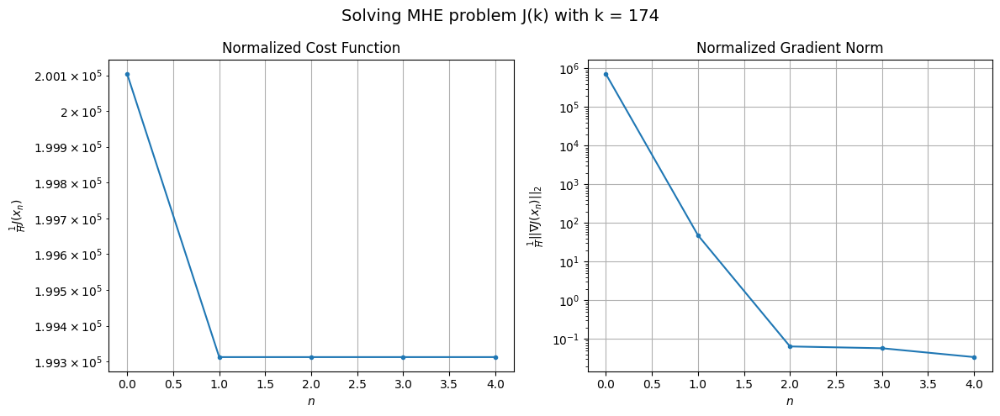

Windows:  26%|██▌       | 76/296 [21:54<55:49, 15.22s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 19037582.027396932
Gradient norm: 67967269.38261263
Global estimation error: 311.5202010362316
Initial conditions estimation errors: 156.3375743447392 m, 155.57512791387703 m, 155.8805705025973 m, 155.24485652139822 m
Position estimation errors: 92.87210810306384 m, 93.54182024942334 m, 92.58225768936838 m, 93.63724507035462 m

[Gauss-Newton] Iteration 1
Cost function: 18962845.737121288 (-0.39%)
Gradient norm: 4737.285435779905 (-99.99%)
Global estimation error: 322.55010376945023 (3.54%)
Initial conditions estimation errors: 161.8168810206066 m, 161.0716401601423 m, 161.3381541125255 m, 160.87177967980108 m
Position estimation errors: 86.53057415572302 m, 87.31545786023577 m, 86.29729154460088 m, 87.27869022492105 m

[Gauss-Newton] Iteration 2
Cost function: 18962845.737257116 (0.00%)
Gradient norm: 0.9696670912077872 (-99.98%)
Global estimation error: 322.55014616634725 (0.00%)
Initial conditions estimation errors: 161.8168

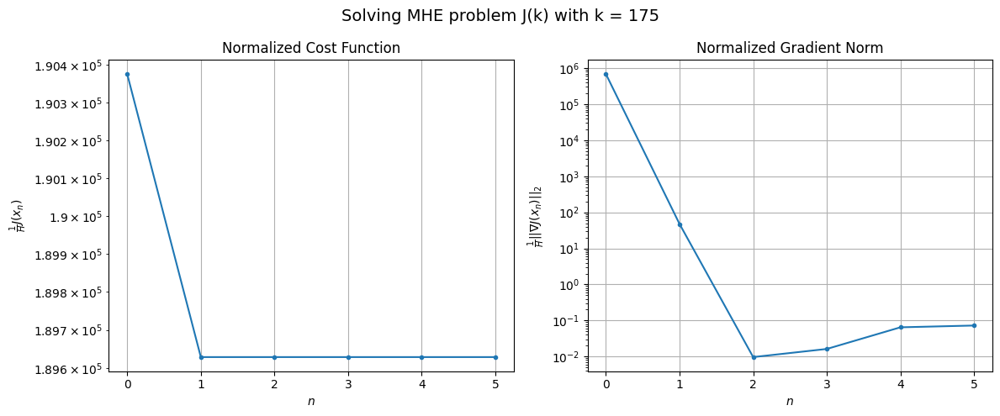

Windows:  26%|██▌       | 77/296 [22:10<55:43, 15.27s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 18026619.021526586
Gradient norm: 63995698.19203399
Global estimation error: 309.4247595883669
Initial conditions estimation errors: 155.2501418379852 m, 154.46191840218185 m, 154.82781499524486 m, 154.30773085971742 m
Position estimation errors: 85.89536715683452 m, 86.68477574864303 m, 85.56632977339859 m, 86.62410825806727 m

[Gauss-Newton] Iteration 1
Cost function: 17956496.47339099 (-0.39%)
Gradient norm: 4581.306967810057 (-99.99%)
Global estimation error: 319.9629459801593 (3.41%)
Initial conditions estimation errors: 160.56772505945293 m, 159.64952419036177 m, 160.10999132592207 m, 159.5965114162339 m
Position estimation errors: 79.76481955329977 m, 80.68266302830656 m, 79.47442649916557 m, 80.4975688696831 m

[Gauss-Newton] Iteration 2
Cost function: 17956496.47402797 (0.00%)
Gradient norm: 1.439062479645546 (-99.97%)
Global estimation error: 319.9630099503059 (0.00%)
Initial conditions estimation errors: 160.5677284

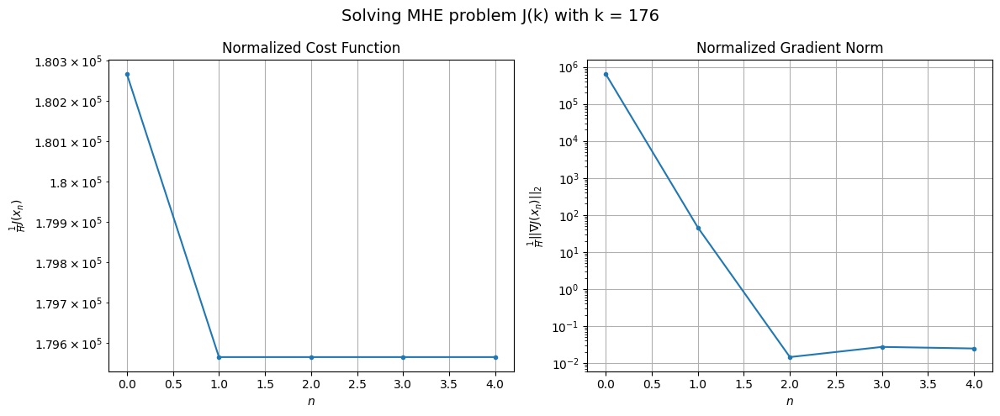

Windows:  26%|██▋       | 78/296 [22:23<53:21, 14.68s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 16977553.441356957
Gradient norm: 59632822.96318547
Global estimation error: 306.3141153921868
Initial conditions estimation errors: 153.73424604154354 m, 152.77657345097668 m, 153.33637166285627 m, 152.77869192025403 m
Position estimation errors: 78.55555695520688 m, 79.47439645488289 m, 78.16728745356886 m, 79.25689850881724 m

[Gauss-Newton] Iteration 1
Cost function: 16912589.891308166 (-0.38%)
Gradient norm: 4328.966381188643 (-99.99%)
Global estimation error: 316.7971642788354 (3.42%)
Initial conditions estimation errors: 158.8613976304479 m, 157.98897951034786 m, 158.54198632264897 m, 158.20035293961192 m
Position estimation errors: 72.67557961826843 m, 73.60519933804018 m, 72.23825653117383 m, 73.23068772173646 m

[Gauss-Newton] Iteration 2
Cost function: 16912589.89184857 (0.00%)
Gradient norm: 1.449413706314262 (-99.97%)
Global estimation error: 316.79712212214804 (-0.00%)
Initial conditions estimation errors: 158.86

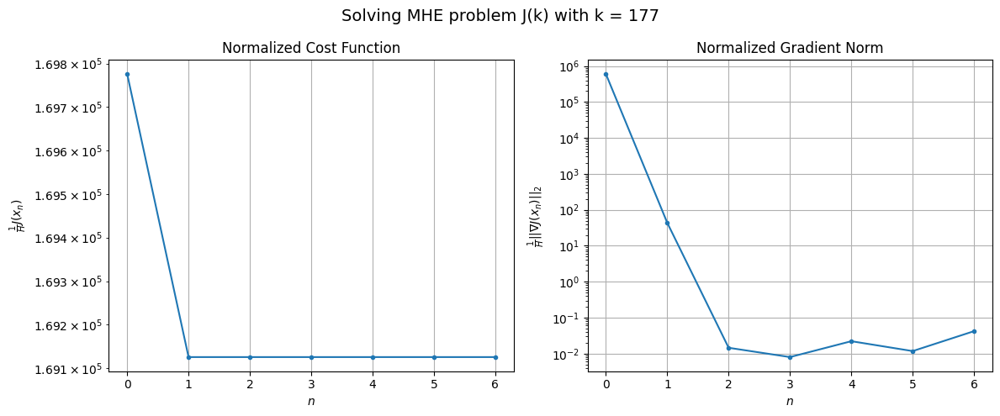

Windows:  27%|██▋       | 79/296 [22:41<56:37, 15.66s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15900812.680066442
Gradient norm: 55193400.30949611
Global estimation error: 302.5502612847167
Initial conditions estimation errors: 151.72797241100002 m, 150.81673275932297 m, 151.4712703377152 m, 151.08269545572813 m
Position estimation errors: 70.9366316316118 m, 71.87662992726767 m, 70.40149368919418 m, 71.4767445596187 m

[Gauss-Newton] Iteration 1
Cost function: 15841114.341507152 (-0.38%)
Gradient norm: 4056.8261149051423 (-99.99%)
Global estimation error: 312.2460928375636 (3.20%)
Initial conditions estimation errors: 156.64814747776654 m, 155.6502012896014 m, 156.25154916461537 m, 155.94029742671776 m
Position estimation errors: 65.3265002362734 m, 66.37705618847887 m, 65.06324360822556 m, 66.02348553434057 m

[Gauss-Newton] Iteration 2
Cost function: 15841114.341164503 (-0.00%)
Gradient norm: 2.585984538448487 (-99.94%)
Global estimation error: 312.2461948297659 (0.00%)
Initial conditions estimation errors: 156.64815

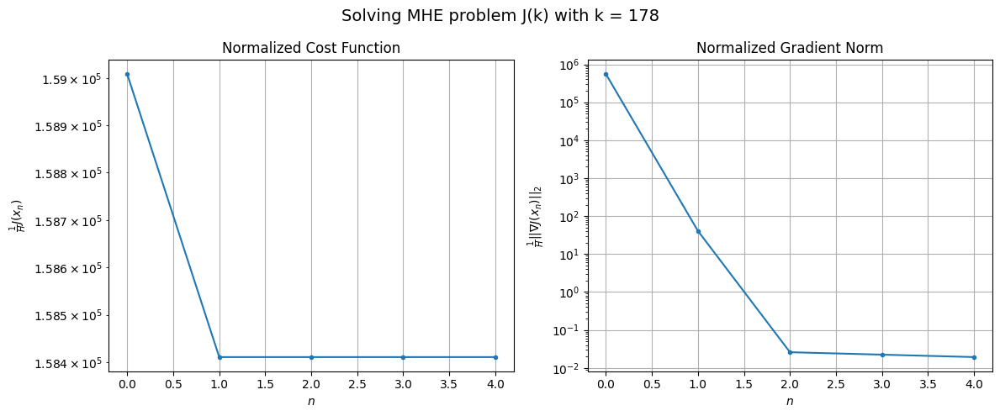

Windows:  27%|██▋       | 80/296 [22:54<53:38, 14.90s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14811898.164473804
Gradient norm: 50059961.92666984
Global estimation error: 297.3480398696336
Initial conditions estimation errors: 149.19020889332018 m, 148.15904922983478 m, 148.8481742972608 m, 148.49640445683178 m
Position estimation errors: 63.15841552543546 m, 64.21463052619346 m, 62.82195004939487 m, 63.847352532862246 m

[Gauss-Newton] Iteration 1
Cost function: 14757806.820409514 (-0.37%)
Gradient norm: 3732.60349470484 (-99.99%)
Global estimation error: 306.8998111081503 (3.21%)
Initial conditions estimation errors: 153.87867140832265 m, 152.9867921803238 m, 153.6735271846701 m, 153.25880472888431 m
Position estimation errors: 57.861573734625246 m, 58.89154219069139 m, 57.482028993935614 m, 58.55103237163411 m

[Gauss-Newton] Iteration 2
Cost function: 14757806.819763971 (-0.00%)
Gradient norm: 1.8014935051884762 (-99.95%)
Global estimation error: 306.89971617585275 (-0.00%)
Initial conditions estimation errors: 153

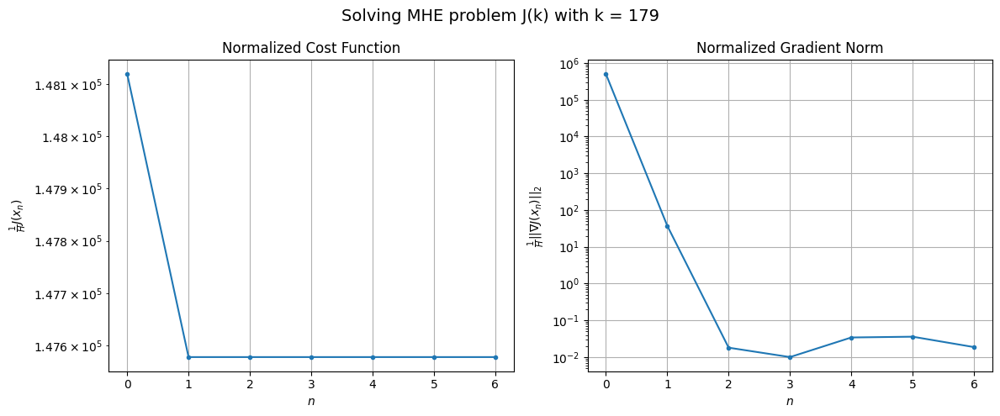

Windows:  27%|██▋       | 81/296 [23:12<56:56, 15.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13724947.400368225
Gradient norm: 45322271.35555786
Global estimation error: 291.37043068529505
Initial conditions estimation errors: 146.1018508152893 m, 145.18105047553937 m, 145.9552524881883 m, 145.5006081516251 m
Position estimation errors: 55.40494480191661 m, 56.44854677662499 m, 54.96927375292755 m, 56.087009111362754 m

[Gauss-Newton] Iteration 1
Cost function: 13676407.721827306 (-0.35%)
Gradient norm: 3370.277057721016 (-99.99%)
Global estimation error: 300.3472463334952 (3.08%)
Initial conditions estimation errors: 150.5437003738528 m, 149.757938656762 m, 150.3635823753199 m, 150.02778622423088 m
Position estimation errors: 50.44461972695895 m, 51.36238850634557 m, 50.085227181105815 m, 50.944755324905266 m

[Gauss-Newton] Iteration 2
Cost function: 13676407.721711269 (-0.00%)
Gradient norm: 1.628422350880881 (-99.95%)
Global estimation error: 300.34709058097326 (-0.00%)
Initial conditions estimation errors: 150.54

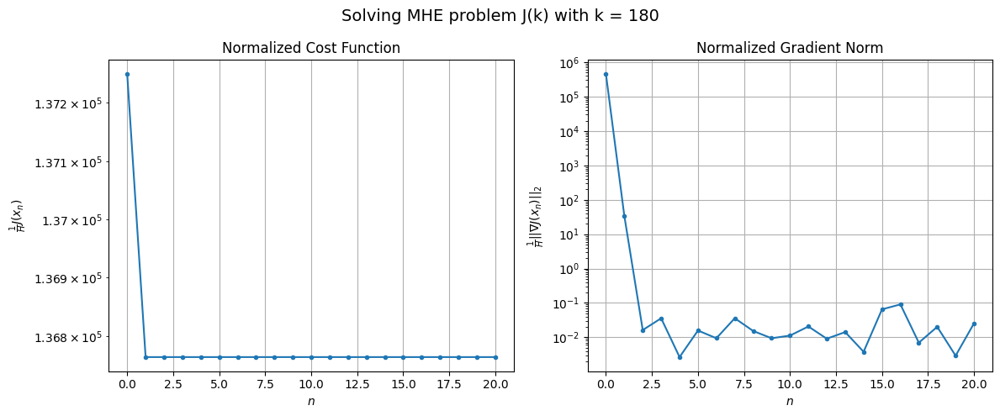

Windows:  28%|██▊       | 82/296 [24:04<1:35:10, 26.68s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12657668.583328938
Gradient norm: 40566381.97391311
Global estimation error: 284.2626662520437
Initial conditions estimation errors: 142.4811459066197 m, 141.68019323142155 m, 142.3575186525688 m, 142.00481091837227 m
Position estimation errors: 47.85271908004659 m, 48.77294289469013 m, 47.448267695340256 m, 48.319806503722724 m

[Gauss-Newton] Iteration 1
Cost function: 12614763.380802272 (-0.34%)
Gradient norm: 2969.0708340829137 (-99.99%)
Global estimation error: 292.76230839027846 (2.99%)
Initial conditions estimation errors: 146.65492508994478 m, 146.10859515740532 m, 146.62756501499817 m, 146.13232439032137 m
Position estimation errors: 43.278278278430754 m, 43.99097737436812 m, 42.83374243413122 m, 43.73136063394358 m

[Gauss-Newton] Iteration 2
Cost function: 12614763.38037763 (-0.00%)
Gradient norm: 4.126679354975231 (-99.86%)
Global estimation error: 292.7619392229582 (-0.00%)
Initial conditions estimation errors: 14

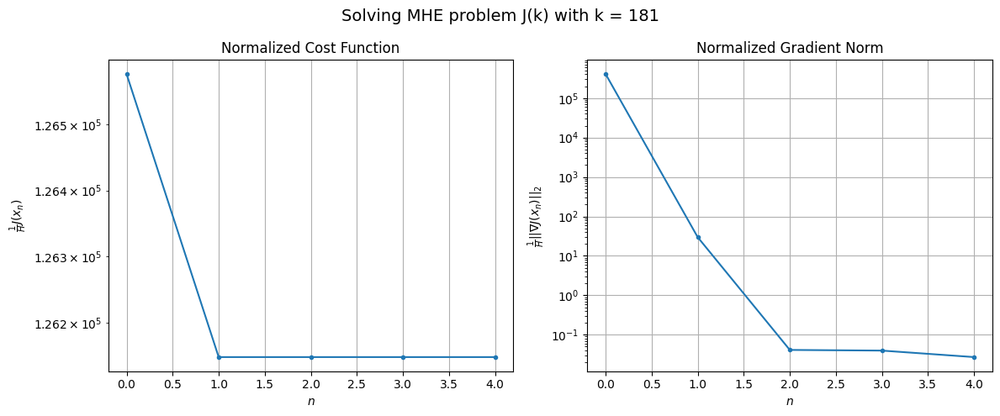

Windows:  28%|██▊       | 83/296 [24:17<1:20:03, 22.55s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11624792.857359817
Gradient norm: 35879943.63567782
Global estimation error: 276.20133854650794
Initial conditions estimation errors: 138.34779442109198 m, 137.7974784711053 m, 138.37701925693307 m, 137.8790780350957 m
Position estimation errors: 40.70431696299404 m, 41.41314438785561 m, 40.228570905332774 m, 41.10168068961849 m

[Gauss-Newton] Iteration 1
Cost function: 11587412.569579463 (-0.32%)
Gradient norm: 2588.4379524389738 (-99.99%)
Global estimation error: 283.82593360982526 (2.76%)
Initial conditions estimation errors: 142.23810796388275 m, 141.63685332957556 m, 142.21930446242152 m, 141.55588461995166 m
Position estimation errors: 36.58260954790854 m, 37.429537658962474 m, 36.15044925432592 m, 37.13657286961212 m

[Gauss-Newton] Iteration 2
Cost function: 11587412.569224447 (-0.00%)
Gradient norm: 4.03401955697904 (-99.84%)
Global estimation error: 283.8260403669825 (0.00%)
Initial conditions estimation errors: 142

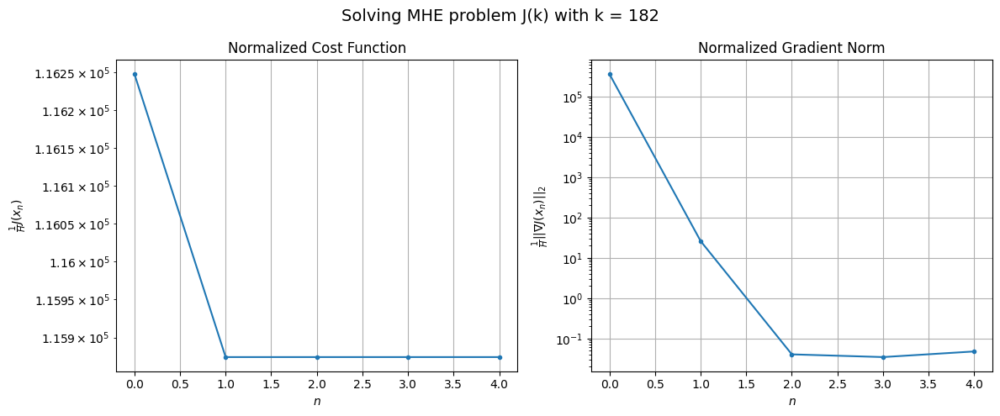

Windows:  28%|██▊       | 84/296 [24:30<1:09:56, 19.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10634409.800468307
Gradient norm: 31135081.630620677
Global estimation error: 266.8420307154602
Initial conditions estimation errors: 133.72323849221314 m, 133.10729810781186 m, 133.7543704755279 m, 133.09731508410067 m
Position estimation errors: 34.214650324432355 m, 35.047818420834446 m, 33.763376865030274 m, 34.68383806887955 m

[Gauss-Newton] Iteration 1
Cost function: 10602222.442061126 (-0.30%)
Gradient norm: 2201.2830324992406 (-99.99%)
Global estimation error: 274.2658203395796 (2.78%)
Initial conditions estimation errors: 137.3263393496436 m, 136.91373323955187 m, 137.44332784395667 m, 136.84696492986424 m
Position estimation errors: 30.65132697896627 m, 31.281352737787362 m, 30.146971190822594 m, 30.989504838269497 m

[Gauss-Newton] Iteration 2
Cost function: 10602222.442050846 (-0.00%)
Gradient norm: 0.8587568825615216 (-99.96%)
Global estimation error: 274.2654396982853 (-0.00%)
Initial conditions estimation error

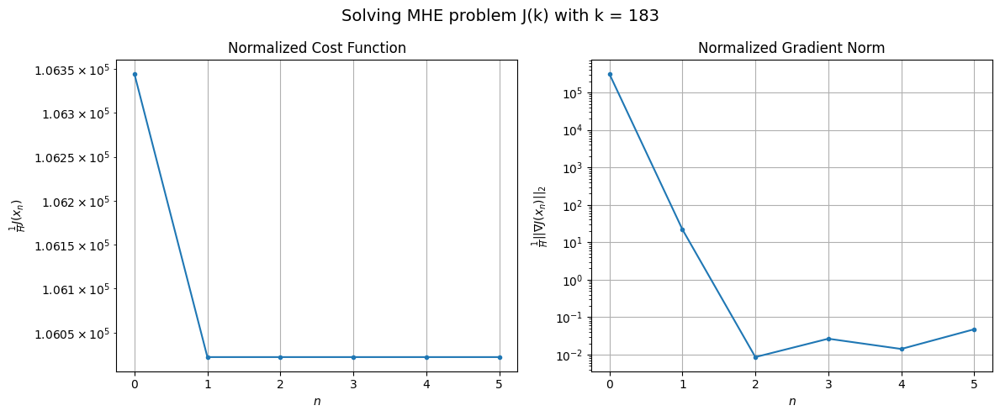

Windows:  29%|██▊       | 85/296 [24:46<1:05:20, 18.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 9701775.066863017
Gradient norm: 26449528.457313962
Global estimation error: 256.94893140882243
Initial conditions estimation errors: 128.6404635305091 m, 128.22387715527418 m, 128.80799352055539 m, 128.22415972561691 m
Position estimation errors: 28.809063685968294 m, 29.397375023170248 m, 28.320970899230502 m, 29.044226523626374 m

[Gauss-Newton] Iteration 1
Cost function: 9674655.630994197 (-0.28%)
Gradient norm: 1834.8962196025886 (-99.99%)
Global estimation error: 263.60899741387266 (2.59%)
Initial conditions estimation errors: 131.93792273425584 m, 131.63678818825784 m, 132.17324183220484 m, 131.4685888746766 m
Position estimation errors: 25.993302078142637 m, 26.414378240832256 m, 25.450798486500187 m, 26.213793203344682 m

[Gauss-Newton] Iteration 2
Cost function: 9674655.630818818 (-0.00%)
Gradient norm: 5.301775249321568 (-99.71%)
Global estimation error: 263.6087986217001 (-0.00%)
Initial conditions estimation error

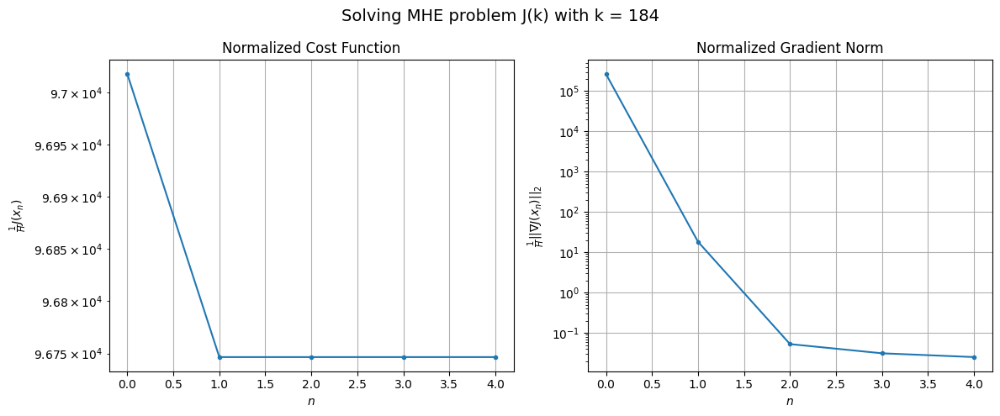

Windows:  29%|██▉       | 86/296 [24:59<59:14, 16.93s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 8835886.821232855
Gradient norm: 21870673.10563744
Global estimation error: 246.02608878389242
Initial conditions estimation errors: 123.11625764148349 m, 122.81878057866119 m, 123.40213574686555 m, 122.71346178053089 m
Position estimation errors: 25.184053998862783 m, 25.527474377124776 m, 24.723574109683597 m, 25.269488704002097 m

[Gauss-Newton] Iteration 1
Cost function: 8813454.258365147 (-0.25%)
Gradient norm: 1504.0731638225877 (-99.99%)
Global estimation error: 252.28243556632552 (2.54%)
Initial conditions estimation errors: 126.10179216105155 m, 125.96544739244159 m, 126.47758001546738 m, 126.01905668260852 m
Position estimation errors: 23.341360730041767 m, 23.506716939150312 m, 22.89075860716432 m, 23.231494269264658 m

[Gauss-Newton] Iteration 2
Cost function: 8813454.258331625 (-0.00%)
Gradient norm: 0.9514377700684105 (-99.94%)
Global estimation error: 252.28218070842175 (-0.00%)
Initial conditions estimation err

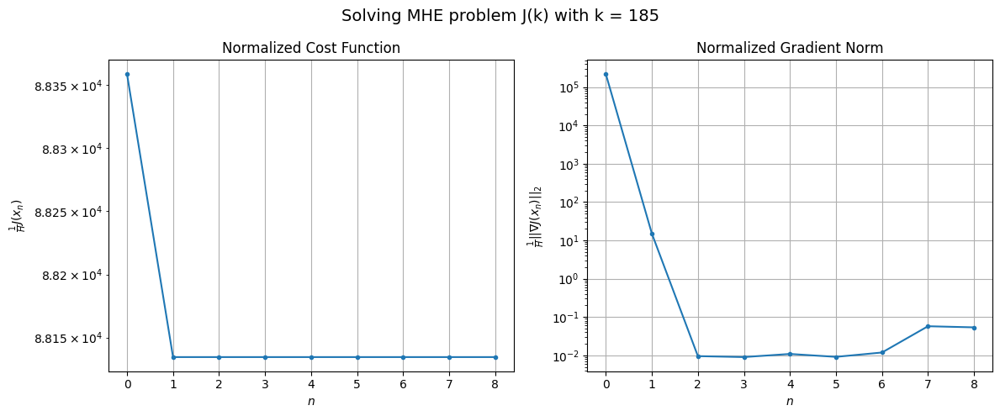

Windows:  29%|██▉       | 87/296 [25:22<1:04:57, 18.65s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8046708.075237984
Gradient norm: 17156051.953089554
Global estimation error: 234.47063117813568
Initial conditions estimation errors: 117.16412043196668 m, 117.0418007381701 m, 117.58977676778 m, 117.14441754709995 m
Position estimation errors: 24.066180582541033 m, 24.14604448386429 m, 23.778694954838357 m, 23.86609428052187 m

[Gauss-Newton] Iteration 1
Cost function: 8028532.339419735 (-0.23%)
Gradient norm: 1210.1863510325104 (-99.99%)
Global estimation error: 239.76648985682027 (2.26%)
Initial conditions estimation errors: 119.834902355639 m, 119.77680272466733 m, 120.22612081575218 m, 119.69406974140954 m
Position estimation errors: 23.29296481713288 m, 23.286890397304717 m, 23.089543325543683 m, 23.040844045996415 m

[Gauss-Newton] Iteration 2
Cost function: 8028532.339260948 (-0.00%)
Gradient norm: 3.69817538514729 (-99.69%)
Global estimation error: 239.76635465322997 (-0.00%)
Initial conditions estimation errors: 119.

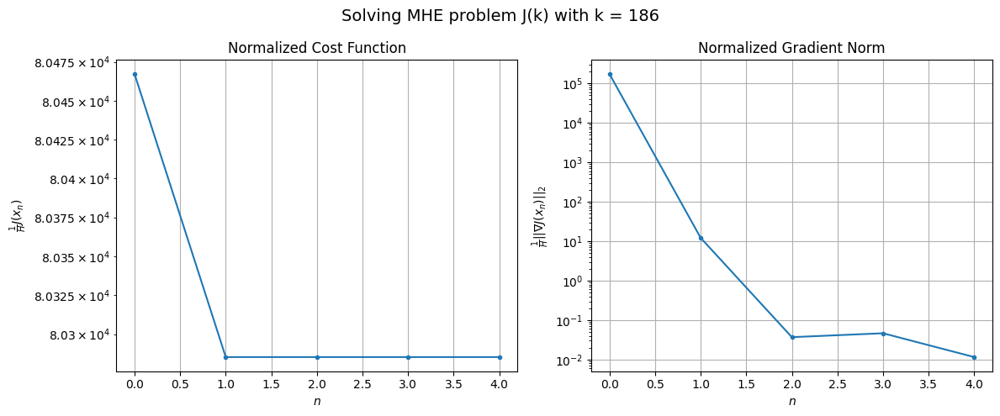

Windows:  30%|██▉       | 88/296 [25:35<58:57, 17.01s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 7344281.343915759
Gradient norm: 12717642.55077631
Global estimation error: 221.73442807998234
Initial conditions estimation errors: 110.78191691559125 m, 110.74374803473751 m, 111.21987975062346 m, 110.72212251114753 m
Position estimation errors: 25.651920863999813 m, 25.57903292741881 m, 25.628033635401337 m, 25.34278337836001 m

[Gauss-Newton] Iteration 1
Cost function: 7329992.356926762 (-0.19%)
Gradient norm: 947.8966415225457 (-99.99%)
Global estimation error: 226.28422628383905 (2.05%)
Initial conditions estimation errors: 113.12866685192789 m, 112.88800592951328 m, 113.44742625593805 m, 113.1032234561149 m
Position estimation errors: 25.72901513665057 m, 25.63588974114542 m, 25.77237020990931 m, 25.400488331589173 m

[Gauss-Newton] Iteration 2
Cost function: 7329992.357203397 (0.00%)
Gradient norm: 0.9744594174129173 (-99.90%)
Global estimation error: 226.28460549461263 (0.00%)
Initial conditions estimation errors: 113

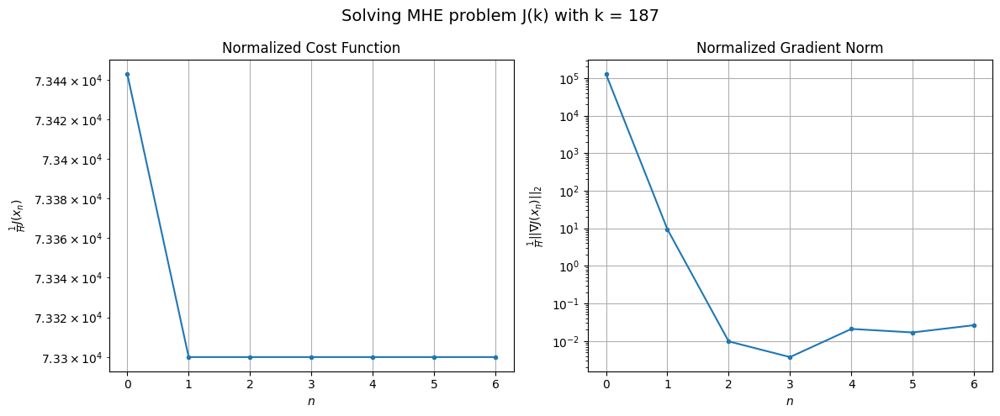

Windows:  30%|███       | 89/296 [25:52<59:08, 17.14s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6733407.298217236
Gradient norm: 8121221.890528791
Global estimation error: 208.01269450865286
Initial conditions estimation errors: 103.96286993676613 m, 103.74070069722755 m, 104.32112806038548 m, 103.99938739119466 m
Position estimation errors: 29.42642103369526 m, 29.255318307912777 m, 29.60404988343883 m, 29.06206847456226 m

[Gauss-Newton] Iteration 1
Cost function: 6722496.402614324 (-0.16%)
Gradient norm: 728.8108793738127 (-99.99%)
Global estimation error: 211.97846349274678 (1.91%)
Initial conditions estimation errors: 105.98482645403982 m, 105.70747974675982 m, 106.34456486949382 m, 105.91859161980526 m
Position estimation errors: 29.962884169151486 m, 29.76169517709167 m, 30.19092433468365 m, 29.588294620469792 m

[Gauss-Newton] Iteration 2
Cost function: 6722496.402797325 (0.00%)
Gradient norm: 1.9149577048674147 (-99.74%)
Global estimation error: 211.97852482038428 (0.00%)
Initial conditions estimation errors: 10

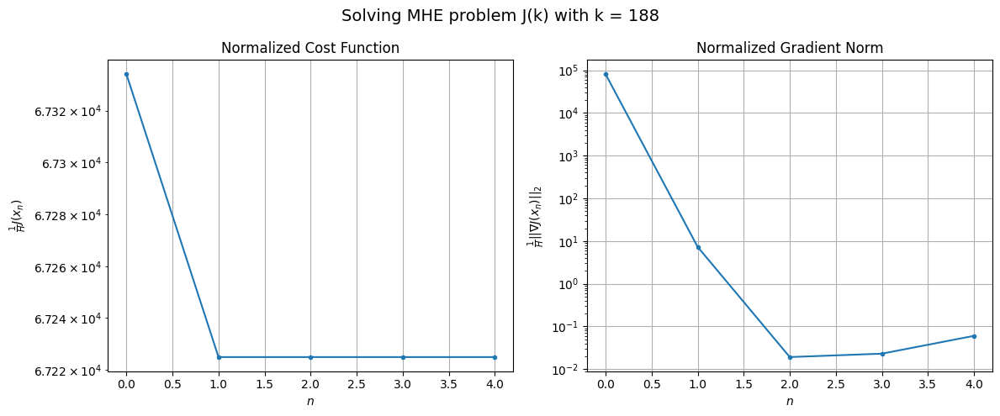

Windows:  30%|███       | 90/296 [26:05<54:34, 15.90s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6219672.131912215
Gradient norm: 3178629.5004107705
Global estimation error: 193.54025255058025
Initial conditions estimation errors: 96.73469125257401 m, 96.4748302889841 m, 97.13192442714397 m, 96.7373901483625 m
Position estimation errors: 34.6541844026064 m, 34.393972269226644 m, 34.99052876327808 m, 34.26696987942478 m

[Gauss-Newton] Iteration 1
Cost function: 6211655.253438905 (-0.13%)
Gradient norm: 563.9826309522173 (-99.98%)
Global estimation error: 196.99146918568735 (1.78%)
Initial conditions estimation errors: 98.42824380395746 m, 98.16967254517078 m, 98.84852012771789 m, 98.53477749288028 m
Position estimation errors: 35.328015176379246 m, 35.07055018041739 m, 35.697955930716724 m, 35.003018774320566 m

[Gauss-Newton] Iteration 2
Cost function: 6211655.253609678 (0.00%)
Gradient norm: 2.9572088506931937 (-99.48%)
Global estimation error: 196.99142786654627 (-0.00%)
Initial conditions estimation errors: 98.4282482

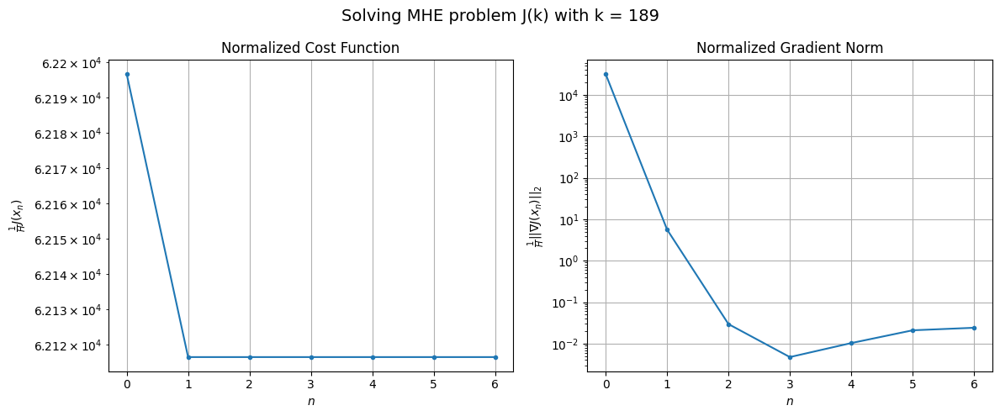

Windows:  31%|███       | 91/296 [26:24<56:49, 16.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5810863.393510192
Gradient norm: 2941336.121931563
Global estimation error: 178.49477865182558
Initial conditions estimation errors: 89.14666559633277 m, 88.90334540087238 m, 89.60171917073107 m, 89.33577345157035 m
Position estimation errors: 40.740785064569934 m, 40.445759783323 m, 41.193031976834895 m, 40.441316082468866 m

[Gauss-Newton] Iteration 1
Cost function: 5805212.059509453 (-0.10%)
Gradient norm: 420.5082215302203 (-99.99%)
Global estimation error: 181.01689285277723 (1.41%)
Initial conditions estimation errors: 90.50592614419664 m, 90.2604837946575 m, 90.88116959663921 m, 90.38443430563086 m
Position estimation errors: 41.32775976993556 m, 41.04337643647521 m, 41.80765655847208 m, 40.964682619186085 m

[Gauss-Newton] Iteration 2
Cost function: 5805212.059455553 (-0.00%)
Gradient norm: 5.1322738180342515 (-98.78%)
Global estimation error: 181.01689144883355 (-0.00%)
Initial conditions estimation errors: 90.5059299

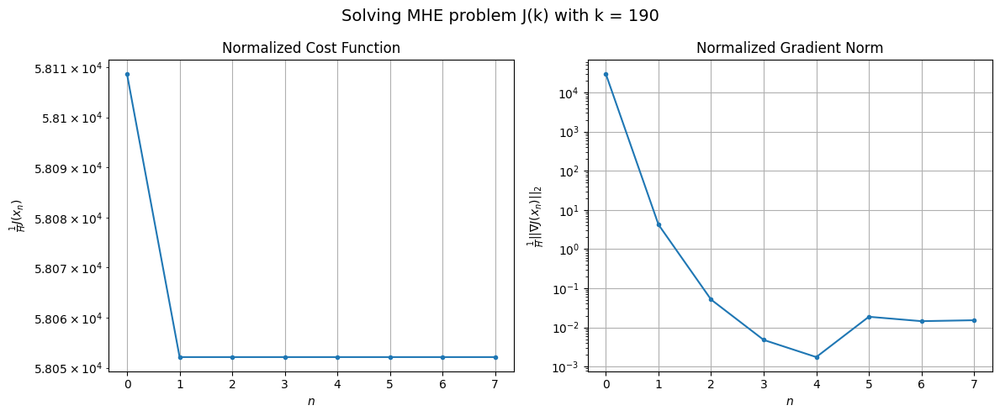

Windows:  31%|███       | 92/296 [26:45<1:01:30, 18.09s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5506852.283003766
Gradient norm: 8515514.876752505
Global estimation error: 162.58937088665104
Initial conditions estimation errors: 81.25494875846181 m, 81.03009359884362 m, 81.6646207786636 m, 81.22711993689443 m
Position estimation errors: 47.254345325192006 m, 46.9534040749573 m, 47.799715167227255 m, 46.92474108881358 m

[Gauss-Newton] Iteration 1
Cost function: 5502919.338612382 (-0.07%)
Gradient norm: 348.7293602930763 (-100.00%)
Global estimation error: 164.6242612539575 (1.25%)
Initial conditions estimation errors: 82.28497130937151 m, 82.09056348119702 m, 82.79147987327589 m, 82.07883617122842 m
Position estimation errors: 47.619302429652976 m, 47.32120293496404 m, 48.214505357027555 m, 47.22230987617474 m

[Gauss-Newton] Iteration 2
Cost function: 5502919.3385773245 (-0.00%)
Gradient norm: 0.38356171010907725 (-99.89%)
Global estimation error: 164.62416654166896 (-0.00%)
Initial conditions estimation errors: 82.2849

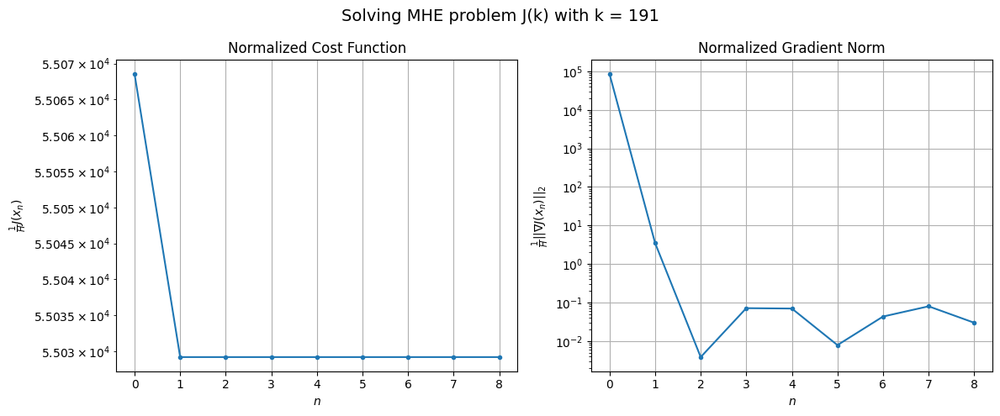

Windows:  31%|███▏      | 93/296 [27:08<1:06:23, 19.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5309029.230270588
Gradient norm: 14609870.946307937
Global estimation error: 146.37773472424
Initial conditions estimation errors: 73.12392619217108 m, 72.95053578658495 m, 73.66284809519057 m, 73.01528463842003 m
Position estimation errors: 53.933871257670795 m, 53.628443261013786 m, 54.58241443554056 m, 53.576078986504896 m

[Gauss-Newton] Iteration 1
Cost function: 5306105.540480687 (-0.06%)
Gradient norm: 319.68548429732715 (-100.00%)
Global estimation error: 147.75353045470982 (0.94%)
Initial conditions estimation errors: 73.84020297558473 m, 73.75655851273216 m, 74.35312828016109 m, 73.55411088776675 m
Position estimation errors: 53.99489899434496 m, 53.697475130178105 m, 54.643654849562544 m, 53.559444944106716 m

[Gauss-Newton] Iteration 2
Cost function: 5306105.5405231165 (0.00%)
Gradient norm: 3.9755724419670626 (-98.76%)
Global estimation error: 147.7533817716138 (-0.00%)
Initial conditions estimation errors: 73.840

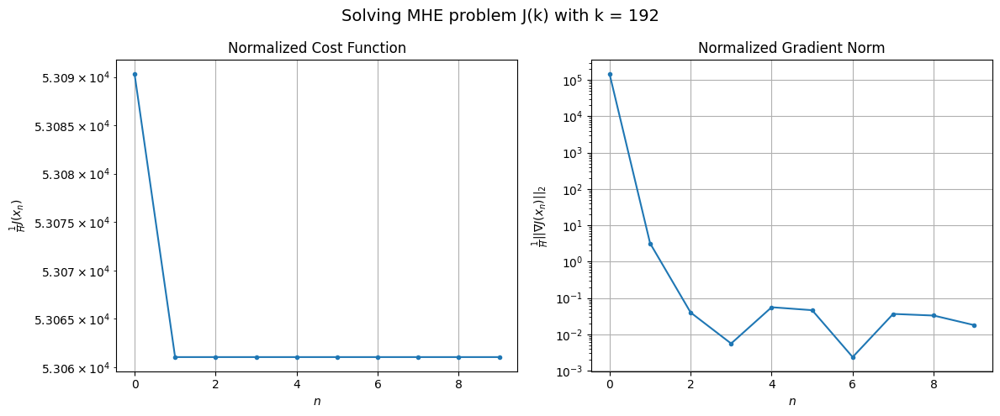

Windows:  32%|███▏      | 94/296 [27:34<1:12:10, 21.44s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5218013.003886841
Gradient norm: 21088206.910283152
Global estimation error: 129.7778117839472
Initial conditions estimation errors: 64.81424983017105 m, 64.75130459175395 m, 65.35328056694017 m, 64.63363730817532 m
Position estimation errors: 60.65033576347406 m, 60.3460826058714 m, 61.34000978532569 m, 60.26068849593894 m

[Gauss-Newton] Iteration 1
Cost function: 5215410.316938974 (-0.05%)
Gradient norm: 336.5607382705128 (-100.00%)
Global estimation error: 130.45666307428962 (0.52%)
Initial conditions estimation errors: 65.22384005502647 m, 65.12689199877634 m, 65.69372142293486 m, 64.86532573732313 m
Position estimation errors: 60.338711488457356 m, 60.049102268256135 m, 61.027857719111786 m, 59.85961358348149 m

[Gauss-Newton] Iteration 2
Cost function: 5215410.317143186 (0.00%)
Gradient norm: 5.496412730337505 (-98.37%)
Global estimation error: 130.45668609022616 (0.00%)
Initial conditions estimation errors: 65.22384173

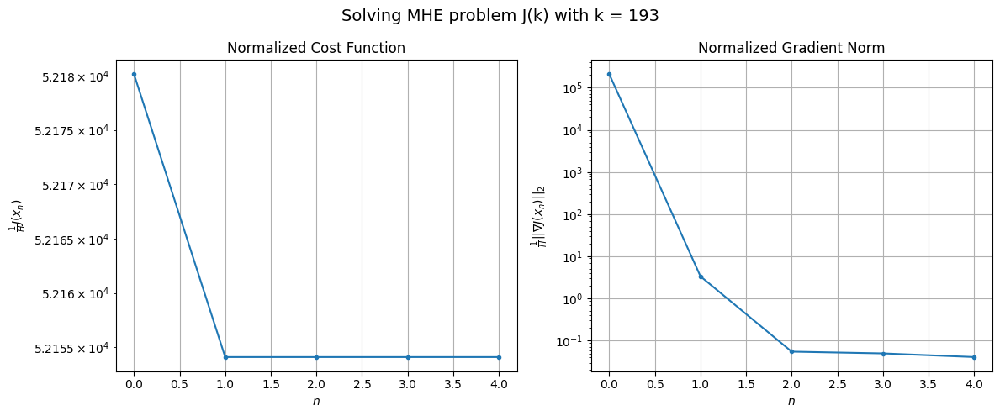

Windows:  32%|███▏      | 95/296 [27:48<1:04:04, 19.13s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5229695.485441297
Gradient norm: 27783496.07500397
Global estimation error: 112.79189929272479
Initial conditions estimation errors: 56.35093074095267 m, 56.283721623669955 m, 56.844078293238326 m, 56.10148600681517 m
Position estimation errors: 67.32806256533888 m, 67.04242800891514 m, 68.0555510764032 m, 66.89839652584665 m

[Gauss-Newton] Iteration 1
Cost function: 5226727.692563325 (-0.06%)
Gradient norm: 404.8289276404966 (-100.00%)
Global estimation error: 113.06984807371524 (0.25%)
Initial conditions estimation errors: 56.4846357138136 m, 56.362038736686905 m, 56.89860549754997 m, 56.391873479458845 m
Position estimation errors: 66.6132656847302 m, 66.31128409313644 m, 67.29334547906129 m, 66.23660772557028 m

[Gauss-Newton] Iteration 2
Cost function: 5226727.69298774 (0.00%)
Gradient norm: 1.464637212681895 (-99.64%)
Global estimation error: 113.06990478862969 (0.00%)
Initial conditions estimation errors: 56.4846365865

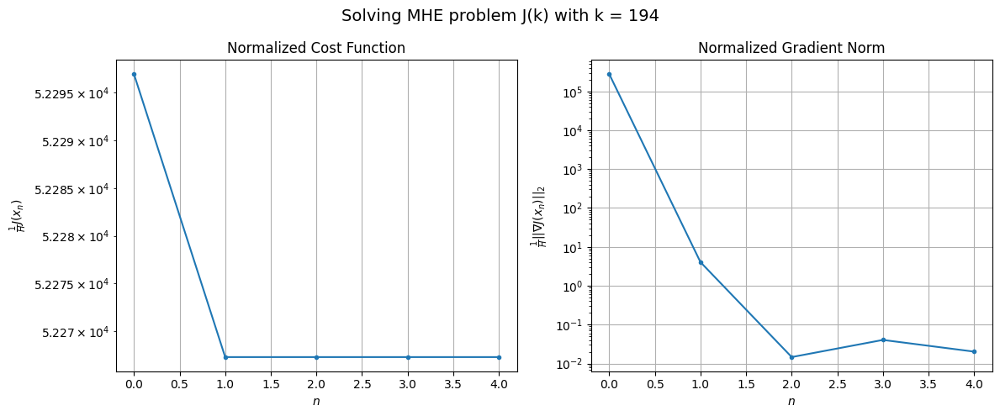

Windows:  32%|███▏      | 96/296 [28:01<58:04, 17.42s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 5342325.83850248
Gradient norm: 35095378.631416686
Global estimation error: 95.73085031408282
Initial conditions estimation errors: 47.77962882614103 m, 47.691718904481796 m, 48.20562294353566 m, 47.78201792972751 m
Position estimation errors: 73.94131169820001 m, 73.64819006159534 m, 74.65017582398426 m, 73.60289263918472 m

[Gauss-Newton] Iteration 1
Cost function: 5338192.394655419 (-0.08%)
Gradient norm: 530.7363732943869 (-100.00%)
Global estimation error: 95.32259103893205 (-0.43%)
Initial conditions estimation errors: 47.679687729119514 m, 47.40689277091953 m, 48.074524726698314 m, 47.48021145189269 m
Position estimation errors: 72.7764135843765 m, 72.36583456933928 m, 73.49873212184046 m, 72.33766830961339 m

[Gauss-Newton] Iteration 2
Cost function: 5338192.394214119 (-0.00%)
Gradient norm: 0.8529284689459911 (-99.84%)
Global estimation error: 95.32231577081697 (-0.00%)
Initial conditions estimation errors: 47.6796877

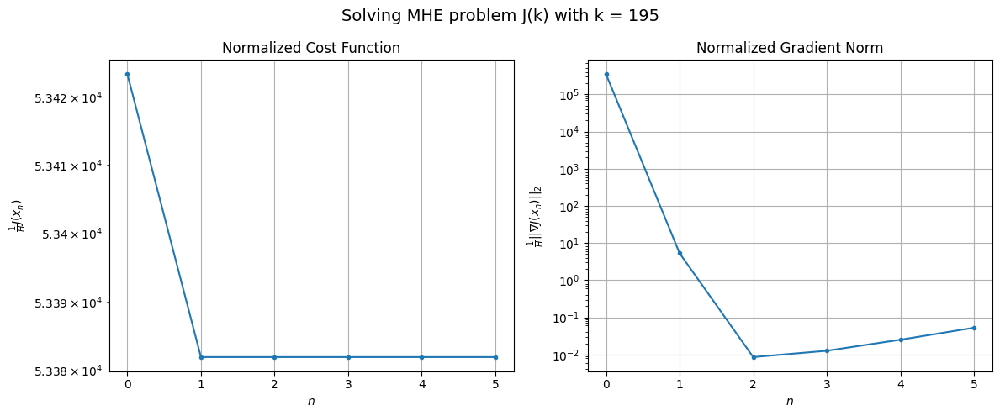

Windows:  33%|███▎      | 97/296 [28:17<55:54, 16.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5548943.126026798
Gradient norm: 42551585.602479614
Global estimation error: 78.52649115848604
Initial conditions estimation errors: 39.244034871981114 m, 39.01307900786804 m, 39.643868804719624 m, 39.14797160670147 m
Position estimation errors: 80.44012922853334 m, 80.04023948532827 m, 81.1903174100922 m, 80.04480833152603 m

[Gauss-Newton] Iteration 1
Cost function: 5542905.406897681 (-0.11%)
Gradient norm: 704.8170729571535 (-100.00%)
Global estimation error: 77.81882671475358 (-0.90%)
Initial conditions estimation errors: 39.00503168028389 m, 38.54588137655588 m, 39.39236414143123 m, 38.68770284003112 m
Position estimation errors: 78.80272658174505 m, 78.27435364290709 m, 79.53200267157256 m, 78.2465518183158 m

[Gauss-Newton] Iteration 2
Cost function: 5542905.4065075135 (-0.00%)
Gradient norm: 7.499623888576149 (-98.94%)
Global estimation error: 77.81867740029823 (-0.00%)
Initial conditions estimation errors: 39.00503104

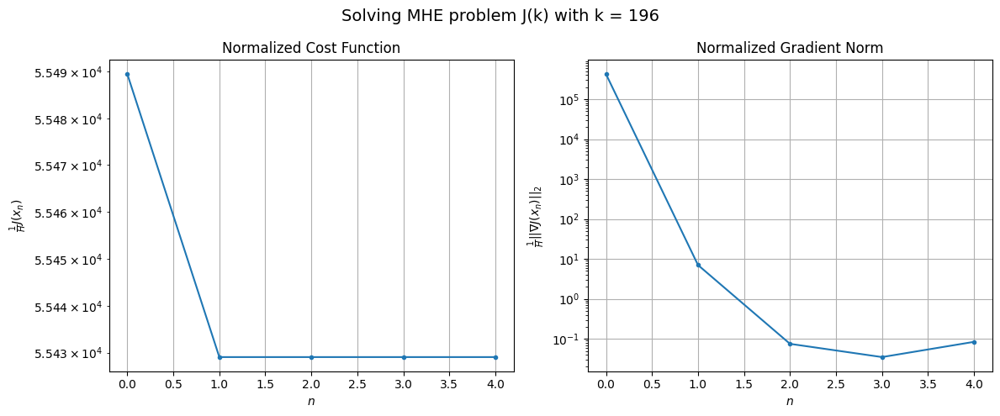

Windows:  33%|███▎      | 98/296 [28:30<51:59, 15.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5845725.930712822
Gradient norm: 49979105.3652461
Global estimation error: 62.1818532768156
Initial conditions estimation errors: 31.142447896248864 m, 30.763020337601603 m, 31.516952963884826 m, 30.934775002465333 m
Position estimation errors: 86.76731755685793 m, 86.26309664113403 m, 87.51752963794985 m, 86.25249902584048 m

[Gauss-Newton] Iteration 1
Cost function: 5836937.264996238 (-0.15%)
Gradient norm: 942.0411069444652 (-100.00%)
Global estimation error: 62.01543754890959 (-0.27%)
Initial conditions estimation errors: 30.961198484698585 m, 30.65185186673696 m, 31.468841277032926 m, 30.94197322187205 m
Position estimation errors: 84.62874954808528 m, 84.14725237557228 m, 85.41110426822688 m, 84.20942716489024 m

[Gauss-Newton] Iteration 2
Cost function: 5836937.26551558 (0.00%)
Gradient norm: 3.5159357734642036 (-99.63%)
Global estimation error: 62.0154206591042 (-0.00%)
Initial conditions estimation errors: 30.96119736

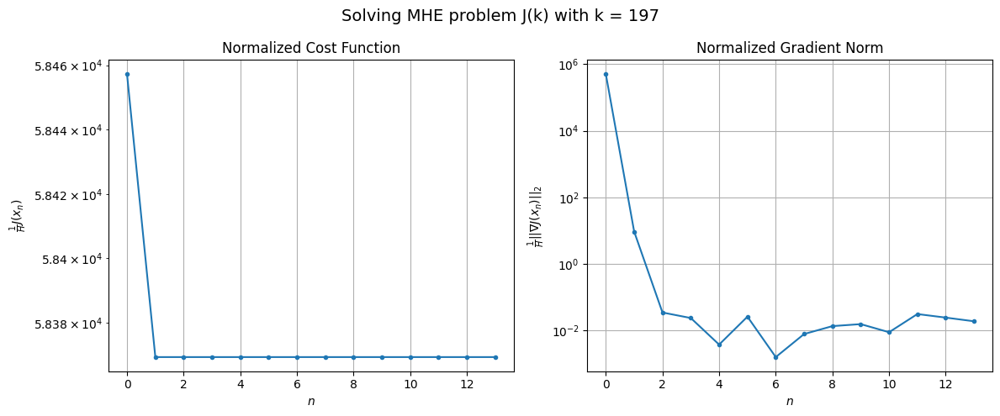

Windows:  33%|███▎      | 99/296 [29:05<1:10:50, 21.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6218553.620687117
Gradient norm: 57395729.03283359
Global estimation error: 48.71714046023896
Initial conditions estimation errors: 24.281276223054853 m, 24.075654734450914 m, 24.705699614618453 m, 24.36575534012697 m
Position estimation errors: 92.81965118246501 m, 92.35948174534111 m, 93.60490785631215 m, 92.44128179449152 m

[Gauss-Newton] Iteration 1
Cost function: 6206332.26464716 (-0.20%)
Gradient norm: 1250.1284809277981 (-100.00%)
Global estimation error: 49.484141610214124 (1.57%)
Initial conditions estimation errors: 24.559370021452487 m, 24.410842243536354 m, 25.147973006786064 m, 24.84204267179128 m
Position estimation errors: 90.17822946757798 m, 89.67948318680172 m, 91.01748532710981 m, 89.88691947837725 m

[Gauss-Newton] Iteration 2
Cost function: 6206332.264726447 (0.00%)
Gradient norm: 0.4629997532983 (-99.96%)
Global estimation error: 49.4842069556582 (0.00%)
Initial conditions estimation errors: 24.559368923

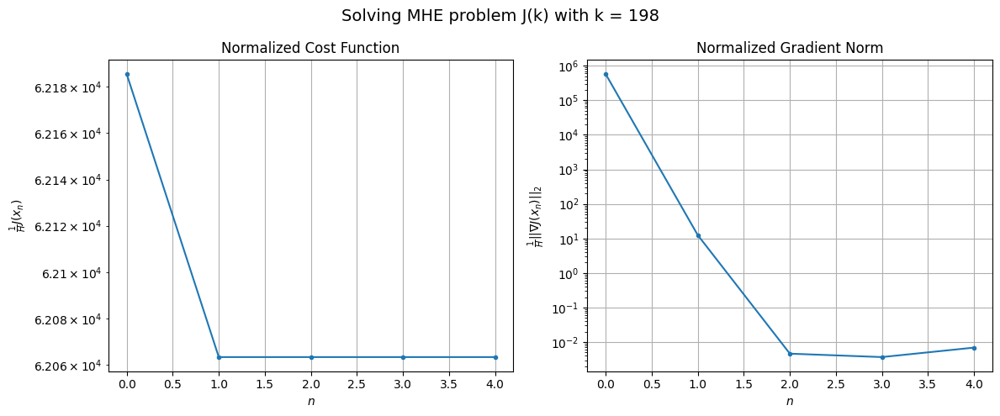

Windows:  34%|███▍      | 100/296 [29:19<1:02:29, 19.13s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6661671.028302272
Gradient norm: 64896375.80136506
Global estimation error: 40.51836731060872
Initial conditions estimation errors: 20.076527154160704 m, 20.11038214708062 m, 20.447687870108805 m, 20.397636441014203 m
Position estimation errors: 98.53180458124899 m, 98.05770470735106 m, 99.36322423372204 m, 98.2751366066618 m

[Gauss-Newton] Iteration 1
Cost function: 6645144.1972523155 (-0.25%)
Gradient norm: 1638.475073170743 (-100.00%)
Global estimation error: 43.18233655274003 (6.57%)
Initial conditions estimation errors: 21.41680382809578 m, 21.474575981751833 m, 21.737786244329605 m, 21.731853853319038 m
Position estimation errors: 95.36508970805168 m, 94.89527623089954 m, 96.25013355400509 m, 95.15127285741387 m

[Gauss-Newton] Iteration 2
Cost function: 6645144.197122966 (-0.00%)
Gradient norm: 8.065659091441498 (-99.51%)
Global estimation error: 43.18233280514539 (-0.00%)
Initial conditions estimation errors: 21.41680

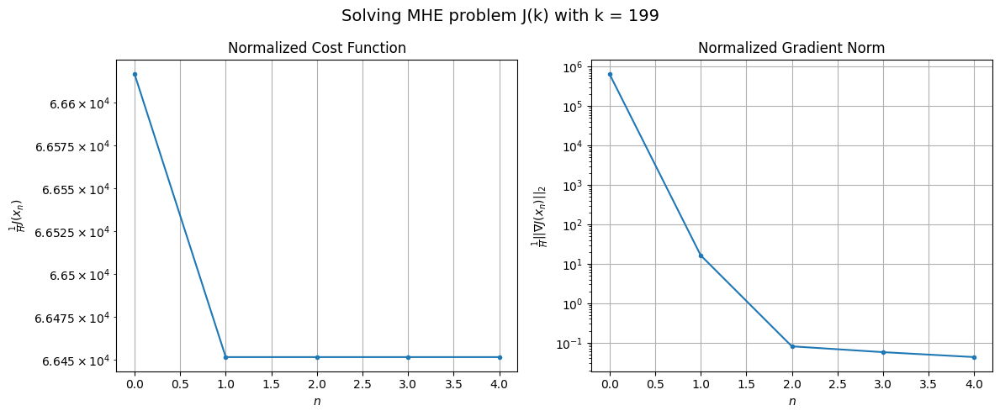

Windows:  34%|███▍      | 101/296 [29:32<56:24, 17.36s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 7161255.150185219
Gradient norm: 72442864.89426738
Global estimation error: 40.468549931048145
Initial conditions estimation errors: 20.125108754076606 m, 20.34941351590467 m, 20.116616309819175 m, 20.343111785328762 m
Position estimation errors: 103.8923916090839 m, 103.442187055277 m, 104.77013921109777 m, 103.69930531866635 m

[Gauss-Newton] Iteration 1
Cost function: 7139718.794796737 (-0.30%)
Gradient norm: 2076.9674205045662 (-100.00%)
Global estimation error: 45.802083123944634 (13.18%)
Initial conditions estimation errors: 22.787571843211058 m, 23.033463542457707 m, 22.787219264488453 m, 22.993366895980007 m
Position estimation errors: 100.1928777323146 m, 99.68839213119561 m, 101.05114885683084 m, 99.93227438644077 m

[Gauss-Newton] Iteration 2
Cost function: 7139718.793962608 (-0.00%)
Gradient norm: 0.9926649538512001 (-99.95%)
Global estimation error: 45.802095305046926 (0.00%)
Initial conditions estimation errors: 

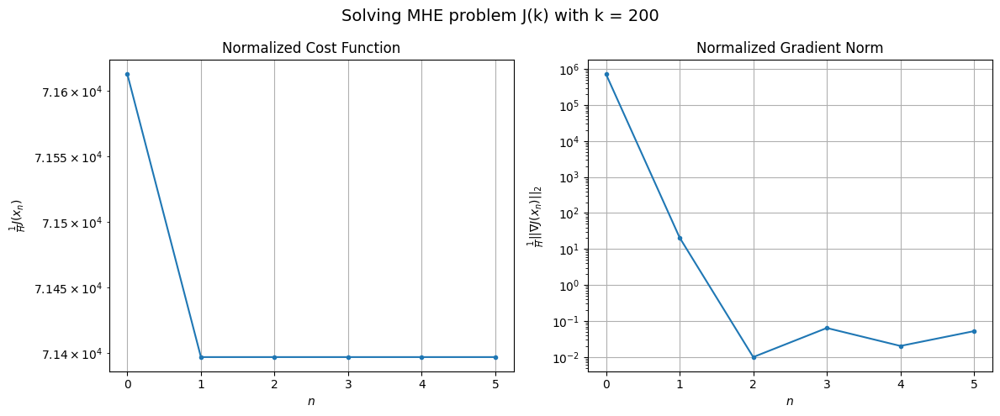

Windows:  34%|███▍      | 102/296 [29:48<54:40, 16.91s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 7707970.928176618
Gradient norm: 79687291.93712874
Global estimation error: 48.750991179656715
Initial conditions estimation errors: 24.332588295599482 m, 24.70368168837305 m, 24.03893383977628 m, 24.42099100642872 m
Position estimation errors: 108.97960265454836 m, 108.49785477306209 m, 109.82590982513454 m, 108.73138667086806 m

[Gauss-Newton] Iteration 1
Cost function: 7680633.215701798 (-0.35%)
Gradient norm: 2624.0636250528396 (-100.00%)
Global estimation error: 56.04066267809473 (14.95%)
Initial conditions estimation errors: 27.98290822792777 m, 28.31810951837121 m, 27.708114584212044 m, 28.06778054206613 m
Position estimation errors: 104.73589545999778 m, 104.35729220599673 m, 105.65472009602664 m, 104.45308081675658 m

[Gauss-Newton] Iteration 2
Cost function: 7680633.215998585 (0.00%)
Gradient norm: 3.851236572489684 (-99.85%)
Global estimation error: 56.04054371587145 (-0.00%)
Initial conditions estimation errors: 27

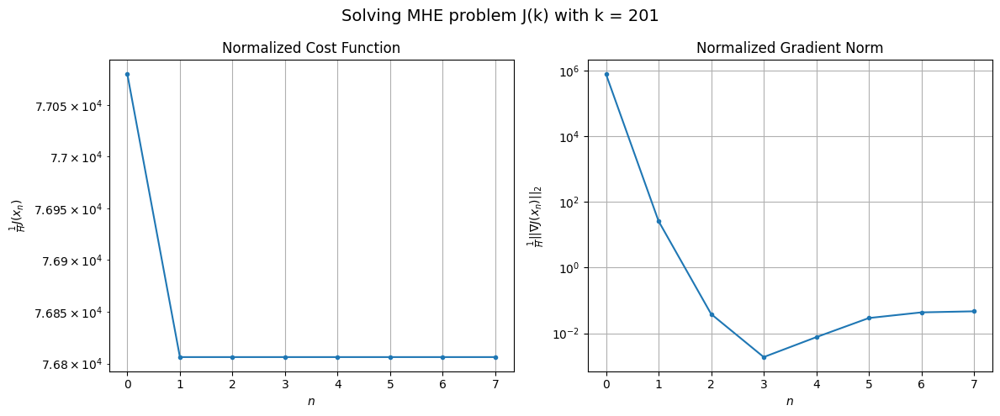

Windows:  35%|███▍      | 103/296 [30:08<57:37, 17.92s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8288747.963999961
Gradient norm: 87050997.32180154
Global estimation error: 62.12897239002646
Initial conditions estimation errors: 31.09689190092852 m, 31.443072044394437 m, 30.6195675726249 m, 31.09208423904968 m
Position estimation errors: 113.86350593757304 m, 113.5018958751444 m, 114.76738983460949 m, 113.58483618605538 m

[Gauss-Newton] Iteration 1
Cost function: 8255032.300872911 (-0.41%)
Gradient norm: 3208.3139310532765 (-100.00%)
Global estimation error: 70.76878650564218 (13.91%)
Initial conditions estimation errors: 35.36863709741056 m, 35.843277056178856 m, 34.91055267488369 m, 35.40823665400927 m
Position estimation errors: 109.07552592008146 m, 108.58871021127689 m, 109.9477309925643 m, 108.8237988359429 m

[Gauss-Newton] Iteration 2
Cost function: 8255032.301072613 (0.00%)
Gradient norm: 3.6765860601787947 (-99.89%)
Global estimation error: 70.76884727743311 (0.00%)
Initial conditions estimation errors: 35.3686

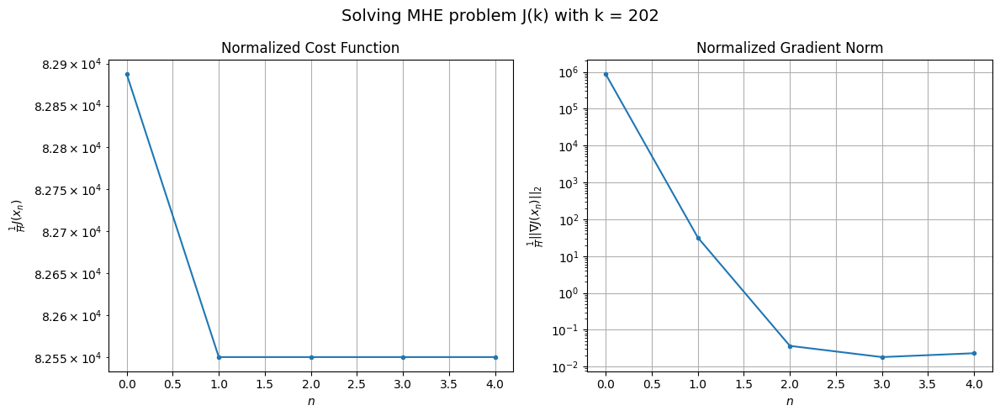

Windows:  35%|███▌      | 104/296 [30:21<53:06, 16.60s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8894947.846259536
Gradient norm: 94429094.37292902
Global estimation error: 78.05807366272013
Initial conditions estimation errors: 39.06058844273155 m, 39.53871087291578 m, 38.49515513846784 m, 39.01415610781496 m
Position estimation errors: 118.55081432525525 m, 118.0915639858526 m, 119.40901706052328 m, 118.30769145907279 m

[Gauss-Newton] Iteration 1
Cost function: 8853984.328243632 (-0.46%)
Gradient norm: 3877.8100527037864 (-100.00%)
Global estimation error: 87.62474189069579 (12.26%)
Initial conditions estimation errors: 43.82516006065023 m, 44.3913717202647 m, 43.2736186364402 m, 43.751663438231695 m
Position estimation errors: 113.20754039128735 m, 112.70816886166021 m, 114.08958624120504 m, 112.83130625536236 m

[Gauss-Newton] Iteration 2
Cost function: 8853984.328770358 (0.00%)
Gradient norm: 2.0859714716090947 (-99.95%)
Global estimation error: 87.62474011582877 (-0.00%)
Initial conditions estimation errors: 43.825

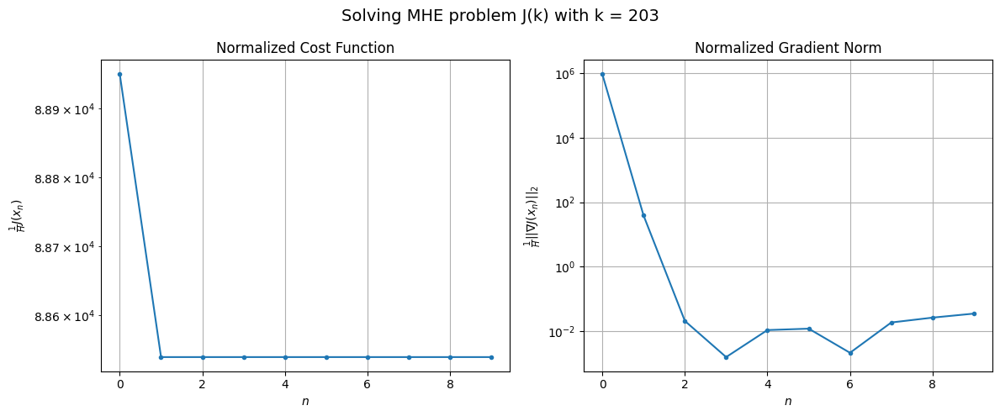

Windows:  35%|███▌      | 105/296 [30:47<1:01:28, 19.31s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 9511884.32939435
Gradient norm: 100619054.36354654
Global estimation error: 94.80414208391815
Initial conditions estimation errors: 47.42903640238494 m, 47.983318153448884 m, 46.826276009533416 m, 47.36220905742727 m
Position estimation errors: 122.96144885153667 m, 122.49853125749156 m, 123.83144784262122 m, 122.59270138207428 m

[Gauss-Newton] Iteration 1
Cost function: 9463399.628495773 (-0.51%)
Gradient norm: 4623.44647644356 (-100.00%)
Global estimation error: 105.19506344493587 (10.96%)
Initial conditions estimation errors: 52.62558309882066 m, 53.168828790313576 m, 52.05230984990623 m, 52.537104045829004 m
Position estimation errors: 117.09525617574076 m, 116.60665224721384 m, 117.969514391972 m, 116.61994127315016 m

[Gauss-Newton] Iteration 2
Cost function: 9463399.62935368 (0.00%)
Gradient norm: 1.6495724377681975 (-99.96%)
Global estimation error: 105.19510442292959 (0.00%)
Initial conditions estimation errors: 52.6

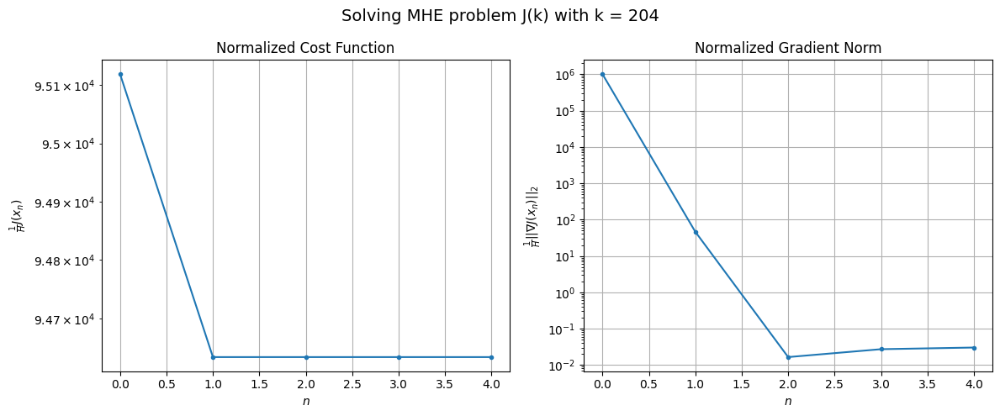

Windows:  36%|███▌      | 106/296 [31:01<55:49, 17.63s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 10132093.823335297
Gradient norm: 106734783.00439392
Global estimation error: 111.31465826238669
Initial conditions estimation errors: 55.685902131899894 m, 56.21711183447445 m, 55.07302497901706 m, 55.647153083021976 m
Position estimation errors: 127.04496178238531 m, 126.59373558943835 m, 127.90041011483062 m, 126.57365133353362 m

[Gauss-Newton] Iteration 1
Cost function: 10075764.528859338 (-0.56%)
Gradient norm: 5389.915535109435 (-99.99%)
Global estimation error: 122.67143998547535 (10.20%)
Initial conditions estimation errors: 61.2835977563707 m, 61.92128552638822 m, 60.76849380219651 m, 61.36383611695219 m
Position estimation errors: 120.67651299635847 m, 120.16034072856506 m, 121.51594737560453 m, 120.12573624574294 m

[Gauss-Newton] Iteration 2
Cost function: 10075764.529324936 (0.00%)
Gradient norm: 0.7203841850054084 (-99.99%)
Global estimation error: 122.67143861116908 (-0.00%)
Initial conditions estimation errors

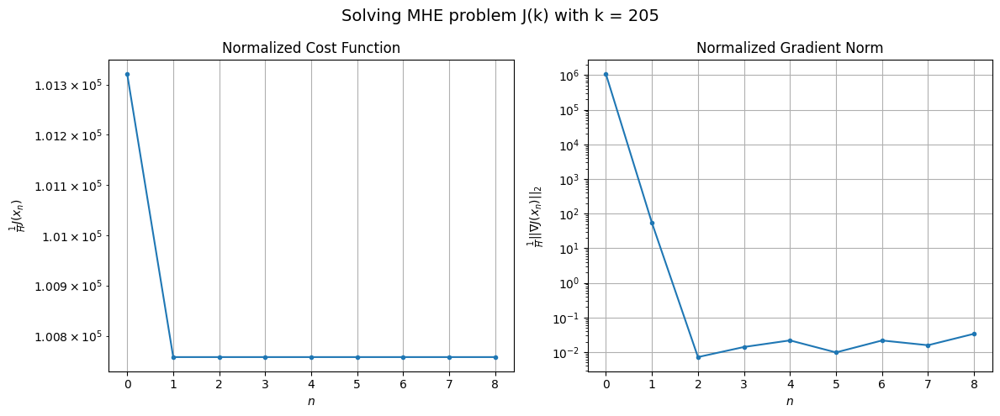

Windows:  36%|███▌      | 107/296 [31:24<1:00:35, 19.23s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10743174.801134402
Gradient norm: 112411874.22635403
Global estimation error: 127.20779114528882
Initial conditions estimation errors: 63.55557639047992 m, 64.16027262444302 m, 63.01053081232986 m, 63.6837817950707 m
Position estimation errors: 130.78751558236488 m, 130.31013659476034 m, 131.60995195045186 m, 130.24805247296308 m

[Gauss-Newton] Iteration 1
Cost function: 10678408.142300148 (-0.60%)
Gradient norm: 6262.071594090587 (-99.99%)
Global estimation error: 139.21325042657844 (9.44%)
Initial conditions estimation errors: 69.55976214887161 m, 70.20959146521896 m, 69.05482520023965 m, 69.5973593906748 m
Position estimation errors: 123.92112351970208 m, 123.3970032216845 m, 124.73272684092292 m, 123.44234194763027 m

[Gauss-Newton] Iteration 2
Cost function: 10678408.142212363 (-0.00%)
Gradient norm: 2.536396312185697 (-99.96%)
Global estimation error: 139.21302509337156 (-0.00%)
Initial conditions estimation errors: 69.

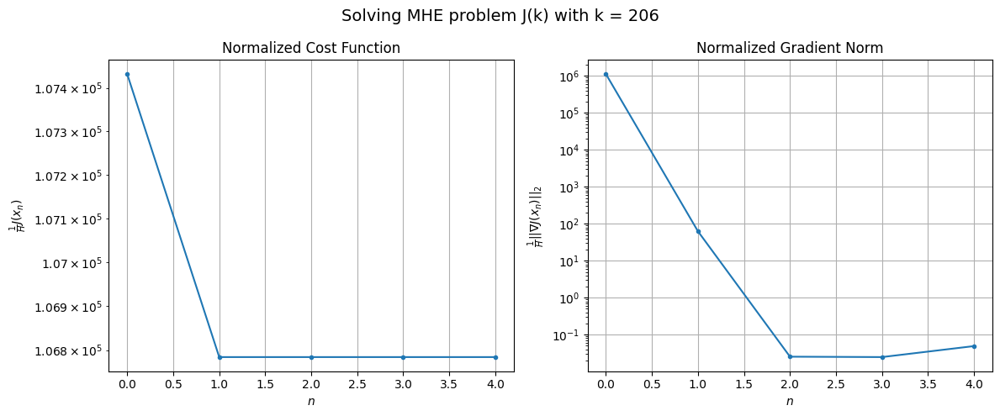

Windows:  36%|███▋      | 108/296 [31:37<54:13, 17.30s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 11338316.084488787
Gradient norm: 117869342.65959089
Global estimation error: 142.04997932330824
Initial conditions estimation errors: 71.00007425828262 m, 71.57832997975677 m, 70.46280286253132 m, 71.0542619766664 m
Position estimation errors: 134.23575631821538 m, 133.7382849869809 m, 135.025116455041 m, 133.75395822184404 m

[Gauss-Newton] Iteration 1
Cost function: 11265449.149595182 (-0.64%)
Gradient norm: 7085.45843253591 (-99.99%)
Global estimation error: 154.8517022326766 (9.01%)
Initial conditions estimation errors: 77.37194153905419 m, 78.0169954963375 m, 76.82517049752647 m, 77.48456815354282 m
Position estimation errors: 126.91412644020104 m, 126.40661819472854 m, 127.72200007821809 m, 126.48300982469203 m

[Gauss-Newton] Iteration 2
Cost function: 11265449.14964132 (0.00%)
Gradient norm: 5.365750606971926 (-99.92%)
Global estimation error: 154.85181671827104 (0.00%)
Initial conditions estimation errors: 77.3719410

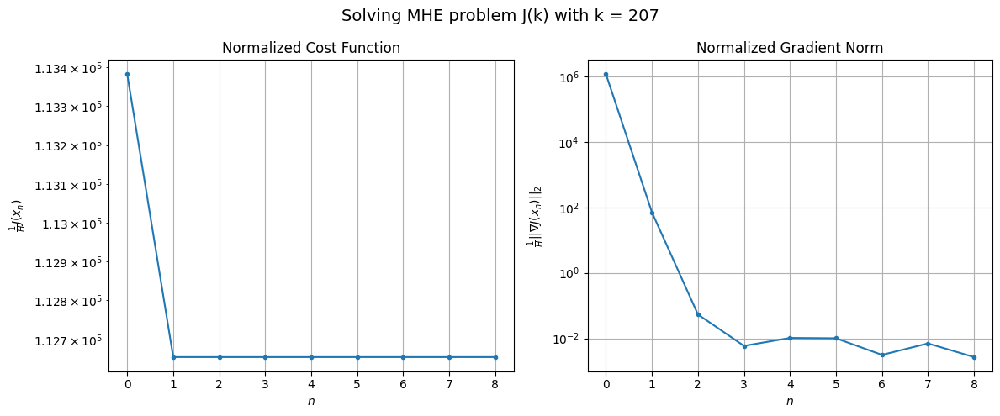

Windows:  37%|███▋      | 109/296 [31:59<58:27, 18.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11910476.37169895
Gradient norm: 122944008.39725682
Global estimation error: 156.16510927588163
Initial conditions estimation errors: 78.05662779652488 m, 78.62267602403865 m, 77.49531697776634 m, 78.15142021394465 m
Position estimation errors: 137.53239820311205 m, 137.05575940320145 m, 138.3238702701884 m, 137.10259580840113 m

[Gauss-Newton] Iteration 1
Cost function: 11829398.733352019 (-0.68%)
Gradient norm: 7927.350349470455 (-99.99%)
Global estimation error: 169.6687996090854 (8.65%)
Initial conditions estimation errors: 84.78778438429677 m, 85.38742953266417 m, 84.28383214385347 m, 84.87486854204549 m
Position estimation errors: 129.7707605819017 m, 129.26789784130656 m, 130.53184568127793 m, 129.2546702890048 m

[Gauss-Newton] Iteration 2
Cost function: 11829398.734482398 (0.00%)
Gradient norm: 3.8923856505845618 (-99.95%)
Global estimation error: 169.668869747586 (0.00%)
Initial conditions estimation errors: 84.78778

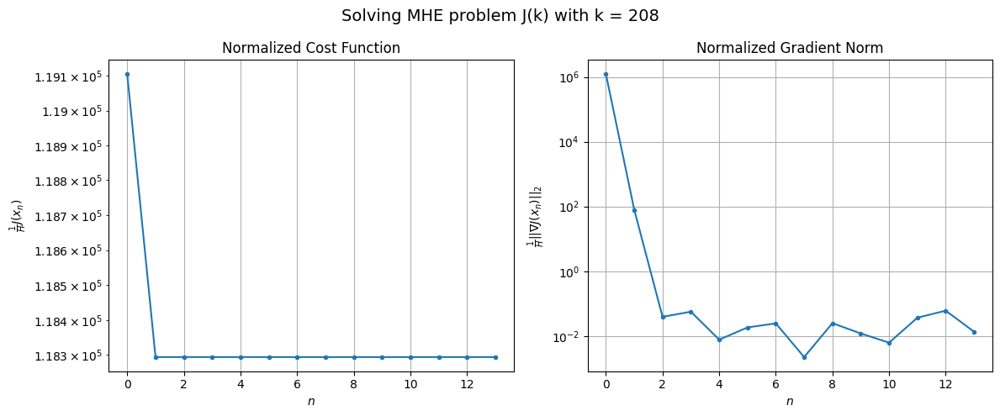

Windows:  37%|███▋      | 110/296 [32:34<1:13:17, 23.64s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12457215.287983233
Gradient norm: 128050794.4434423
Global estimation error: 169.63662160109837
Initial conditions estimation errors: 84.78732547505611 m, 85.32004275200558 m, 84.2721109911815 m, 84.89043578098965 m
Position estimation errors: 140.78097224971287 m, 140.31065055072042 m, 141.51884445400418 m, 140.25468054603587 m

[Gauss-Newton] Iteration 1
Cost function: 12367859.864046713 (-0.72%)
Gradient norm: 8774.39599210964 (-99.99%)
Global estimation error: 183.80445467557246 (8.35%)
Initial conditions estimation errors: 91.86663626205579 m, 92.4591726126785 m, 91.39907274584482 m, 91.88089525763436 m
Position estimation errors: 132.59268774343838 m, 132.1056442035973 m, 133.35243989461395 m, 132.099123894063 m

[Gauss-Newton] Iteration 2
Cost function: 12367859.865032554 (0.00%)
Gradient norm: 2.1028067916822475 (-99.98%)
Global estimation error: 183.8045395697668 (0.00%)
Initial conditions estimation errors: 91.866632

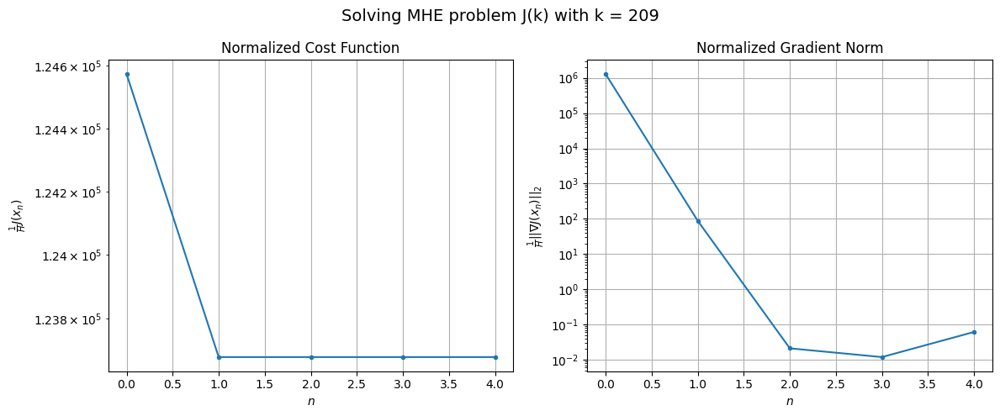

Windows:  38%|███▊      | 111/296 [32:47<1:03:02, 20.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12985101.318555722
Gradient norm: 133565854.0891204
Global estimation error: 182.45106436392888
Initial conditions estimation errors: 91.19097729824222 m, 91.72705285382291 m, 90.73303367343856 m, 91.24830444702673 m
Position estimation errors: 144.00406005091838 m, 143.55643431053656 m, 144.7447497858181 m, 143.4965810316842 m

[Gauss-Newton] Iteration 1
Cost function: 12886737.877746515 (-0.76%)
Gradient norm: 9710.709481773185 (-99.99%)
Global estimation error: 197.18232084106026 (8.07%)
Initial conditions estimation errors: 98.63199083196486 m, 99.10038218566737 m, 98.07926007754624 m, 98.55029353340785 m
Position estimation errors: 135.37444845599913 m, 134.94580739959864 m, 136.17304062033855 m, 134.97582570238757 m

[Gauss-Newton] Iteration 2
Cost function: 12886737.877813786 (0.00%)
Gradient norm: 1.3779121313495553 (-99.99%)
Global estimation error: 197.18230337201425 (-0.00%)
Initial conditions estimation errors: 98.

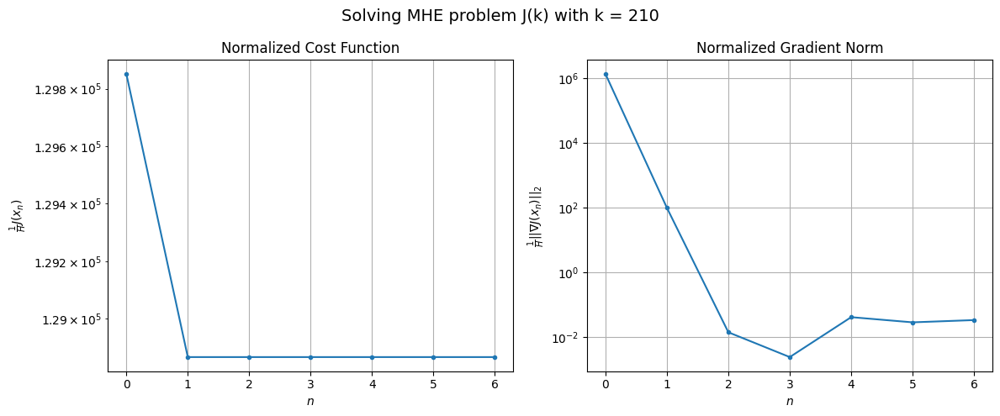

Windows:  38%|███▊      | 112/296 [33:04<1:00:12, 19.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13482218.701487506
Gradient norm: 137573177.5115167
Global estimation error: 194.4297671237922
Initial conditions estimation errors: 97.25495589934013 m, 97.67033330222696 m, 96.72582842005711 m, 97.2060659703594 m
Position estimation errors: 147.0953997971411 m, 146.7076258010992 m, 147.8730238670249 m, 146.68522401698814 m

[Gauss-Newton] Iteration 1
Cost function: 13375615.937889319 (-0.79%)
Gradient norm: 10612.676723519031 (-99.99%)
Global estimation error: 209.88595144132373 (7.95%)
Initial conditions estimation errors: 105.0346435929268 m, 105.38632068030843 m, 104.49068467463731 m, 104.85821087307457 m
Position estimation errors: 138.08837369113468 m, 137.74357392472143 m, 138.88320444368915 m, 137.73239227354998 m

[Gauss-Newton] Iteration 2
Cost function: 13375615.936916819 (-0.00%)
Gradient norm: 3.431768862182847 (-99.97%)
Global estimation error: 209.88601616517954 (0.00%)
Initial conditions estimation errors: 105

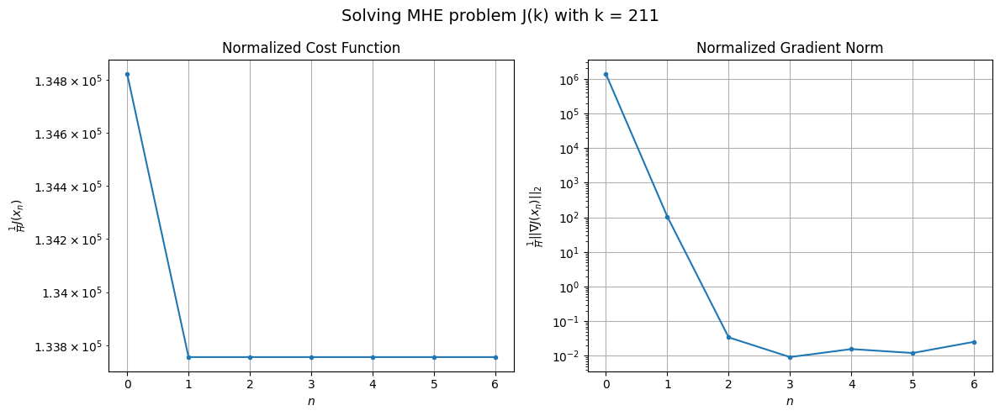

Windows:  38%|███▊      | 113/296 [33:23<58:26, 19.16s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 13945270.113737691
Gradient norm: 141560341.51203448
Global estimation error: 205.73004755719302
Initial conditions estimation errors: 102.93468018165665 m, 103.26760585015278 m, 102.43426530335344 m, 102.82176923334043 m
Position estimation errors: 149.9680936680375 m, 149.67295811575121 m, 150.73939158727 m, 149.60374625283737 m

[Gauss-Newton] Iteration 1
Cost function: 13829929.314124305 (-0.83%)
Gradient norm: 11563.508104438475 (-99.99%)
Global estimation error: 222.3177735751364 (8.06%)
Initial conditions estimation errors: 111.06339765423694 m, 111.5687759051939 m, 110.73000936971069 m, 111.2716166054349 m
Position estimation errors: 140.58244909626634 m, 140.1320424789782 m, 141.2284991855615 m, 139.92597830467164 m

[Gauss-Newton] Iteration 2
Cost function: 13829929.312701711 (-0.00%)
Gradient norm: 3.368589382326097 (-99.97%)
Global estimation error: 222.31783356093266 (0.00%)
Initial conditions estimation errors: 1

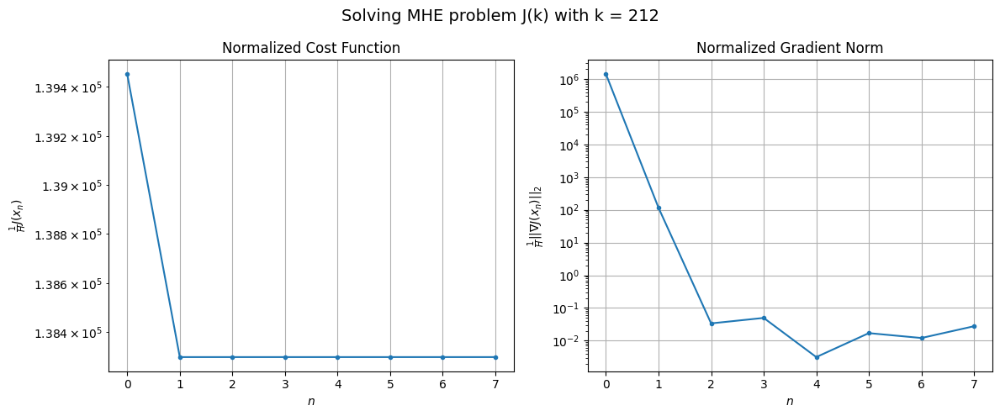

Windows:  39%|███▊      | 114/296 [33:44<59:46, 19.71s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14371651.732211104
Gradient norm: 144807809.5626981
Global estimation error: 216.64222170872154
Initial conditions estimation errors: 108.20605555558225 m, 108.67902554124858 m, 107.91560812446444 m, 108.4821565576475 m
Position estimation errors: 152.45077021032623 m, 152.0626693266431 m, 153.07977243581445 m, 151.8123540470168 m

[Gauss-Newton] Iteration 1
Cost function: 14248034.517174229 (-0.86%)
Gradient norm: 12556.799575483776 (-99.99%)
Global estimation error: 233.38837528130915 (7.73%)
Initial conditions estimation errors: 116.67507606523212 m, 117.0373202097774 m, 116.36321199937854 m, 116.70008487088062 m
Position estimation errors: 142.7302569228553 m, 142.4014941215665 m, 143.35482731681927 m, 142.22997896808192 m

[Gauss-Newton] Iteration 2
Cost function: 14248034.516534356 (-0.00%)
Gradient norm: 0.5393832158633175 (-100.00%)
Global estimation error: 233.3882833281563 (-0.00%)
Initial conditions estimation error

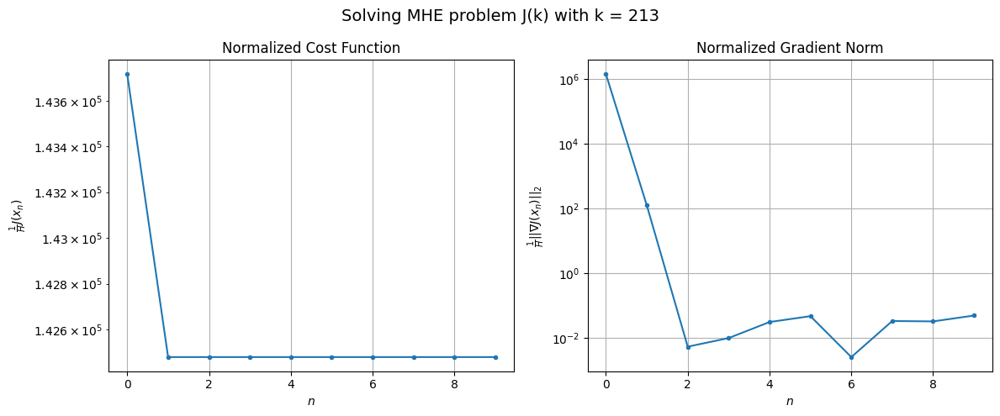

Windows:  39%|███▉      | 115/296 [34:08<1:03:55, 21.19s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14756399.202674735
Gradient norm: 147396771.7499092
Global estimation error: 226.0515816658995
Initial conditions estimation errors: 112.9848380618046 m, 113.31758520281949 m, 112.71300711522709 m, 113.08680686286549 m
Position estimation errors: 154.42011057041404 m, 154.14582893351945 m, 155.01812523477358 m, 153.93149872313805 m

[Gauss-Newton] Iteration 1
Cost function: 14625313.102012007 (-0.89%)
Gradient norm: 13478.806757586113 (-99.99%)
Global estimation error: 243.7716388508127 (7.84%)
Initial conditions estimation errors: 121.77447147774615 m, 122.27611777260617 m, 121.57641624376073 m, 121.91509121262884 m
Position estimation errors: 144.4135958846631 m, 143.99386993293967 m, 144.93299231207922 m, 143.88055151273437 m

[Gauss-Newton] Iteration 2
Cost function: 14625313.103298515 (0.00%)
Gradient norm: 0.24544967357039993 (-100.00%)
Global estimation error: 243.771672468107 (0.00%)
Initial conditions estimation error

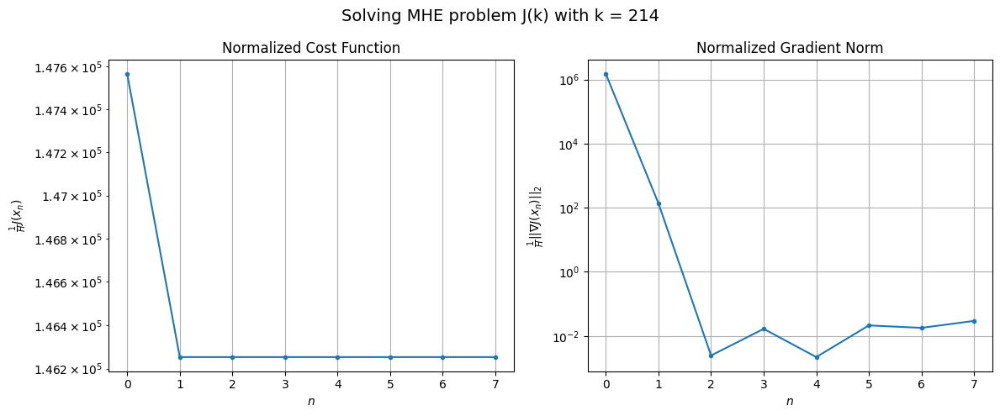

Windows:  39%|███▉      | 116/296 [34:29<1:02:53, 20.96s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15096628.738721857
Gradient norm: 148322180.3821883
Global estimation error: 234.5486731193125
Initial conditions estimation errors: 117.1431183310958 m, 117.61178550935796 m, 116.98607149176166 m, 117.3552950278237 m
Position estimation errors: 155.7571233651979 m, 155.39935799198298 m, 156.24977356693557 m, 155.24851057171944 m

[Gauss-Newton] Iteration 1
Cost function: 14958744.280482292 (-0.91%)
Gradient norm: 14448.434208247565 (-99.99%)
Global estimation error: 252.98346081750844 (7.86%)
Initial conditions estimation errors: 126.25989582022237 m, 126.68168315192908 m, 126.18556332893125 m, 126.83842676933632 m
Position estimation errors: 145.51589306516806 m, 145.19702679456725 m, 145.9277667592637 m, 144.69912067242618 m

[Gauss-Newton] Iteration 2
Cost function: 14958744.281646293 (0.00%)
Gradient norm: 1.558162768001381 (-99.99%)
Global estimation error: 252.98343500301388 (-0.00%)
Initial conditions estimation errors

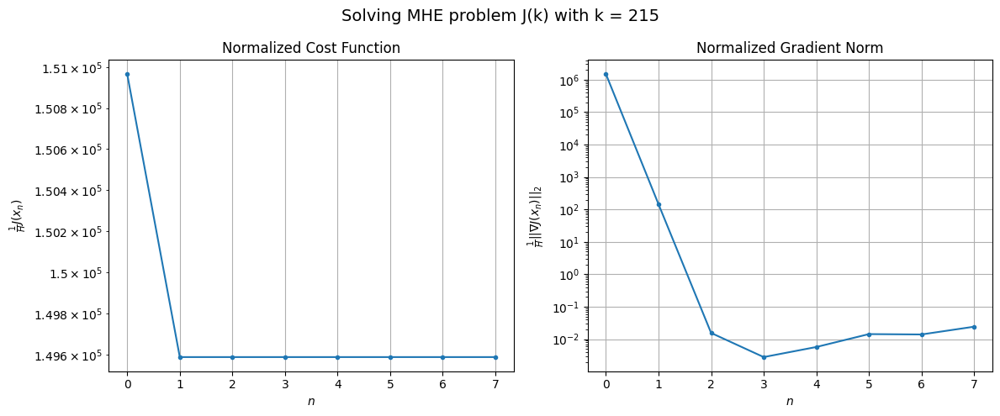

Windows:  40%|███▉      | 117/296 [34:49<1:02:19, 20.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15385325.821314324
Gradient norm: 148740525.85122526
Global estimation error: 241.66967529300993
Initial conditions estimation errors: 120.58988590911872 m, 120.97553224436406 m, 120.55146598618624 m, 121.22099492630198 m
Position estimation errors: 156.3476396042921 m, 156.09359709458644 m, 156.73505539227233 m, 155.58828072494092 m

[Gauss-Newton] Iteration 1
Cost function: 15242000.949728368 (-0.93%)
Gradient norm: 15315.233671775988 (-99.99%)
Global estimation error: 260.88525834399456 (7.95%)
Initial conditions estimation errors: 129.99957100489576 m, 130.62711491173337 m, 130.24084749005493 m, 130.90093039311023 m
Position estimation errors: 145.92955714939188 m, 145.43960244010086 m, 146.05482435778228 m, 144.87031944591766 m

[Gauss-Newton] Iteration 2
Cost function: 15242000.950093767 (0.00%)
Gradient norm: 1.8920496154371471 (-99.99%)
Global estimation error: 260.88520039521177 (-0.00%)
Initial conditions estimation 

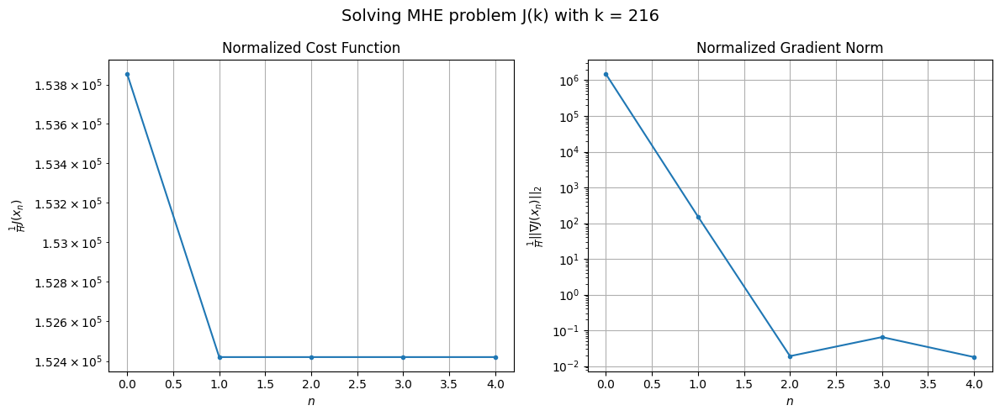

Windows:  40%|███▉      | 118/296 [35:03<55:28, 18.70s/it]  

[Gauss-Newton] Before applying the algorithm
Cost function: 15614260.014268897
Gradient norm: 148218236.9142827
Global estimation error: 247.40689173108646
Initial conditions estimation errors: 123.24024618727462 m, 123.83967955813736 m, 123.52710267920227 m, 124.20441271748427 m
Position estimation errors: 156.1242939379104 m, 155.70167737559774 m, 156.22601136750592 m, 155.1358150197155 m

[Gauss-Newton] Iteration 1
Cost function: 15466303.071708238 (-0.95%)
Gradient norm: 16200.065947888432 (-99.99%)
Global estimation error: 266.7492831694527 (7.82%)
Initial conditions estimation errors: 132.93387298703476 m, 133.45948166909292 m, 133.23766926646746 m, 133.86553603592006 m
Position estimation errors: 145.56761251803803 m, 145.2136348462496 m, 145.65672935261202 m, 144.5901605646316 m

[Gauss-Newton] Iteration 2
Cost function: 15466303.069925547 (-0.00%)
Gradient norm: 3.7834361439618664 (-99.98%)
Global estimation error: 266.7491930094477 (-0.00%)
Initial conditions estimation error

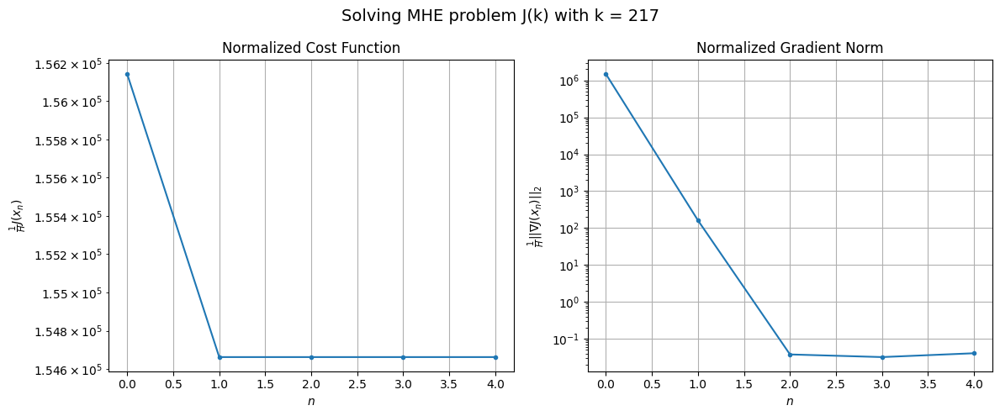

Windows:  40%|████      | 119/296 [35:16<50:15, 17.03s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15783555.698006496
Gradient norm: 147292569.1779964
Global estimation error: 251.08048227639046
Initial conditions estimation errors: 125.08031953025778 m, 125.5784079163136 m, 125.43611246593947 m, 126.06380478838324 m
Position estimation errors: 155.0984618541078 m, 154.80090744946233 m, 155.1695119896556 m, 154.19091486706185 m

[Gauss-Newton] Iteration 1
Cost function: 15632073.124801274 (-0.96%)
Gradient norm: 17032.54580296052 (-99.99%)
Global estimation error: 270.8992982377847 (7.89%)
Initial conditions estimation errors: 135.032645774453 m, 135.42132974395506 m, 135.3727955802976 m, 135.96980651840718 m
Position estimation errors: 144.44096423439 m, 144.23875733123282 m, 144.49973254160912 m, 143.53880460124913 m

[Gauss-Newton] Iteration 2
Cost function: 15632073.125024255 (0.00%)
Gradient norm: 0.2602541331140349 (-100.00%)
Global estimation error: 270.8992082576648 (-0.00%)
Initial conditions estimation errors: 135

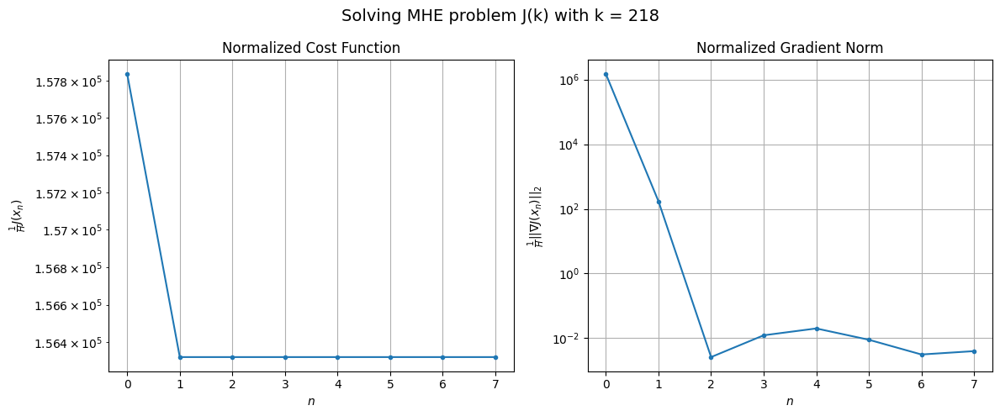

Windows:  41%|████      | 120/296 [35:36<52:19, 17.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15894602.337510997
Gradient norm: 146468954.49736568
Global estimation error: 253.09973419041907
Initial conditions estimation errors: 126.11291651660464 m, 126.48103287774879 m, 126.50117901603102 m, 127.10193553127645 m
Position estimation errors: 153.40752902623868 m, 153.25965820716416 m, 153.45126469290605 m, 152.5699615523119 m

[Gauss-Newton] Iteration 1
Cost function: 15740294.05575022 (-0.97%)
Gradient norm: 17802.98516955756 (-99.99%)
Global estimation error: 273.48234235010284 (8.05%)
Initial conditions estimation errors: 136.30421187610168 m, 136.53811221019842 m, 136.76139998399023 m, 137.35828370652845 m
Position estimation errors: 142.6613798175311 m, 142.62503498681215 m, 142.62060041825842 m, 141.7481254279683 m

[Gauss-Newton] Iteration 2
Cost function: 15740294.054278677 (-0.00%)
Gradient norm: 3.4347294881833643 (-99.98%)
Global estimation error: 273.48226464875614 (-0.00%)
Initial conditions estimation err

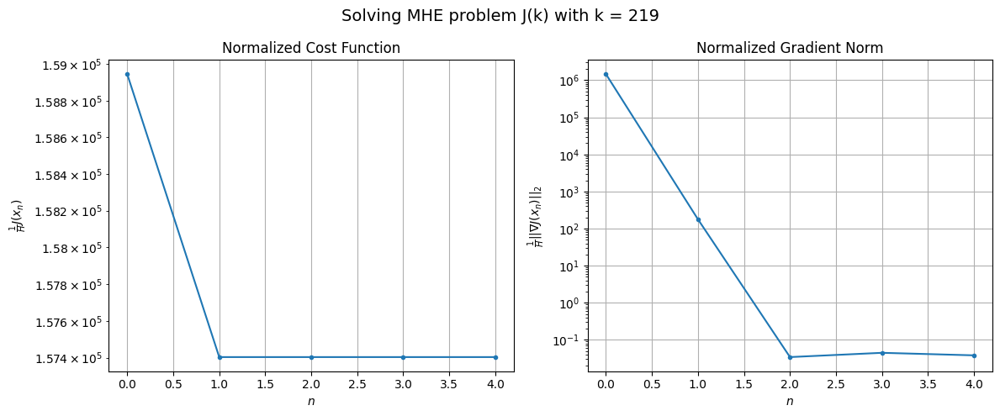

Windows:  41%|████      | 121/296 [35:49<47:49, 16.39s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15956212.79947708
Gradient norm: 145710231.09306058
Global estimation error: 253.67501095217543
Initial conditions estimation errors: 126.38495699165877 m, 126.60240722524371 m, 126.88797762421635 m, 127.47156242418379 m
Position estimation errors: 151.23449384642146 m, 151.24742700140231 m, 151.18608198346791 m, 150.3808025191978 m

[Gauss-Newton] Iteration 1
Cost function: 15800847.57717426 (-0.97%)
Gradient norm: 18325.15883968064 (-99.99%)
Global estimation error: 274.14043265774905 (8.07%)
Initial conditions estimation errors: 136.74174832125033 m, 136.98982438096954 m, 136.99697671532894 m, 137.55052531992516 m
Position estimation errors: 140.43374747239275 m, 140.38921156642817 m, 140.57354623606543 m, 139.78559759145605 m

[Gauss-Newton] Iteration 2
Cost function: 15800847.578204429 (0.00%)
Gradient norm: 3.5612988096090064 (-99.98%)
Global estimation error: 274.1404005463351 (-0.00%)
Initial conditions estimation erro

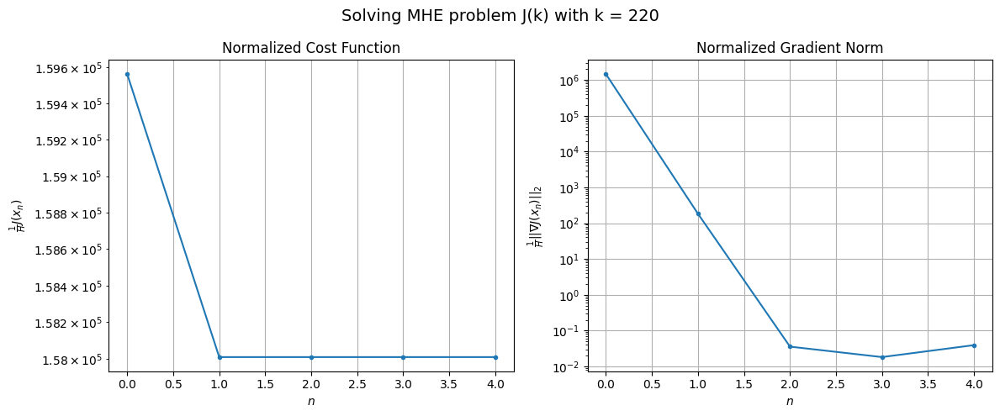

Windows:  41%|████      | 122/296 [36:02<44:58, 15.51s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15971482.09541724
Gradient norm: 144662070.37703675
Global estimation error: 252.6079474103599
Initial conditions estimation errors: 125.96073369248532 m, 126.18524155572946 m, 126.26267418019219 m, 126.80515697515689 m
Position estimation errors: 148.74575429468152 m, 148.75448938604953 m, 148.88075677321157 m, 148.14582234634452 m

[Gauss-Newton] Iteration 1
Cost function: 15816227.064032499 (-0.97%)
Gradient norm: 18691.402713832544 (-99.99%)
Global estimation error: 273.69956531900056 (8.35%)
Initial conditions estimation errors: 136.43527116426534 m, 136.81442840111345 m, 136.8184996265325 m, 137.328878735686 m
Position estimation errors: 137.91399885994855 m, 137.74049626801312 m, 137.9101476180095 m, 137.23337166086827 m

[Gauss-Newton] Iteration 2
Cost function: 15816227.063806234 (-0.00%)
Gradient norm: 1.2478978574109079 (-99.99%)
Global estimation error: 273.6994272455806 (-0.00%)
Initial conditions estimation error

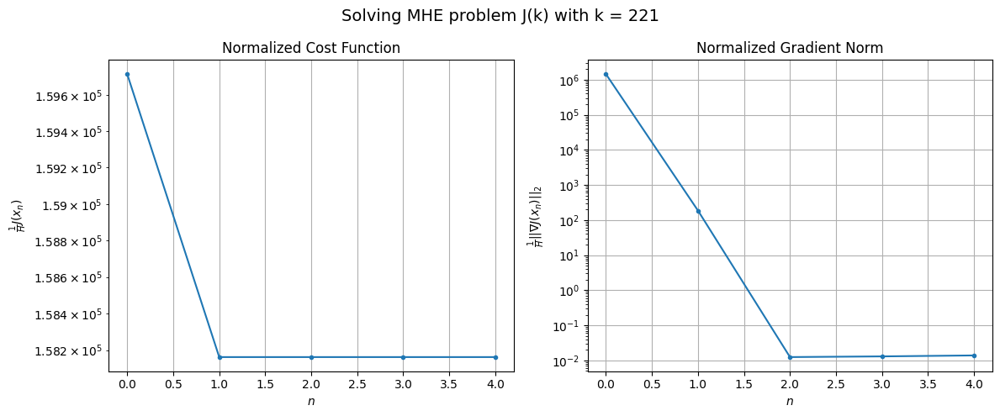

Windows:  42%|████▏     | 123/296 [36:16<42:51, 14.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15949849.487381082
Gradient norm: 143446702.4698453
Global estimation error: 250.8864218908463
Initial conditions estimation errors: 125.01961917164992 m, 125.373318256462 m, 125.44897263494549 m, 125.92864932476785 m
Position estimation errors: 145.98496715528276 m, 145.8765258389263 m, 145.99425937805435 m, 145.3622025121251 m

[Gauss-Newton] Iteration 1
Cost function: 15795582.03449535 (-0.97%)
Gradient norm: 18958.19083691396 (-99.99%)
Global estimation error: 271.8323855182206 (8.35%)
Initial conditions estimation errors: 135.56871004285946 m, 135.9300487147677 m, 135.86577811879488 m, 136.29861923400287 m
Position estimation errors: 135.13946308567037 m, 135.05938914171358 m, 135.2746425272513 m, 134.6955639701184 m

[Gauss-Newton] Iteration 2
Cost function: 15795582.033850893 (-0.00%)
Gradient norm: 1.6207349185656685 (-99.99%)
Global estimation error: 271.83225081995874 (-0.00%)
Initial conditions estimation errors: 13

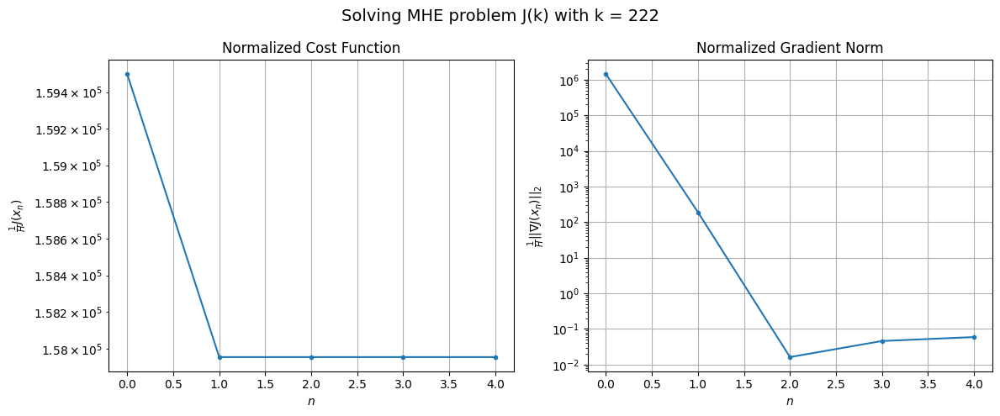

Windows:  42%|████▏     | 124/296 [36:29<41:35, 14.51s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15897896.743175521
Gradient norm: 142468502.87192345
Global estimation error: 248.29868528077643
Initial conditions estimation errors: 123.79762910818323 m, 124.1347795507155 m, 124.13310180948824 m, 124.53014427360613 m
Position estimation errors: 142.89684107746837 m, 142.8924023077185 m, 143.0434429990082 m, 142.51219632404153 m

[Gauss-Newton] Iteration 1
Cost function: 15745126.930262363 (-0.96%)
Gradient norm: 19081.454050162534 (-99.99%)
Global estimation error: 269.17486506316504 (8.41%)
Initial conditions estimation errors: 134.38105602393892 m, 134.4309228423261 m, 134.86889338138639 m, 134.66764659004897 m
Position estimation errors: 132.03950035142975 m, 132.25853525477723 m, 131.95504735405981 m, 132.0253687862194 m

[Gauss-Newton] Iteration 2
Cost function: 15745126.930714095 (0.00%)
Gradient norm: 5.106365480766516 (-99.97%)
Global estimation error: 269.17499634142274 (0.00%)
Initial conditions estimation errors

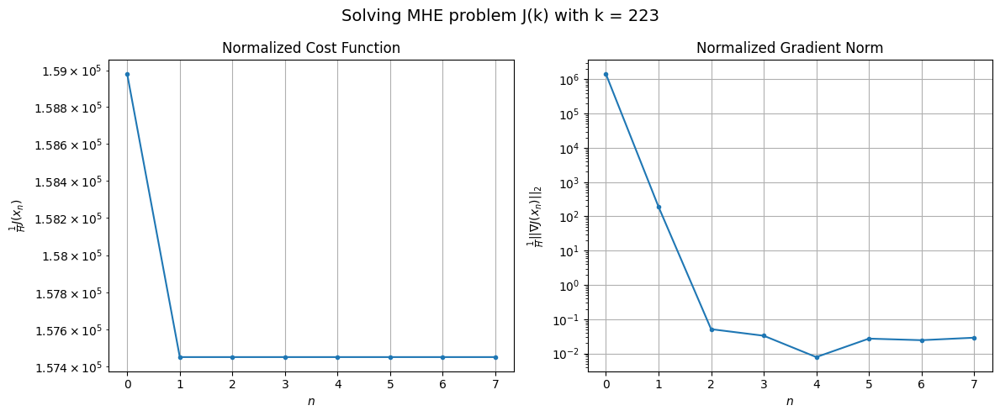

Windows:  42%|████▏     | 125/296 [36:50<46:24, 16.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15813038.388491224
Gradient norm: 140589099.38878143
Global estimation error: 245.40892362837144
Initial conditions estimation errors: 122.4975540177226 m, 122.52434878306165 m, 122.99821515428322 m, 122.79639979315276 m
Position estimation errors: 139.38958384558734 m, 139.65047510292098 m, 139.29954462936595 m, 139.40170288423326 m

[Gauss-Newton] Iteration 1
Cost function: 15663414.316243295 (-0.95%)
Gradient norm: 18999.152304091047 (-99.99%)
Global estimation error: 266.3786163366038 (8.54%)
Initial conditions estimation errors: 133.04526541540193 m, 132.92038423004237 m, 133.55769451457994 m, 133.2323734576091 m
Position estimation errors: 128.57368500787027 m, 129.0113224930785 m, 128.47039610995287 m, 128.72251060961602 m

[Gauss-Newton] Iteration 2
Cost function: 15663414.314133976 (-0.00%)
Gradient norm: 0.8814816630405347 (-100.00%)
Global estimation error: 266.3787067495259 (0.00%)
Initial conditions estimation err

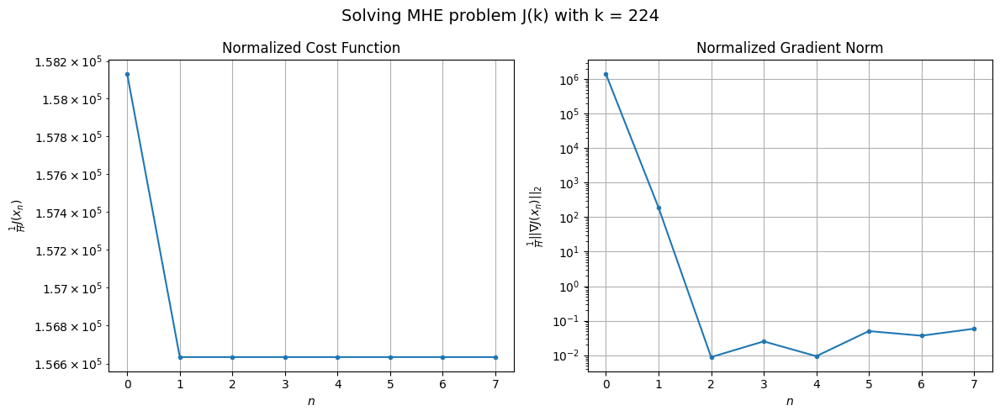

Windows:  43%|████▎     | 126/296 [37:10<49:37, 17.51s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15695298.307815578
Gradient norm: 138403267.03949454
Global estimation error: 242.63678075552136
Initial conditions estimation errors: 121.1794087216183 m, 121.02838564638546 m, 121.69749429225625 m, 121.36660611509924 m
Position estimation errors: 135.45273586770082 m, 135.9100983547409 m, 135.3455086321013 m, 135.6188598240601 m

[Gauss-Newton] Iteration 1
Cost function: 15549648.274424087 (-0.93%)
Gradient norm: 18749.342140022425 (-99.99%)
Global estimation error: 263.69083651844556 (8.68%)
Initial conditions estimation errors: 131.64636362236604 m, 131.49830803575662 m, 132.1673646074584 m, 132.06779770366546 m
Position estimation errors: 124.70099654628007 m, 125.17403271050287 m, 124.57183060978446 m, 124.64350232723572 m

[Gauss-Newton] Iteration 2
Cost function: 15549648.274683803 (0.00%)
Gradient norm: 1.2164233680940926 (-99.99%)
Global estimation error: 263.69077055675876 (-0.00%)
Initial conditions estimation erro

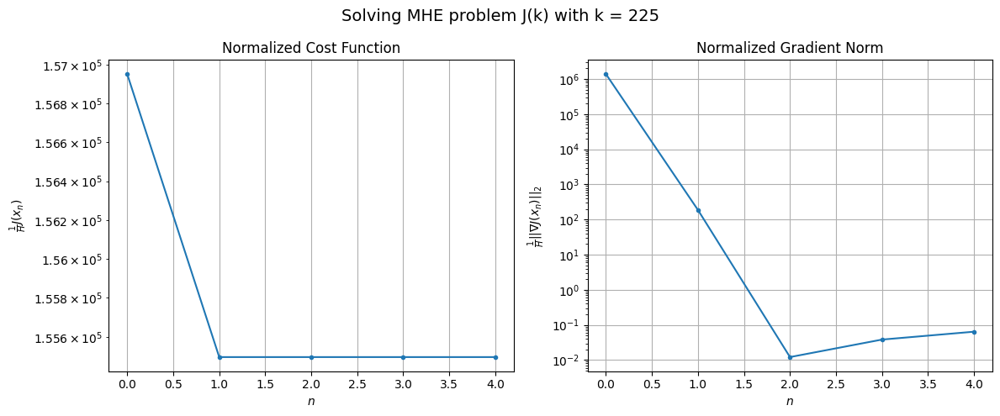

Windows:  43%|████▎     | 127/296 [37:23<45:34, 16.18s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15544372.946111333
Gradient norm: 136151619.12107968
Global estimation error: 239.97505341074466
Initial conditions estimation errors: 119.7991122909753 m, 119.6260537996173 m, 120.31940959977146 m, 120.20353760567716 m
Position estimation errors: 131.0819950537121 m, 131.56930575868026 m, 130.94341028879649 m, 131.05205975991692 m

[Gauss-Newton] Iteration 1
Cost function: 15402583.02469006 (-0.91%)
Gradient norm: 18514.531054166524 (-99.99%)
Global estimation error: 260.9650268501717 (8.75%)
Initial conditions estimation errors: 130.18291871578413 m, 129.99097900131594 m, 130.7704024363171 m, 130.9825480785777 m
Position estimation errors: 120.38989053150797 m, 120.88111726225378 m, 120.14117771752409 m, 119.99536356134892 m

[Gauss-Newton] Iteration 2
Cost function: 15402583.025476053 (0.00%)
Gradient norm: 0.565805884701336 (-100.00%)
Global estimation error: 260.9649985181574 (-0.00%)
Initial conditions estimation errors:

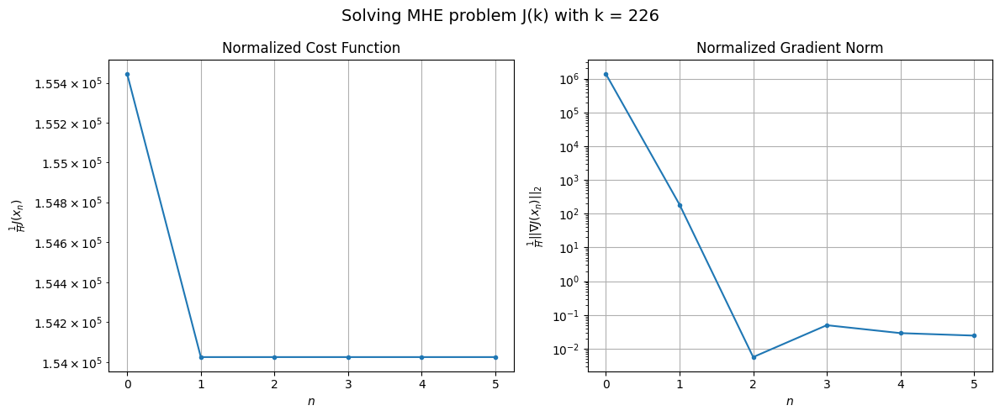

Windows:  43%|████▎     | 128/296 [37:39<44:41, 15.96s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15353776.464467227
Gradient norm: 133033723.06249121
Global estimation error: 237.1157334974956
Initial conditions estimation errors: 118.26764401131116 m, 118.05520044895987 m, 118.8551338708645 m, 119.05000484488785 m
Position estimation errors: 126.28543098884585 m, 126.79177149562149 m, 126.0388991142399 m, 125.94255988746136 m

[Gauss-Newton] Iteration 1
Cost function: 15216938.382575367 (-0.89%)
Gradient norm: 18184.042103140822 (-99.99%)
Global estimation error: 257.4355499819556 (8.57%)
Initial conditions estimation errors: 128.5276177693468 m, 128.1809313018081 m, 129.1336170540537 m, 129.0259513074412 m
Position estimation errors: 115.69670214358268 m, 116.3464721205026 m, 115.36218923034322 m, 115.62645135296412 m

[Gauss-Newton] Iteration 2
Cost function: 15216938.383305669 (0.00%)
Gradient norm: 1.7449948757974458 (-99.99%)
Global estimation error: 257.43558613417275 (0.00%)
Initial conditions estimation errors: 1

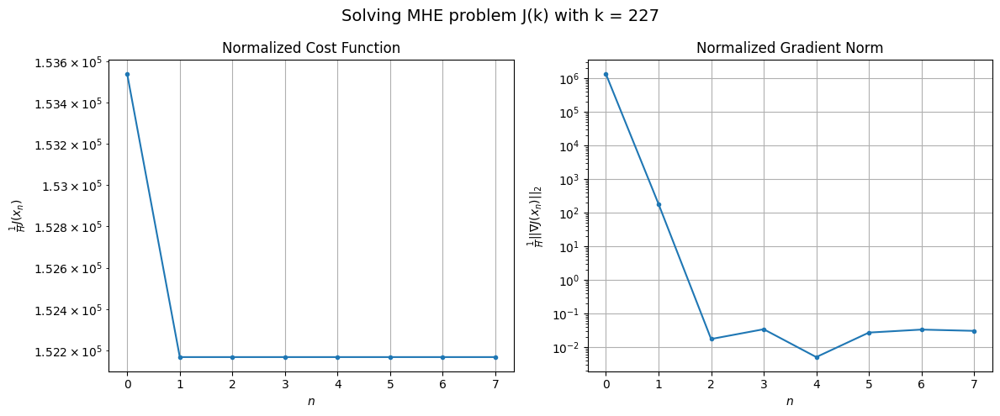

Windows:  44%|████▎     | 129/296 [38:00<48:56, 17.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15128722.458399132
Gradient norm: 130266043.8692146
Global estimation error: 233.23046458426649
Initial conditions estimation errors: 116.4344392377382 m, 116.06810044373462 m, 117.02796364607434 m, 116.92715096716796 m
Position estimation errors: 121.17910106431205 m, 121.81650873730122 m, 120.83485161058239 m, 121.12479881058731 m

[Gauss-Newton] Iteration 1
Cost function: 14997143.908830162 (-0.87%)
Gradient norm: 17725.75126687825 (-99.99%)
Global estimation error: 253.41545633217982 (8.65%)
Initial conditions estimation errors: 126.54655983489826 m, 126.11427218676198 m, 127.2363498368199 m, 126.93022535867371 m
Position estimation errors: 110.69403782805954 m, 111.4591030528492 m, 110.25621123914206 m, 110.7769025728764 m

[Gauss-Newton] Iteration 2
Cost function: 14997143.908924434 (0.00%)
Gradient norm: 2.7117935833381055 (-99.98%)
Global estimation error: 253.41547491473108 (0.00%)
Initial conditions estimation errors

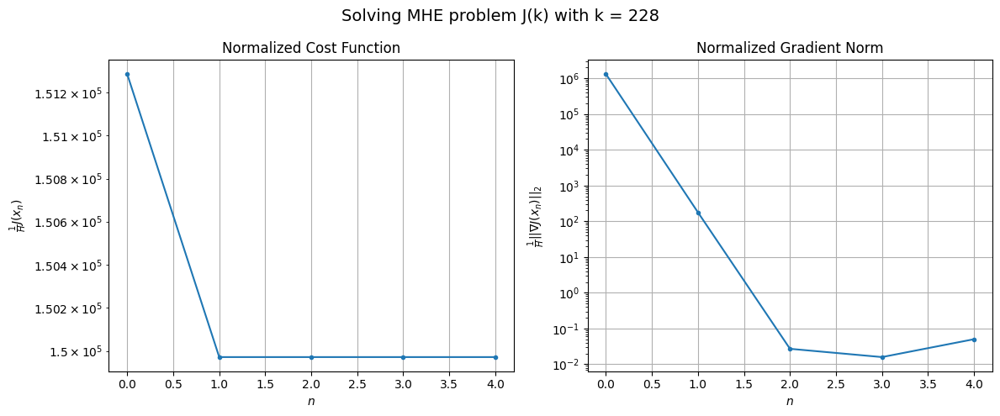

Windows:  44%|████▍     | 130/296 [38:13<44:47, 16.19s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14868016.204389818
Gradient norm: 127332077.58751301
Global estimation error: 228.7011355209545
Initial conditions estimation errors: 114.19768805106085 m, 113.75112252271325 m, 114.86914234301106 m, 114.58049201346041 m
Position estimation errors: 115.90188957658962 m, 116.62745131142614 m, 115.44339081541911 m, 115.96575563131482 m

[Gauss-Newton] Iteration 1
Cost function: 14741775.572766908 (-0.85%)
Gradient norm: 17261.599226239654 (-99.99%)
Global estimation error: 248.73404790699402 (8.76%)
Initial conditions estimation errors: 124.15319078237235 m, 123.86023069137667 m, 124.83111259205151 m, 124.62046666841829 m
Position estimation errors: 105.51761501307436 m, 106.09406969478172 m, 105.04164642972412 m, 105.52703335066033 m

[Gauss-Newton] Iteration 2
Cost function: 14741775.573070636 (0.00%)
Gradient norm: 4.165743518992138 (-99.98%)
Global estimation error: 248.7338744939819 (-0.00%)
Initial conditions estimation er

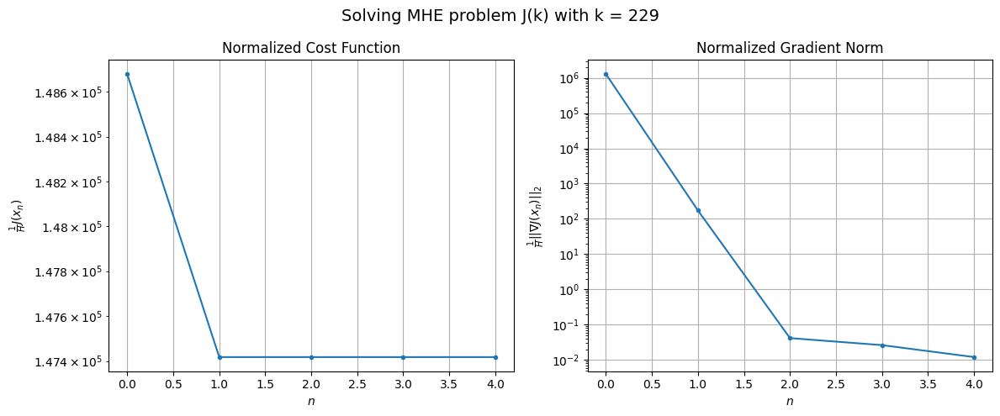

Windows:  44%|████▍     | 131/296 [38:26<42:04, 15.30s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14584674.121906474
Gradient norm: 124739027.21123019
Global estimation error: 223.4998354948712
Initial conditions estimation errors: 111.54371914025799 m, 111.23714916581312 m, 112.20363871440357 m, 112.01178301489625 m
Position estimation errors: 110.63520202822342 m, 111.17509753823292 m, 110.1391052530997 m, 110.61671722043725 m

[Gauss-Newton] Iteration 1
Cost function: 14464483.407398539 (-0.82%)
Gradient norm: 16622.023235768138 (-99.99%)
Global estimation error: 242.9754196543894 (8.71%)
Initial conditions estimation errors: 121.29867219650524 m, 121.0832161639317 m, 121.92618466530311 m, 121.64026599498884 m
Position estimation errors: 100.36771075546127 m, 100.90175046719526 m, 99.97923041508993 m, 100.51715967345683 m

[Gauss-Newton] Iteration 2
Cost function: 14464483.407194076 (-0.00%)
Gradient norm: 2.322334668906756 (-99.99%)
Global estimation error: 242.97536560457925 (-0.00%)
Initial conditions estimation erro

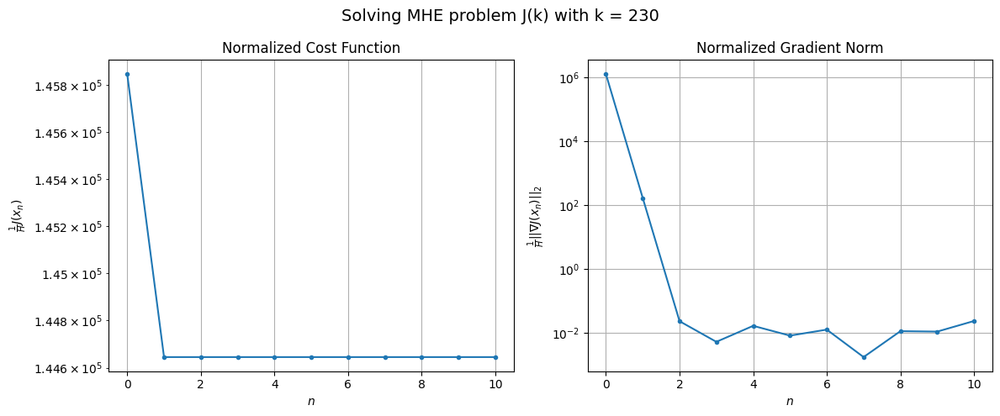

Windows:  45%|████▍     | 132/296 [38:53<51:37, 18.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14289369.099202242
Gradient norm: 122442280.12602992
Global estimation error: 217.3981095792166
Initial conditions estimation errors: 108.51658174742208 m, 108.28974093202407 m, 109.13177848648085 m, 108.85540283824616 m
Position estimation errors: 105.59080703585205 m, 106.08185120974625 m, 105.19717576907853 m, 105.68716605102719 m

[Gauss-Newton] Iteration 1
Cost function: 14175441.99354339 (-0.80%)
Gradient norm: 15892.16011440472 (-99.99%)
Global estimation error: 236.58029112196346 (8.82%)
Initial conditions estimation errors: 118.04255289284674 m, 117.93804250405827 m, 118.69384216774098 m, 118.4836931937331 m
Position estimation errors: 95.44292206421504 m, 95.86125285450336 m, 95.06369963782083 m, 95.52743333557983 m

[Gauss-Newton] Iteration 2
Cost function: 14175441.993210979 (-0.00%)
Gradient norm: 3.6705182094896003 (-99.98%)
Global estimation error: 236.58023211336643 (-0.00%)
Initial conditions estimation errors

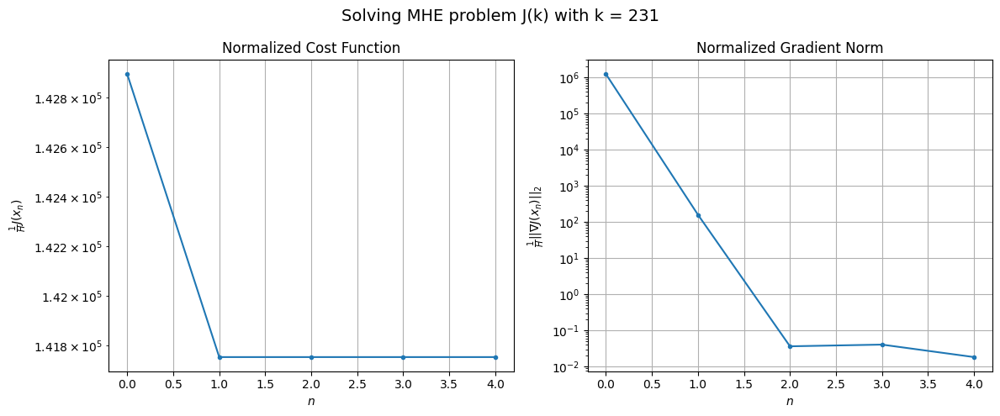

Windows:  45%|████▍     | 133/296 [39:07<46:44, 17.21s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13983067.409948593
Gradient norm: 120439371.49582507
Global estimation error: 210.9738679799777
Initial conditions estimation errors: 105.25006505006763 m, 105.13212548447325 m, 105.88460798617912 m, 105.67831849806755 m
Position estimation errors: 100.93393846928493 m, 101.29894587385019 m, 100.55488613413583 m, 100.9565420715732 m

[Gauss-Newton] Iteration 1
Cost function: 13875142.710474022 (-0.77%)
Gradient norm: 15152.551955462393 (-99.99%)
Global estimation error: 229.63973825328688 (8.85%)
Initial conditions estimation errors: 114.53928208924184 m, 114.5322450296214 m, 115.14465411091896 m, 115.06104491055815 m
Position estimation errors: 90.9020970272694 m, 91.18525104042723 m, 90.56405071290087 m, 90.86440791475435 m

[Gauss-Newton] Iteration 2
Cost function: 13875142.71030954 (-0.00%)
Gradient norm: 3.6799857816761246 (-99.98%)
Global estimation error: 229.63968985226086 (-0.00%)
Initial conditions estimation errors:

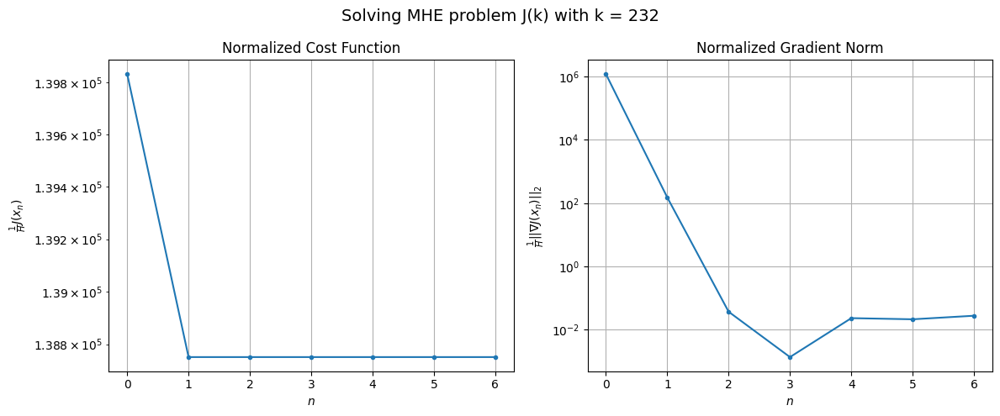

Windows:  45%|████▌     | 134/296 [39:25<47:01, 17.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13686581.320970314
Gradient norm: 119019024.03183924
Global estimation error: 204.37878696312592
Initial conditions estimation errors: 101.92607153123748 m, 101.90256876045717 m, 102.51020834655328 m, 102.41639540105105 m
Position estimation errors: 96.7634979697402 m, 96.97591029983532 m, 96.43370915573578 m, 96.65577022653986 m

[Gauss-Newton] Iteration 1
Cost function: 13584659.314294994 (-0.74%)
Gradient norm: 14290.035441281225 (-99.99%)
Global estimation error: 222.39014878419502 (8.81%)
Initial conditions estimation errors: 110.9437761765074 m, 110.86324320447248 m, 111.56705190832086 m, 111.40379634962454 m
Position estimation errors: 86.85285661642587 m, 87.12877108871086 m, 86.43610194191955 m, 86.74997328001386 m

[Gauss-Newton] Iteration 2
Cost function: 13584659.31345586 (-0.00%)
Gradient norm: 1.8121446314280563 (-99.99%)
Global estimation error: 222.39014280959367 (-0.00%)
Initial conditions estimation errors: 1

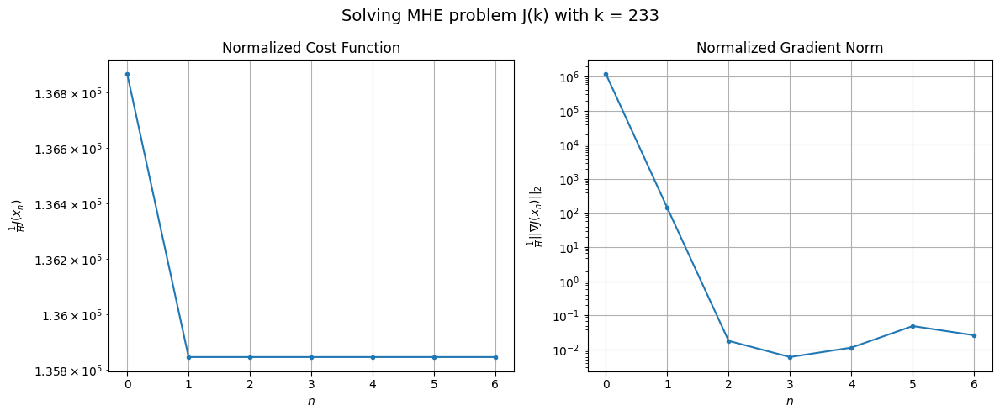

Windows:  46%|████▌     | 135/296 [39:42<46:57, 17.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13406098.091984231
Gradient norm: 118071228.79170078
Global estimation error: 197.8219263363905
Initial conditions estimation errors: 98.67930182005445 m, 98.59420193203327 m, 99.26946148673915 m, 99.09846325648218 m
Position estimation errors: 93.14136904683957 m, 93.30744804597231 m, 92.72325465244758 m, 92.93721226891223 m

[Gauss-Newton] Iteration 1
Cost function: 13309862.616890414 (-0.72%)
Gradient norm: 13439.047170423086 (-99.99%)
Global estimation error: 215.2804887673281 (8.83%)
Initial conditions estimation errors: 107.4156296087468 m, 107.4328994233282 m, 107.88912492853017 m, 107.82163168352965 m
Position estimation errors: 83.36883703064993 m, 83.50874604002789 m, 83.0829869109188 m, 83.21513029267793 m

[Gauss-Newton] Iteration 2
Cost function: 13309862.618160252 (0.00%)
Gradient norm: 3.768557563497976 (-99.97%)
Global estimation error: 215.28046100139466 (-0.00%)
Initial conditions estimation errors: 107.41561

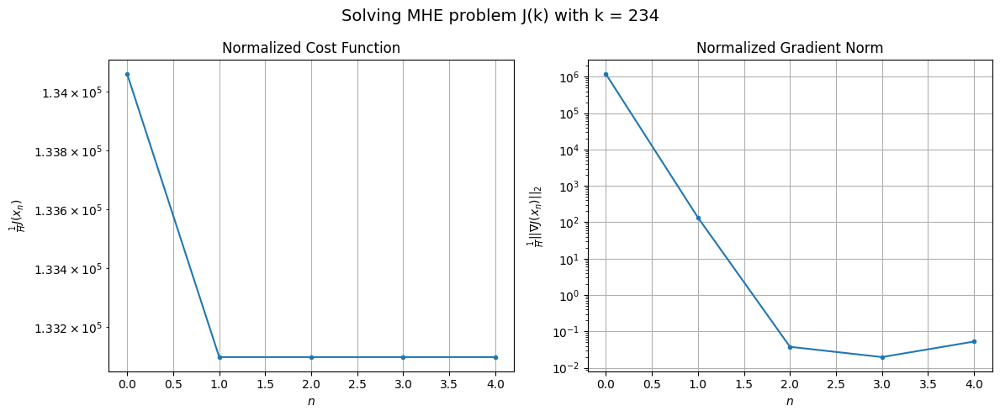

Windows:  46%|████▌     | 136/296 [39:55<43:04, 16.15s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13139027.48382892
Gradient norm: 116662459.99111943
Global estimation error: 191.65719079941454
Initial conditions estimation errors: 95.62506207920507 m, 95.6377349881326 m, 96.06557383457249 m, 95.98439140777889 m
Position estimation errors: 90.13878228518914 m, 90.18860514376941 m, 89.85367736938869 m, 89.88443870244467 m

[Gauss-Newton] Iteration 1
Cost function: 13047918.146963479 (-0.69%)
Gradient norm: 12643.305356093619 (-99.99%)
Global estimation error: 208.7466367527073 (8.92%)
Initial conditions estimation errors: 104.09049864708908 m, 104.21162812453319 m, 104.57801619229684 m, 104.6113577046459 m
Position estimation errors: 80.52884823460539 m, 80.47631431517907 m, 80.17659398629908 m, 80.18363121275507 m

[Gauss-Newton] Iteration 2
Cost function: 13047918.146742262 (-0.00%)
Gradient norm: 1.795534122011681 (-99.99%)
Global estimation error: 208.7465903772529 (-0.00%)
Initial conditions estimation errors: 104.0904

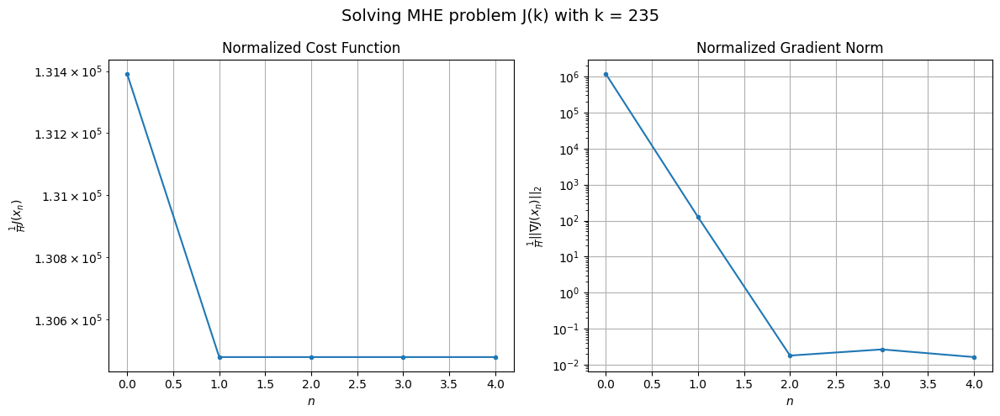

Windows:  46%|████▋     | 137/296 [40:08<39:48, 15.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12893418.190821994
Gradient norm: 115621687.95888062
Global estimation error: 186.2369341213119
Initial conditions estimation errors: 92.86229208326449 m, 92.97830621218594 m, 93.30869923168571 m, 93.32293391050808 m
Position estimation errors: 87.8361103590115 m, 87.69730619956982 m, 87.47896444015475 m, 87.39422343019422 m

[Gauss-Newton] Iteration 1
Cost function: 12807752.842349302 (-0.66%)
Gradient norm: 11701.55942820242 (-99.99%)
Global estimation error: 202.65167324062259 (8.81%)
Initial conditions estimation errors: 101.00679360286175 m, 101.27821691650841 m, 101.39703831172639 m, 101.61957362887024 m
Position estimation errors: 78.44431313385577 m, 78.28244126930967 m, 78.21166167291041 m, 78.02621159558342 m

[Gauss-Newton] Iteration 2
Cost function: 12807752.841790736 (-0.00%)
Gradient norm: 3.9504781905131265 (-99.97%)
Global estimation error: 202.65163070785943 (-0.00%)
Initial conditions estimation errors: 101.0

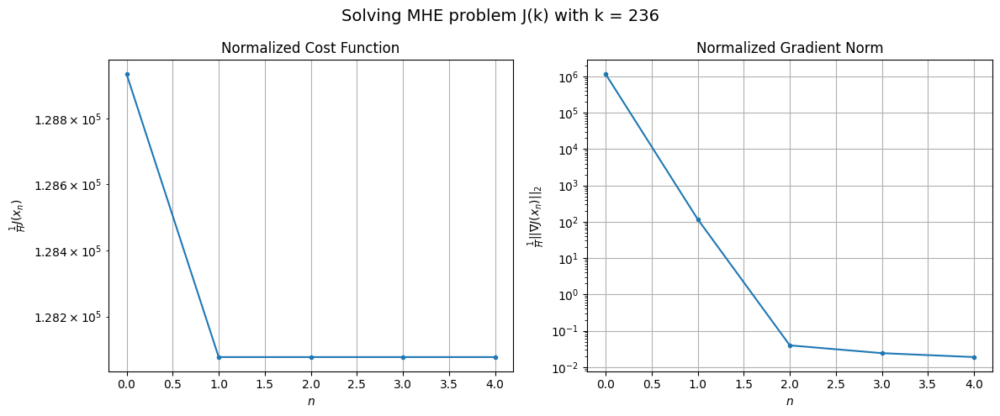

Windows:  47%|████▋     | 138/296 [40:20<37:24, 14.20s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12670230.511094717
Gradient norm: 114747633.97967398
Global estimation error: 181.38874703067592
Initial conditions estimation errors: 90.41144584874155 m, 90.66045630068295 m, 90.76178204270671 m, 90.942278292453 m
Position estimation errors: 86.28482994809416 m, 86.0677981841515 m, 86.0453232539043 m, 85.79666497142136 m

[Gauss-Newton] Iteration 1
Cost function: 12588543.062133202 (-0.64%)
Gradient norm: 11002.991451631391 (-99.99%)
Global estimation error: 197.0804063964086 (8.65%)
Initial conditions estimation errors: 98.29309908337181 m, 98.50224579333933 m, 98.64391794940425 m, 98.7202926268748 m
Position estimation errors: 77.09956652658894 m, 76.93812765444284 m, 76.87389686766215 m, 76.70076094904518 m

[Gauss-Newton] Iteration 2
Cost function: 12588543.062417645 (0.00%)
Gradient norm: 4.614911498484922 (-99.96%)
Global estimation error: 197.08038252604481 (-0.00%)
Initial conditions estimation errors: 98.29308625320

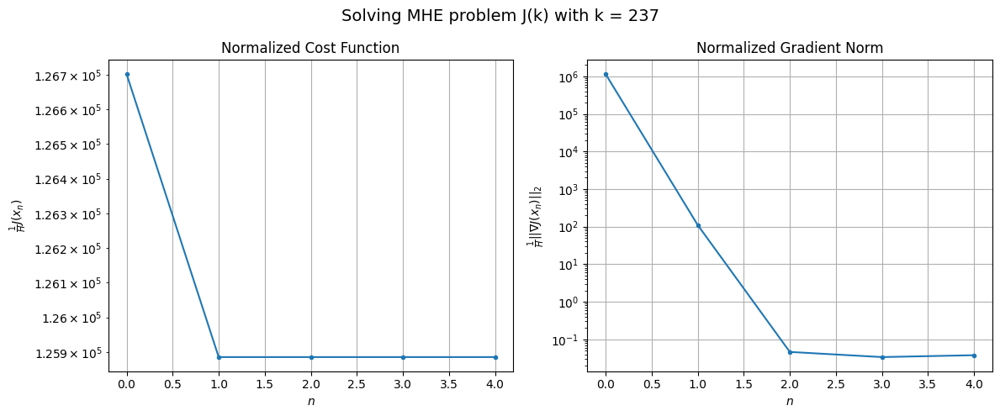

Windows:  47%|████▋     | 139/296 [40:32<35:40, 13.63s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12469601.254576262
Gradient norm: 113502864.98672886
Global estimation error: 177.17209839418985
Initial conditions estimation errors: 88.37021391451749 m, 88.56595467781135 m, 88.67766732004027 m, 88.7292562378769 m
Position estimation errors: 85.35998604526054 m, 85.14659670063341 m, 85.12818880661017 m, 84.89003033630645 m

[Gauss-Newton] Iteration 1
Cost function: 12392221.942225477 (-0.62%)
Gradient norm: 10186.30557354561 (-99.99%)
Global estimation error: 192.31910427989686 (8.55%)
Initial conditions estimation errors: 95.9517071882058 m, 96.165221398234 m, 96.28402236047911 m, 96.2362423344225 m
Position estimation errors: 76.45083096759343 m, 76.2113784960754 m, 76.22541800822904 m, 75.98977289255679 m

[Gauss-Newton] Iteration 2
Cost function: 12392221.943791853 (0.00%)
Gradient norm: 1.1202400921704847 (-99.99%)
Global estimation error: 192.31908546517812 (-0.00%)
Initial conditions estimation errors: 95.95169643586

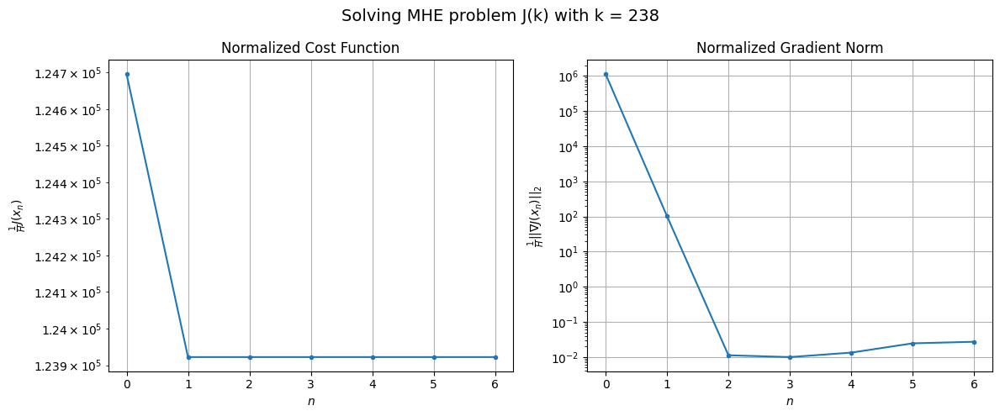

Windows:  47%|████▋     | 140/296 [40:49<38:10, 14.68s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12291806.156015549
Gradient norm: 111728546.64705038
Global estimation error: 173.74958914778054
Initial conditions estimation errors: 86.69464473927941 m, 86.8941030151349 m, 86.9805345097445 m, 86.92899079062553 m
Position estimation errors: 84.95811268037893 m, 84.6700442079987 m, 84.72472674423487 m, 84.42597373613727 m

[Gauss-Newton] Iteration 1
Cost function: 12218334.376237605 (-0.60%)
Gradient norm: 9450.866571646491 (-99.99%)
Global estimation error: 188.35487616494487 (8.41%)
Initial conditions estimation errors: 93.99295134765927 m, 94.25697082151414 m, 94.24879554615397 m, 94.21014794534125 m
Position estimation errors: 76.36419730585546 m, 76.01506604439457 m, 76.21870158175282 m, 75.81312404288416 m

[Gauss-Newton] Iteration 2
Cost function: 12218334.375779942 (-0.00%)
Gradient norm: 8.144340568820587 (-99.91%)
Global estimation error: 188.3548524822772 (-0.00%)
Initial conditions estimation errors: 93.992942575

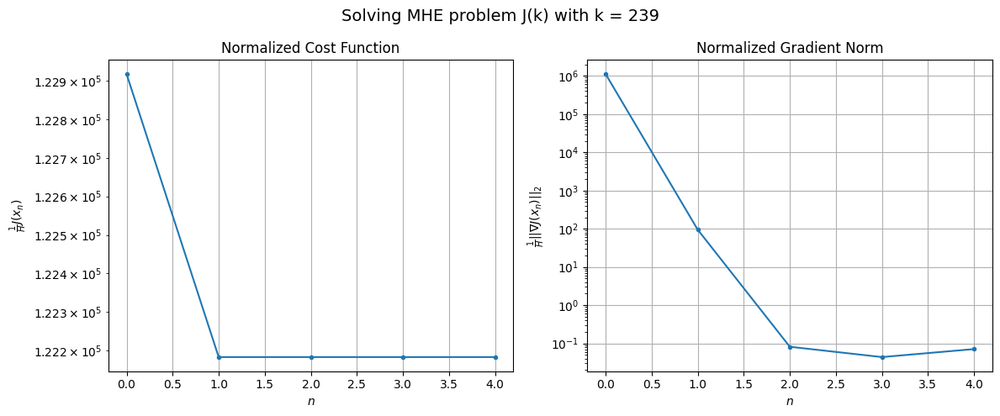

Windows:  48%|████▊     | 141/296 [41:02<36:01, 13.94s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12135974.421880513
Gradient norm: 109792334.24455178
Global estimation error: 171.01640247320043
Initial conditions estimation errors: 85.34233646309238 m, 85.6054281577571 m, 85.55291518581005 m, 85.53129301144378 m
Position estimation errors: 84.97272362487243 m, 84.56868539069103 m, 84.82107352953965 m, 84.35117237779959 m

[Gauss-Newton] Iteration 1
Cost function: 12065915.528477399 (-0.58%)
Gradient norm: 8767.265660741054 (-99.99%)
Global estimation error: 185.27297267395272 (8.34%)
Initial conditions estimation errors: 92.37942772523114 m, 92.67238394645315 m, 92.68054503601216 m, 92.8124399570257 m
Position estimation errors: 76.7117042763299 m, 76.30984053929231 m, 76.47887215505975 m, 76.14054408701209 m

[Gauss-Newton] Iteration 2
Cost function: 12065915.52934886 (0.00%)
Gradient norm: 2.1351370573500215 (-99.98%)
Global estimation error: 185.2729549364773 (-0.00%)
Initial conditions estimation errors: 92.3794207926

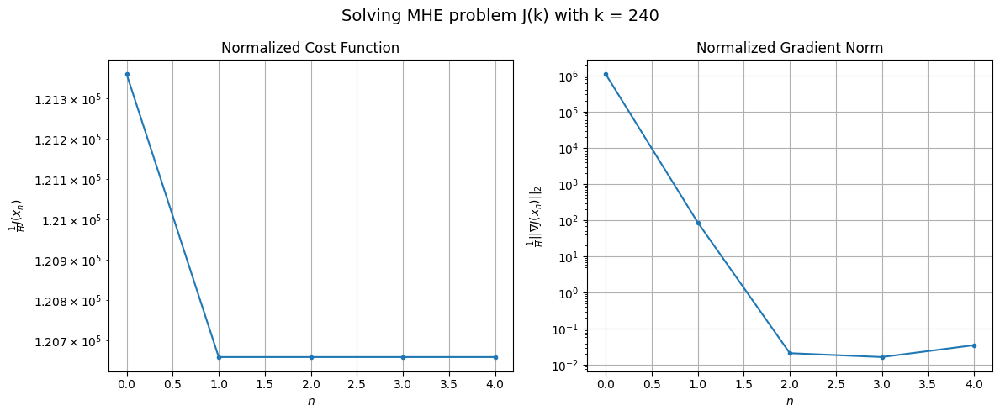

Windows:  48%|████▊     | 142/296 [41:14<34:52, 13.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12005265.727849258
Gradient norm: 108123278.07418844
Global estimation error: 168.94377605687095
Initial conditions estimation errors: 84.24333268673111 m, 84.53591192780853 m, 84.49484504646551 m, 84.61243096974215 m
Position estimation errors: 85.33984787103269 m, 84.8874357799515 m, 85.09524549498636 m, 84.72018165513947 m

[Gauss-Newton] Iteration 1
Cost function: 11938083.06817005 (-0.56%)
Gradient norm: 8136.920783767781 (-99.99%)
Global estimation error: 182.5630998806967 (8.06%)
Initial conditions estimation errors: 91.04086555621917 m, 91.34342273864569 m, 91.29836393018475 m, 91.44248004633299 m
Position estimation errors: 77.40990793922668 m, 76.90939323601918 m, 77.15681821514023 m, 76.78292339945676 m

[Gauss-Newton] Iteration 2
Cost function: 11938083.069183804 (0.00%)
Gradient norm: 5.83195327438147 (-99.93%)
Global estimation error: 182.5630865220482 (-0.00%)
Initial conditions estimation errors: 91.04086033907

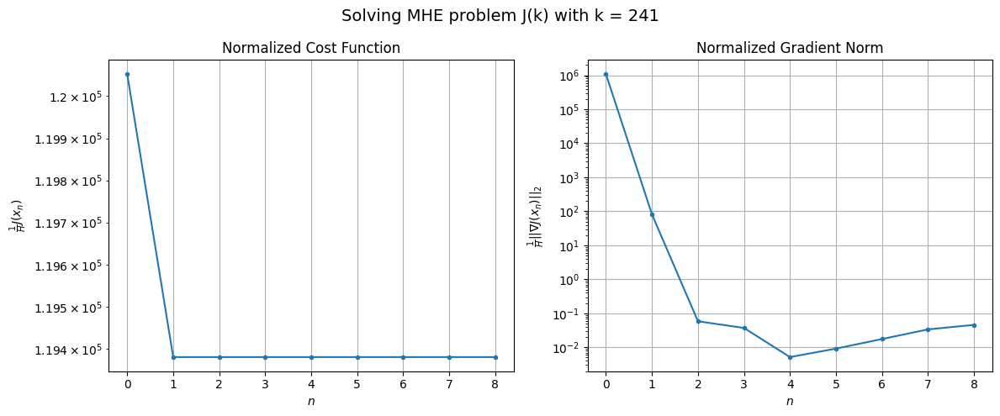

Windows:  48%|████▊     | 143/296 [41:36<40:50, 16.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11894821.393932732
Gradient norm: 105760561.68472742
Global estimation error: 167.06644080536296
Initial conditions estimation errors: 83.31809204420728 m, 83.62679797363994 m, 83.52616599866262 m, 83.66083236046201 m
Position estimation errors: 86.0155644348509 m, 85.46462993750082 m, 85.74963529337242 m, 85.33859362214298 m

[Gauss-Newton] Iteration 1
Cost function: 11830477.467103904 (-0.54%)
Gradient norm: 7544.58443841512 (-99.99%)
Global estimation error: 180.27156944452244 (7.90%)
Initial conditions estimation errors: 89.8907770131114 m, 90.22069523058201 m, 90.19062750072344 m, 90.24001441689931 m
Position estimation errors: 78.45735938730695 m, 77.91807947303656 m, 78.19286949030287 m, 77.72862840061235 m

[Gauss-Newton] Iteration 2
Cost function: 11830477.46778858 (0.00%)
Gradient norm: 0.292250344074571 (-100.00%)
Global estimation error: 180.27156902979908 (-0.00%)
Initial conditions estimation errors: 89.890773224

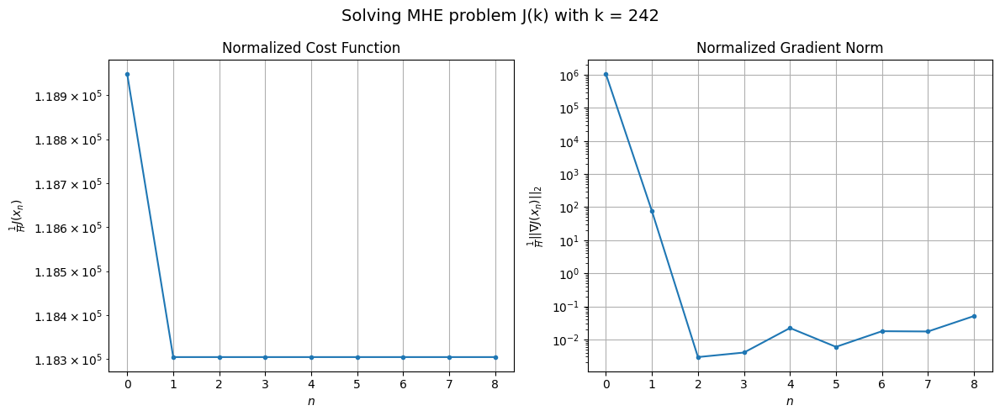

Windows:  49%|████▊     | 144/296 [41:58<45:01, 17.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11805965.95397292
Gradient norm: 102749985.45846294
Global estimation error: 165.43732091713315
Initial conditions estimation errors: 82.49082526559842 m, 82.83246987029386 m, 82.73930386720018 m, 82.81103368321301 m
Position estimation errors: 87.01478173065566 m, 86.42314893138122 m, 86.73384134235499 m, 86.22803098829705 m

[Gauss-Newton] Iteration 1
Cost function: 11744275.093385484 (-0.52%)
Gradient norm: 6978.725849381555 (-99.99%)
Global estimation error: 178.21655484697584 (7.72%)
Initial conditions estimation errors: 88.85081858633049 m, 89.25739936816686 m, 89.08902895495345 m, 89.23470255848846 m
Position estimation errors: 79.83996290091939 m, 79.19774938535008 m, 79.58691606967791 m, 79.11092613241257 m

[Gauss-Newton] Iteration 2
Cost function: 11744275.094085043 (0.00%)
Gradient norm: 2.3419607324358567 (-99.97%)
Global estimation error: 178.21655088073433 (-0.00%)
Initial conditions estimation errors: 88.850816

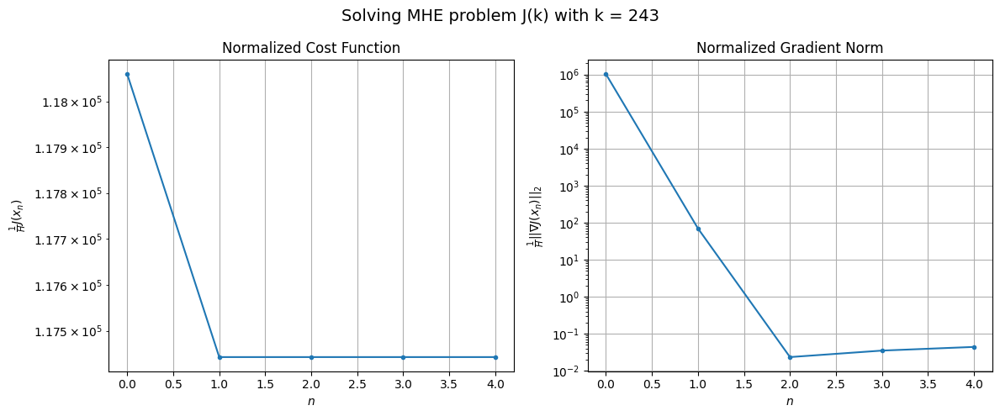

Windows:  49%|████▉     | 145/296 [42:11<40:57, 16.27s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11739391.140342778
Gradient norm: 99765416.90761213
Global estimation error: 163.94207422440383
Initial conditions estimation errors: 81.72802063080648 m, 82.15840210251267 m, 81.91830454696415 m, 82.07819776435002 m
Position estimation errors: 88.3382063464064 m, 87.648388554902 m, 88.06798429701036 m, 87.55757748073692 m

[Gauss-Newton] Iteration 1
Cost function: 11680094.005910946 (-0.51%)
Gradient norm: 6465.792499324216 (-99.99%)
Global estimation error: 176.34292864272172 (7.56%)
Initial conditions estimation errors: 87.88946700311226 m, 88.37895726636607 m, 88.11153193454585 m, 88.30451393452155 m
Position estimation errors: 81.55149042709537 m, 80.8506271784761 m, 81.351971430956 m, 80.84944086768887 m

[Gauss-Newton] Iteration 2
Cost function: 11680094.006627183 (0.00%)
Gradient norm: 1.7700650084175866 (-99.97%)
Global estimation error: 176.34292699734408 (-0.00%)
Initial conditions estimation errors: 87.889465448234

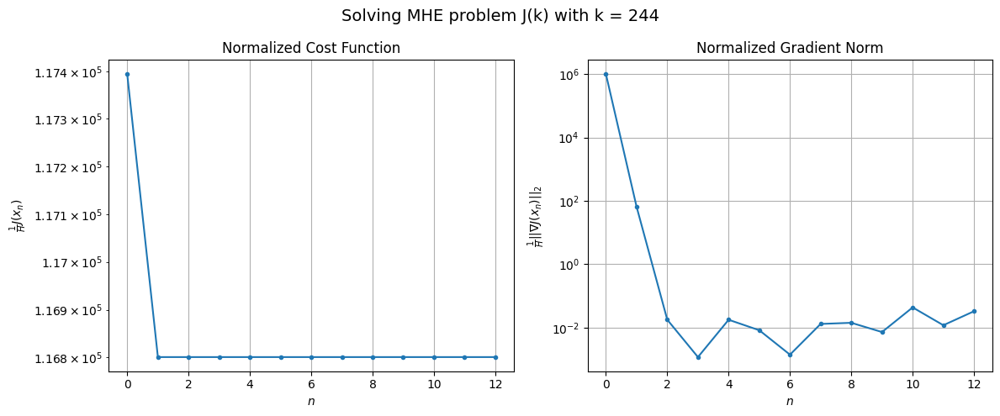

Windows:  49%|████▉     | 146/296 [42:42<51:52, 20.75s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11698931.17623749
Gradient norm: 95872323.36695787
Global estimation error: 162.66338294806826
Initial conditions estimation errors: 81.06629500207835 m, 81.57652623318171 m, 81.24099114071294 m, 81.44147151914399 m
Position estimation errors: 89.98875124619668 m, 89.23814303061195 m, 89.77226068311394 m, 89.24133624738916 m

[Gauss-Newton] Iteration 1
Cost function: 11642312.022444941 (-0.48%)
Gradient norm: 5901.66429031724 (-99.99%)
Global estimation error: 174.61662795519246 (7.35%)
Initial conditions estimation errors: 87.0080578027122 m, 87.5785889094109 m, 87.23645655630838 m, 87.40856570363214 m
Position estimation errors: 83.61153949037823 m, 82.82301186380097 m, 83.38575747098002 m, 82.62133967259635 m

[Gauss-Newton] Iteration 2
Cost function: 11642312.02228151 (-0.00%)
Gradient norm: 5.2082366168437595 (-99.91%)
Global estimation error: 174.61665916843407 (0.00%)
Initial conditions estimation errors: 87.00805699672

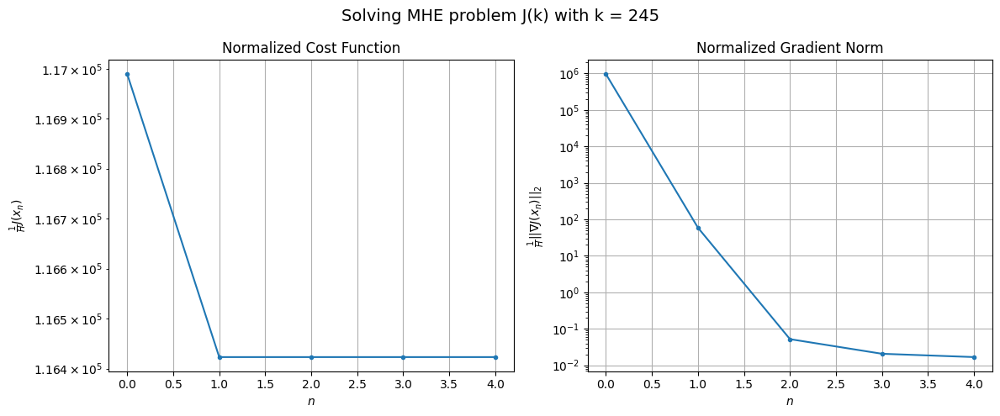

Windows:  50%|████▉     | 147/296 [42:55<45:35, 18.36s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11686562.540809864
Gradient norm: 91760523.08413643
Global estimation error: 161.71939732751858
Initial conditions estimation errors: 80.56204474071357 m, 81.15670364306628 m, 80.75094436700886 m, 80.96732490377039 m
Position estimation errors: 91.97312212440981 m, 91.13094762686472 m, 91.72813404200308 m, 90.92356918872221 m

[Gauss-Newton] Iteration 1
Cost function: 11632189.447053881 (-0.47%)
Gradient norm: 5411.834977866047 (-99.99%)
Global estimation error: 173.33784787687156 (7.18%)
Initial conditions estimation errors: 86.3015321531717 m, 86.98782874485217 m, 86.59393963167416 m, 86.79036409442281 m
Position estimation errors: 85.98254123693911 m, 85.02381431631629 m, 85.64142295576576 m, 84.62187984591854 m

[Gauss-Newton] Iteration 2
Cost function: 11632189.448133323 (0.00%)
Gradient norm: 1.717304847685242 (-99.97%)
Global estimation error: 173.3378625813316 (0.00%)
Initial conditions estimation errors: 86.3015317905

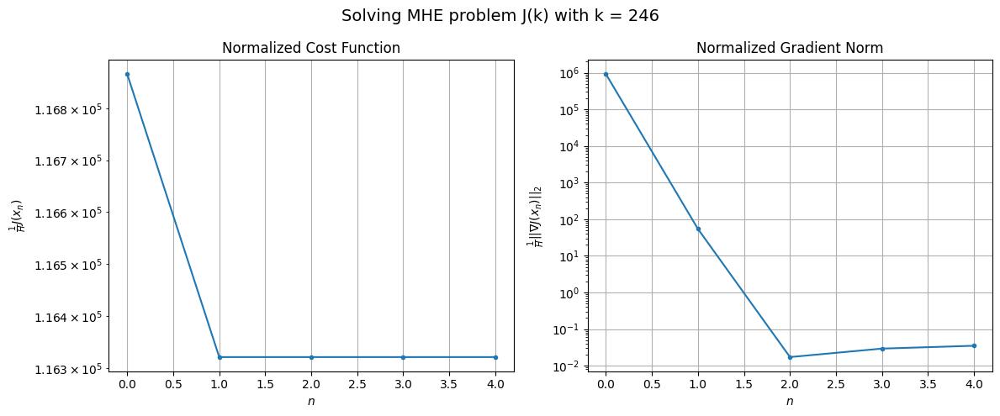

Windows:  50%|█████     | 148/296 [43:07<41:03, 16.64s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11701306.485566687
Gradient norm: 86786894.66998965
Global estimation error: 161.3638450257041
Initial conditions estimation errors: 80.3073428967454 m, 81.02285101060698 m, 80.55451421434157 m, 80.84062349376457 m
Position estimation errors: 94.22623048702096 m, 93.21841043995727 m, 93.86534064106027 m, 92.80315034015852 m

[Gauss-Newton] Iteration 1
Cost function: 11649437.411147688 (-0.44%)
Gradient norm: 4878.5380453253565 (-99.99%)
Global estimation error: 172.56976500563732 (6.94%)
Initial conditions estimation errors: 85.82274340365558 m, 86.64007075552779 m, 86.18466345945568 m, 86.4892621772253 m
Position estimation errors: 88.62596013967328 m, 87.4145697943863 m, 88.20968497101366 m, 86.97991121016715 m

[Gauss-Newton] Iteration 2
Cost function: 11649437.41136689 (0.00%)
Gradient norm: 1.2071808613896249 (-99.98%)
Global estimation error: 172.56981737301817 (0.00%)
Initial conditions estimation errors: 85.82274318531

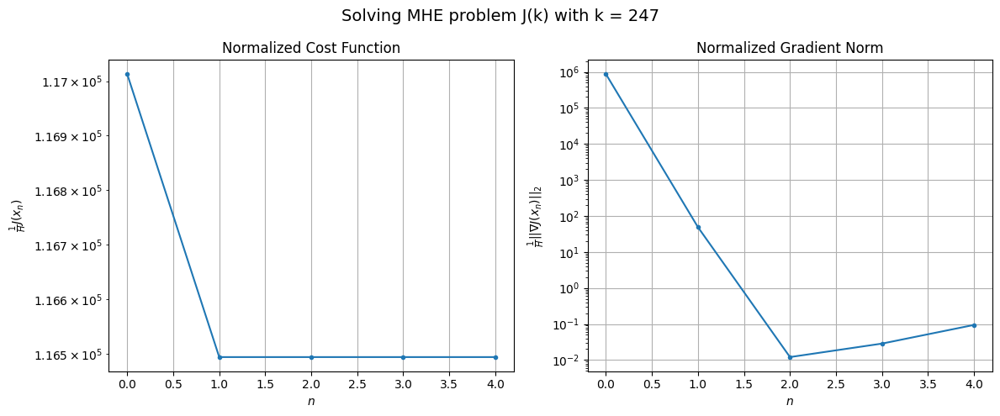

Windows:  50%|█████     | 149/296 [43:20<37:48, 15.43s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11748629.264664544
Gradient norm: 81795088.5525035
Global estimation error: 161.58509430522435
Initial conditions estimation errors: 80.3164449824513 m, 81.1773254535565 m, 80.627060698372 m, 81.04599289088671 m
Position estimation errors: 96.68991753078323 m, 95.42968277261711 m, 96.25464561711009 m, 94.99210706160956 m

[Gauss-Newton] Iteration 1
Cost function: 11699103.826298315 (-0.42%)
Gradient norm: 4341.563334003968 (-99.99%)
Global estimation error: 172.07792528891667 (6.49%)
Initial conditions estimation errors: 85.60231199070851 m, 86.37880565148711 m, 85.94102183565316 m, 86.23117321685055 m
Position estimation errors: 91.44683721895845 m, 90.2870857840977 m, 91.07970508401581 m, 89.94059426447363 m

[Gauss-Newton] Iteration 2
Cost function: 11699103.8256598 (-0.00%)
Gradient norm: 2.455323626687739 (-99.94%)
Global estimation error: 172.07788797776328 (-0.00%)
Initial conditions estimation errors: 85.60231168933204

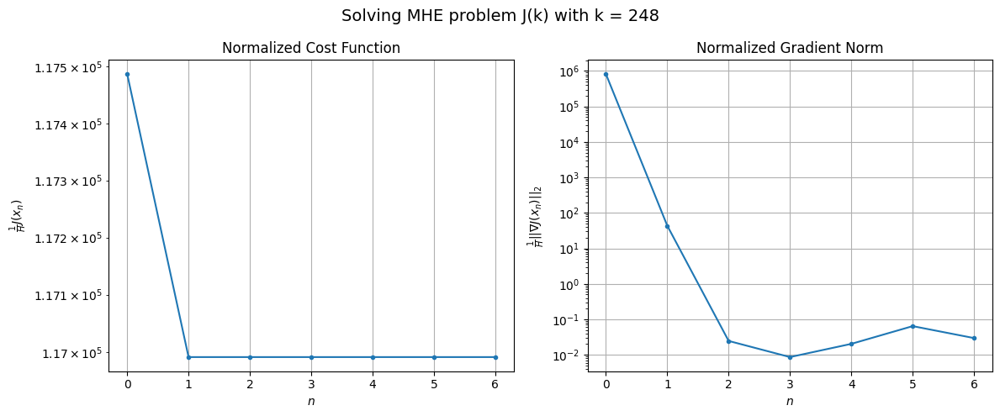

Windows:  51%|█████     | 150/296 [43:37<38:36, 15.87s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11823799.215351943
Gradient norm: 75912693.16125546
Global estimation error: 162.05934944882904
Initial conditions estimation errors: 80.58142519841736 m, 81.40853169702929 m, 80.86890502075866 m, 81.25679155901975 m
Position estimation errors: 99.26510113719107 m, 98.05737327082358 m, 98.88151565601774 m, 97.71592413206771 m

[Gauss-Newton] Iteration 1
Cost function: 11776203.711159693 (-0.40%)
Gradient norm: 3890.984387773027 (-99.99%)
Global estimation error: 172.18295240621944 (6.25%)
Initial conditions estimation errors: 85.66703041744852 m, 86.4253687026143 m, 85.95534060463704 m, 86.31562022549723 m
Position estimation errors: 94.34766434223457 m, 93.25696022090538 m, 94.08150941840758 m, 92.9406546447846 m

[Gauss-Newton] Iteration 2
Cost function: 11776203.710262185 (-0.00%)
Gradient norm: 7.65930032054889 (-99.80%)
Global estimation error: 172.18288761152948 (-0.00%)
Initial conditions estimation errors: 85.667029647

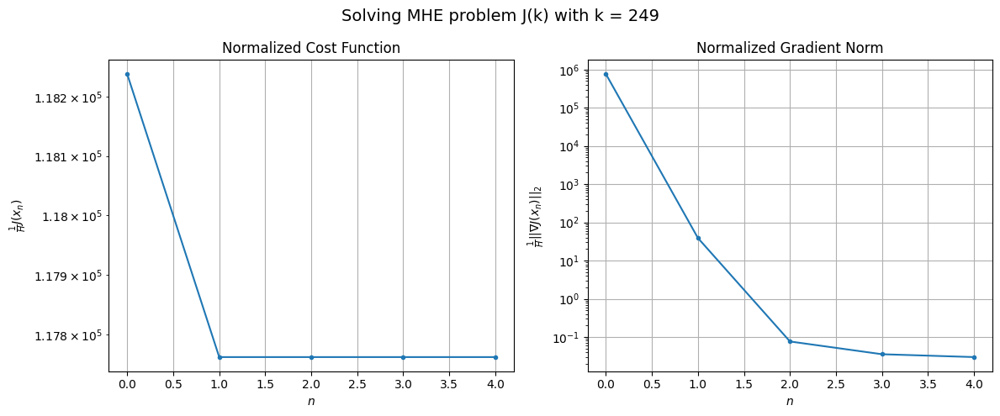

Windows:  51%|█████     | 151/296 [43:49<35:46, 14.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11928128.122755133
Gradient norm: 69090108.9316864
Global estimation error: 163.06539509664418
Initial conditions estimation errors: 81.10093809839888 m, 81.90484374752681 m, 81.33781463724486 m, 81.78417582606012 m
Position estimation errors: 101.86267768868369 m, 100.72474883533832 m, 101.58246312454808 m, 100.42835944798333 m

[Gauss-Newton] Iteration 1
Cost function: 11882722.789317463 (-0.38%)
Gradient norm: 3394.3277871611695 (-100.00%)
Global estimation error: 172.74700267824716 (5.94%)
Initial conditions estimation errors: 85.96590982144274 m, 86.71335458994332 m, 86.13542091091975 m, 86.67641739982847 m
Position estimation errors: 97.25594606120382 m, 96.09230482818175 m, 97.03361654170627 m, 95.65737569601012 m

[Gauss-Newton] Iteration 2
Cost function: 11882722.790421503 (0.00%)
Gradient norm: 7.834159948817635 (-99.77%)
Global estimation error: 172.74698614266052 (-0.00%)
Initial conditions estimation errors: 85.96

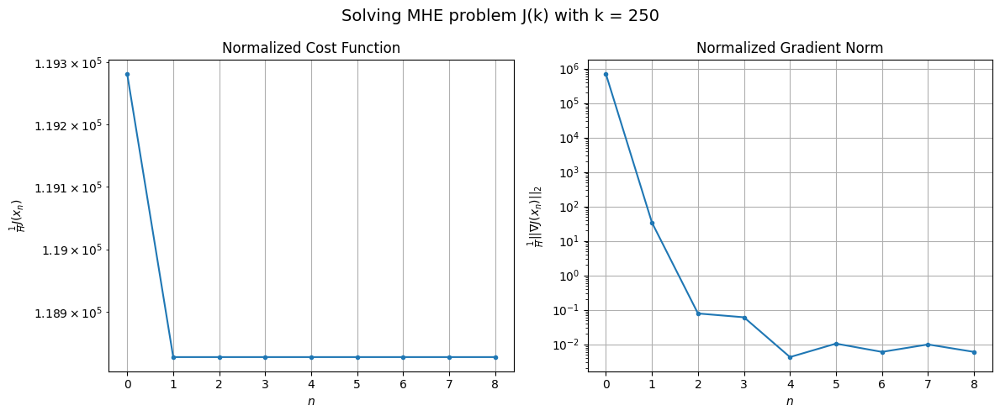

Windows:  51%|█████▏    | 152/296 [44:10<40:06, 16.71s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12060151.913147012
Gradient norm: 62286950.69290723
Global estimation error: 164.48070609839942
Initial conditions estimation errors: 81.8089628019257 m, 82.61696031064541 m, 81.9426830269254 m, 82.58916686672185 m
Position estimation errors: 104.42969197867382 m, 103.21852640943905 m, 104.19427392836022 m, 102.80625224156712 m

[Gauss-Newton] Iteration 1
Cost function: 12016111.58465224 (-0.37%)
Gradient norm: 3004.2227072067462 (-100.00%)
Global estimation error: 173.82495169818895 (5.68%)
Initial conditions estimation errors: 86.50445037833494 m, 87.22307235088812 m, 86.72340470374293 m, 87.19641812141525 m
Position estimation errors: 100.07717838792253 m, 99.03159639359845 m, 99.78608872040006 m, 98.48021505449451 m

[Gauss-Newton] Iteration 2
Cost function: 12016111.584501134 (-0.00%)
Gradient norm: 2.105455998244576 (-99.93%)
Global estimation error: 173.82474528583143 (-0.00%)
Initial conditions estimation errors: 86.50

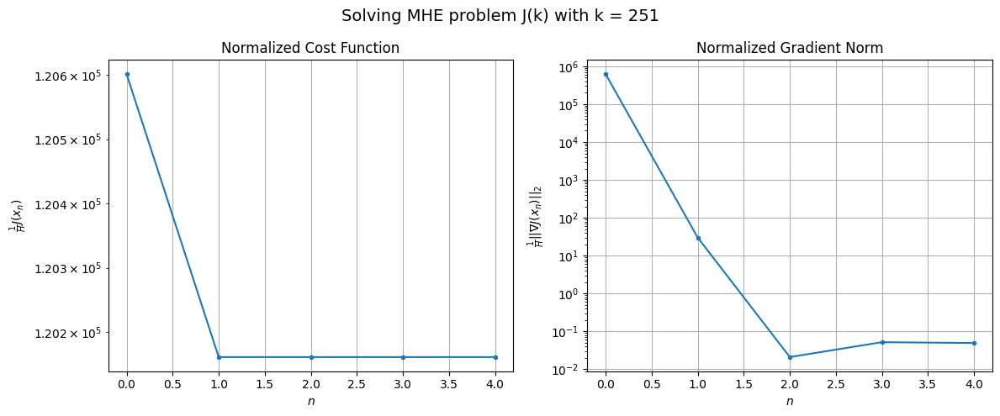

Windows:  52%|█████▏    | 153/296 [44:24<37:33, 15.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12211233.56729603
Gradient norm: 54195115.59487723
Global estimation error: 166.2494713811491
Initial conditions estimation errors: 82.69489621443579 m, 83.45506501169288 m, 82.8810206778424 m, 83.46480850958537 m
Position estimation errors: 106.8968233063782 m, 105.80765953434417 m, 106.59639479549557 m, 105.26827809702831 m

[Gauss-Newton] Iteration 1
Cost function: 12168856.744861517 (-0.35%)
Gradient norm: 2629.0723835753347 (-100.00%)
Global estimation error: 175.1796765534481 (5.37%)
Initial conditions estimation errors: 87.20926303743018 m, 87.91767529954323 m, 87.32709306844684 m, 87.90259009856696 m
Position estimation errors: 102.79073282864655 m, 101.74186689598689 m, 102.58347356237503 m, 101.3566766677895 m

[Gauss-Newton] Iteration 2
Cost function: 12168856.744991913 (0.00%)
Gradient norm: 1.7333572351637827 (-99.93%)
Global estimation error: 175.17967462793416 (-0.00%)
Initial conditions estimation errors: 87.20

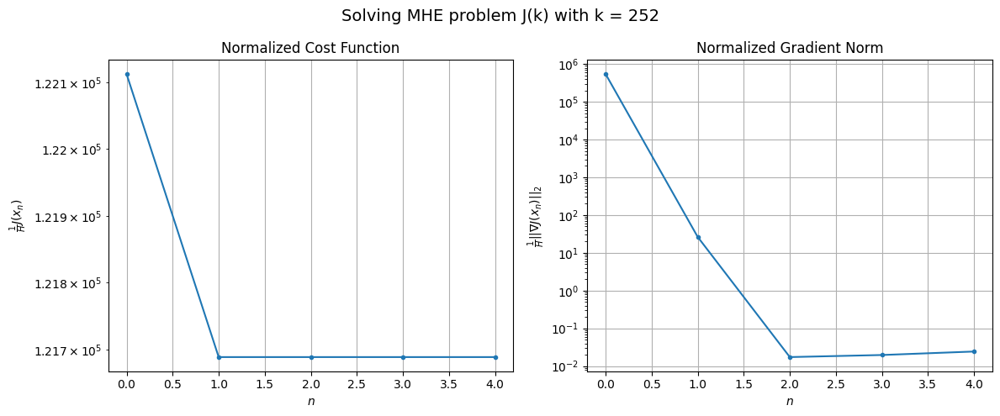

Windows:  52%|█████▏    | 154/296 [44:37<35:32, 15.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12386082.287152063
Gradient norm: 45451658.09605691
Global estimation error: 168.17431685540464
Initial conditions estimation errors: 83.68733173889656 m, 84.44468937288606 m, 83.7772694942952 m, 84.43604002960781 m
Position estimation errors: 109.26701850184675 m, 108.17916784388838 m, 109.05299836009488 m, 107.82463228504945 m

[Gauss-Newton] Iteration 1
Cost function: 12345102.293887764 (-0.33%)
Gradient norm: 2269.361030584318 (-100.00%)
Global estimation error: 176.98061439597797 (5.24%)
Initial conditions estimation errors: 88.0331432093878 m, 88.74481540826244 m, 88.2143248477036 m, 88.96538931209074 m
Position estimation errors: 105.36361995426671 m, 104.42540638315624 m, 105.07280120144488 m, 103.73506176935844 m

[Gauss-Newton] Iteration 2
Cost function: 12345102.29337996 (-0.00%)
Gradient norm: 6.907259725547939 (-99.70%)
Global estimation error: 176.98060548695912 (-0.00%)
Initial conditions estimation errors: 88.0

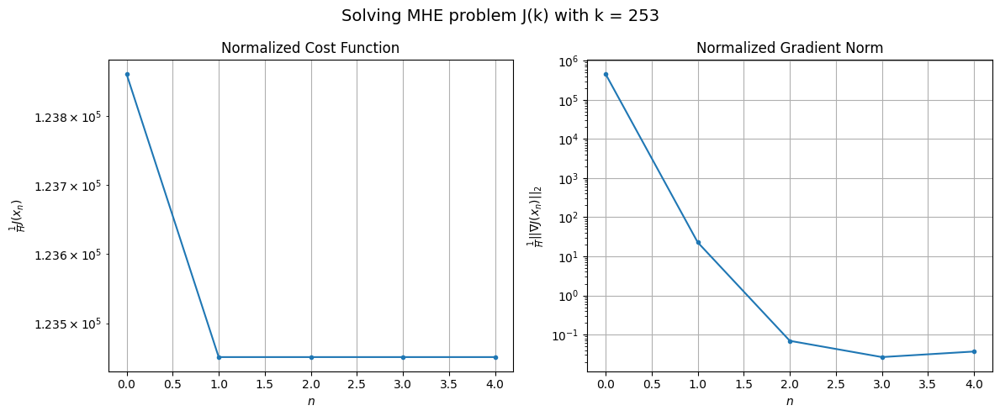

Windows:  52%|█████▏    | 155/296 [44:50<33:30, 14.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12580142.86139122
Gradient norm: 36644010.27840849
Global estimation error: 170.444947744154
Initial conditions estimation errors: 84.75110468158941 m, 85.48967668749427 m, 84.90542866581806 m, 85.7395389343284 m
Position estimation errors: 111.53299335177162 m, 110.57228184392058 m, 111.24437905267452 m, 109.91097105939147 m

[Gauss-Newton] Iteration 1
Cost function: 12540419.145633604 (-0.32%)
Gradient norm: 1938.2181318988255 (-99.99%)
Global estimation error: 178.8020866225825 (4.90%)
Initial conditions estimation errors: 88.93517765703284 m, 89.62988463852716 m, 89.12586397253678 m, 89.9096009052093 m
Position estimation errors: 107.79476513868208 m, 106.84178651193437 m, 107.3877991433505 m, 106.11054729697524 m

[Gauss-Newton] Iteration 2
Cost function: 12540419.14561946 (-0.00%)
Gradient norm: 3.3230968400269263 (-99.83%)
Global estimation error: 178.8020642026972 (-0.00%)
Initial conditions estimation errors: 88.93517

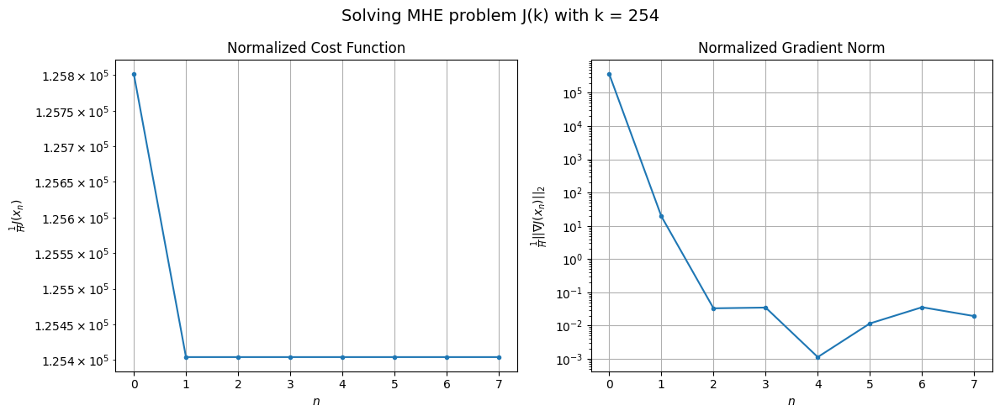

Windows:  53%|█████▎    | 156/296 [45:09<37:03, 15.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12790918.517355883
Gradient norm: 27139643.953660924
Global estimation error: 172.7068852548159
Initial conditions estimation errors: 85.86335193917219 m, 86.59504130609966 m, 86.04873477903814 m, 86.90239541176395 m
Position estimation errors: 113.73001530809748 m, 112.75922506800025 m, 113.33007590034546 m, 112.05210595112375 m

[Gauss-Newton] Iteration 1
Cost function: 12752075.96823794 (-0.30%)
Gradient norm: 1669.2381406287723 (-99.99%)
Global estimation error: 180.89243280974708 (4.74%)
Initial conditions estimation errors: 89.90954479275503 m, 90.66272006856364 m, 90.13593284761123 m, 91.07188170635932 m
Position estimation errors: 110.11044822453033 m, 109.19817187775266 m, 109.70280389957938 m, 108.32900724287441 m

[Gauss-Newton] Iteration 2
Cost function: 12752075.968300618 (0.00%)
Gradient norm: 1.3228710072922434 (-99.92%)
Global estimation error: 180.89245695230238 (0.00%)
Initial conditions estimation errors: 89

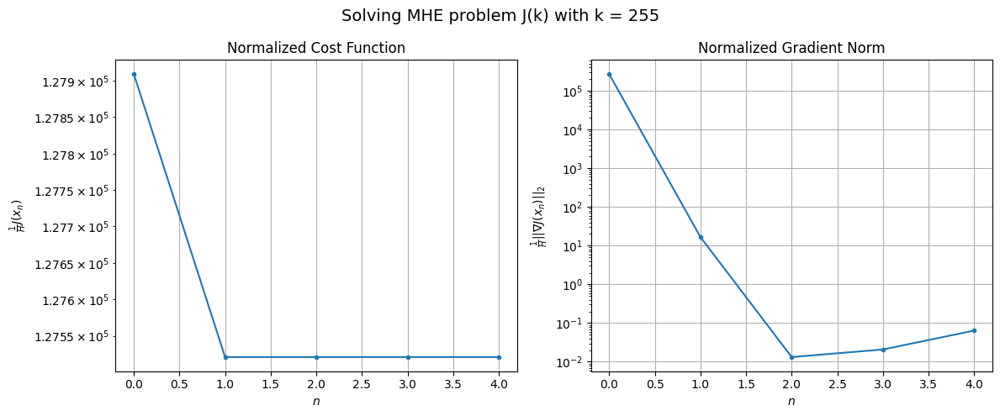

Windows:  53%|█████▎    | 157/296 [45:22<34:51, 15.05s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13020477.011887012
Gradient norm: 17551986.939113542
Global estimation error: 175.1779109610313
Initial conditions estimation errors: 87.03621482400392 m, 87.80981258459019 m, 87.25408366115504 m, 88.25034206303054 m
Position estimation errors: 115.91771521557234 m, 115.00374799613311 m, 115.52891373832607 m, 114.15370103188323 m

[Gauss-Newton] Iteration 1
Cost function: 12982020.842446754 (-0.30%)
Gradient norm: 1469.6230826385429 (-99.99%)
Global estimation error: 182.93500753471028 (4.43%)
Initial conditions estimation errors: 90.96794929688105 m, 91.74444090459563 m, 91.25567391676975 m, 91.89869584441799 m
Position estimation errors: 112.35657936474561 m, 111.46797780965477 m, 111.89232533862972 m, 110.97655520483227 m

[Gauss-Newton] Iteration 2
Cost function: 12982020.841891775 (-0.00%)
Gradient norm: 6.8924110571959885 (-99.53%)
Global estimation error: 182.9349755344004 (-0.00%)
Initial conditions estimation errors: 

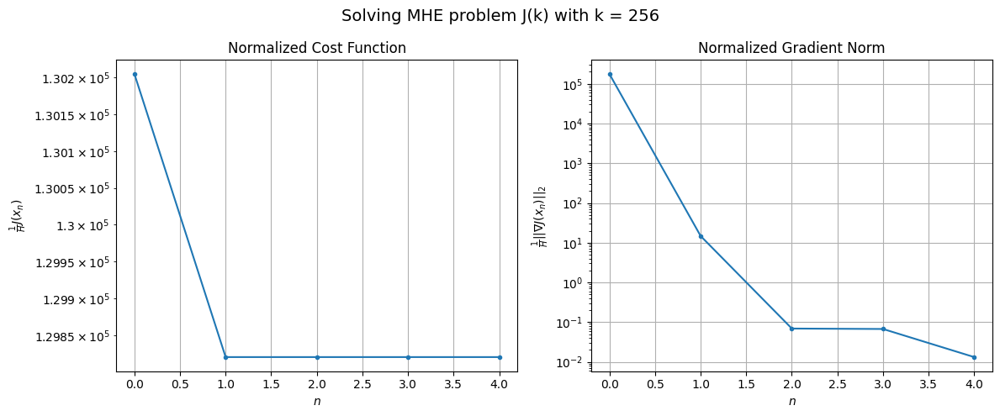

Windows:  53%|█████▎    | 158/296 [45:35<32:56, 14.32s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13263396.350758625
Gradient norm: 7774230.766965962
Global estimation error: 177.5969477039806
Initial conditions estimation errors: 88.29196144029655 m, 89.08323449449362 m, 88.57650312596509 m, 89.23874305211137 m
Position estimation errors: 118.14180775309127 m, 117.26048794570872 m, 117.7048888352742 m, 116.79245329902723 m

[Gauss-Newton] Iteration 1
Cost function: 13225117.387497624 (-0.29%)
Gradient norm: 1290.2757770439023 (-99.98%)
Global estimation error: 185.2141067539115 (4.29%)
Initial conditions estimation errors: 92.1208996312721 m, 92.85387309555821 m, 92.4944833444763 m, 92.95644285215218 m
Position estimation errors: 114.594709838567 m, 113.69479614596848 m, 114.0741759823611 m, 113.26453076606727 m

[Gauss-Newton] Iteration 2
Cost function: 13225117.387387605 (-0.00%)
Gradient norm: 5.9088976300933895 (-99.54%)
Global estimation error: 185.21409289459044 (-0.00%)
Initial conditions estimation errors: 92.1208

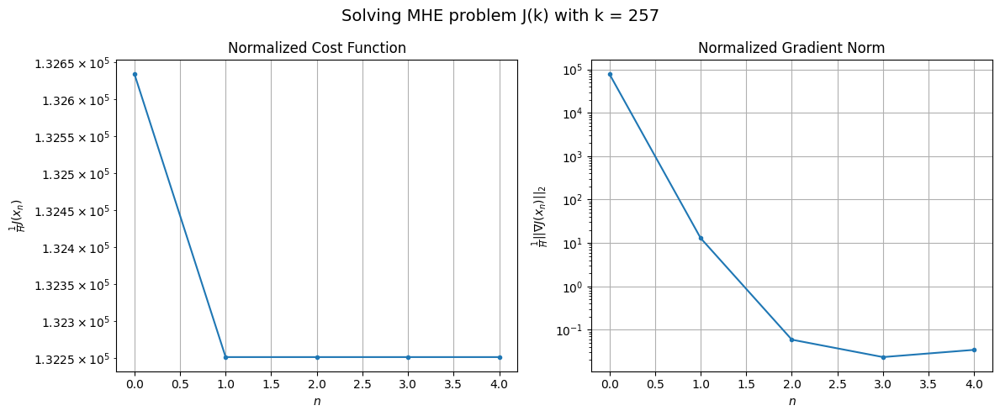

Windows:  54%|█████▎    | 159/296 [45:48<31:42, 13.89s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13526424.97954253
Gradient norm: 3039634.56406094
Global estimation error: 180.27833581742945
Initial conditions estimation errors: 89.63872150133312 m, 90.40257549795004 m, 90.00992826780967 m, 90.50269022190994 m
Position estimation errors: 120.42241962223906 m, 119.51872434285694 m, 119.9404790621679 m, 119.10885970189885 m

[Gauss-Newton] Iteration 1
Cost function: 13487742.51523148 (-0.29%)
Gradient norm: 1200.6941766684374 (-99.96%)
Global estimation error: 187.67420991149774 (4.10%)
Initial conditions estimation errors: 93.39859785001543 m, 93.90725366067036 m, 93.78880063298693 m, 94.25163519795787 m
Position estimation errors: 116.83129710201506 m, 116.22935215812902 m, 116.29164721675238 m, 115.35684393142743 m

[Gauss-Newton] Iteration 2
Cost function: 13487742.515189255 (-0.00%)
Gradient norm: 4.46498179735016 (-99.63%)
Global estimation error: 187.6741687872752 (-0.00%)
Initial conditions estimation errors: 93.398

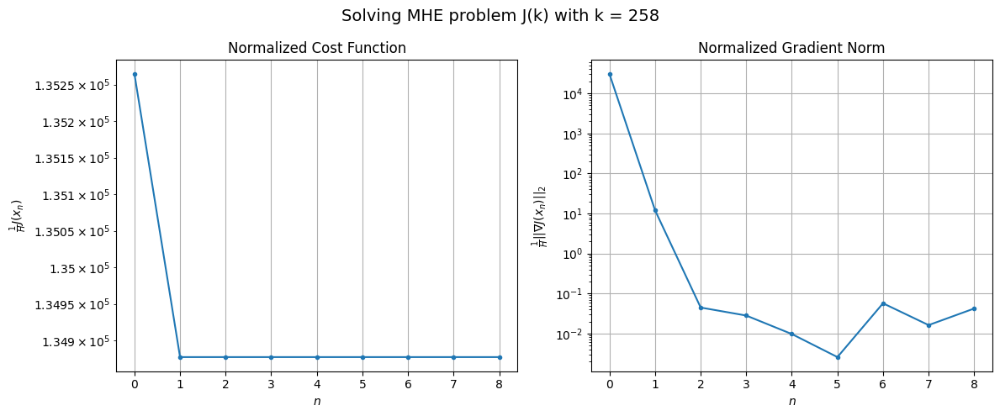

Windows:  54%|█████▍    | 160/296 [46:10<37:10, 16.40s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13802067.757185994
Gradient norm: 11643476.525079023
Global estimation error: 183.12521531983856
Initial conditions estimation errors: 91.10409890212212 m, 91.6285296210251 m, 91.49869680898928 m, 92.01665809555983 m
Position estimation errors: 122.71465102447506 m, 122.1157859297835 m, 122.21618489522295 m, 121.23438294441742 m

[Gauss-Newton] Iteration 1
Cost function: 13762316.302903812 (-0.29%)
Gradient norm: 1195.349511014035 (-99.99%)
Global estimation error: 190.5359970454899 (4.05%)
Initial conditions estimation errors: 94.83204480590712 m, 95.15140561470247 m, 95.50292104204667 m, 95.58361776494979 m
Position estimation errors: 119.01808002924035 m, 118.71036753097738 m, 118.22316647433955 m, 117.72589404641238 m

[Gauss-Newton] Iteration 2
Cost function: 13762316.303135524 (0.00%)
Gradient norm: 4.33473085112712 (-99.64%)
Global estimation error: 190.53600199353522 (0.00%)
Initial conditions estimation errors: 94.832

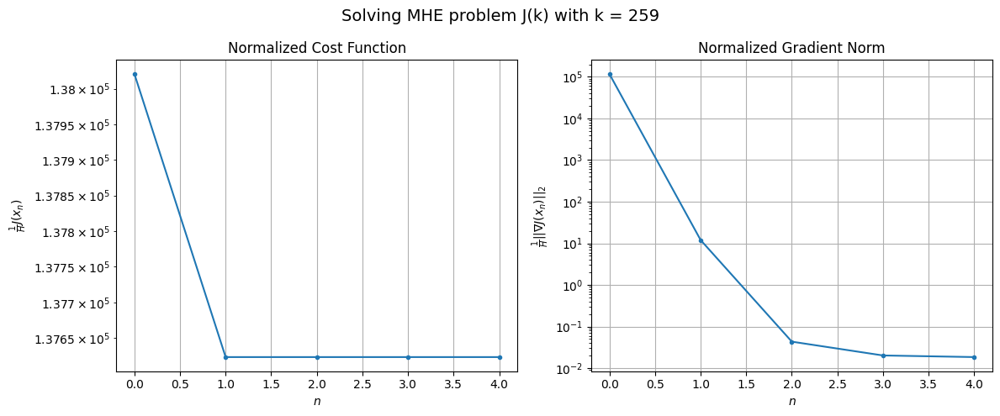

Windows:  54%|█████▍    | 161/296 [46:23<34:15, 15.23s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14091908.311281852
Gradient norm: 19809799.977451254
Global estimation error: 186.33518224243784
Initial conditions estimation errors: 92.7218249917171 m, 93.032218283287 m, 93.40073926572487 m, 93.51338685509964 m
Position estimation errors: 124.93422439063215 m, 124.64554174320027 m, 124.19173993826027 m, 123.64952885446306 m

[Gauss-Newton] Iteration 1
Cost function: 14050629.312352676 (-0.29%)
Gradient norm: 1263.747499461296 (-99.99%)
Global estimation error: 193.9197876439521 (4.07%)
Initial conditions estimation errors: 96.45481972867559 m, 96.87151586206586 m, 97.2859296855844 m, 97.2249516750829 m
Position estimation errors: 121.09397677284383 m, 120.75785774932064 m, 120.14659680209077 m, 119.84153420565117 m

[Gauss-Newton] Iteration 2
Cost function: 14050629.312758138 (0.00%)
Gradient norm: 1.7271045965086085 (-99.86%)
Global estimation error: 193.91979110375848 (0.00%)
Initial conditions estimation errors: 96.4548

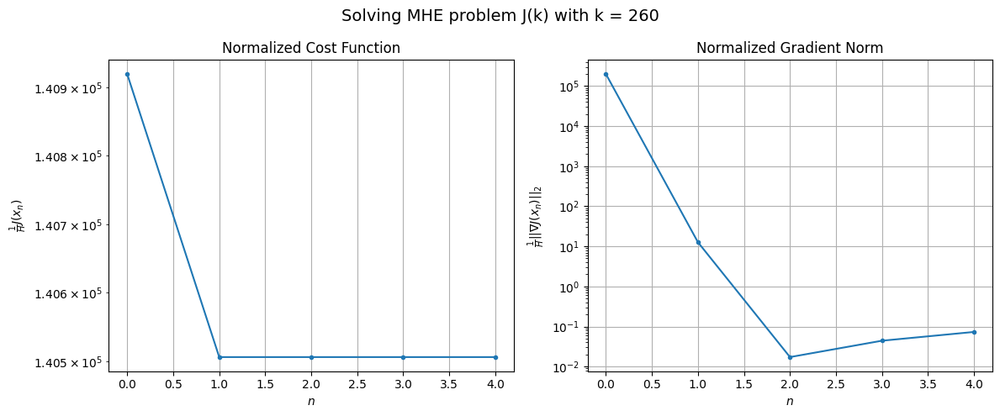

Windows:  55%|█████▍    | 162/296 [46:35<31:59, 14.32s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14391378.326813867
Gradient norm: 27381945.33976176
Global estimation error: 190.04467816347005
Initial conditions estimation errors: 94.51402651984533 m, 94.90586681446942 m, 95.3574982258646 m, 95.30944041070573 m
Position estimation errors: 126.99934977519275 m, 126.70163408804204 m, 126.1057566024492 m, 125.76803096547812 m

[Gauss-Newton] Iteration 1
Cost function: 14348226.640936783 (-0.30%)
Gradient norm: 1442.2948938388527 (-99.99%)
Global estimation error: 197.6580309870131 (4.01%)
Initial conditions estimation errors: 98.28385459341497 m, 98.75783742382434 m, 99.20456812993388 m, 99.06720802456326 m
Position estimation errors: 122.98657893842187 m, 122.67000325590915 m, 122.01752281302383 m, 121.8163898945571 m

[Gauss-Newton] Iteration 2
Cost function: 14348226.640684932 (-0.00%)
Gradient norm: 2.4339311065175573 (-99.83%)
Global estimation error: 197.65803327651426 (0.00%)
Initial conditions estimation errors: 98.2

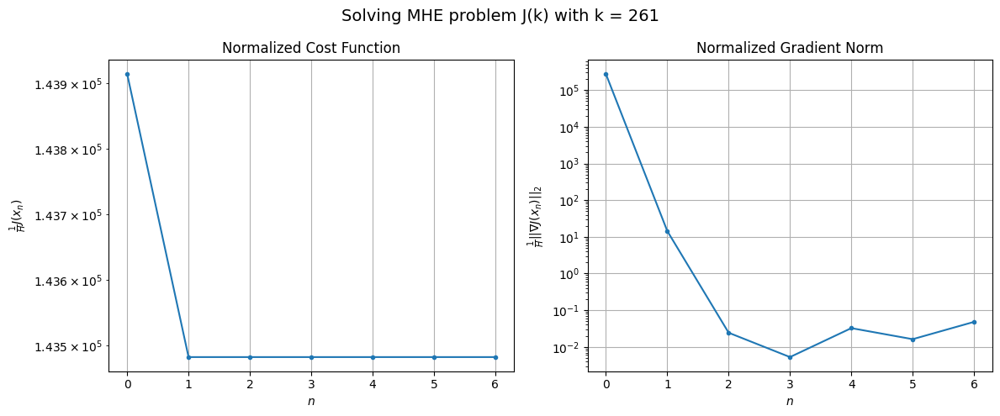

Windows:  55%|█████▌    | 163/296 [46:52<33:35, 15.16s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14697501.165710231
Gradient norm: 33941216.89030364
Global estimation error: 194.01853753144297
Initial conditions estimation errors: 96.4722868014662 m, 96.90544371835891 m, 97.3964968405128 m, 97.26016053907557 m
Position estimation errors: 128.81960880860555 m, 128.55957261568614 m, 127.91018415656283 m, 127.6887702393194 m

[Gauss-Newton] Iteration 1
Cost function: 14651953.503785951 (-0.31%)
Gradient norm: 1710.9183592586965 (-99.99%)
Global estimation error: 202.09060320333163 (4.16%)
Initial conditions estimation errors: 100.3242929346643 m, 101.09227111920967 m, 101.47138163334843 m, 101.28943985587706 m
Position estimation errors: 124.60979820302036 m, 124.1296315012325 m, 123.48009347777898 m, 123.53200518635006 m

[Gauss-Newton] Iteration 2
Cost function: 14651953.503835518 (0.00%)
Gradient norm: 1.3964122422621768 (-99.92%)
Global estimation error: 202.09079713685836 (0.00%)
Initial conditions estimation errors: 10

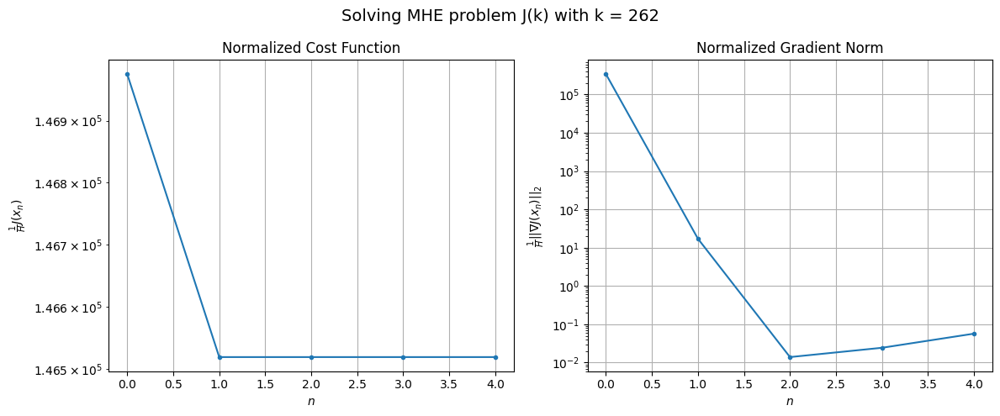

Windows:  55%|█████▌    | 164/296 [47:04<31:34, 14.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14999358.748546643
Gradient norm: 40009020.77570007
Global estimation error: 198.54491093324322
Initial conditions estimation errors: 98.58301276049608 m, 99.28524873241889 m, 99.72574508786045 m, 99.4921044505451 m
Position estimation errors: 130.30368211898335 m, 129.91299114562406 m, 129.24181363231725 m, 129.32271681180904 m

[Gauss-Newton] Iteration 1
Cost function: 14951211.567579756 (-0.32%)
Gradient norm: 2090.339897443091 (-99.99%)
Global estimation error: 206.4961019342238 (4.00%)
Initial conditions estimation errors: 102.54711010545404 m, 103.27283914366951 m, 103.9900529103258 m, 103.17709373576666 m
Position estimation errors: 125.89317456506565 m, 125.48712072123593 m, 124.55864777529823 m, 125.12977497074023 m

[Gauss-Newton] Iteration 2
Cost function: 14951211.567488527 (-0.00%)
Gradient norm: 0.5160613763698925 (-99.98%)
Global estimation error: 206.49610910785913 (0.00%)
Initial conditions estimation errors: 

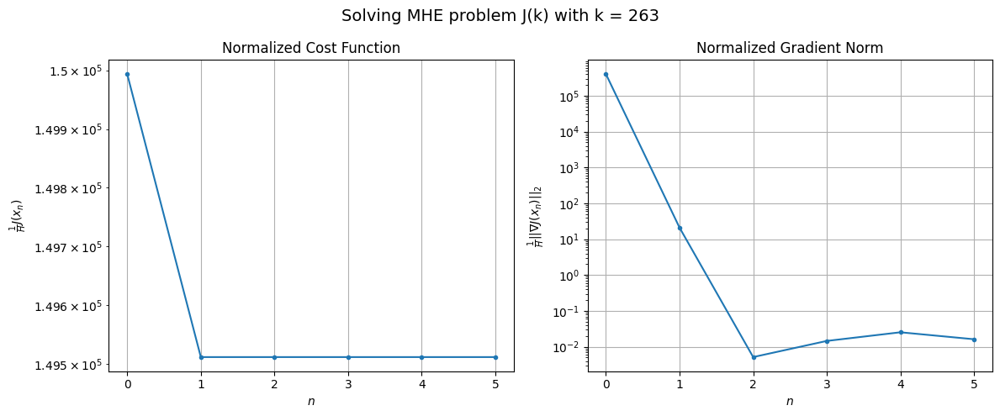

Windows:  56%|█████▌    | 165/296 [47:20<31:47, 14.56s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15290544.933068683
Gradient norm: 44988487.87599847
Global estimation error: 202.96623621201533
Initial conditions estimation errors: 100.81614587022264 m, 101.47349610920962 m, 102.24265164869395 m, 101.39506897346712 m
Position estimation errors: 131.39120296518092 m, 131.07704518218839 m, 130.13705598429905 m, 130.70871328915194 m

[Gauss-Newton] Iteration 1
Cost function: 15239577.175655924 (-0.33%)
Gradient norm: 2532.325792162715 (-99.99%)
Global estimation error: 211.55554492681858 (4.23%)
Initial conditions estimation errors: 104.92234615268043 m, 105.90365677535227 m, 106.43660411522634 m, 105.84284167222046 m
Position estimation errors: 126.77860421338106 m, 126.12208461134722 m, 125.46239402553255 m, 125.75640933271028 m

[Gauss-Newton] Iteration 2
Cost function: 15239577.175142258 (-0.00%)
Gradient norm: 2.2361366024029867 (-99.91%)
Global estimation error: 211.55552986139617 (-0.00%)
Initial conditions estimation 

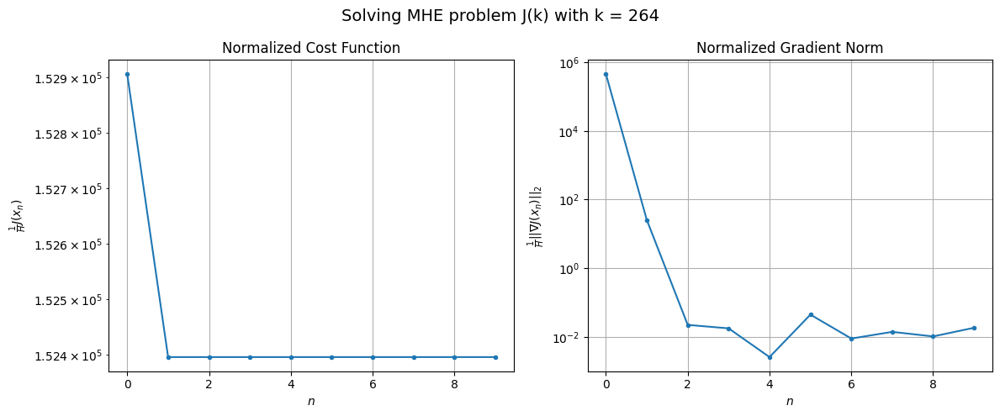

Windows:  56%|█████▌    | 166/296 [47:43<37:20, 17.23s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15562964.247458542
Gradient norm: 49209746.3354893
Global estimation error: 207.90956242389353
Initial conditions estimation errors: 103.13370607667845 m, 104.05516140495057 m, 104.61868791704038 m, 104.00610186830143 m
Position estimation errors: 132.03801421168342 m, 131.47231073088645 m, 130.81093157639586 m, 131.09983169939872 m

[Gauss-Newton] Iteration 1
Cost function: 15509166.273903696 (-0.35%)
Gradient norm: 3044.712268339691 (-99.99%)
Global estimation error: 216.75345769967348 (4.25%)
Initial conditions estimation errors: 107.39759843743585 m, 108.61796949956754 m, 108.82712311643728 m, 108.65818714666621 m
Position estimation errors: 127.23063232912315 m, 126.4610159257728 m, 125.98422623445299 m, 126.0181469645143 m

[Gauss-Newton] Iteration 2
Cost function: 15509166.27393658 (0.00%)
Gradient norm: 2.518168652699073 (-99.92%)
Global estimation error: 216.75330082391426 (-0.00%)
Initial conditions estimation errors

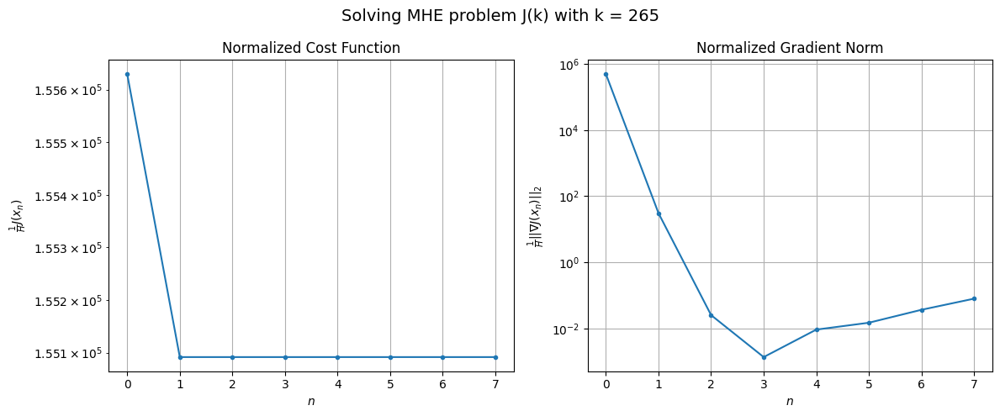

Windows:  56%|█████▋    | 167/296 [48:02<38:09, 17.75s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15808684.04251599
Gradient norm: 53635391.43177337
Global estimation error: 212.76304940944863
Initial conditions estimation errors: 105.44778846196603 m, 106.5868639001106 m, 106.84586941953529 m, 106.63989702893895 m
Position estimation errors: 132.22666893052406 m, 131.5696751225073 m, 131.05702945640982 m, 131.12285245359834 m

[Gauss-Newton] Iteration 1
Cost function: 15751920.18019966 (-0.36%)
Gradient norm: 3623.6158887371603 (-99.99%)
Global estimation error: 221.62340131496958 (4.16%)
Initial conditions estimation errors: 109.88089857775832 m, 110.84161022771217 m, 111.42766101300771 m, 111.09059766057923 m
Position estimation errors: 127.22156620662736 m, 126.78963940874213 m, 125.97131558468514 m, 126.13772072968783 m

[Gauss-Newton] Iteration 2
Cost function: 15751920.180439036 (0.00%)
Gradient norm: 3.219665290877348 (-99.91%)
Global estimation error: 221.6234872992114 (0.00%)
Initial conditions estimation errors:

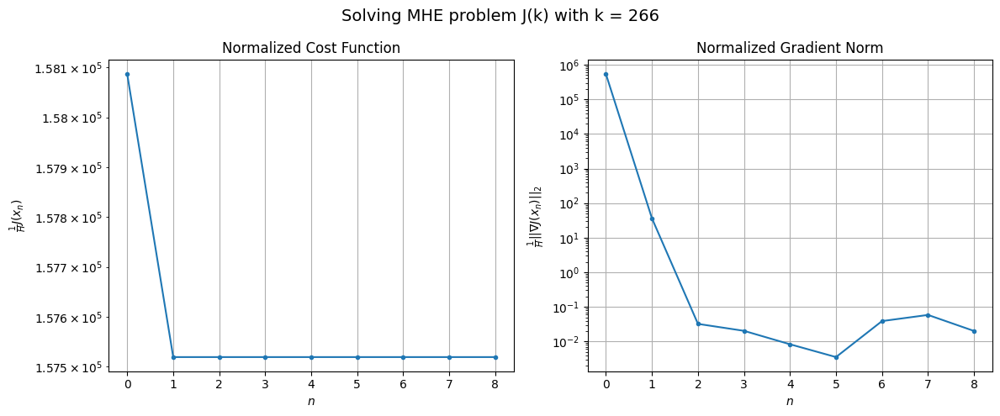

Windows:  57%|█████▋    | 168/296 [48:24<40:34, 19.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 16018480.534615966
Gradient norm: 57332914.432721905
Global estimation error: 217.02036874345504
Initial conditions estimation errors: 107.63330954862313 m, 108.49878226407586 m, 109.1322612171597 m, 108.7706719439668 m
Position estimation errors: 131.96432451586583 m, 131.65515908257768 m, 130.8121603188415 m, 130.99362866738693 m

[Gauss-Newton] Iteration 1
Cost function: 15958936.894643584 (-0.37%)
Gradient norm: 4191.345045737475 (-99.99%)
Global estimation error: 226.47588051163834 (4.36%)
Initial conditions estimation errors: 112.23835369404296 m, 113.34139365430022 m, 113.76069274128322 m, 113.60498391876799 m
Position estimation errors: 126.77559306175581 m, 126.21026755677056 m, 125.59412541671603 m, 125.75650284055594 m

[Gauss-Newton] Iteration 2
Cost function: 15958936.894683199 (0.00%)
Gradient norm: 6.222098657578116 (-99.85%)
Global estimation error: 226.47586608600602 (-0.00%)
Initial conditions estimation erro

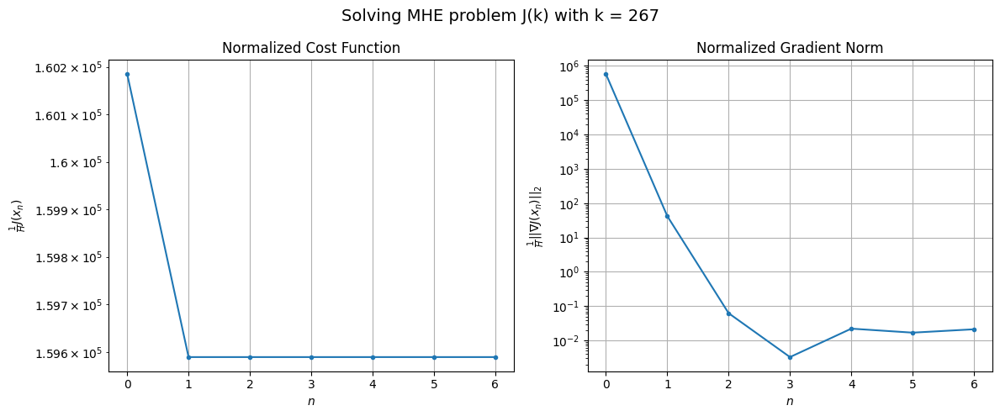

Windows:  57%|█████▋    | 169/296 [48:41<38:57, 18.41s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 16192212.86286737
Gradient norm: 61209991.422602035
Global estimation error: 221.00602402564846
Initial conditions estimation errors: 109.56582315649189 m, 110.57687171799184 m, 111.03201247899517 m, 110.83149674727473 m
Position estimation errors: 131.31289078735486 m, 130.8631938661082 m, 130.23379892392424 m, 130.43906036631944 m

[Gauss-Newton] Iteration 1
Cost function: 16130041.30901865 (-0.38%)
Gradient norm: 4749.451221222405 (-99.99%)
Global estimation error: 230.40908363359614 (4.25%)
Initial conditions estimation errors: 114.33689964295046 m, 115.33575916899737 m, 115.53416115199262 m, 115.60673749583972 m
Position estimation errors: 125.94261747750815 m, 125.3201775159818 m, 124.9794737925978 m, 124.86176765586622 m

[Gauss-Newton] Iteration 2
Cost function: 16130041.308755482 (-0.00%)
Gradient norm: 1.591587940981018 (-99.97%)
Global estimation error: 230.4092452765628 (0.00%)
Initial conditions estimation errors:

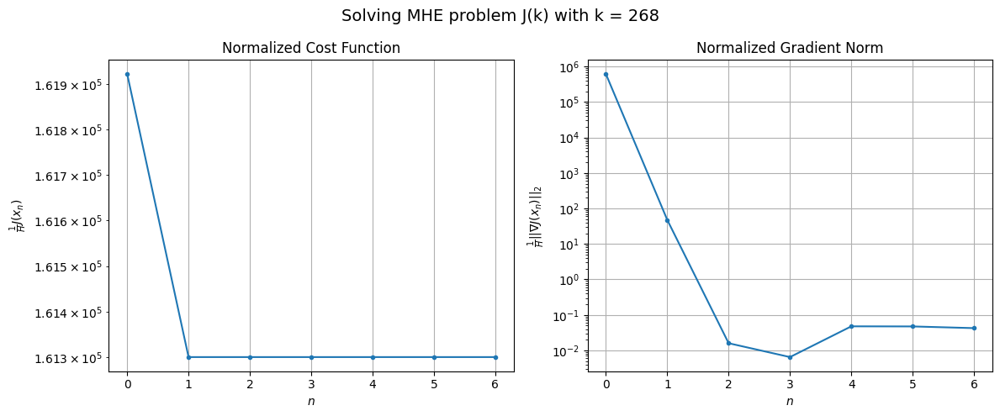

Windows:  57%|█████▋    | 170/296 [48:59<38:37, 18.40s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 16324661.78118211
Gradient norm: 64754329.86537924
Global estimation error: 223.96185856141972
Initial conditions estimation errors: 111.15824215030014 m, 112.0945188237915 m, 112.30596228550444 m, 112.36069051604026 m
Position estimation errors: 130.31674653113743 m, 129.76607282828775 m, 129.42744036498036 m, 129.33403702542682 m

[Gauss-Newton] Iteration 1
Cost function: 16260006.913580654 (-0.40%)
Gradient norm: 5347.702943360704 (-99.99%)
Global estimation error: 233.89024147869554 (4.43%)
Initial conditions estimation errors: 116.0987462756467 m, 117.11739847651535 m, 117.33038299361733 m, 117.22967234828555 m
Position estimation errors: 124.77093539379929 m, 124.16377417179338 m, 123.8178587962483 m, 123.90366080852635 m

[Gauss-Newton] Iteration 2
Cost function: 16260006.914554784 (0.00%)
Gradient norm: 8.57680603170584 (-99.84%)
Global estimation error: 233.89017071708264 (-0.00%)
Initial conditions estimation errors:

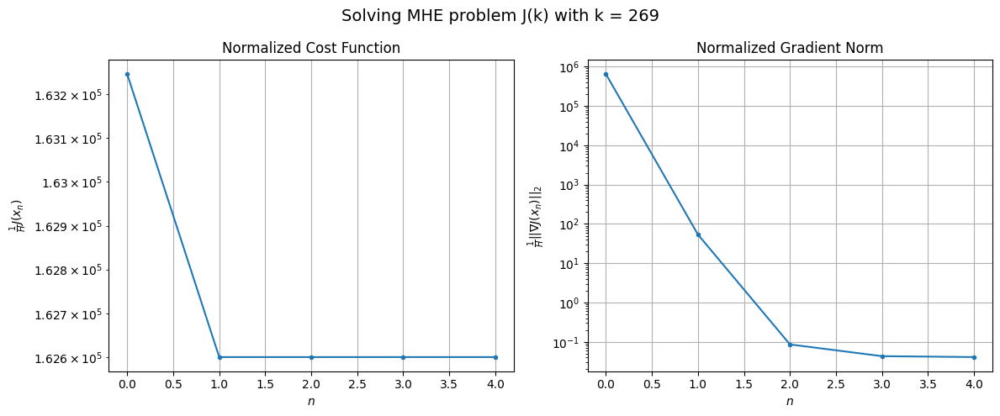

Windows:  58%|█████▊    | 171/296 [49:12<34:30, 16.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 16416765.026159652
Gradient norm: 67771223.90787841
Global estimation error: 226.34566921893042
Initial conditions estimation errors: 112.37898601961756 m, 113.32677886004785 m, 113.55224373071117 m, 113.42938729685063 m
Position estimation errors: 128.9790755840512 m, 128.44733300801482 m, 128.10629647119788 m, 128.21715135195885 m

[Gauss-Newton] Iteration 1
Cost function: 16349987.83642726 (-0.41%)
Gradient norm: 5891.775807461176 (-99.99%)
Global estimation error: 236.45225684135036 (4.47%)
Initial conditions estimation errors: 117.48627370397405 m, 118.41237454886219 m, 118.68231440187427 m, 118.32004131326644 m
Position estimation errors: 123.27328702481609 m, 122.65643249441976 m, 122.41470087893059 m, 122.57603003037215 m

[Gauss-Newton] Iteration 2
Cost function: 16349987.836299287 (-0.00%)
Gradient norm: 1.799299887517106 (-99.97%)
Global estimation error: 236.452422446868 (0.00%)
Initial conditions estimation errors

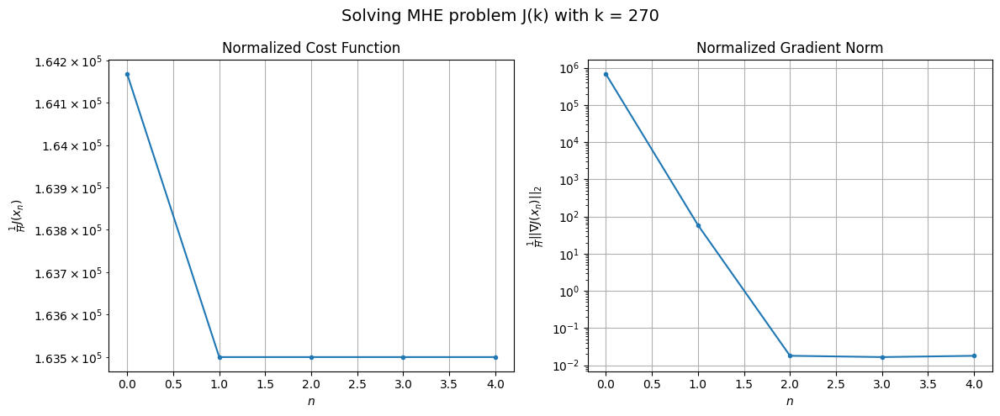

Windows:  58%|█████▊    | 172/296 [49:23<31:18, 15.15s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 16469706.354768746
Gradient norm: 70579890.22560713
Global estimation error: 227.8265683294864
Initial conditions estimation errors: 113.21729600584848 m, 114.09193096154623 m, 114.34858855846495 m, 113.99204942426265 m
Position estimation errors: 127.28435090568847 m, 126.71824233544217 m, 126.51479368185373 m, 126.65853731165564 m

[Gauss-Newton] Iteration 1
Cost function: 16401113.1105052 (-0.42%)
Gradient norm: 6409.442346090387 (-99.99%)
Global estimation error: 238.49162488181133 (4.68%)
Initial conditions estimation errors: 118.4882711715661 m, 119.39621489186285 m, 119.69702344981214 m, 119.39813794233082 m
Position estimation errors: 121.42833439573081 m, 120.85881172201437 m, 120.61569047494055 m, 120.71118779177226 m

[Gauss-Newton] Iteration 2
Cost function: 16401113.110574108 (0.00%)
Gradient norm: 5.768725488591419 (-99.91%)
Global estimation error: 238.491647912373 (0.00%)
Initial conditions estimation errors: 1

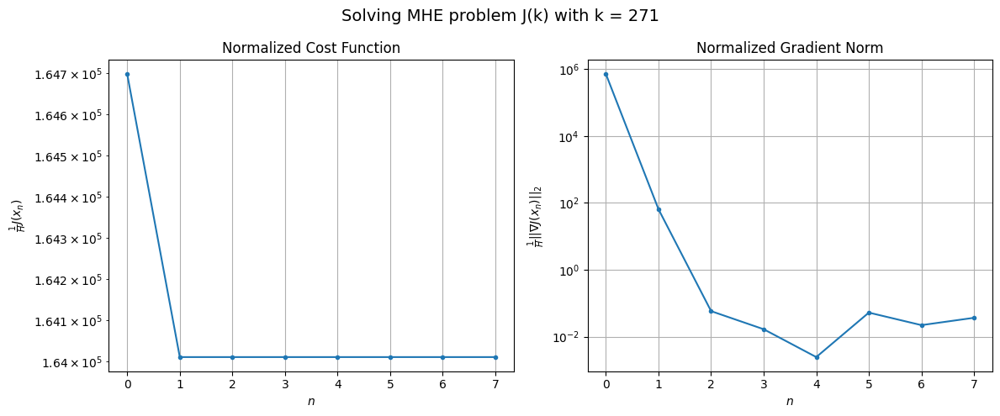

Windows:  58%|█████▊    | 173/296 [49:42<33:08, 16.16s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 16483142.874242319
Gradient norm: 73673644.9501474
Global estimation error: 228.75561968013386
Initial conditions estimation errors: 113.6676257657267 m, 114.52082204972247 m, 114.80348942045103 m, 114.51596310259218 m
Position estimation errors: 125.22618329412023 m, 124.70691256675737 m, 124.51417535999742 m, 124.58383642250782 m

[Gauss-Newton] Iteration 1
Cost function: 16412717.636616856 (-0.43%)
Gradient norm: 6926.172384909775 (-99.99%)
Global estimation error: 239.78375292571442 (4.82%)
Initial conditions estimation errors: 119.1087948969549 m, 120.17380307985644 m, 120.1676515834265 m, 120.11367245545287 m
Position estimation errors: 119.21229705282545 m, 118.61334260395715 m, 118.48660343400502 m, 118.42284695344321 m

[Gauss-Newton] Iteration 2
Cost function: 16412717.63714566 (0.00%)
Gradient norm: 0.09781906746114974 (-100.00%)
Global estimation error: 239.78356727823322 (-0.00%)
Initial conditions estimation erro

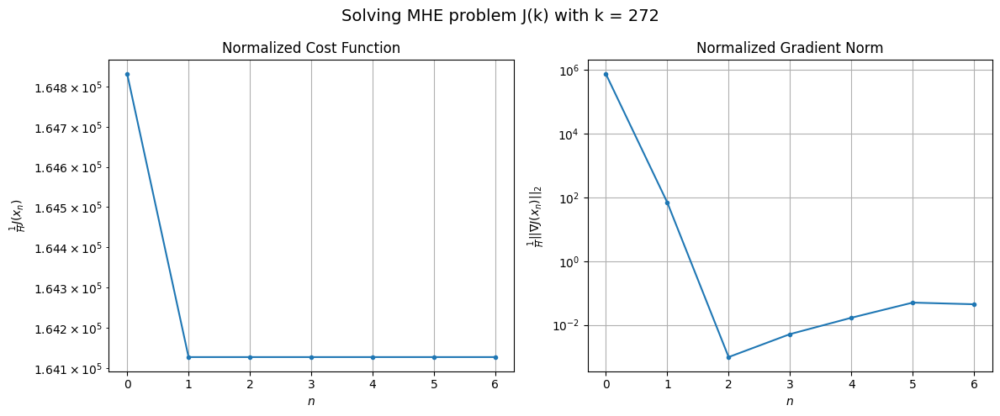

Windows:  59%|█████▉    | 174/296 [49:58<32:59, 16.23s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 16457743.642878717
Gradient norm: 75968856.72423877
Global estimation error: 228.90966607620868
Initial conditions estimation errors: 113.72278968650755 m, 114.71692838118511 m, 114.7089319429161 m, 114.66736514259284 m
Position estimation errors: 122.8041697114609 m, 122.27394507107465 m, 122.16219581925732 m, 122.08219551817164 m

[Gauss-Newton] Iteration 1
Cost function: 16386018.622691488 (-0.44%)
Gradient norm: 7398.855877583735 (-99.99%)
Global estimation error: 240.15240387865938 (4.91%)
Initial conditions estimation errors: 119.32768035950201 m, 120.4003203921956 m, 120.36850991655096 m, 120.20490279296628 m
Position estimation errors: 116.65498845662393 m, 115.92544841573051 m, 115.98287670550111 m, 115.95969070232813 m

[Gauss-Newton] Iteration 2
Cost function: 16386018.622174617 (-0.00%)
Gradient norm: 0.4937175875663161 (-99.99%)
Global estimation error: 240.15262465584323 (0.00%)
Initial conditions estimation erro

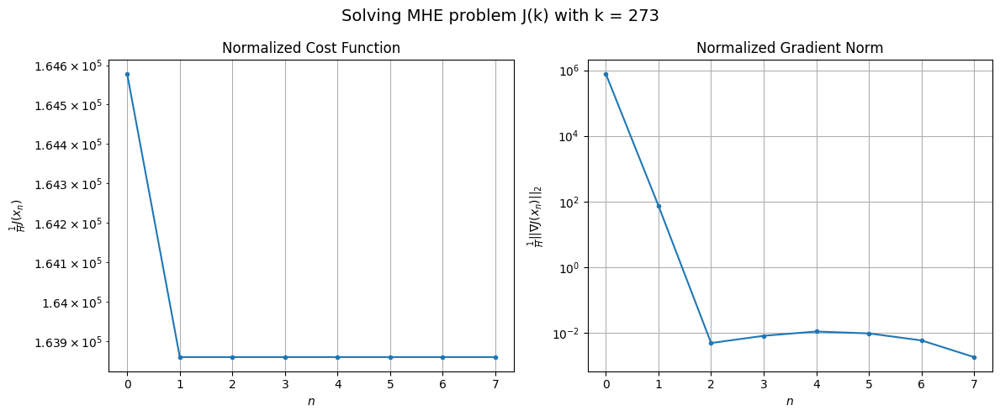

Windows:  59%|█████▉    | 175/296 [50:16<33:53, 16.81s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 16396225.320195375
Gradient norm: 77761221.14097261
Global estimation error: 228.1076217804703
Initial conditions estimation errors: 113.35262498134327 m, 114.37260046222862 m, 114.31234318391597 m, 114.17448947783414 m
Position estimation errors: 120.04898000779647 m, 119.35774024635052 m, 119.46585316928693 m, 119.40433361762742 m

[Gauss-Newton] Iteration 1
Cost function: 16323840.862259386 (-0.44%)
Gradient norm: 7804.6833568120865 (-99.99%)
Global estimation error: 240.17855030510077 (5.29%)
Initial conditions estimation errors: 119.10670960442518 m, 120.67415467039436 m, 120.01519762000581 m, 120.55444140309805 m
Position estimation errors: 113.79069293050242 m, 112.78464803278969 m, 113.20685897029423 m, 112.8545422841969 m

[Gauss-Newton] Iteration 2
Cost function: 16323840.861614918 (-0.00%)
Gradient norm: 2.7343433522988634 (-99.96%)
Global estimation error: 240.17816791362904 (-0.00%)
Initial conditions estimation e

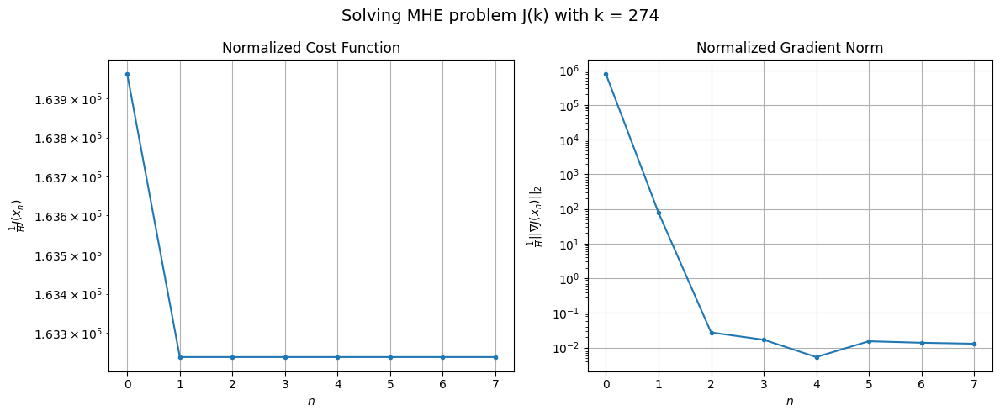

Windows:  59%|█████▉    | 176/296 [50:35<34:42, 17.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 16300847.845750604
Gradient norm: 79493095.51971963
Global estimation error: 226.91588920581063
Initial conditions estimation errors: 112.53455239749289 m, 114.03088471701133 m, 113.36202644463454 m, 113.89795597466481 m
Position estimation errors: 116.98146465789608 m, 116.0590151979235 m, 116.47532494939479 m, 116.15411863981392 m

[Gauss-Newton] Iteration 1
Cost function: 16227632.365982287 (-0.45%)
Gradient norm: 8236.840330885652 (-99.99%)
Global estimation error: 238.88087768097247 (5.27%)
Initial conditions estimation errors: 118.45092207574326 m, 120.07908655703294 m, 119.24352003866822 m, 119.98077415945497 m
Position estimation errors: 110.60323679882511 m, 109.6270671357522 m, 110.10133995974867 m, 109.7073002169731 m

[Gauss-Newton] Iteration 2
Cost function: 16227632.36595459 (-0.00%)
Gradient norm: 2.983363336271657 (-99.96%)
Global estimation error: 238.88076777979322 (-0.00%)
Initial conditions estimation error

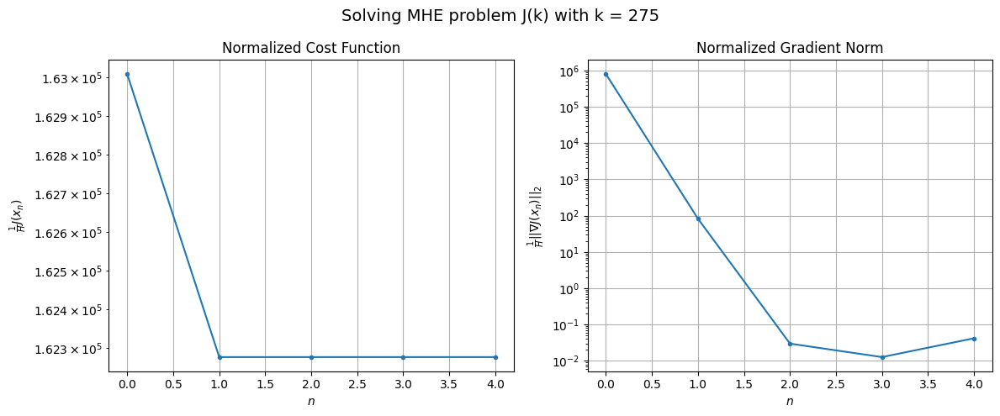

Windows:  60%|█████▉    | 177/296 [50:47<31:11, 15.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 16174484.097598376
Gradient norm: 80747000.69489227
Global estimation error: 224.46786720625926
Initial conditions estimation errors: 111.3109244802502 m, 112.8537522498452 m, 112.02227252620975 m, 112.74163674867418 m
Position estimation errors: 113.56813883357592 m, 112.69369751279615 m, 113.13472324180155 m, 112.79819832470837 m

[Gauss-Newton] Iteration 1
Cost function: 16101381.151517171 (-0.45%)
Gradient norm: 8547.25005222524 (-99.99%)
Global estimation error: 236.5471698830208 (5.38%)
Initial conditions estimation errors: 117.35937718462175 m, 118.87338829802665 m, 118.06203367796356 m, 118.79286446887822 m
Position estimation errors: 107.11100652326374 m, 106.3521098699647 m, 106.70064370222839 m, 106.34065896677214 m

[Gauss-Newton] Iteration 2
Cost function: 16101381.15103238 (-0.00%)
Gradient norm: 3.9394936769058604 (-99.95%)
Global estimation error: 236.54709843628308 (-0.00%)
Initial conditions estimation errors

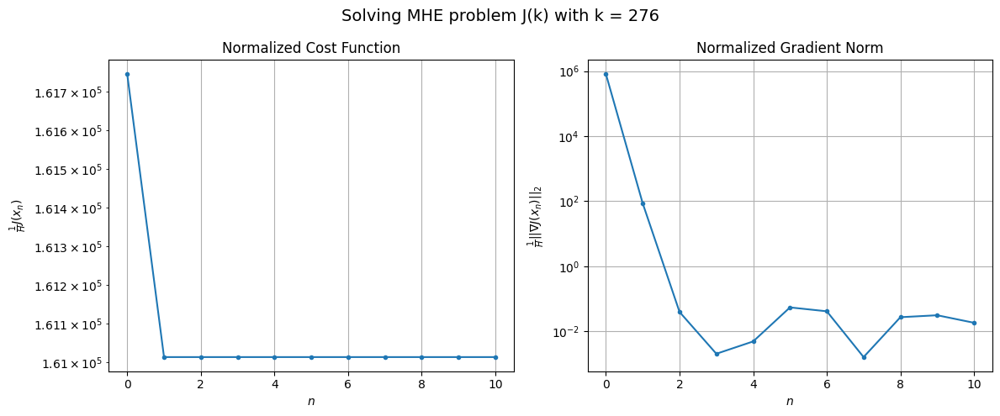

Windows:  60%|██████    | 178/296 [51:12<36:29, 18.56s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 16017923.676774705
Gradient norm: 81313972.2709052
Global estimation error: 221.09668899255212
Initial conditions estimation errors: 109.7076966852815 m, 111.11786037779824 m, 110.32688238466378 m, 111.03465768655265 m
Position estimation errors: 109.80174401812292 m, 109.15970671914857 m, 109.4535932420562 m, 109.1569404012912 m

[Gauss-Newton] Iteration 1
Cost function: 15945203.807620425 (-0.45%)
Gradient norm: 8806.954002983173 (-99.99%)
Global estimation error: 233.594479609444 (5.65%)
Initial conditions estimation errors: 115.88889694755333 m, 117.6044482738502 m, 116.51226090111459 m, 117.17574818962466 m
Position estimation errors: 103.2825594934267 m, 102.43494491684322 m, 102.98859591671466 m, 102.54753823543236 m

[Gauss-Newton] Iteration 2
Cost function: 15945203.807570254 (-0.00%)
Gradient norm: 3.674368998290451 (-99.96%)
Global estimation error: 233.59444847285286 (-0.00%)
Initial conditions estimation errors: 1

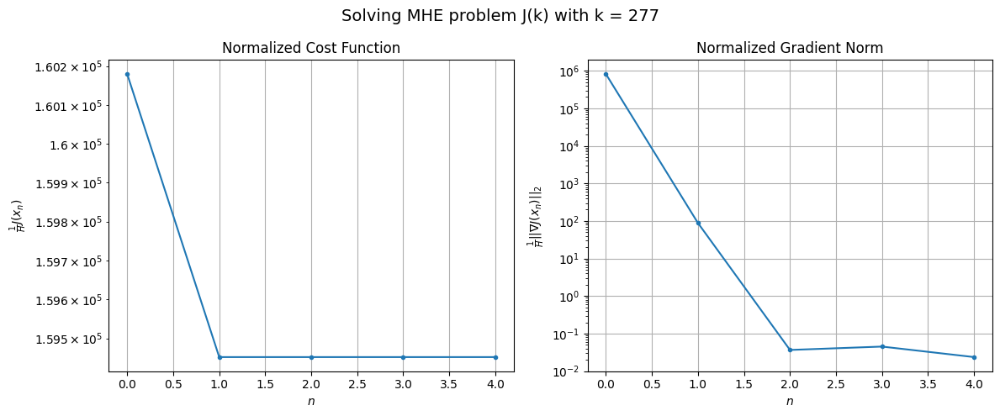

Windows:  60%|██████    | 179/296 [51:24<32:18, 16.57s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15831788.818175387
Gradient norm: 81252955.83380337
Global estimation error: 217.2427678357265
Initial conditions estimation errors: 107.78343423792718 m, 109.39515660279723 m, 108.32002053610182 m, 108.97956858876834 m
Position estimation errors: 105.62887579524643 m, 104.91875124765778 m, 105.39675855366512 m, 104.99663458345366 m

[Gauss-Newton] Iteration 1
Cost function: 15760003.67727276 (-0.45%)
Gradient norm: 9001.939664405962 (-99.99%)
Global estimation error: 229.70359147225142 (5.74%)
Initial conditions estimation errors: 114.08489183642843 m, 115.48227333725836 m, 114.6097679118666 m, 115.22474457770707 m
Position estimation errors: 99.07797097387444 m, 98.51342513841597 m, 98.85027515778748 m, 98.45010787483818 m

[Gauss-Newton] Iteration 2
Cost function: 15760003.677914094 (0.00%)
Gradient norm: 2.276554433883665 (-99.97%)
Global estimation error: 229.70362504971726 (0.00%)
Initial conditions estimation errors: 11

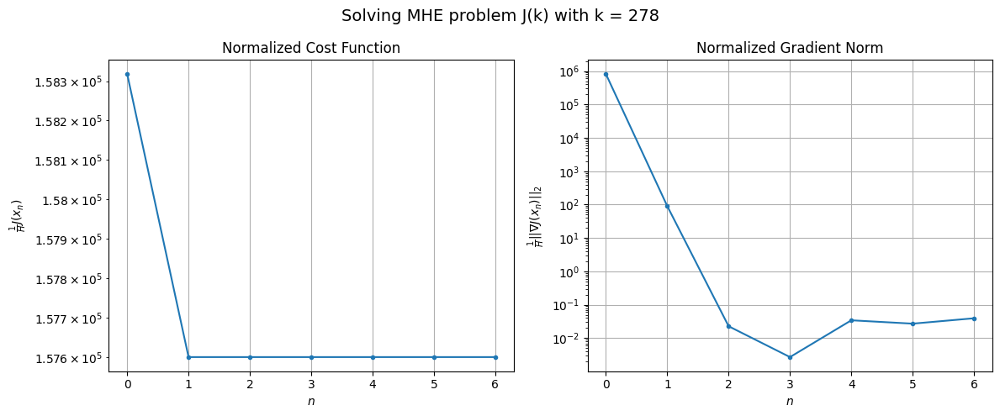

Windows:  61%|██████    | 180/296 [51:40<31:54, 16.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15619925.858607648
Gradient norm: 80723676.3985947
Global estimation error: 212.5570412907849
Initial conditions estimation errors: 105.5851579100502 m, 106.86726575363303 m, 106.02354613702802 m, 106.63292932669334 m
Position estimation errors: 101.02124207350484 m, 100.58991554790846 m, 100.85601354103794 m, 100.48922543598209 m

[Gauss-Newton] Iteration 1
Cost function: 15549740.863837577 (-0.45%)
Gradient norm: 9061.740347955294 (-99.99%)
Global estimation error: 225.54604551679728 (6.11%)
Initial conditions estimation errors: 111.98440162371506 m, 113.42817590206391 m, 112.41856147026098 m, 113.25432135610784 m
Position estimation errors: 94.47237149913862 m, 93.88497898489767 m, 94.28613137874088 m, 93.78615096738122 m

[Gauss-Newton] Iteration 2
Cost function: 15549740.864769321 (0.00%)
Gradient norm: 2.41083073794929 (-99.97%)
Global estimation error: 225.54610685288992 (0.00%)
Initial conditions estimation errors: 111

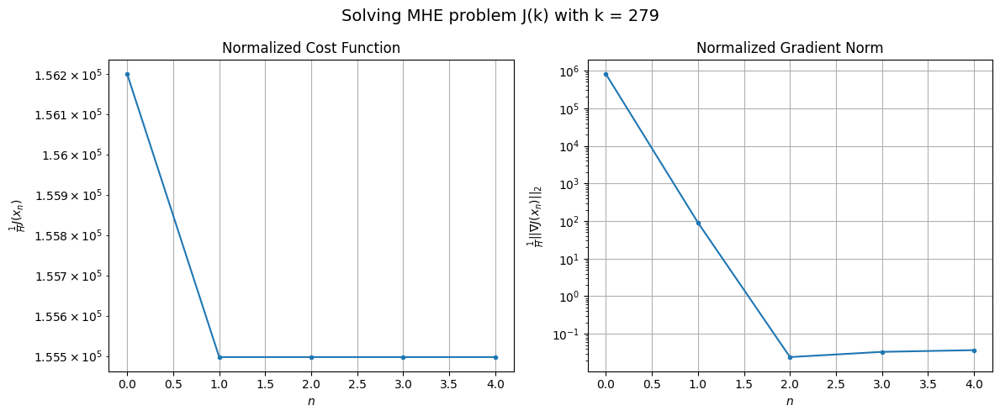

Windows:  61%|██████    | 181/296 [51:53<29:04, 15.17s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15381240.087834734
Gradient norm: 79049371.43021671
Global estimation error: 207.76476500918835
Initial conditions estimation errors: 103.17015252898703 m, 104.49243717881738 m, 103.52135505343362 m, 104.3392919586918 m
Position estimation errors: 95.99364619986414 m, 95.5500093184484 m, 95.86526525942541 m, 95.4163004504846 m

[Gauss-Newton] Iteration 1
Cost function: 15313179.745377928 (-0.44%)
Gradient norm: 9077.200217328593 (-99.99%)
Global estimation error: 220.25905462048468 (6.01%)
Initial conditions estimation errors: 109.65290161709163 m, 110.59730328889454 m, 110.01545196791842 m, 110.24988409327145 m
Position estimation errors: 89.48279220384977 m, 89.13469475111425 m, 89.29901041967715 m, 89.18931452513995 m

[Gauss-Newton] Iteration 2
Cost function: 15313179.745643537 (0.00%)
Gradient norm: 2.0177600910365427 (-99.98%)
Global estimation error: 220.25897050447483 (-0.00%)
Initial conditions estimation errors: 109.

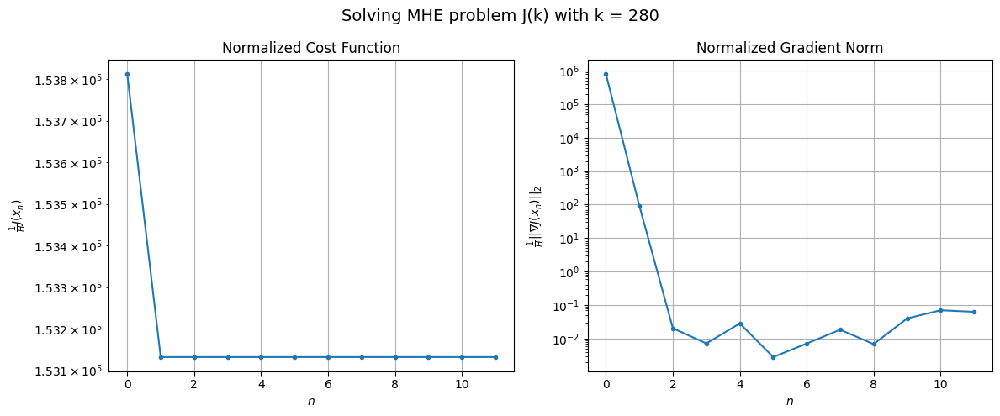

Windows:  61%|██████▏   | 182/296 [52:20<35:48, 18.85s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15123599.633954167
Gradient norm: 77506864.56468832
Global estimation error: 202.05580712803442
Initial conditions estimation errors: 100.62140702630438 m, 101.45583179414493 m, 100.9029636332523 m, 101.12909997771642 m
Position estimation errors: 90.58871719226403 m, 90.33348704112572 m, 90.45621564660698 m, 90.33939228909526 m

[Gauss-Newton] Iteration 1
Cost function: 15057816.884390287 (-0.43%)
Gradient norm: 9072.611997487065 (-99.99%)
Global estimation error: 215.16843897841633 (6.49%)
Initial conditions estimation errors: 107.17654037625974 m, 107.99486082152687 m, 107.45987928069628 m, 107.70345520897877 m
Position estimation errors: 84.12612471939016 m, 83.87813717060384 m, 83.8831312365181 m, 83.86789594856833 m

[Gauss-Newton] Iteration 2
Cost function: 15057816.883808715 (-0.00%)
Gradient norm: 2.8131664146291318 (-99.97%)
Global estimation error: 215.16851503726818 (0.00%)
Initial conditions estimation errors: 107

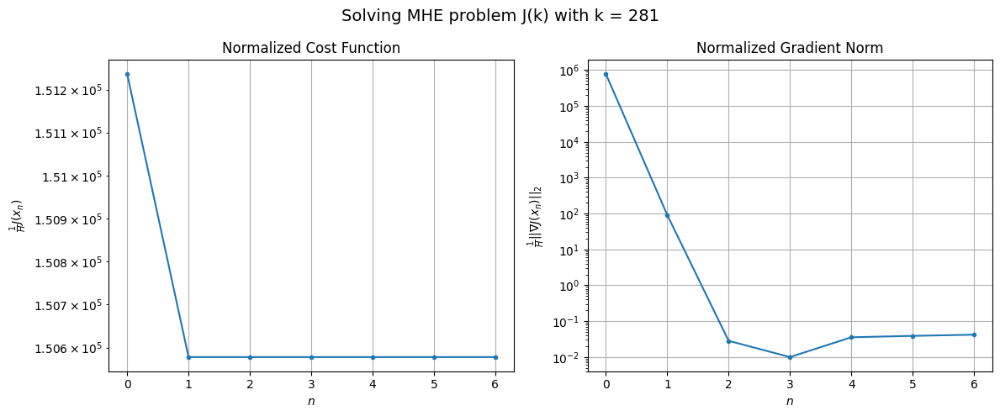

Windows:  62%|██████▏   | 183/296 [52:36<33:58, 18.04s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14844196.769579334
Gradient norm: 75274475.42838843
Global estimation error: 196.7208876357038
Initial conditions estimation errors: 98.02220918634697 m, 98.72356743449431 m, 98.23624122926628 m, 98.45789194719802 m
Position estimation errors: 84.8268855578077 m, 84.66821878098573 m, 84.61725412175277 m, 84.60342472426355 m

[Gauss-Newton] Iteration 1
Cost function: 14781135.751588587 (-0.42%)
Gradient norm: 8962.99161226554 (-99.99%)
Global estimation error: 210.22151183334665 (6.86%)
Initial conditions estimation errors: 104.6249590777222 m, 105.66783557646899 m, 104.83963197088823 m, 105.30699179490156 m
Position estimation errors: 78.44804566314147 m, 77.97774692886887 m, 78.22542783374017 m, 78.11887404077757 m

[Gauss-Newton] Iteration 2
Cost function: 14781135.750419 (-0.00%)
Gradient norm: 1.5192665492803277 (-99.98%)
Global estimation error: 210.22173223548046 (0.00%)
Initial conditions estimation errors: 104.62497191

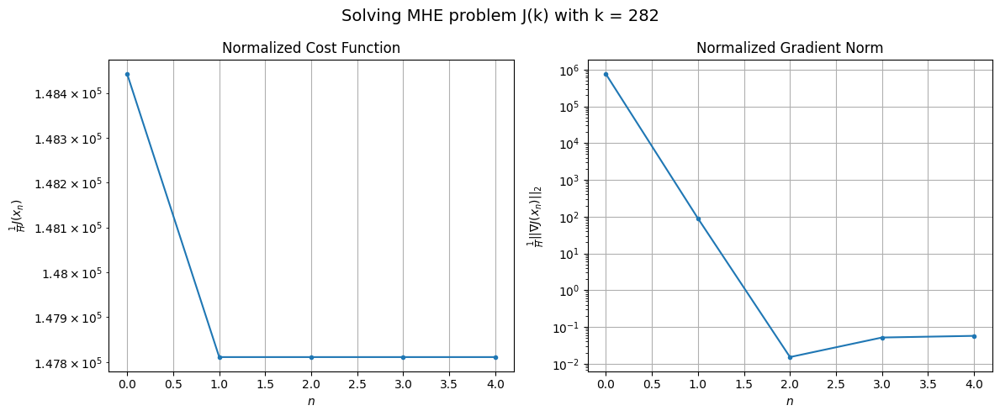

Windows:  62%|██████▏   | 184/296 [52:48<30:24, 16.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14545122.532821089
Gradient norm: 72169245.90283728
Global estimation error: 191.6847255253542
Initial conditions estimation errors: 95.42699425639655 m, 96.35160414480858 m, 95.579288490727 m, 96.00829656319462 m
Position estimation errors: 78.75422770145315 m, 78.39734869553267 m, 78.55713850281647 m, 78.48232358786109 m

[Gauss-Newton] Iteration 1
Cost function: 14485328.807343272 (-0.41%)
Gradient norm: 8790.21855430193 (-99.99%)
Global estimation error: 204.82292585014557 (6.85%)
Initial conditions estimation errors: 102.04049833536662 m, 102.83637409059473 m, 102.14703552383185 m, 102.61934092277934 m
Position estimation errors: 72.50396120838977 m, 72.28231457971982 m, 72.41373593723819 m, 72.31535990462122 m

[Gauss-Newton] Iteration 2
Cost function: 14485328.80655384 (-0.00%)
Gradient norm: 3.8508028256660762 (-99.96%)
Global estimation error: 204.82294744429427 (0.00%)
Initial conditions estimation errors: 102.040512

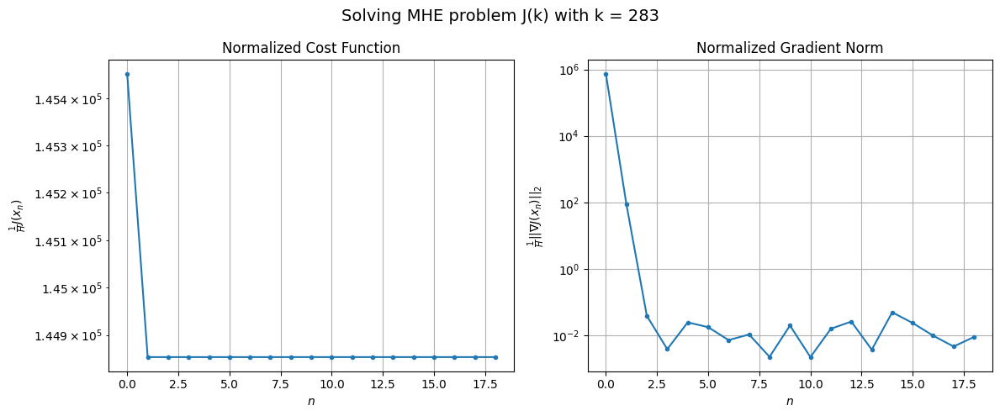

Windows:  62%|██████▎   | 185/296 [53:31<44:33, 24.08s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14226559.953795595
Gradient norm: 69150694.48484932
Global estimation error: 186.31079619815816
Initial conditions estimation errors: 92.85590921854588 m, 93.53122522172315 m, 92.90150833166511 m, 93.33066579458416 m
Position estimation errors: 72.40124833091285 m, 72.30012382216917 m, 72.3433056219335 m, 72.28010758587 m

[Gauss-Newton] Iteration 1
Cost function: 14170068.492348095 (-0.40%)
Gradient norm: 8563.430782275322 (-99.99%)
Global estimation error: 199.4767929380955 (7.07%)
Initial conditions estimation errors: 99.45902057019637 m, 100.01669138512912 m, 99.49454957660001 m, 99.98143048661177 m
Position estimation errors: 66.29275291116747 m, 66.28234721963855 m, 66.34123617208606 m, 66.1873205972801 m

[Gauss-Newton] Iteration 2
Cost function: 14170068.492936727 (0.00%)
Gradient norm: 2.728576079230418 (-99.97%)
Global estimation error: 199.47673532313368 (-0.00%)
Initial conditions estimation errors: 99.459035680950

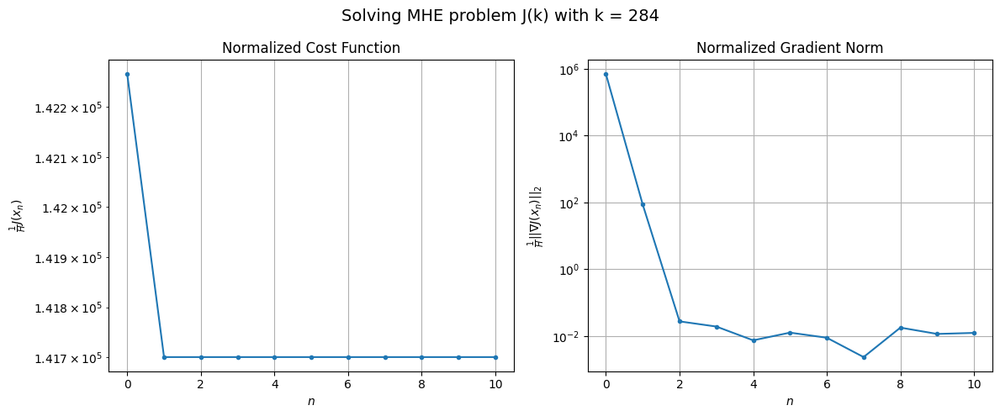

Windows:  63%|██████▎   | 186/296 [53:55<44:25, 24.23s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13890384.196137628
Gradient norm: 64694088.86253527
Global estimation error: 181.04090954345943
Initial conditions estimation errors: 90.3107756194611 m, 90.75516579959056 m, 90.28355698974617 m, 90.73066040441616 m
Position estimation errors: 65.70011623518158 m, 65.79882820821811 m, 65.78068043624816 m, 65.67136102399452 m

[Gauss-Newton] Iteration 1
Cost function: 13837828.490555689 (-0.38%)
Gradient norm: 8251.96468621366 (-99.99%)
Global estimation error: 194.16454863470037 (7.25%)
Initial conditions estimation errors: 96.85612437666605 m, 97.27018659968604 m, 96.81529252687814 m, 97.38566251974704 m
Position estimation errors: 59.80040302863373 m, 59.87601728817988 m, 59.90983198368527 m, 59.642533255892026 m

[Gauss-Newton] Iteration 2
Cost function: 13837828.491250658 (0.00%)
Gradient norm: 0.9925119873161158 (-99.99%)
Global estimation error: 194.16461223333633 (0.00%)
Initial conditions estimation errors: 96.85614008

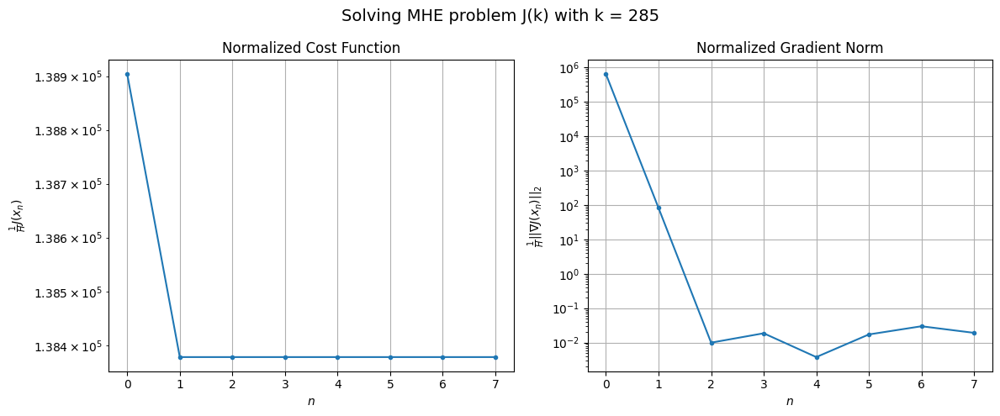

Windows:  63%|██████▎   | 187/296 [54:14<40:53, 22.51s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13540861.7105289
Gradient norm: 59768396.15209162
Global estimation error: 175.80151967026055
Initial conditions estimation errors: 87.73878104958587 m, 88.05132928973988 m, 87.64005895321598 m, 88.17120234198292 m
Position estimation errors: 58.602263435421925 m, 58.77444928186985 m, 58.735591121208756 m, 58.53285118968763 m

[Gauss-Newton] Iteration 1
Cost function: 13492331.88293946 (-0.36%)
Gradient norm: 7888.046052441901 (-99.99%)
Global estimation error: 188.73381254570154 (7.36%)
Initial conditions estimation errors: 94.1974808327094 m, 94.45684416234135 m, 94.09727075566644 m, 94.7142361014935 m
Position estimation errors: 52.944985074489026 m, 53.18896724730426 m, 53.1029817891413 m, 52.971748068045294 m

[Gauss-Newton] Iteration 2
Cost function: 13492331.883966755 (0.00%)
Gradient norm: 4.424291515336322 (-99.94%)
Global estimation error: 188.73383177934073 (0.00%)
Initial conditions estimation errors: 94.1974967847

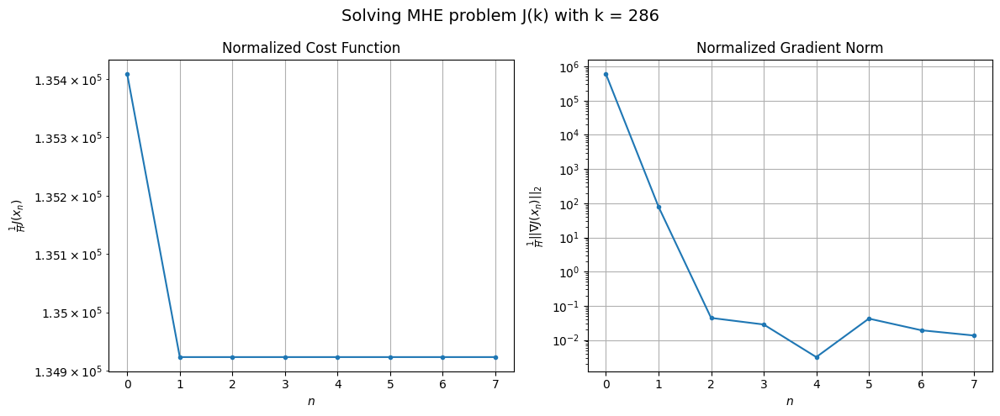

Windows:  64%|██████▎   | 188/296 [54:32<38:04, 21.16s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13179356.929940157
Gradient norm: 53641495.6248028
Global estimation error: 170.41892161084715
Initial conditions estimation errors: 85.10372584887446 m, 85.27083873849904 m, 84.95200942599463 m, 85.50964562698253 m
Position estimation errors: 51.08055314340164 m, 51.4047050482171 m, 51.256676174455066 m, 51.22018212910155 m

[Gauss-Newton] Iteration 1
Cost function: 13135224.753818395 (-0.33%)
Gradient norm: 7456.404514016949 (-99.99%)
Global estimation error: 183.15960533271482 (7.48%)
Initial conditions estimation errors: 91.42966132101883 m, 91.66284542885846 m, 91.22749165916535 m, 91.99682147966782 m
Position estimation errors: 45.73352954684716 m, 46.07852216895494 m, 45.96681668149055 m, 45.56529087967871 m

[Gauss-Newton] Iteration 2
Cost function: 13135224.753091857 (-0.00%)
Gradient norm: 2.1255817328778077 (-99.97%)
Global estimation error: 183.1598564187001 (0.00%)
Initial conditions estimation errors: 91.42967711

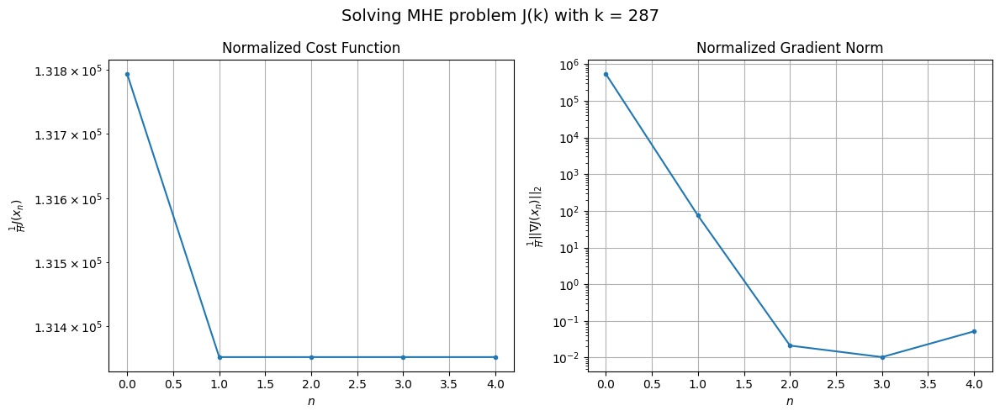

Windows:  64%|██████▍   | 189/296 [54:44<32:46, 18.38s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12811217.758802885
Gradient norm: 46988928.02079782
Global estimation error: 164.9110495496696
Initial conditions estimation errors: 82.36544491851299 m, 82.51002598991451 m, 82.12267672931041 m, 82.82174789884348 m
Position estimation errors: 43.23675649143572 m, 43.67343919781407 m, 43.4938761348149 m, 43.20986003154406 m

[Gauss-Newton] Iteration 1
Cost function: 12771609.952438392 (-0.31%)
Gradient norm: 6977.403203760084 (-99.99%)
Global estimation error: 177.07781701982415 (7.38%)
Initial conditions estimation errors: 88.51508763676625 m, 88.59654499780912 m, 88.23432572009615 m, 88.80808410489861 m
Position estimation errors: 38.25077967453997 m, 38.80537441873223 m, 38.597679980291495 m, 38.36053880571556 m

[Gauss-Newton] Iteration 2
Cost function: 12771609.951269064 (-0.00%)
Gradient norm: 4.337029042775215 (-99.94%)
Global estimation error: 177.07778507049338 (-0.00%)
Initial conditions estimation errors: 88.5151028

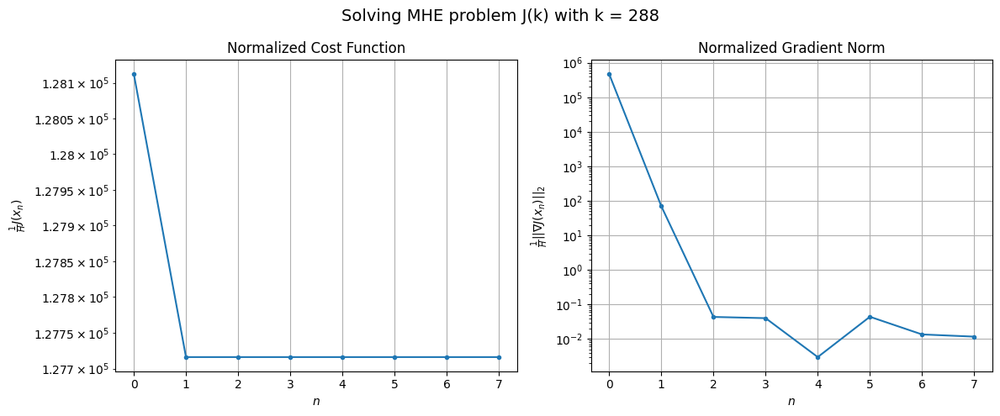

Windows:  64%|██████▍   | 190/296 [55:02<32:36, 18.46s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12441461.189868208
Gradient norm: 39696292.172537714
Global estimation error: 158.9247586751727
Initial conditions estimation errors: 79.48598450634728 m, 79.49653629338673 m, 79.17419663448419 m, 79.69124292327616 m
Position estimation errors: 35.18204928838587 m, 35.818732527490404 m, 35.556734523492345 m, 35.401453017389734 m

[Gauss-Newton] Iteration 1
Cost function: 12406550.279090188 (-0.28%)
Gradient norm: 6405.70917961938 (-99.98%)
Global estimation error: 170.6640020254367 (7.39%)
Initial conditions estimation errors: 85.40435168230273 m, 85.35689800721455 m, 85.06144743590627 m, 85.50399200493169 m
Position estimation errors: 30.623066882815507 m, 31.40009478581646 m, 31.025064162610715 m, 31.11489810529202 m

[Gauss-Newton] Iteration 2
Cost function: 12406550.278151585 (-0.00%)
Gradient norm: 2.581449478487494 (-99.96%)
Global estimation error: 170.6640017689595 (-0.00%)
Initial conditions estimation errors: 85.4043

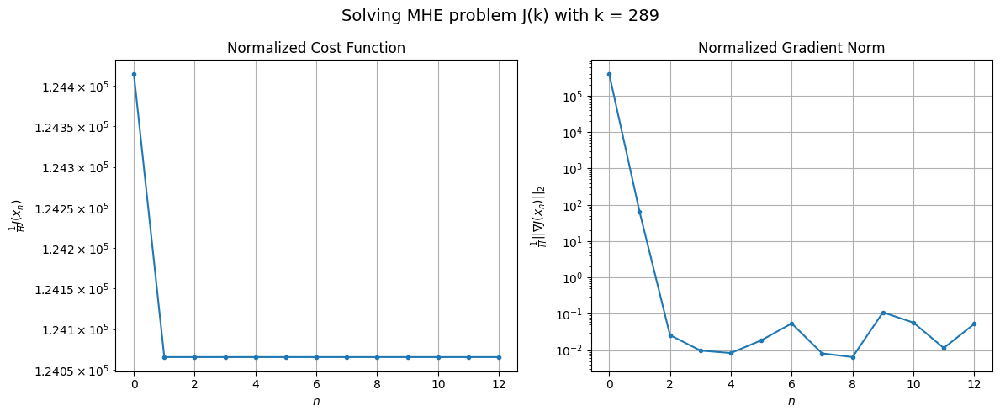

Windows:  65%|██████▍   | 191/296 [55:31<37:48, 21.61s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12078647.849705467
Gradient norm: 32102786.525854442
Global estimation error: 152.6212923544835
Initial conditions estimation errors: 76.41550283239627 m, 76.31982225878528 m, 76.05423912044562 m, 76.45163994499498 m
Position estimation errors: 27.025894093883856 m, 27.866639302441946 m, 27.452630556788392 m, 27.596495081498137 m

[Gauss-Newton] Iteration 1
Cost function: 12048376.485462911 (-0.25%)
Gradient norm: 5792.960551188505 (-99.98%)
Global estimation error: 164.01269559944808 (7.46%)
Initial conditions estimation errors: 82.0575098031701 m, 82.02313001311617 m, 81.79014074715508 m, 82.15344677880454 m
Position estimation errors: 22.9732024404307 m, 23.931839186506828 m, 23.4765370999889 m, 23.756040662548436 m

[Gauss-Newton] Iteration 2
Cost function: 12048376.486470124 (0.00%)
Gradient norm: 2.998865555723293 (-99.95%)
Global estimation error: 164.01267542505678 (-0.00%)
Initial conditions estimation errors: 82.0575

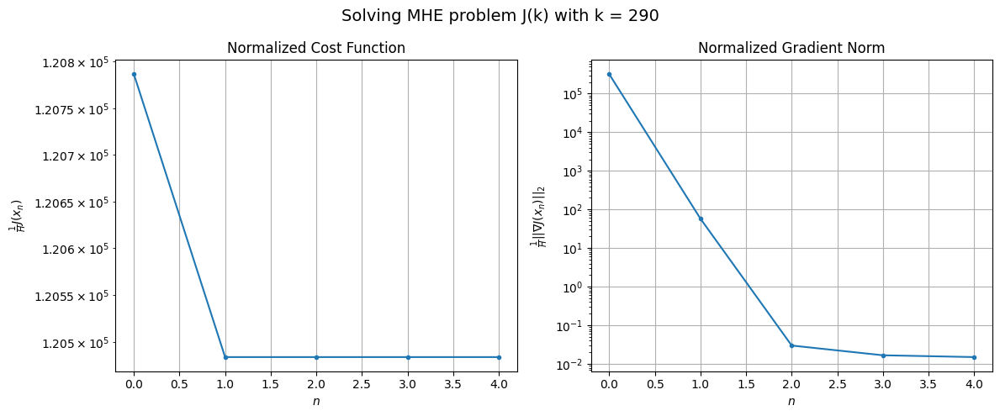

Windows:  65%|██████▍   | 192/296 [55:43<32:30, 18.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11729752.51570672
Gradient norm: 23380798.830950357
Global estimation error: 146.16225266439727
Initial conditions estimation errors: 73.14673704202414 m, 73.09613636578935 m, 72.87738265982327 m, 73.20302855430968 m
Position estimation errors: 18.950881512347422 m, 19.926962648752024 m, 19.46712503534359 m, 19.782557304612308 m

[Gauss-Newton] Iteration 1
Cost function: 11704214.869666133 (-0.22%)
Gradient norm: 5110.944518631229 (-99.98%)
Global estimation error: 156.8503720354337 (7.31%)
Initial conditions estimation errors: 78.44518981327163 m, 78.44581484248918 m, 78.21502863740622 m, 78.59346001746793 m
Position estimation errors: 15.594586489463603 m, 16.644327274305322 m, 16.144885343710513 m, 16.427209052633344 m

[Gauss-Newton] Iteration 2
Cost function: 11704214.869569797 (-0.00%)
Gradient norm: 1.7619159417946813 (-99.97%)
Global estimation error: 156.8504189646295 (0.00%)
Initial conditions estimation errors: 78.4

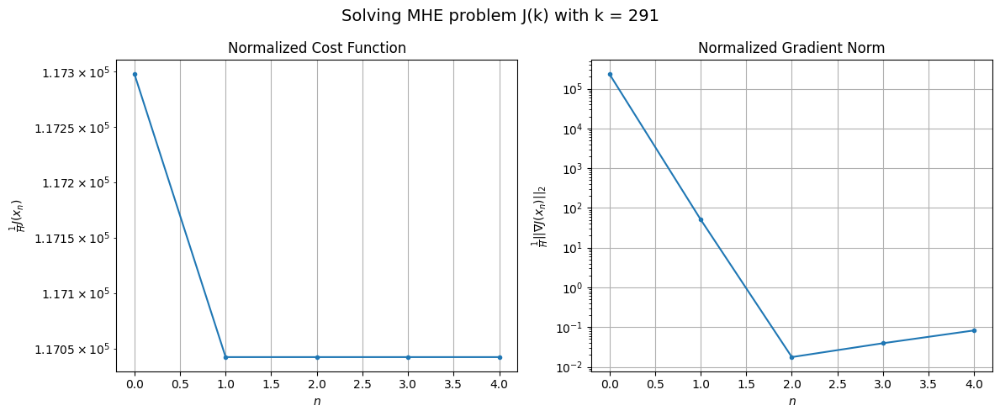

Windows:  65%|██████▌   | 193/296 [55:55<28:44, 16.75s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11405275.35626567
Gradient norm: 15094700.718787923
Global estimation error: 139.36452134935237
Initial conditions estimation errors: 69.70664914435513 m, 69.70782706810041 m, 69.49671905104218 m, 69.8166041851633 m
Position estimation errors: 11.544219281201345 m, 12.56363289264977 m, 12.09156867424645 m, 12.409546181739707 m

[Gauss-Newton] Iteration 1
Cost function: 11384109.222542187 (-0.19%)
Gradient norm: 4421.6434358136985 (-99.97%)
Global estimation error: 149.17019491221677 (7.04%)
Initial conditions estimation errors: 74.62058193305327 m, 74.55853004936057 m, 74.39911333000391 m, 74.76087744390684 m
Position estimation errors: 9.40200554169968 m, 10.506048845538475 m, 10.102816171495975 m, 10.470380807005863 m

[Gauss-Newton] Iteration 2
Cost function: 11384109.2222706 (-0.00%)
Gradient norm: 3.2722928203567507 (-99.93%)
Global estimation error: 149.17019156877436 (-0.00%)
Initial conditions estimation errors: 74.620

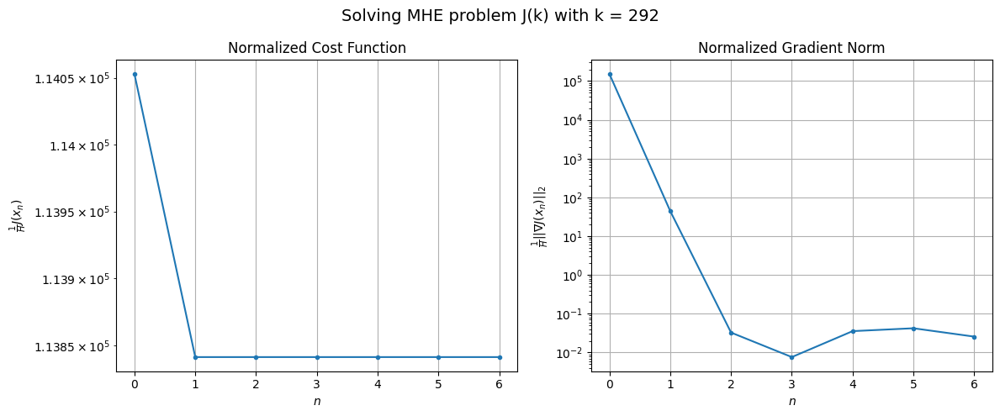

Windows:  66%|██████▌   | 194/296 [56:11<28:07, 16.54s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11108666.827196267
Gradient norm: 5710167.419838755
Global estimation error: 132.35339367698916
Initial conditions estimation errors: 66.191183076202 m, 66.16940118473727 m, 66.018173868683 m, 66.32676278026734 m
Position estimation errors: 7.284664816953852 m, 7.913267741242637 m, 7.800459661229578 m, 7.996951151149193 m

[Gauss-Newton] Iteration 1
Cost function: 11091518.981496677 (-0.15%)
Gradient norm: 3705.739000276475 (-99.94%)
Global estimation error: 141.46863454041787 (6.89%)
Initial conditions estimation errors: 70.67312502149322 m, 70.78978808150623 m, 70.59908152586944 m, 70.87407861846846 m
Position estimation errors: 7.89776466371927 m, 8.498152882528952 m, 8.473253376552925 m, 8.471452102714542 m

[Gauss-Newton] Iteration 2
Cost function: 11091518.981655888 (0.00%)
Gradient norm: 4.8866064417012565 (-99.87%)
Global estimation error: 141.4686632610113 (0.00%)
Initial conditions estimation errors: 70.6731325590545

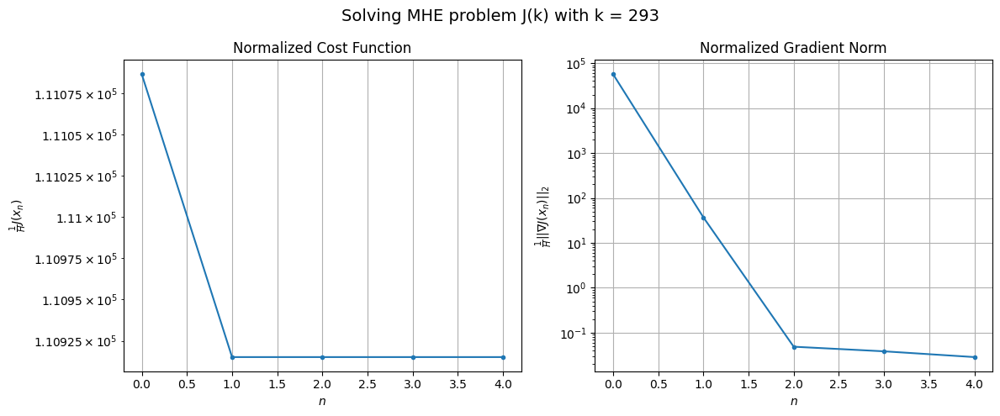

Windows:  66%|██████▌   | 195/296 [56:23<25:25, 15.10s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10847150.947522597
Gradient norm: 3564389.5641085054
Global estimation error: 125.66258842772038
Initial conditions estimation errors: 62.72128973770286 m, 62.9235603637412 m, 62.732234084842375 m, 62.94680385299811 m
Position estimation errors: 10.816128703647626 m, 10.521507424110759 m, 10.921268093365935 m, 10.608587341579755 m

[Gauss-Newton] Iteration 1
Cost function: 10833492.73662472 (-0.13%)
Gradient norm: 3015.574755620108 (-99.92%)
Global estimation error: 133.5280111581895 (6.26%)
Initial conditions estimation errors: 66.73408435364603 m, 66.94171848946434 m, 66.65293183514451 m, 66.72602642940306 m
Position estimation errors: 12.718976195155832 m, 12.417293407515013 m, 12.805555232260097 m, 12.42068080040629 m

[Gauss-Newton] Iteration 2
Cost function: 10833492.736204388 (-0.00%)
Gradient norm: 2.6696990408543386 (-99.91%)
Global estimation error: 133.52802221107154 (0.00%)
Initial conditions estimation errors: 66.

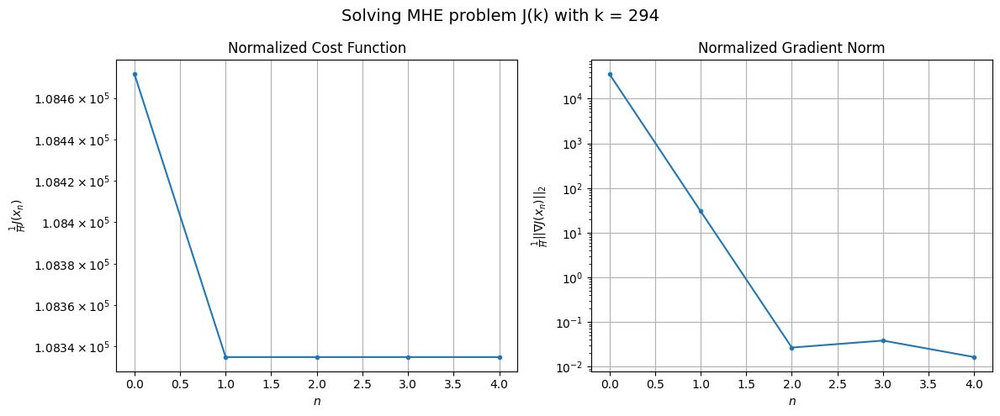

Windows:  66%|██████▌   | 196/296 [56:35<23:21, 14.02s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10626315.123730449
Gradient norm: 13180450.769435175
Global estimation error: 119.1010272897347
Initial conditions estimation errors: 59.46686987934807 m, 59.7758145411212 m, 59.49749034608135 m, 59.460343262955945 m
Position estimation errors: 18.09588587721272 m, 17.37960684747044 m, 17.96357603796439 m, 17.502906508065486 m

[Gauss-Newton] Iteration 1
Cost function: 10615655.416885654 (-0.10%)
Gradient norm: 2334.1266625687845 (-99.98%)
Global estimation error: 126.20601975732484 (5.97%)
Initial conditions estimation errors: 62.9597486265592 m, 63.27099896058711 m, 63.07189227930163 m, 63.10807034270583 m
Position estimation errors: 19.685845042347772 m, 19.015773190727128 m, 19.575494080957593 m, 19.089066111563387 m

[Gauss-Newton] Iteration 2
Cost function: 10615655.416767754 (-0.00%)
Gradient norm: 2.7548394013846345 (-99.88%)
Global estimation error: 126.20604925919949 (0.00%)
Initial conditions estimation errors: 62.9

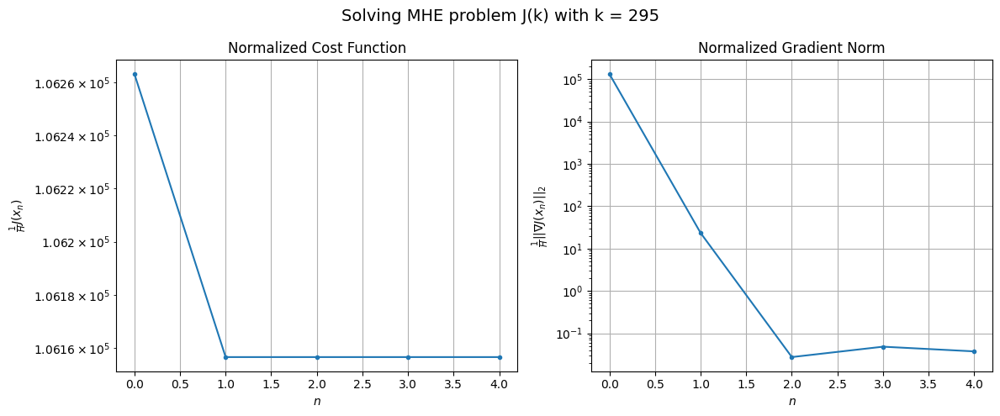

Windows:  67%|██████▋   | 197/296 [56:46<21:56, 13.30s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10451543.247530324
Gradient norm: 23652968.387427583
Global estimation error: 113.67135243656269
Initial conditions estimation errors: 56.59400468778846 m, 57.065342515150796 m, 56.86286551437638 m, 56.81854343141394 m
Position estimation errors: 26.231572329509373 m, 25.315918609095995 m, 25.99290922728308 m, 25.39834333360204 m

[Gauss-Newton] Iteration 1
Cost function: 10443215.354329301 (-0.08%)
Gradient norm: 1690.6702332623724 (-99.99%)
Global estimation error: 119.58664044189558 (5.20%)
Initial conditions estimation errors: 59.5320437073148 m, 60.18083907445386 m, 59.75165106243378 m, 59.70590232636971 m
Position estimation errors: 27.213048344139157 m, 26.418197980174778 m, 27.040267641222194 m, 26.44350128724274 m

[Gauss-Newton] Iteration 2
Cost function: 10443215.35402906 (-0.00%)
Gradient norm: 2.346981819812002 (-99.86%)
Global estimation error: 119.58660503150321 (-0.00%)
Initial conditions estimation errors: 59.

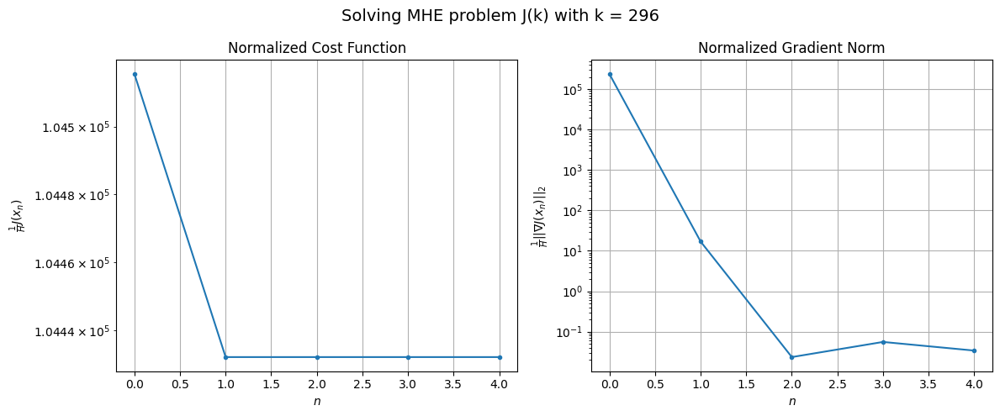

Windows:  67%|██████▋   | 198/296 [56:58<21:07, 12.93s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10324505.921140244
Gradient norm: 33779512.76643205
Global estimation error: 109.23177943714192
Initial conditions estimation errors: 54.22878678818694 m, 55.086245754028745 m, 54.62386680453249 m, 54.5202230465087 m
Position estimation errors: 34.55536744548513 m, 33.58878988741295 m, 34.312929266577044 m, 33.62086520354738 m

[Gauss-Newton] Iteration 1
Cost function: 10317624.928876152 (-0.07%)
Gradient norm: 1114.1624568488062 (-100.00%)
Global estimation error: 114.05194864153394 (4.41%)
Initial conditions estimation errors: 56.631202221372085 m, 57.523579404720955 m, 56.71929223625548 m, 57.224181368585604 m
Position estimation errors: 34.878055477834685 m, 33.74878372574535 m, 34.62657744581002 m, 33.75707064967284 m

[Gauss-Newton] Iteration 2
Cost function: 10317624.928788159 (-0.00%)
Gradient norm: 1.5713258164642878 (-99.86%)
Global estimation error: 114.05181505211087 (-0.00%)
Initial conditions estimation errors: 5

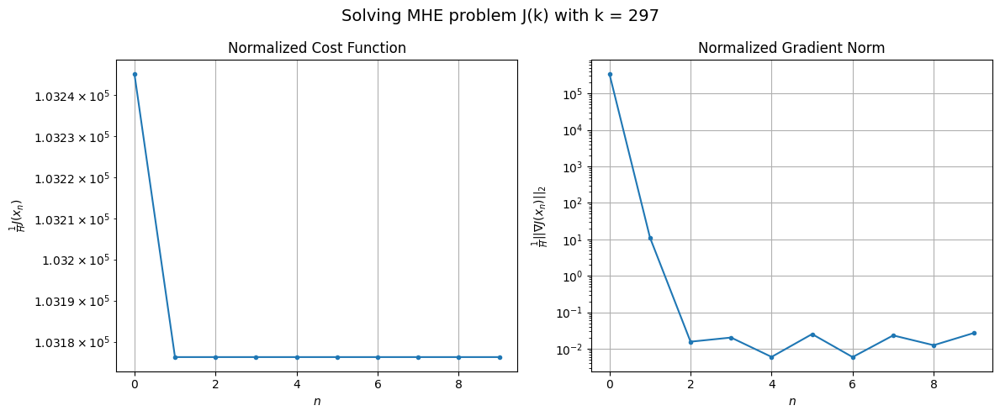

Windows:  67%|██████▋   | 199/296 [57:21<25:38, 15.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10248994.706833707
Gradient norm: 43983458.42085806
Global estimation error: 106.1413996414927
Initial conditions estimation errors: 52.48654219363632 m, 53.6853478366873 m, 52.75682528881002 m, 53.34473318921924 m
Position estimation errors: 42.845711791218356 m, 41.574160587171605 m, 42.55670118628845 m, 41.56966346310865 m

[Gauss-Newton] Iteration 1
Cost function: 10242636.006261764 (-0.06%)
Gradient norm: 626.267823523708 (-100.00%)
Global estimation error: 109.85384758176166 (3.50%)
Initial conditions estimation errors: 54.387237480854544 m, 55.621920118618824 m, 54.5084236977023 m, 55.17996329224855 m
Position estimation errors: 42.46540356909313 m, 41.25498223521197 m, 42.21466305290717 m, 41.20987649506934 m

[Gauss-Newton] Iteration 2
Cost function: 10242636.006105967 (-0.00%)
Gradient norm: 1.664257109306996 (-99.73%)
Global estimation error: 109.85381378856258 (-0.00%)
Initial conditions estimation errors: 54.38723

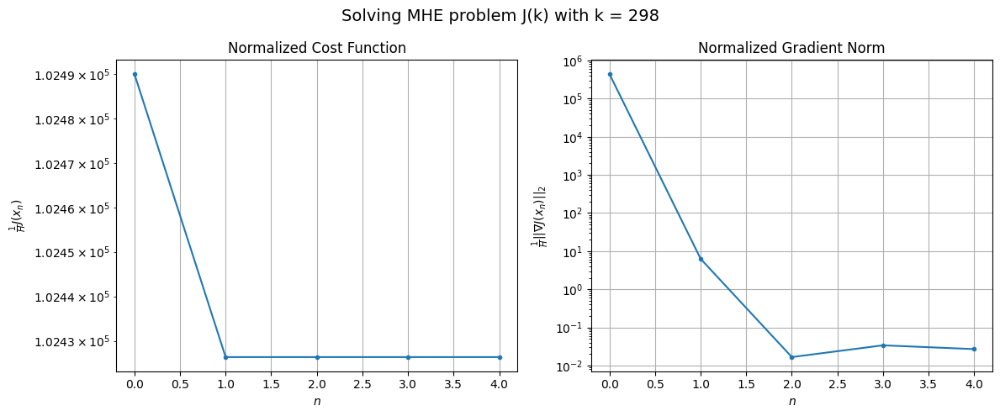

Windows:  68%|██████▊   | 200/296 [57:33<23:31, 14.71s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10224965.503029142
Gradient norm: 54373274.587898076
Global estimation error: 104.51045911872289
Initial conditions estimation errors: 51.51293889531187 m, 53.06936637554196 m, 51.81919966192391 m, 52.603911182810904 m
Position estimation errors: 51.00916003879993 m, 49.68437224935872 m, 50.73841440499154 m, 49.631529082339824 m

[Gauss-Newton] Iteration 1
Cost function: 10218167.60389518 (-0.07%)
Gradient norm: 237.72182598892132 (-100.00%)
Global estimation error: 107.62903094017165 (2.98%)
Initial conditions estimation errors: 52.9866043415843 m, 54.47303587470987 m, 53.46269064441112 m, 54.32091137533749 m
Position estimation errors: 49.91238085792534 m, 48.54608604290559 m, 49.58926749471346 m, 48.46097022459331 m

[Gauss-Newton] Iteration 2
Cost function: 10218167.603818571 (-0.00%)
Gradient norm: 2.8151324124784085 (-98.82%)
Global estimation error: 107.62920776140291 (0.00%)
Initial conditions estimation errors: 52.986

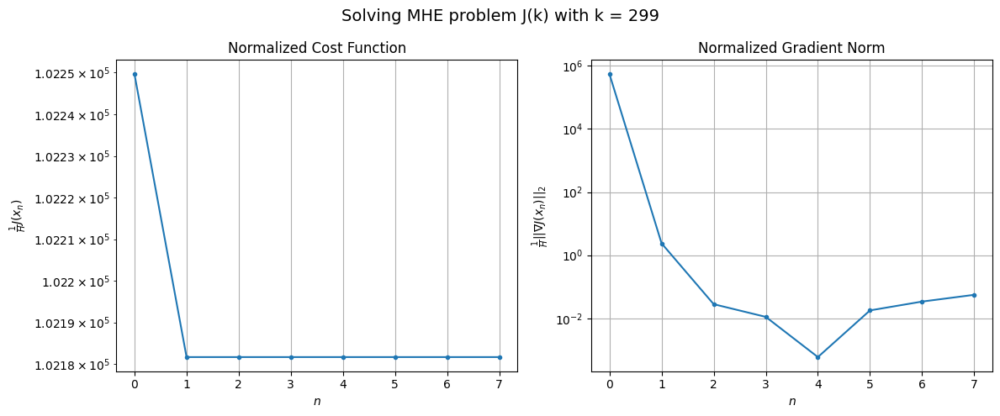

Windows:  68%|██████▊   | 201/296 [57:51<24:56, 15.75s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10251332.506775154
Gradient norm: 64089478.8407137
Global estimation error: 105.12899981419287
Initial conditions estimation errors: 51.52135597808393 m, 53.32635732555076 m, 52.202835534893204 m, 53.185840607130466 m
Position estimation errors: 59.053198669657206 m, 57.59706722100107 m, 58.718505348645145 m, 57.499141645968514 m

[Gauss-Newton] Iteration 1
Cost function: 10243117.437137654 (-0.08%)
Gradient norm: 67.5830663344049 (-100.00%)
Global estimation error: 107.11992719739096 (1.89%)
Initial conditions estimation errors: 52.68702741522587 m, 54.224983825410476 m, 53.12674502772971 m, 54.1836620182727 m
Position estimation errors: 57.23522708589582 m, 55.950938439567 m, 56.94315824501265 m, 55.71140437504864 m

[Gauss-Newton] Iteration 2
Cost function: 10243117.437052025 (-0.00%)
Gradient norm: 3.558215909479336 (-94.74%)
Global estimation error: 107.12007740388529 (0.00%)
Initial conditions estimation errors: 52.68702

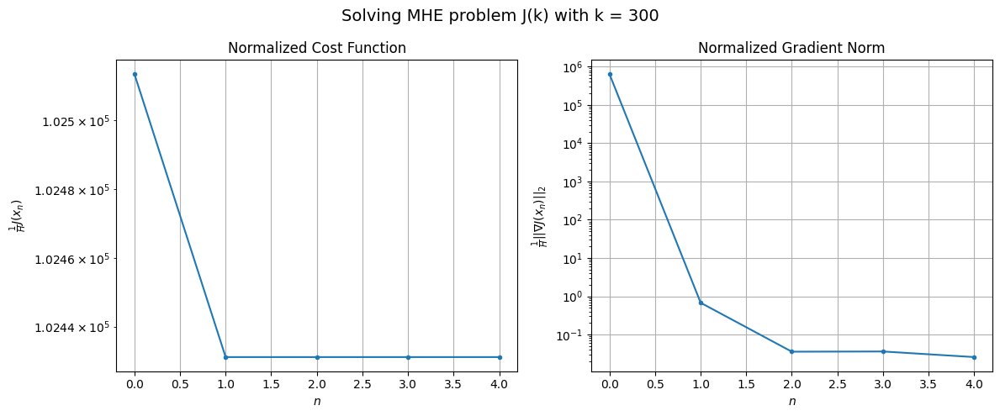

Windows:  68%|██████▊   | 202/296 [58:03<22:58, 14.67s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10327633.637247605
Gradient norm: 74217006.19928364
Global estimation error: 107.42614147677713
Initial conditions estimation errors: 52.662258522014746 m, 54.44920775124616 m, 53.277537751474775 m, 54.44056664972036 m
Position estimation errors: 67.01175517189945 m, 65.65228854681317 m, 66.7179722924685 m, 65.40241133954356 m

[Gauss-Newton] Iteration 1
Cost function: 10316829.015254235 (-0.10%)
Gradient norm: 210.51288596824025 (-100.00%)
Global estimation error: 109.92374648882338 (2.32%)
Initial conditions estimation errors: 53.68535690226721 m, 55.92943392124313 m, 54.36820263238054 m, 55.83041003910288 m
Position estimation errors: 64.45530122893118 m, 62.97202124099603 m, 64.14753044242492 m, 62.76303577602913 m

[Gauss-Newton] Iteration 2
Cost function: 10316829.015700635 (0.00%)
Gradient norm: 4.087596271483693 (-98.06%)
Global estimation error: 109.92348475904753 (-0.00%)
Initial conditions estimation errors: 53.6853

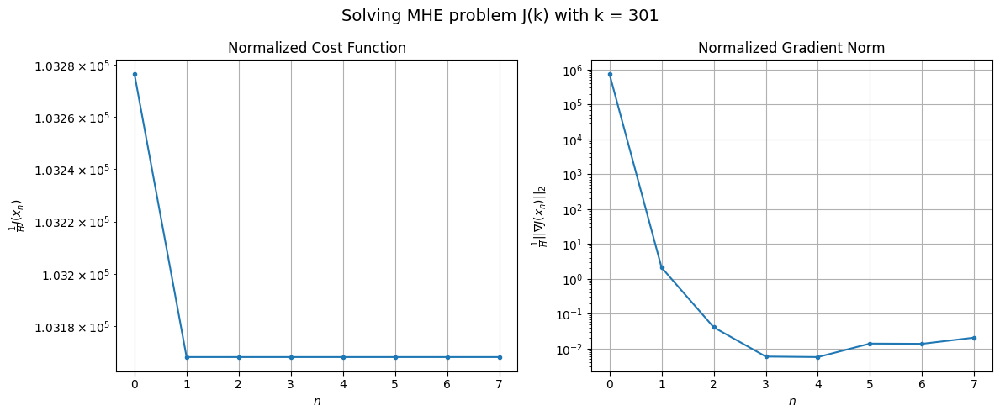

Windows:  69%|██████▊   | 203/296 [58:22<24:33, 15.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10452353.259567225
Gradient norm: 84336034.74256736
Global estimation error: 112.64796283165934
Initial conditions estimation errors: 54.89416447558274 m, 57.36315497407978 m, 55.71775736351472 m, 57.281168902438814 m
Position estimation errors: 74.9034508023122 m, 73.36252590894892 m, 74.60189936852778 m, 73.13733677429101 m

[Gauss-Newton] Iteration 1
Cost function: 10437770.132149672 (-0.14%)
Gradient norm: 222.42883031870267 (-100.00%)
Global estimation error: 114.4854137969977 (1.63%)
Initial conditions estimation errors: 55.93667093693405 m, 58.496525236843304 m, 56.62184029973096 m, 57.87971551647837 m
Position estimation errors: 71.58587459159556 m, 70.0323601773823 m, 71.29563897250505 m, 69.92413731946036 m

[Gauss-Newton] Iteration 2
Cost function: 10437770.132330896 (0.00%)
Gradient norm: 1.5326559363463408 (-99.31%)
Global estimation error: 114.48528644493447 (-0.00%)
Initial conditions estimation errors: 55.93667

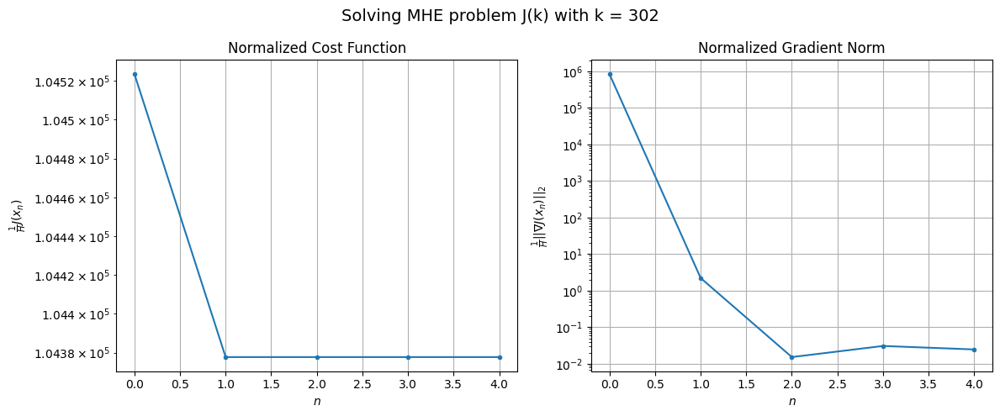

Windows:  69%|██████▉   | 204/296 [58:34<22:29, 14.67s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10624085.256791752
Gradient norm: 94298626.70752227
Global estimation error: 118.80746440597909
Initial conditions estimation errors: 57.98658781594445 m, 60.720421807202314 m, 58.77367246738853 m, 60.0949707817615 m
Position estimation errors: 82.72011791640023 m, 81.12459965282162 m, 82.4394471443468 m, 80.99865018897496 m

[Gauss-Newton] Iteration 1
Cost function: 10604554.65093147 (-0.18%)
Gradient norm: 93.21584870201923 (-100.00%)
Global estimation error: 121.52139496674307 (2.28%)
Initial conditions estimation errors: 59.2090445232729 m, 62.1732584580283 m, 60.18219108592141 m, 61.43516782988536 m
Position estimation errors: 78.64067474616483 m, 77.03043231934706 m, 78.37977090655492 m, 76.94009017523997 m

[Gauss-Newton] Iteration 2
Cost function: 10604554.65076991 (-0.00%)
Gradient norm: 1.976556109665334 (-97.88%)
Global estimation error: 121.52134757543533 (-0.00%)
Initial conditions estimation errors: 59.2090491340

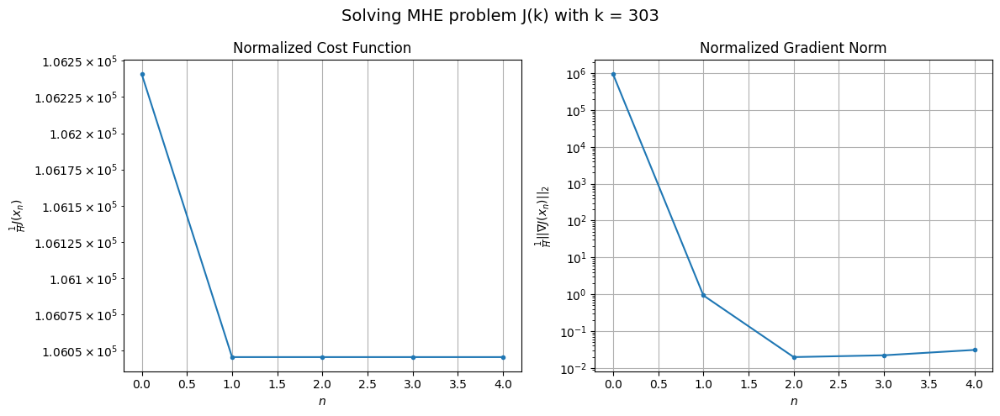

Windows:  69%|██████▉   | 205/296 [58:46<21:09, 13.95s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10837349.65005298
Gradient norm: 103608114.10490501
Global estimation error: 126.61604431581814
Initial conditions estimation errors: 61.67824687603044 m, 64.76514052703192 m, 62.71494433312473 m, 64.02881832676744 m
Position estimation errors: 90.4196729340608 m, 88.7908961242283 m, 90.17590343728041 m, 88.67242131945159 m

[Gauss-Newton] Iteration 1
Cost function: 10811921.080237772 (-0.23%)
Gradient norm: 214.39197479295387 (-100.00%)
Global estimation error: 129.79265276426185 (2.51%)
Initial conditions estimation errors: 63.21963998676795 m, 66.32650082960274 m, 64.26871186571275 m, 65.72442436305062 m
Position estimation errors: 85.61159705697855 m, 83.96672540759893 m, 85.42993540911212 m, 83.86050308353087 m

[Gauss-Newton] Iteration 2
Cost function: 10811921.080781953 (0.00%)
Gradient norm: 0.49985156169885653 (-99.77%)
Global estimation error: 129.79272337424686 (0.00%)
Initial conditions estimation errors: 63.219646

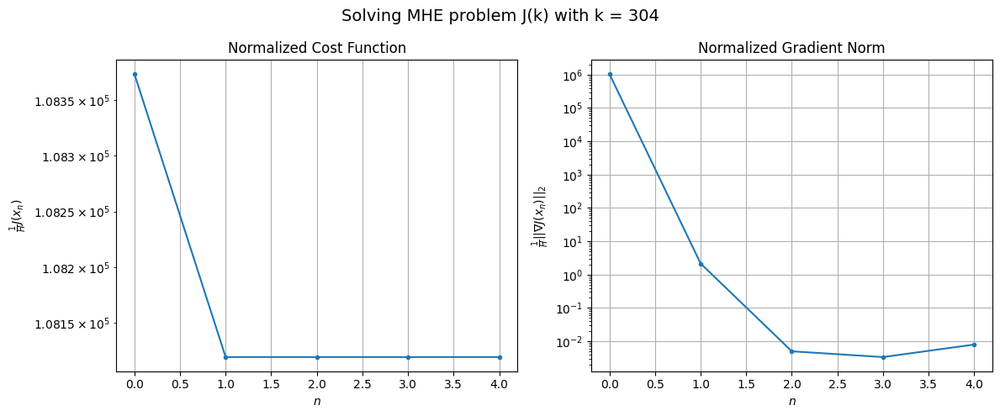

Windows:  70%|██████▉   | 206/296 [58:59<20:25, 13.61s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11092332.900754116
Gradient norm: 112639250.28554884
Global estimation error: 134.9957327032046
Initial conditions estimation errors: 65.76172832775018 m, 68.95996944944504 m, 66.8470952803969 m, 68.37543724415185 m
Position estimation errors: 97.92323825117592 m, 96.2775061810171 m, 97.76200115312818 m, 96.139855232933 m

[Gauss-Newton] Iteration 1
Cost function: 11059920.691182777 (-0.29%)
Gradient norm: 656.5568149255588 (-100.00%)
Global estimation error: 138.60124497203233 (2.67%)
Initial conditions estimation errors: 67.72537233724816 m, 70.61275599969012 m, 68.91366071030357 m, 69.91634998048018 m
Position estimation errors: 92.39056014798122 m, 90.82356241901486 m, 92.21458873781083 m, 90.73212478349305 m

[Gauss-Newton] Iteration 2
Cost function: 11059920.691198843 (0.00%)
Gradient norm: 1.6419801426120861 (-99.75%)
Global estimation error: 138.60141268826695 (0.00%)
Initial conditions estimation errors: 67.7253805737

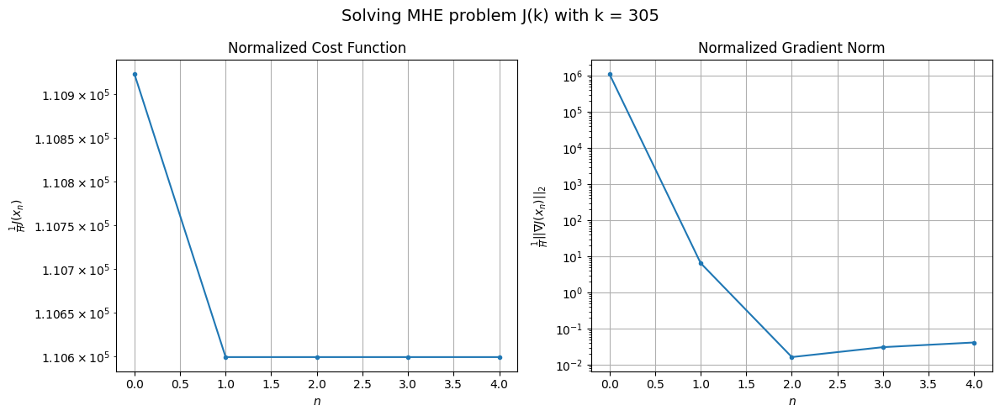

Windows:  70%|██████▉   | 207/296 [59:11<19:39, 13.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11383484.379582006
Gradient norm: 120979197.5465373
Global estimation error: 143.41681450630242
Initial conditions estimation errors: 70.09249737145869 m, 73.04133868075185 m, 71.29739953323867 m, 72.36742617699761 m
Position estimation errors: 105.07937395616672 m, 103.52534699748257 m, 104.92679432992779 m, 103.40121847355026 m

[Gauss-Newton] Iteration 1
Cost function: 11343216.343352115 (-0.35%)
Gradient norm: 1245.6658050169904 (-100.00%)
Global estimation error: 148.42744936217315 (3.49%)
Initial conditions estimation errors: 72.56682631111498 m, 75.55344540736432 m, 73.87749014506538 m, 74.8233603315104 m
Position estimation errors: 98.85007546173387 m, 97.16663116265536 m, 98.59186838112117 m, 97.09328373522037 m

[Gauss-Newton] Iteration 2
Cost function: 11343216.343461523 (0.00%)
Gradient norm: 2.5448104522614288 (-99.80%)
Global estimation error: 148.42749053559533 (0.00%)
Initial conditions estimation errors: 72.56

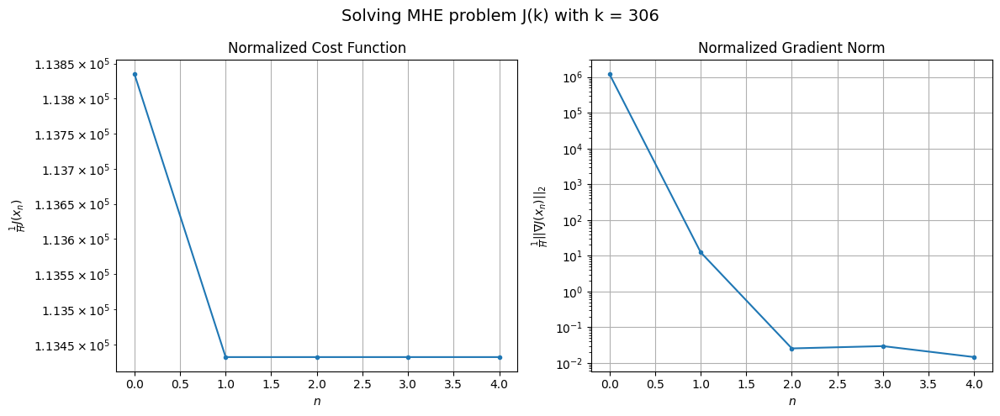

Windows:  70%|███████   | 208/296 [59:24<19:13, 13.10s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11705926.211315501
Gradient norm: 128568477.51937331
Global estimation error: 152.47019442395086
Initial conditions estimation errors: 74.57404980370607 m, 77.5745251234881 m, 75.88732038230576 m, 76.87107323332367 m
Position estimation errors: 111.76591396168338 m, 110.1153976498928 m, 111.53138195788745 m, 110.00971621607587 m

[Gauss-Newton] Iteration 1
Cost function: 11657053.722182842 (-0.42%)
Gradient norm: 2001.116989467472 (-100.00%)
Global estimation error: 158.65076007201293 (4.05%)
Initial conditions estimation errors: 77.62134554119724 m, 80.7098487513574 m, 78.96795196905241 m, 79.96848421262814 m
Position estimation errors: 104.86639971316585 m, 103.05290272412459 m, 104.54217661049982 m, 103.00839131635156 m

[Gauss-Newton] Iteration 2
Cost function: 11657053.722727193 (0.00%)
Gradient norm: 5.881389672281523 (-99.71%)
Global estimation error: 158.6507624950678 (0.00%)
Initial conditions estimation errors: 77.62

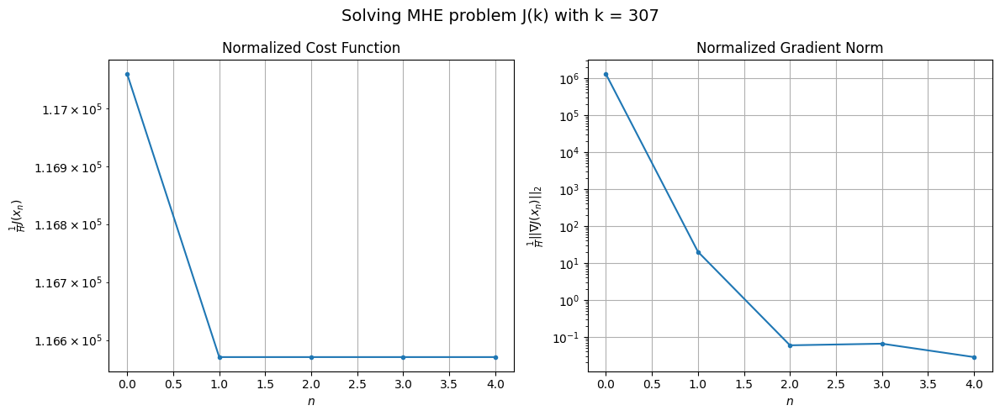

Windows:  71%|███████   | 209/296 [59:36<18:39, 12.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12050709.093091773
Gradient norm: 135192275.24653688
Global estimation error: 161.61281203780274
Initial conditions estimation errors: 79.10500419215603 m, 82.17864932987428 m, 80.44138595218104 m, 81.46742466350308 m
Position estimation errors: 117.88625061068204 m, 116.11973264528883 m, 117.5856022103802 m, 116.0426753691449 m

[Gauss-Newton] Iteration 1
Cost function: 11992781.971436623 (-0.48%)
Gradient norm: 2892.6352530702716 (-100.00%)
Global estimation error: 168.938984309898 (4.53%)
Initial conditions estimation errors: 82.77088711363072 m, 85.8843408955434 m, 84.04949963391398 m, 85.14054955476092 m
Position estimation errors: 110.3608125778365 m, 108.55626177183414 m, 110.13567795277717 m, 108.56067444490292 m

[Gauss-Newton] Iteration 2
Cost function: 11992781.971712515 (0.00%)
Gradient norm: 0.33341713426341146 (-99.99%)
Global estimation error: 168.9389641217548 (-0.00%)
Initial conditions estimation errors: 82.7

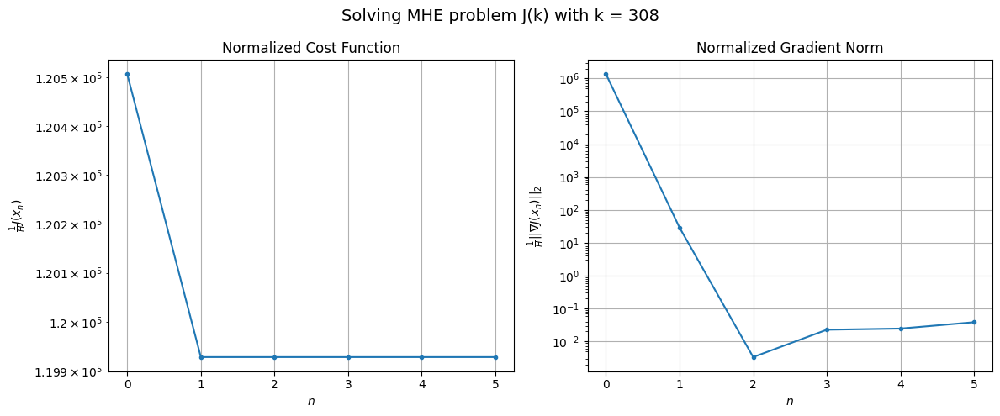

Windows:  71%|███████   | 210/296 [59:51<19:19, 13.48s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12411065.81542509
Gradient norm: 141214349.43439415
Global estimation error: 170.55270445041873
Initial conditions estimation errors: 83.57296979505485 m, 86.67819708671459 m, 84.83224101312373 m, 85.9892906941562 m
Position estimation errors: 123.38101752860588 m, 121.63240980624953 m, 123.18161093979322 m, 121.60003591284658 m

[Gauss-Newton] Iteration 1
Cost function: 12343544.856347308 (-0.54%)
Gradient norm: 3954.4885195027355 (-100.00%)
Global estimation error: 178.96792024397297 (4.93%)
Initial conditions estimation errors: 87.88007205359897 m, 90.83298979571299 m, 89.11258354652284 m, 90.08284909702591 m
Position estimation errors: 115.25057411213291 m, 113.4778539023933 m, 115.01500668840862 m, 113.49792265191824 m

[Gauss-Newton] Iteration 2
Cost function: 12343544.856895015 (0.00%)
Gradient norm: 2.9735906239853462 (-99.92%)
Global estimation error: 178.96796508027393 (0.00%)
Initial conditions estimation errors: 87

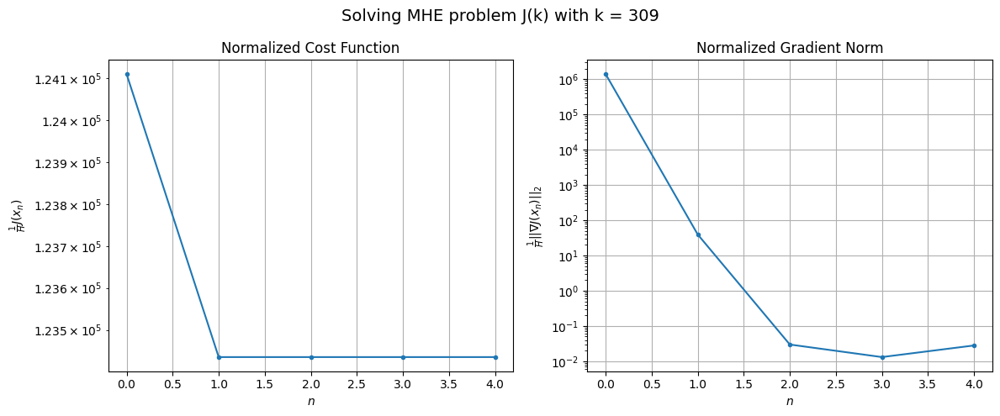

Windows:  71%|███████▏  | 211/296 [1:00:04<18:46, 13.25s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12778262.148008585
Gradient norm: 146402555.2075234
Global estimation error: 178.9363480075943
Initial conditions estimation errors: 87.86910835054094 m, 90.79380860636887 m, 89.07859938054338 m, 90.10393637047885 m
Position estimation errors: 128.17755988297955 m, 126.47180304451403 m, 127.97073801320163 m, 126.45374239181669 m

[Gauss-Newton] Iteration 1
Cost function: 12700877.526499957 (-0.61%)
Gradient norm: 5167.265370971975 (-100.00%)
Global estimation error: 188.70194166473902 (5.46%)
Initial conditions estimation errors: 92.83808968992898 m, 95.4873234514922 m, 93.95580619366459 m, 95.09987169738311 m
Position estimation errors: 119.48260646820584 m, 117.8654936706115 m, 119.23672123150511 m, 117.68123385816203 m

[Gauss-Newton] Iteration 2
Cost function: 12700877.527827749 (0.00%)
Gradient norm: 6.83735036475545 (-99.87%)
Global estimation error: 188.70207954032324 (0.00%)
Initial conditions estimation errors: 92.838

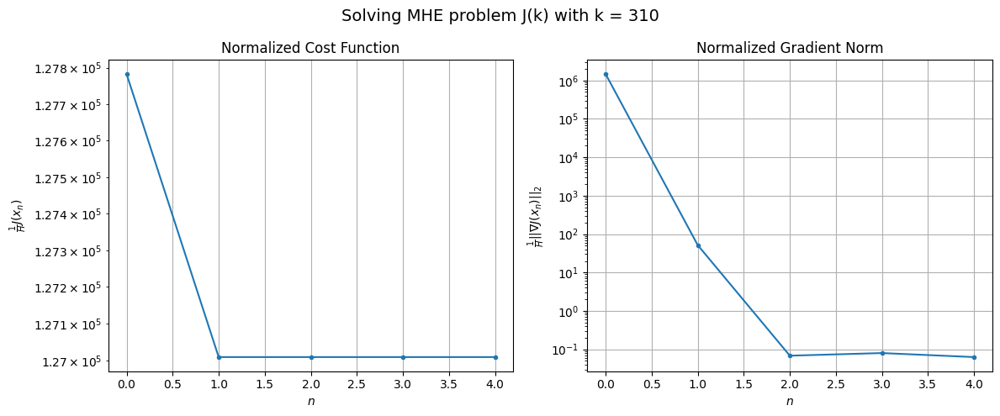

Windows:  72%|███████▏  | 212/296 [1:00:16<17:48, 12.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13147568.795456052
Gradient norm: 150987974.6617992
Global estimation error: 186.8614433635436
Initial conditions estimation errors: 91.93469173855054 m, 94.53979143999958 m, 93.02723532429258 m, 94.19855447582206 m
Position estimation errors: 132.2509381902194 m, 130.702679965914 m, 132.0302439560555 m, 130.48758256367094 m

[Gauss-Newton] Iteration 1
Cost function: 13060505.217129217 (-0.66%)
Gradient norm: 6419.086675807116 (-100.00%)
Global estimation error: 197.58445778195653 (5.74%)
Initial conditions estimation errors: 97.54409426712562 m, 99.62263235587926 m, 98.41749011359651 m, 99.56952859623654 m
Position estimation errors: 123.03536775200145 m, 121.62540412852968 m, 122.86979339442675 m, 121.35670868431738 m

[Gauss-Newton] Iteration 2
Cost function: 13060505.217459079 (0.00%)
Gradient norm: 1.8149808930098486 (-99.97%)
Global estimation error: 197.5846151252304 (0.00%)
Initial conditions estimation errors: 97.5441

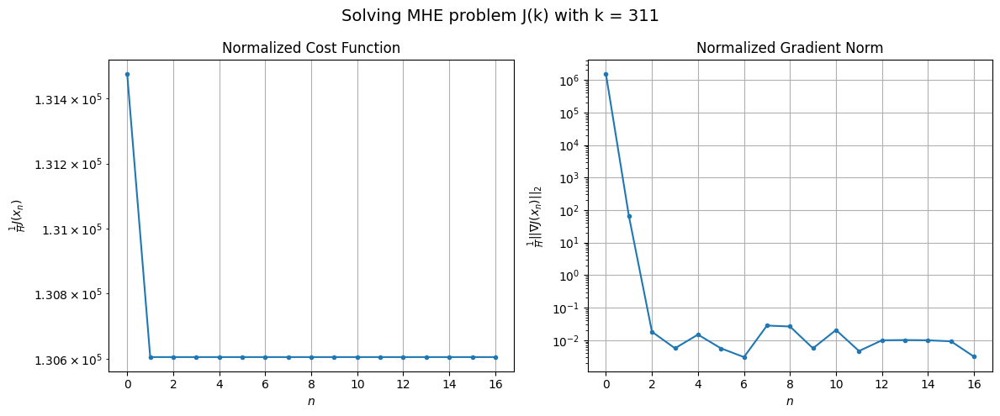

Windows:  72%|███████▏  | 213/296 [1:00:52<27:20, 19.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13502835.634275587
Gradient norm: 154715092.2087539
Global estimation error: 193.93693789264356
Initial conditions estimation errors: 95.72236309907585 m, 97.77646229420287 m, 96.57639551798081 m, 97.78302659967699 m
Position estimation errors: 135.63391520566486 m, 134.2780669438 m, 135.49008640311268 m, 133.9833935554133 m

[Gauss-Newton] Iteration 1
Cost function: 13406510.079618352 (-0.71%)
Gradient norm: 7751.264013438272 (-99.99%)
Global estimation error: 206.17050430162413 (6.31%)
Initial conditions estimation errors: 101.94923353090354 m, 104.11832689345671 m, 102.6592952872041 m, 103.60050326044556 m
Position estimation errors: 125.94901291076864 m, 124.57888682803119 m, 125.91502321949912 m, 124.57746413112383 m

[Gauss-Newton] Iteration 2
Cost function: 13406510.081386523 (0.00%)
Gradient norm: 3.4762647697167077 (-99.96%)
Global estimation error: 206.17034499795167 (-0.00%)
Initial conditions estimation errors: 101

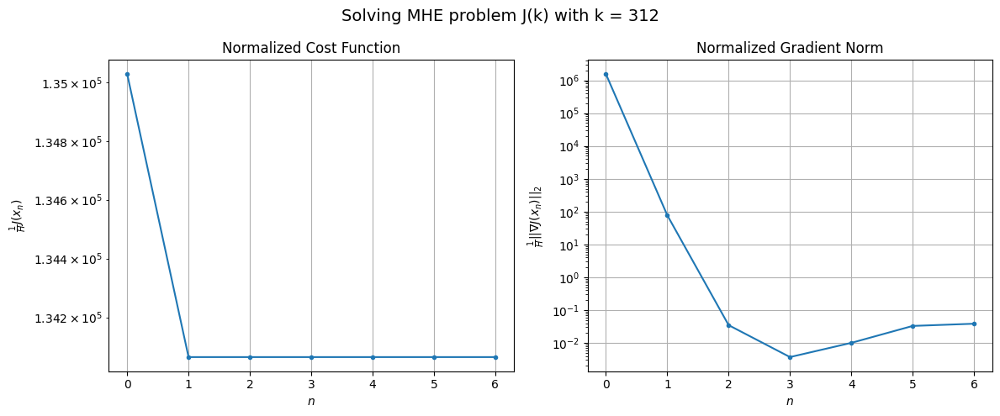

Windows:  72%|███████▏  | 214/296 [1:01:07<25:19, 18.53s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13845386.995421864
Gradient norm: 158961295.8703856
Global estimation error: 200.7414454764073
Initial conditions estimation errors: 99.22176426622838 m, 101.36843829248762 m, 99.91964090719787 m, 100.9587125681208 m
Position estimation errors: 138.4209068742098 m, 137.1138271356743 m, 138.41140888123542 m, 137.06560799480775 m

[Gauss-Newton] Iteration 1
Cost function: 13739463.751677413 (-0.77%)
Gradient norm: 9124.658080395995 (-99.99%)
Global estimation error: 214.5081540216424 (6.86%)
Initial conditions estimation errors: 106.04610601916195 m, 108.27475860827134 m, 106.82548386439761 m, 107.85568335977466 m
Position estimation errors: 128.26004774222565 m, 126.84331408799423 m, 128.12417822403103 m, 126.75465208317553 m

[Gauss-Newton] Iteration 2
Cost function: 13739463.754189927 (0.00%)
Gradient norm: 2.6029796227583075 (-99.97%)
Global estimation error: 214.5082224291183 (0.00%)
Initial conditions estimation errors: 10

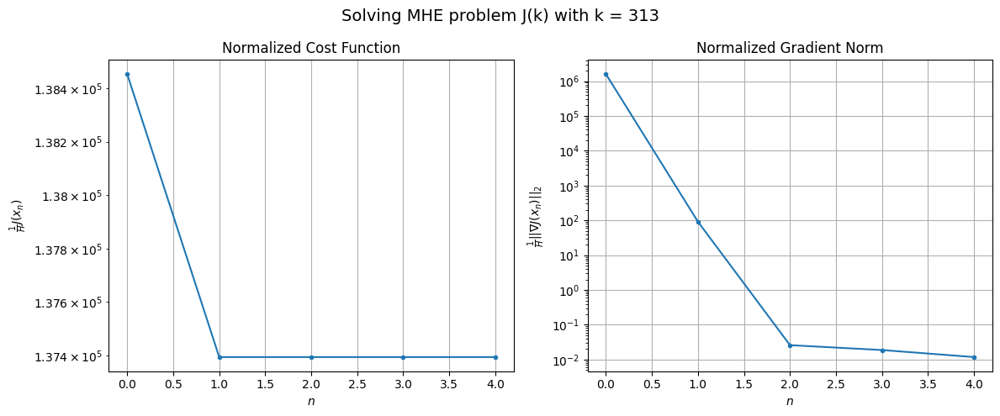

Windows:  73%|███████▎  | 215/296 [1:01:19<22:03, 16.34s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14161648.189406218
Gradient norm: 162445213.40281948
Global estimation error: 207.33461356589012
Initial conditions estimation errors: 102.45813780581345 m, 104.659419427397 m, 103.21996826703216 m, 104.31681040620062 m
Position estimation errors: 140.67146052637133 m, 139.31932663816127 m, 140.55958597224082 m, 139.1793857030378 m

[Gauss-Newton] Iteration 1
Cost function: 14046832.875162754 (-0.81%)
Gradient norm: 10502.144061571316 (-99.99%)
Global estimation error: 221.8808434159014 (7.02%)
Initial conditions estimation errors: 109.83497963829599 m, 111.7584538671073 m, 110.55575653264158 m, 111.6012336867246 m
Position estimation errors: 130.08298093582317 m, 128.796545987182 m, 129.89551034493297 m, 128.56025668756206 m

[Gauss-Newton] Iteration 2
Cost function: 14046832.875022471 (-0.00%)
Gradient norm: 3.329382930772148 (-99.97%)
Global estimation error: 221.88091167833065 (0.00%)
Initial conditions estimation errors: 

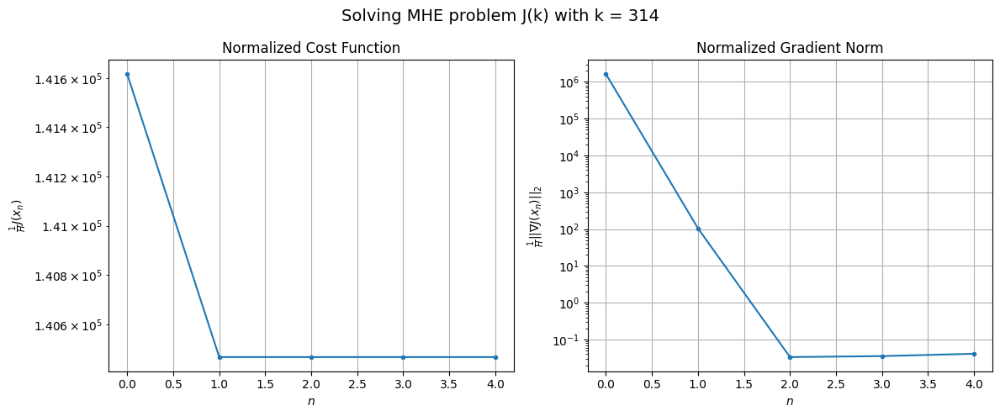

Windows:  73%|███████▎  | 216/296 [1:01:30<19:43, 14.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14460685.771142568
Gradient norm: 165935133.94080555
Global estimation error: 213.17052404439443
Initial conditions estimation errors: 105.47693696818222 m, 107.3866148936219 m, 106.17823449143506 m, 107.28727811653675 m
Position estimation errors: 142.49035237577354 m, 141.25442714265552 m, 142.31828767152086 m, 140.96895437594148 m

[Gauss-Newton] Iteration 1
Cost function: 14337779.650709484 (-0.85%)
Gradient norm: 11753.901275495622 (-99.99%)
Global estimation error: 228.84056642249024 (7.35%)
Initial conditions estimation errors: 113.33694908077536 m, 115.25153627656245 m, 114.13084011862098 m, 114.95192341387425 m
Position estimation errors: 131.5085067773747 m, 130.2439432860863 m, 131.31770299162386 m, 130.1142027542404 m

[Gauss-Newton] Iteration 2
Cost function: 14337779.649451243 (-0.00%)
Gradient norm: 0.49162561864025955 (-100.00%)
Global estimation error: 228.8405732785924 (0.00%)
Initial conditions estimation er

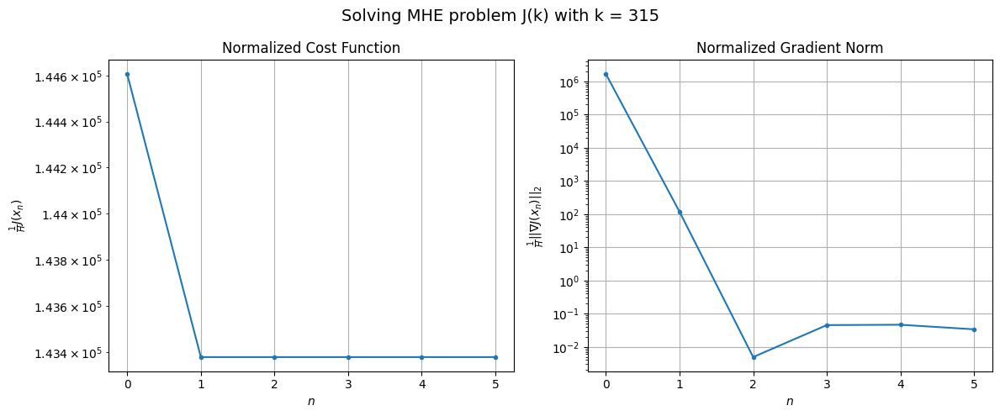

Windows:  73%|███████▎  | 217/296 [1:01:43<18:59, 14.42s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14732544.868659388
Gradient norm: 168999713.6898035
Global estimation error: 218.8745062244519
Initial conditions estimation errors: 108.34966780449764 m, 110.24689585115858 m, 109.12264329261727 m, 110.01926454324904 m
Position estimation errors: 143.9311279484642 m, 142.71902651427413 m, 143.7598757894147 m, 142.53335606393077 m

[Gauss-Newton] Iteration 1
Cost function: 14601960.738433672 (-0.89%)
Gradient norm: 12962.61138591105 (-99.99%)
Global estimation error: 234.897034499652 (7.32%)
Initial conditions estimation errors: 116.64954979068554 m, 118.10879598506105 m, 117.16370158106778 m, 117.86620079104482 m
Position estimation errors: 132.58092169189507 m, 131.5878587226369 m, 132.54211653735837 m, 131.36123872847577 m

[Gauss-Newton] Iteration 2
Cost function: 14601960.737997612 (-0.00%)
Gradient norm: 2.8881815693433186 (-99.98%)
Global estimation error: 234.89701067984566 (-0.00%)
Initial conditions estimation errors

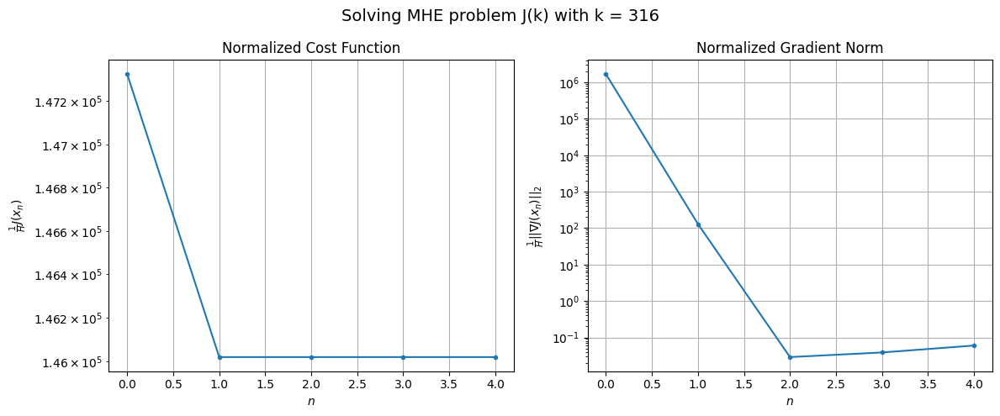

Windows:  74%|███████▎  | 218/296 [1:01:55<17:34, 13.52s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14973476.418637207
Gradient norm: 171648476.94478998
Global estimation error: 223.98209220186658
Initial conditions estimation errors: 111.1892251722888 m, 112.63944927986253 m, 111.69331693510222 m, 112.43600722183186 m
Position estimation errors: 144.98298086575076 m, 144.03249458674009 m, 144.95390671660385 m, 143.74939940662577 m

[Gauss-Newton] Iteration 1
Cost function: 14836092.976704137 (-0.92%)
Gradient norm: 14015.524148088065 (-99.99%)
Global estimation error: 241.54715316626832 (7.84%)
Initial conditions estimation errors: 119.87241153626489 m, 121.51238322198428 m, 120.24580686443257 m, 121.45483085889792 m
Position estimation errors: 133.30785699918056 m, 132.30349430761615 m, 133.4537533298189 m, 131.91397352370984 m

[Gauss-Newton] Iteration 2
Cost function: 14836092.978038663 (0.00%)
Gradient norm: 2.58267052109071 (-99.98%)
Global estimation error: 241.54715889235004 (0.00%)
Initial conditions estimation erro

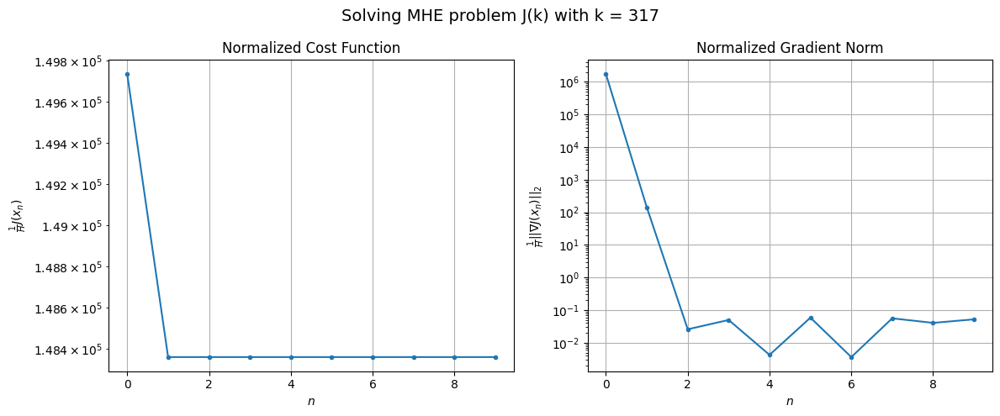

Windows:  74%|███████▍  | 219/296 [1:02:16<20:29, 15.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15176752.304655861
Gradient norm: 173705710.99514183
Global estimation error: 229.85237803384717
Initial conditions estimation errors: 114.03898006910474 m, 115.63781894796077 m, 114.41545456964926 m, 115.603569175086 m
Position estimation errors: 145.60159104357206 m, 144.65988477062555 m, 145.76348742166346 m, 144.21875469988032 m

[Gauss-Newton] Iteration 1
Cost function: 15033362.7898224 (-0.94%)
Gradient norm: 15024.133387456464 (-99.99%)
Global estimation error: 247.91184892929607 (7.86%)
Initial conditions estimation errors: 123.05539013622085 m, 124.57613938150419 m, 123.54802934627584 m, 124.63658225418605 m
Position estimation errors: 133.63824017069538 m, 132.6614122231347 m, 133.6050535117593 m, 132.15716380211535 m

[Gauss-Newton] Iteration 2
Cost function: 15033362.789617578 (-0.00%)
Gradient norm: 0.16531901306175145 (-100.00%)
Global estimation error: 247.91191209773513 (0.00%)
Initial conditions estimation err

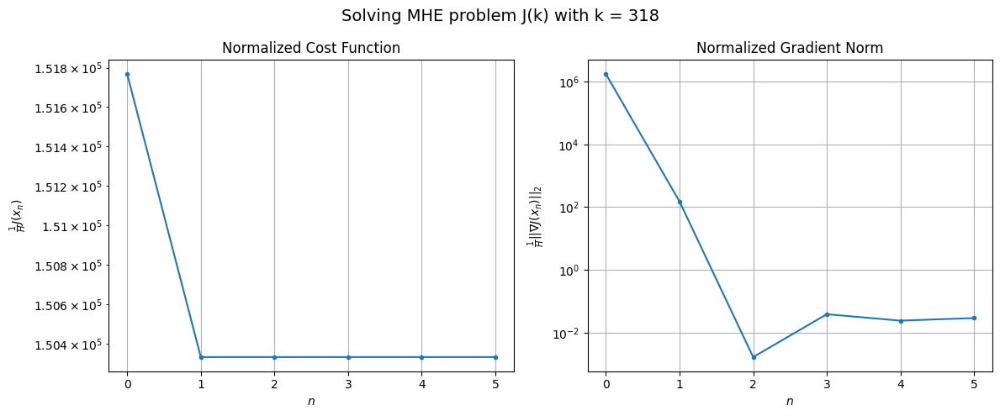

Windows:  74%|███████▍  | 220/296 [1:02:29<19:04, 15.05s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15338220.12202463
Gradient norm: 175565519.28563872
Global estimation error: 235.44069601123059
Initial conditions estimation errors: 116.83509206600854 m, 118.32702352979824 m, 117.31621182350017 m, 118.39534786059131 m
Position estimation errors: 145.70830129220678 m, 144.79086385557574 m, 145.68439984519594 m, 144.2412588824746 m

[Gauss-Newton] Iteration 1
Cost function: 15189170.29666331 (-0.97%)
Gradient norm: 15978.478293007971 (-99.99%)
Global estimation error: 253.92031024807085 (7.85%)
Initial conditions estimation errors: 126.16267391822352 m, 127.37901644399173 m, 126.49847476078688 m, 127.79346880606913 m
Position estimation errors: 133.47938957794665 m, 132.76313266420652 m, 133.62532465074187 m, 132.0773644554533 m

[Gauss-Newton] Iteration 2
Cost function: 15189170.296611652 (-0.00%)
Gradient norm: 0.5501415836207355 (-100.00%)
Global estimation error: 253.92031466091166 (0.00%)
Initial conditions estimation er

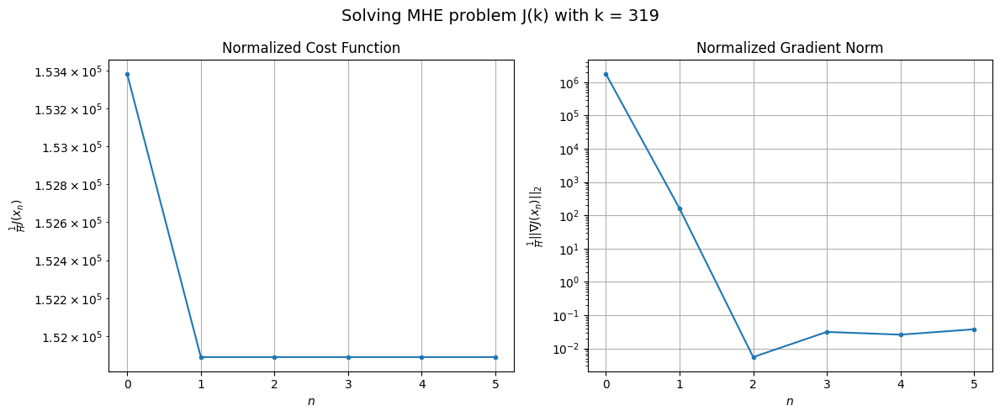

Windows:  75%|███████▍  | 221/296 [1:02:43<18:16, 14.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15448142.911310418
Gradient norm: 176447716.0353835
Global estimation error: 240.4820566849928
Initial conditions estimation errors: 119.45153451703473 m, 120.63836525783843 m, 119.78624985022093 m, 121.08069587098973 m
Position estimation errors: 145.2056750025543 m, 144.55218207870274 m, 145.3645316000909 m, 143.83328203896244 m

[Gauss-Newton] Iteration 1
Cost function: 15294225.672198229 (-1.00%)
Gradient norm: 16865.24210078608 (-99.99%)
Global estimation error: 259.4893885454871 (7.90%)
Initial conditions estimation errors: 129.0581396748729 m, 130.19164825245127 m, 129.30521400983446 m, 130.41844491638946 m
Position estimation errors: 132.7518819269545 m, 132.08471675478103 m, 132.94410260855773 m, 131.5382791728621 m

[Gauss-Newton] Iteration 2
Cost function: 15294225.671247538 (-0.00%)
Gradient norm: 5.549963122374666 (-99.97%)
Global estimation error: 259.4893604481357 (-0.00%)
Initial conditions estimation errors: 1

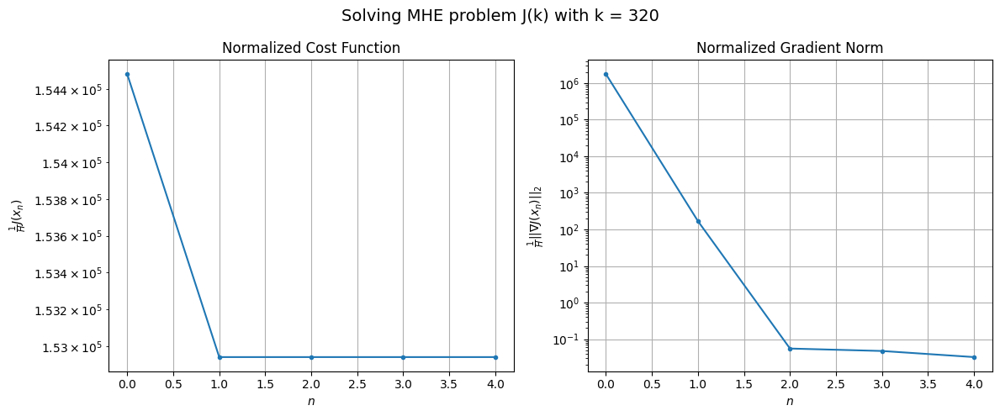

Windows:  75%|███████▌  | 222/296 [1:02:54<16:50, 13.65s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15496072.023581138
Gradient norm: 176047359.9248554
Global estimation error: 244.8750344744463
Initial conditions estimation errors: 121.75422101858854 m, 122.85725737733755 m, 122.004126257034 m, 123.12885238138253 m
Position estimation errors: 144.013946359242 m, 143.40519319979552 m, 144.21352707011712 m, 142.830977926667 m

[Gauss-Newton] Iteration 1
Cost function: 15338976.327053428 (-1.01%)
Gradient norm: 17570.14034833969 (-99.99%)
Global estimation error: 264.43187907770243 (7.99%)
Initial conditions estimation errors: 131.57940690133174 m, 132.52284380681485 m, 131.76920873526097 m, 132.98711585682034 m
Position estimation errors: 131.4105380480012 m, 130.85776554011434 m, 131.59232065243694 m, 130.24702165990828 m

[Gauss-Newton] Iteration 2
Cost function: 15338976.325306332 (-0.00%)
Gradient norm: 7.55435626200474 (-99.96%)
Global estimation error: 264.43185851846215 (-0.00%)
Initial conditions estimation errors: 13

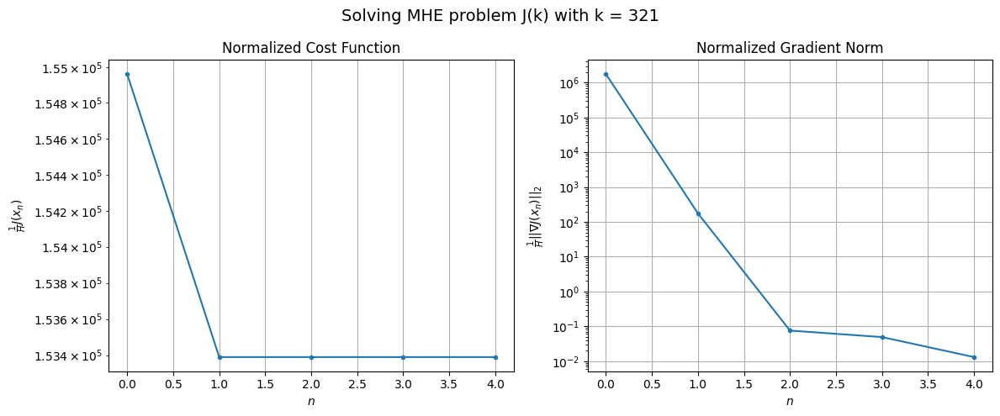

Windows:  75%|███████▌  | 223/296 [1:03:06<15:48, 13.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15481840.765239732
Gradient norm: 175290601.5846116
Global estimation error: 248.59278002691443
Initial conditions estimation errors: 123.65825184089573 m, 124.57161713954333 m, 123.85326311373227 m, 125.09681118822313 m
Position estimation errors: 142.10464433990538 m, 141.60475889910296 m, 142.29205155944283 m, 140.97917201811225 m

[Gauss-Newton] Iteration 1
Cost function: 15322889.76256562 (-1.03%)
Gradient norm: 18108.479454930468 (-99.99%)
Global estimation error: 268.47143757724183 (8.00%)
Initial conditions estimation errors: 133.63646214312126 m, 134.49087855812525 m, 133.77989638783072 m, 135.03059910681426 m
Position estimation errors: 129.39725458932776 m, 128.9151899320493 m, 129.5725992904067 m, 128.29808014008506 m

[Gauss-Newton] Iteration 2
Cost function: 15322889.76430077 (0.00%)
Gradient norm: 7.722705218234555 (-99.96%)
Global estimation error: 268.47144792429265 (0.00%)
Initial conditions estimation errors

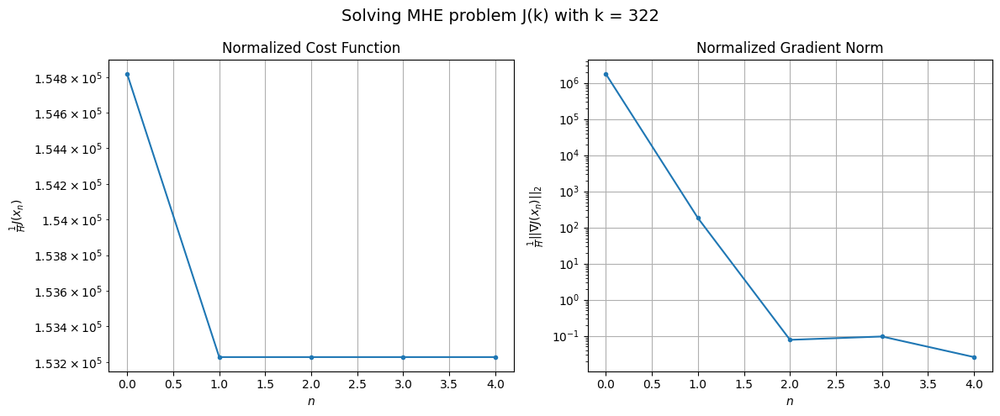

Windows:  76%|███████▌  | 224/296 [1:03:17<14:58, 12.48s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15403614.383854756
Gradient norm: 174258805.7774352
Global estimation error: 251.50986624118266
Initial conditions estimation errors: 125.15067163650603 m, 125.98353425657919 m, 125.30170839635043 m, 126.57830400007043 m
Position estimation errors: 139.48086582887845 m, 139.0552670240859 m, 139.66455055843622 m, 138.42201466601577 m

[Gauss-Newton] Iteration 1
Cost function: 15243741.212295871 (-1.04%)
Gradient norm: 18513.595163802245 (-99.99%)
Global estimation error: 271.47339267631116 (7.94%)
Initial conditions estimation errors: 135.23305672467663 m, 135.98748083860033 m, 135.61891840384195 m, 136.10524339802157 m
Position estimation errors: 126.70164704488475 m, 126.19123798518962 m, 126.61416791478248 m, 125.91780237233985 m

[Gauss-Newton] Iteration 2
Cost function: 15243741.213321554 (0.00%)
Gradient norm: 1.9779894480991347 (-99.99%)
Global estimation error: 271.47325764158154 (-0.00%)
Initial conditions estimation e

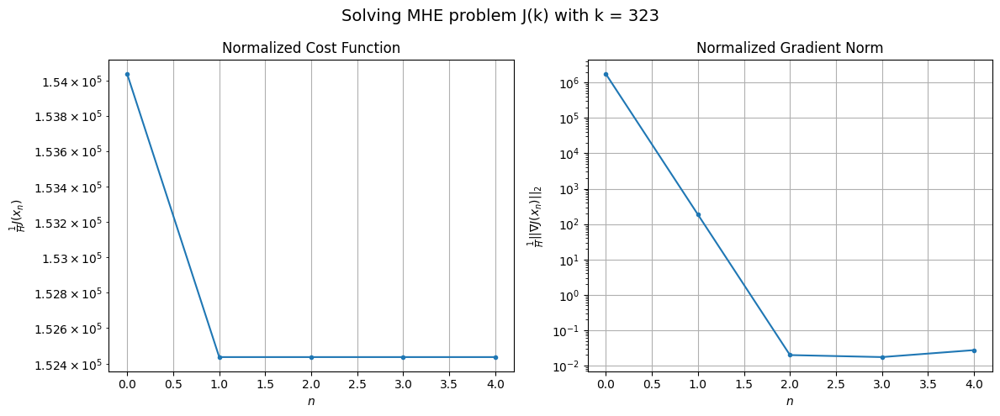

Windows:  76%|███████▌  | 225/296 [1:03:29<14:22, 12.15s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15257973.66869513
Gradient norm: 172493251.5535557
Global estimation error: 253.54485031942613
Initial conditions estimation errors: 126.27483873002564 m, 126.99263698191895 m, 126.64508088879774 m, 127.17490135820904 m
Position estimation errors: 136.2209670291672 m, 135.74905814778091 m, 136.13791259165265 m, 135.4516419627165 m

[Gauss-Newton] Iteration 1
Cost function: 15099138.236590872 (-1.04%)
Gradient norm: 18646.81327997183 (-99.99%)
Global estimation error: 273.7223626672157 (7.96%)
Initial conditions estimation errors: 136.36874716715383 m, 137.05021732395943 m, 136.69948159700758 m, 137.32398713472324 m
Position estimation errors: 123.43167077648003 m, 122.97699838602774 m, 123.34901814753415 m, 122.64417268842905 m

[Gauss-Newton] Iteration 2
Cost function: 15099138.235385992 (-0.00%)
Gradient norm: 1.4391339609271498 (-99.99%)
Global estimation error: 273.7223285572548 (-0.00%)
Initial conditions estimation error

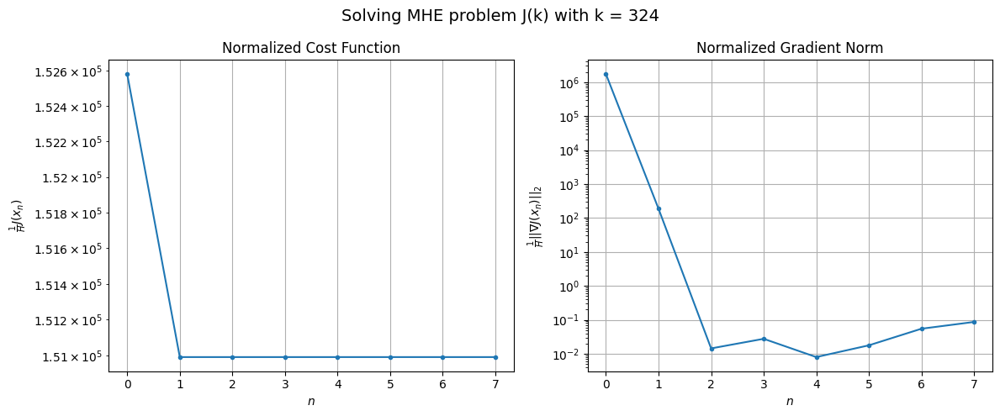

Windows:  76%|███████▋  | 226/296 [1:03:47<16:30, 14.15s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 15046662.985880896
Gradient norm: 170453217.37836775
Global estimation error: 255.069225388527
Initial conditions estimation errors: 127.0534853718753 m, 127.6900348717706 m, 127.36994017401206 m, 128.0225567268162 m
Position estimation errors: 132.48249467132692 m, 132.06153359933475 m, 132.4075265535485 m, 131.70239032193388 m

[Gauss-Newton] Iteration 1
Cost function: 14890056.115922274 (-1.04%)
Gradient norm: 18556.828913889174 (-99.99%)
Global estimation error: 275.3094728745769 (7.94%)
Initial conditions estimation errors: 137.0875403023388 m, 137.72704863182247 m, 137.50481990695593 m, 138.2963553928001 m
Position estimation errors: 119.71345711195113 m, 119.22358753924236 m, 119.43417259980478 m, 118.77880672556427 m

[Gauss-Newton] Iteration 2
Cost function: 14890056.115680363 (-0.00%)
Gradient norm: 1.6082397378573423 (-99.99%)
Global estimation error: 275.3093928456978 (-0.00%)
Initial conditions estimation errors: 

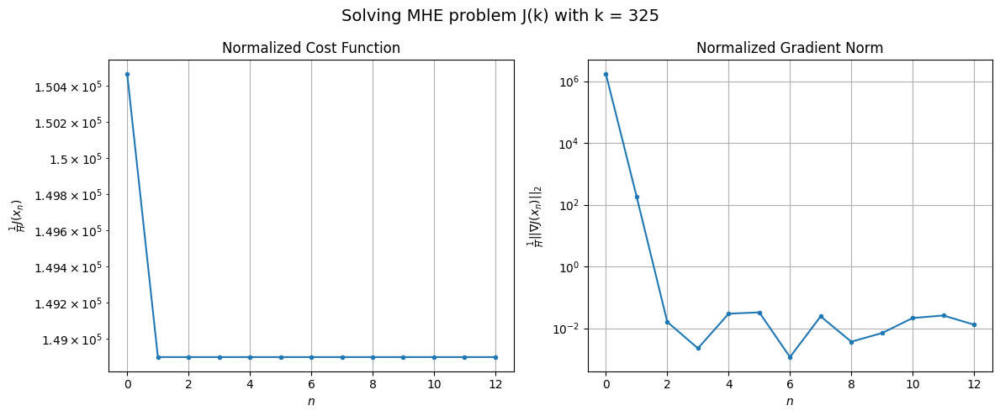

Windows:  77%|███████▋  | 227/296 [1:04:19<22:10, 19.28s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14775447.694571598
Gradient norm: 168358734.4558859
Global estimation error: 256.19857218718374
Initial conditions estimation errors: 127.55106120624326 m, 128.14220624958824 m, 127.937307569101 m, 128.7631664799196 m
Position estimation errors: 128.3717067195967 m, 127.90637189658075 m, 128.09133361161818 m, 127.43540529513318 m

[Gauss-Newton] Iteration 1
Cost function: 14622345.886014732 (-1.04%)
Gradient norm: 18288.554816285385 (-99.99%)
Global estimation error: 275.97798566432675 (7.72%)
Initial conditions estimation errors: 137.45763276000912 m, 138.0033130741219 m, 137.78199788204756 m, 138.70954249277258 m
Position estimation errors: 115.66555286992896 m, 115.27715133670566 m, 115.46831493656654 m, 114.71798663144446 m

[Gauss-Newton] Iteration 2
Cost function: 14622345.882771302 (-0.00%)
Gradient norm: 7.134160610303992 (-99.96%)
Global estimation error: 275.9779990181256 (0.00%)
Initial conditions estimation errors:

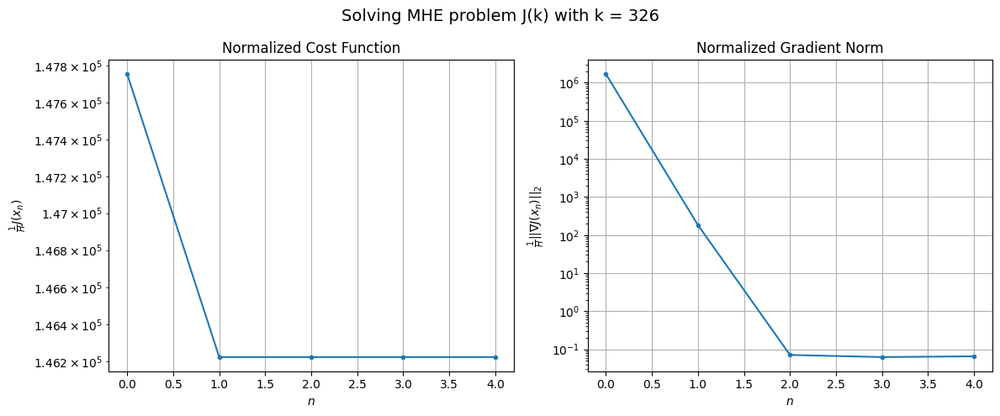

Windows:  77%|███████▋  | 228/296 [1:04:31<19:39, 17.35s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14447110.095880669
Gradient norm: 166092386.37082255
Global estimation error: 256.6938262475441
Initial conditions estimation errors: 127.84112408507568 m, 128.33230040500433 m, 128.13957997978466 m, 129.07104308544865 m
Position estimation errors: 123.96860227420991 m, 123.60445289243705 m, 123.77167133636499 m, 123.01856818075971 m

[Gauss-Newton] Iteration 1
Cost function: 14298498.120837906 (-1.03%)
Gradient norm: 17767.523361136824 (-99.99%)
Global estimation error: 276.0126578098962 (7.53%)
Initial conditions estimation errors: 137.55546460908965 m, 137.91674959858037 m, 137.9668506401024 m, 138.58384901840105 m
Position estimation errors: 111.3521173622367 m, 111.01940177893593 m, 111.12845230028742 m, 110.51739865776564 m

[Gauss-Newton] Iteration 2
Cost function: 14298498.120946568 (0.00%)
Gradient norm: 0.8928062766186526 (-99.99%)
Global estimation error: 276.0127247369824 (0.00%)
Initial conditions estimation error

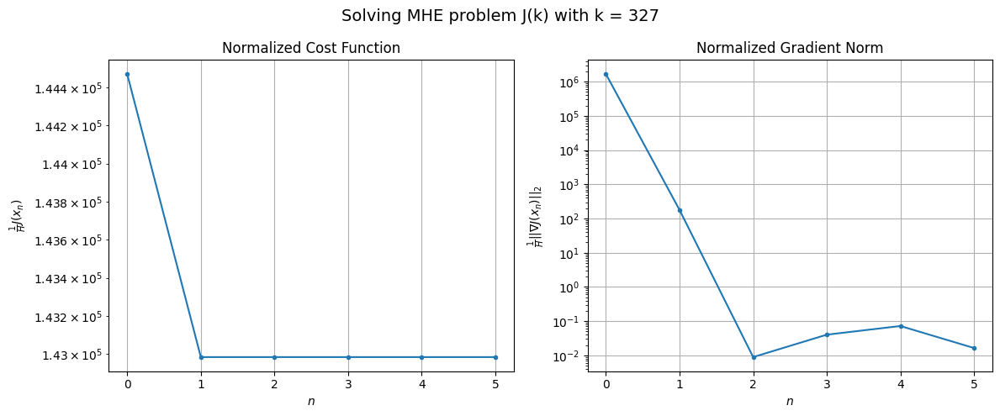

Windows:  77%|███████▋  | 229/296 [1:04:47<18:51, 16.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 14066401.13545958
Gradient norm: 163990494.24144462
Global estimation error: 256.7628785611814
Initial conditions estimation errors: 127.97027029535288 m, 128.25339258611976 m, 128.35055004313404 m, 128.94917450635754 m
Position estimation errors: 119.3187974576452 m, 119.00074414911056 m, 119.09669020408842 m, 118.47488508488874 m

[Gauss-Newton] Iteration 1
Cost function: 13922740.33731285 (-1.02%)
Gradient norm: 17154.045991355517 (-99.99%)
Global estimation error: 275.22665794341697 (7.19%)
Initial conditions estimation errors: 137.45707477006795 m, 137.2556116450633 m, 137.75285340231366 m, 137.9862341632726 m
Position estimation errors: 106.80992447566159 m, 106.80171861180143 m, 106.6513325942297 m, 106.30809990160212 m

[Gauss-Newton] Iteration 2
Cost function: 13922740.335359272 (-0.00%)
Gradient norm: 1.7539072197543981 (-99.99%)
Global estimation error: 275.2264255475954 (-0.00%)
Initial conditions estimation errors

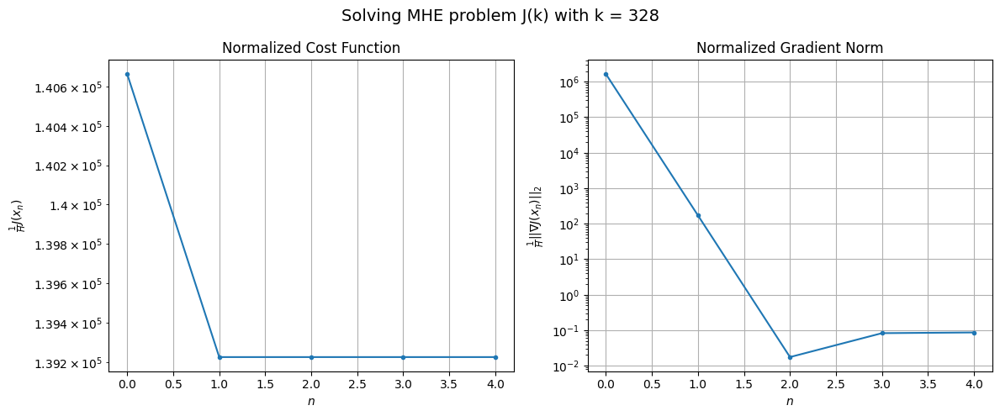

Windows:  78%|███████▊  | 230/296 [1:04:59<16:55, 15.39s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13633310.682657462
Gradient norm: 160968497.2970343
Global estimation error: 256.15153733411074
Initial conditions estimation errors: 127.95556772678663 m, 127.68092322091994 m, 128.22325736697573 m, 128.44167596334796 m
Position estimation errors: 114.44865246742609 m, 114.44432697771434 m, 114.2924383502468 m, 113.93080293629161 m

[Gauss-Newton] Iteration 1
Cost function: 13495905.851945432 (-1.01%)
Gradient norm: 16349.239496695489 (-99.99%)
Global estimation error: 274.3219945538574 (7.09%)
Initial conditions estimation errors: 137.16314056889289 m, 136.86004462330766 m, 137.4461244281631 m, 137.17365122708205 m
Position estimation errors: 102.11664691666633 m, 102.14908299745092 m, 101.9285976627302 m, 101.98117242043493 m

[Gauss-Newton] Iteration 2
Cost function: 13495905.850814942 (-0.00%)
Gradient norm: 3.257284243295569 (-99.98%)
Global estimation error: 274.32188550375935 (-0.00%)
Initial conditions estimation erro

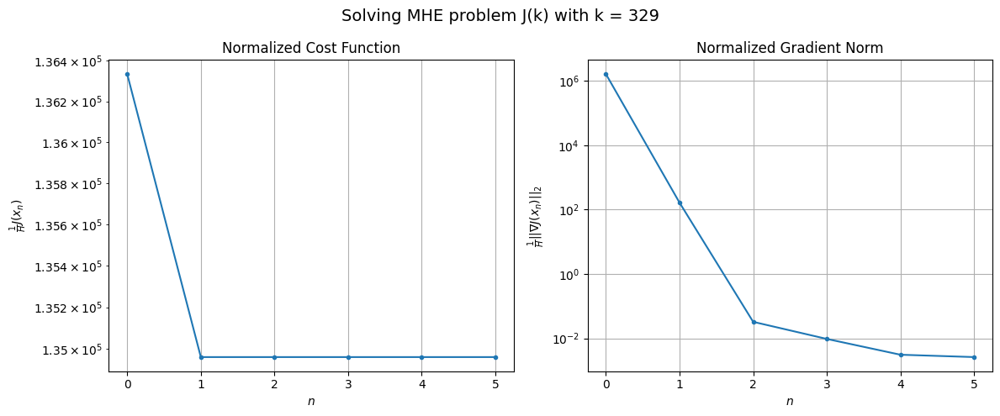

Windows:  78%|███████▊  | 231/296 [1:05:12<15:47, 14.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 13154762.168619817
Gradient norm: 157953487.79463804
Global estimation error: 255.40622133861058
Initial conditions estimation errors: 127.73568702086557 m, 127.3663536835229 m, 127.9875965289264 m, 127.72166802633897 m
Position estimation errors: 109.42551072489667 m, 109.4522121308481 m, 109.2348692586064 m, 109.2661859739262 m

[Gauss-Newton] Iteration 1
Cost function: 13023998.73311597 (-0.99%)
Gradient norm: 15494.746305347424 (-99.99%)
Global estimation error: 273.0545920727654 (6.91%)
Initial conditions estimation errors: 136.63806264255368 m, 136.23000918930836 m, 136.65494150614987 m, 136.58533623008003 m
Position estimation errors: 97.29908577678081 m, 97.38592257582962 m, 97.26120360135216 m, 97.23083040776065 m

[Gauss-Newton] Iteration 2
Cost function: 13023998.735150516 (0.00%)
Gradient norm: 0.8143870790634474 (-99.99%)
Global estimation error: 273.0545135356006 (-0.00%)
Initial conditions estimation errors: 136

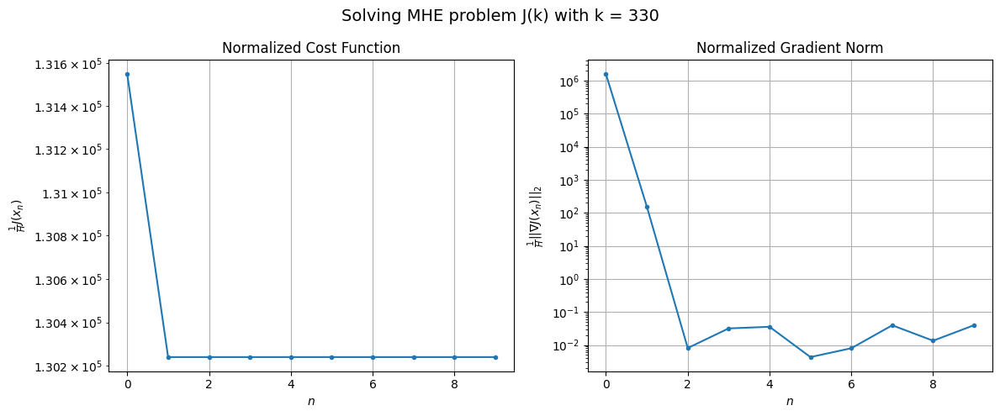

Windows:  78%|███████▊  | 232/296 [1:05:34<17:55, 16.81s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12633770.721856194
Gradient norm: 154214352.49339566
Global estimation error: 254.20017003461692
Initial conditions estimation errors: 127.23205731260884 m, 126.76846513312672 m, 127.23019990509805 m, 127.16866085767002 m
Position estimation errors: 104.27449977420643 m, 104.35521641329508 m, 104.23518270030118 m, 104.18742224234367 m

[Gauss-Newton] Iteration 1
Cost function: 12510251.80493511 (-0.98%)
Gradient norm: 14554.452678438643 (-99.99%)
Global estimation error: 271.1770401969186 (6.68%)
Initial conditions estimation errors: 135.80649722211518 m, 135.33836266257066 m, 135.55735064872835 m, 135.65105259179754 m
Position estimation errors: 92.4132055644726 m, 92.65931551076031 m, 92.55463843892835 m, 92.44324682684788 m

[Gauss-Newton] Iteration 2
Cost function: 12510251.803381825 (-0.00%)
Gradient norm: 3.514066773621741 (-99.98%)
Global estimation error: 271.17678783531534 (-0.00%)
Initial conditions estimation errors

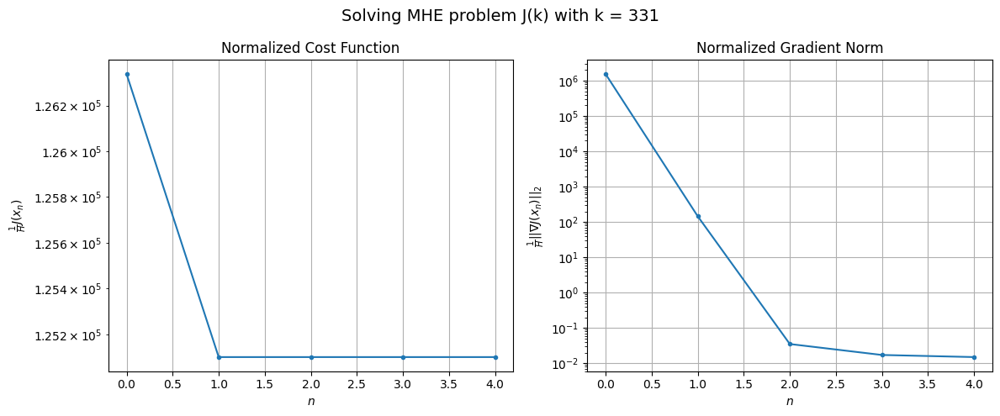

Windows:  79%|███████▊  | 233/296 [1:05:45<15:54, 15.15s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 12074878.703215249
Gradient norm: 150255836.97679082
Global estimation error: 252.28276756676095
Initial conditions estimation errors: 126.37077065631453 m, 125.86648082326276 m, 126.11438629669581 m, 126.21299109193053 m
Position estimation errors: 99.05583408207568 m, 99.30152781163946 m, 99.19428089639926 m, 99.07267247473682 m

[Gauss-Newton] Iteration 1
Cost function: 11958742.015617264 (-0.96%)
Gradient norm: 13526.710339681453 (-99.99%)
Global estimation error: 269.3450084177253 (6.76%)
Initial conditions estimation errors: 134.6037873700742 m, 134.7011296161004 m, 134.2570243059219 m, 135.1262521079685 m
Position estimation errors: 87.49969911638912 m, 87.38315167634288 m, 87.61450497685173 m, 87.07842304702659 m

[Gauss-Newton] Iteration 2
Cost function: 11958742.015835293 (0.00%)
Gradient norm: 1.3187332526719793 (-99.99%)
Global estimation error: 269.3446534704709 (-0.00%)
Initial conditions estimation errors: 134.6

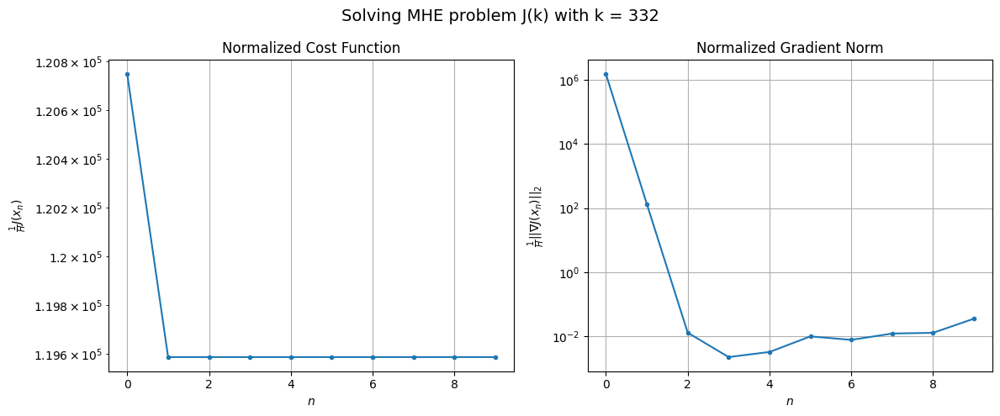

Windows:  79%|███████▉  | 234/296 [1:06:06<17:34, 17.00s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 11493883.259504223
Gradient norm: 146234417.9069379
Global estimation error: 250.34404882199237
Initial conditions estimation errors: 125.12256316820687 m, 125.17344311176986 m, 124.76702591367889 m, 125.62320613098979 m
Position estimation errors: 93.80583171487244 m, 93.69773419278506 m, 93.90847782774655 m, 93.38607872354874 m

[Gauss-Newton] Iteration 1
Cost function: 11385670.270073645 (-0.94%)
Gradient norm: 12556.349506052396 (-99.99%)
Global estimation error: 266.0094778850105 (6.26%)
Initial conditions estimation errors: 132.99041885358582 m, 133.09081956570384 m, 132.4724131907443 m, 133.46301761859922 m
Position estimation errors: 82.63334498797646 m, 82.53330945086776 m, 82.88736730931168 m, 82.32981704623431 m

[Gauss-Newton] Iteration 2
Cost function: 11385670.270962773 (0.00%)
Gradient norm: 0.9899223535674512 (-99.99%)
Global estimation error: 266.00936670446254 (-0.00%)
Initial conditions estimation errors: 13

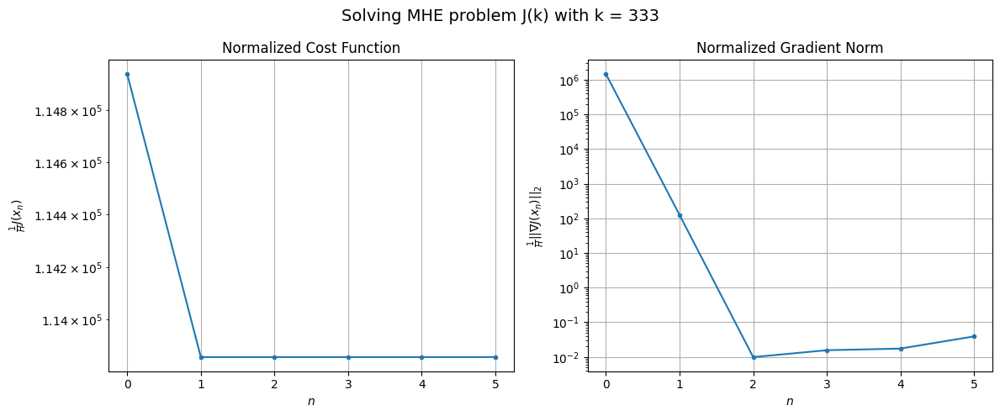

Windows:  79%|███████▉  | 235/296 [1:06:20<16:15, 15.99s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10893550.915963778
Gradient norm: 141623282.6909341
Global estimation error: 246.93690325233777
Initial conditions estimation errors: 123.46792084607482 m, 123.52469504013038 m, 122.95238470025971 m, 123.9264757263482 m
Position estimation errors: 88.62441277894091 m, 88.53187528880129 m, 88.86317172554021 m, 88.32252478406116 m

[Gauss-Newton] Iteration 1
Cost function: 10793361.741392365 (-0.92%)
Gradient norm: 11538.350833583685 (-99.99%)
Global estimation error: 262.17113100453713 (6.17%)
Initial conditions estimation errors: 130.9620095510122 m, 131.35361259578366 m, 130.48863771845245 m, 131.53512924575 m
Position estimation errors: 77.90555921510442 m, 77.6378439366668 m, 78.12547797353534 m, 77.61853575443864 m

[Gauss-Newton] Iteration 2
Cost function: 10793361.741183732 (-0.00%)
Gradient norm: 5.459667765285616 (-99.95%)
Global estimation error: 262.1709111340087 (-0.00%)
Initial conditions estimation errors: 130.961

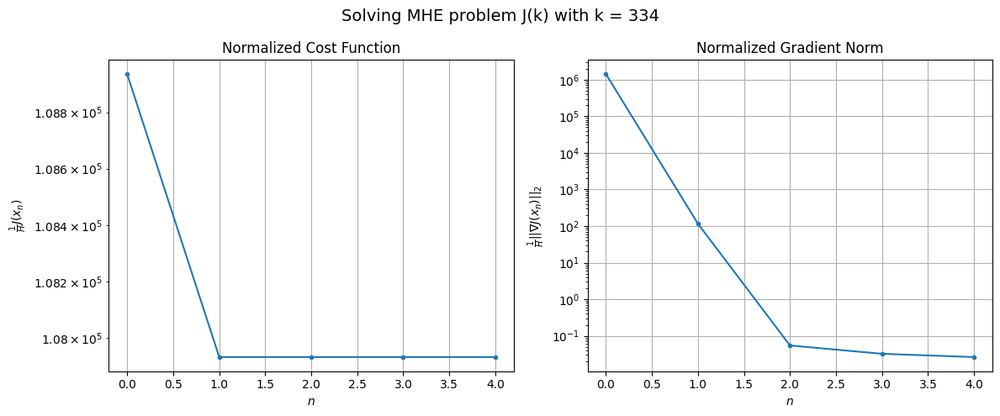

Windows:  80%|███████▉  | 236/296 [1:06:33<14:58, 14.98s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 10287958.807020022
Gradient norm: 136480711.23942313
Global estimation error: 242.96466230925395
Initial conditions estimation errors: 121.37147059125381 m, 121.71594526582813 m, 120.90192105681083 m, 121.93707060008157 m
Position estimation errors: 83.67328315967 m, 83.41622057896737 m, 83.88256448533171 m, 83.38566372792005 m

[Gauss-Newton] Iteration 1
Cost function: 10196585.06233384 (-0.89%)
Gradient norm: 10428.56970141512 (-99.99%)
Global estimation error: 257.10194436748384 (5.82%)
Initial conditions estimation errors: 128.4524604975181 m, 128.79153864087462 m, 128.0478925488313 m, 128.9098239756683 m
Position estimation errors: 73.52335037980136 m, 73.29464542489839 m, 73.69030016001088 m, 73.33652712453218 m

[Gauss-Newton] Iteration 2
Cost function: 10196585.063266924 (0.00%)
Gradient norm: 1.0960800198174707 (-99.99%)
Global estimation error: 257.1020206708983 (0.00%)
Initial conditions estimation errors: 128.45244

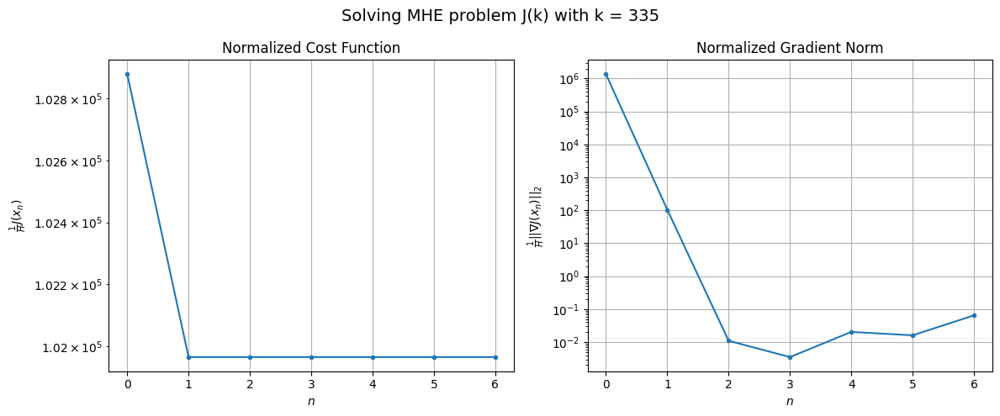

Windows:  80%|████████  | 237/296 [1:06:50<15:24, 15.67s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 9684791.047339978
Gradient norm: 131376203.59661356
Global estimation error: 237.63696504918906
Initial conditions estimation errors: 118.72957870455355 m, 119.02576977397075 m, 118.32614839305812 m, 119.19018861199679 m
Position estimation errors: 79.18007797367025 m, 78.9527816861267 m, 79.33614358577276 m, 78.98305762817485 m

[Gauss-Newton] Iteration 1
Cost function: 9601486.463145493 (-0.86%)
Gradient norm: 9414.114537875706 (-99.99%)
Global estimation error: 251.35114915792946 (5.77%)
Initial conditions estimation errors: 125.42193052013792 m, 125.93072311477565 m, 125.14092084124432 m, 126.20550603657782 m
Position estimation errors: 69.6502472979302 m, 69.52003364849364 m, 69.8049263181939 m, 69.4226627727562 m

[Gauss-Newton] Iteration 2
Cost function: 9601486.462026244 (-0.00%)
Gradient norm: 0.3983986417112286 (-100.00%)
Global estimation error: 251.35075938782785 (-0.00%)
Initial conditions estimation errors: 125.4

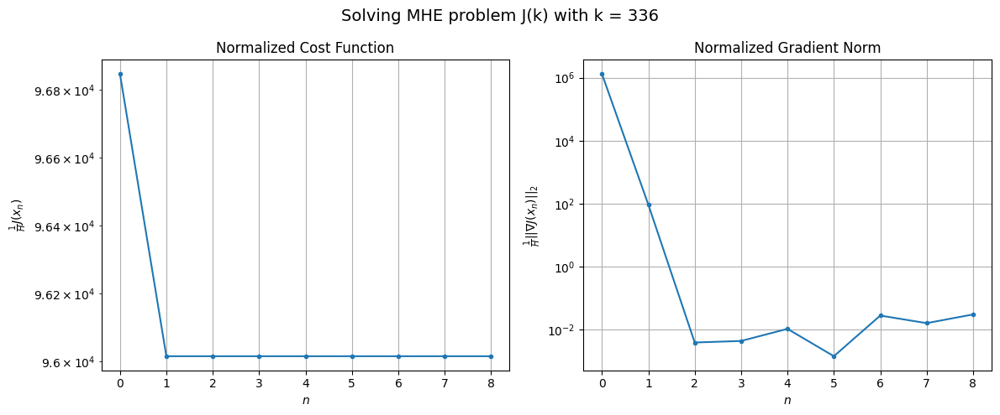

Windows:  80%|████████  | 238/296 [1:07:09<16:09, 16.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 9096849.051165888
Gradient norm: 125673459.77582489
Global estimation error: 231.52807591763724
Initial conditions estimation errors: 115.51983776225863 m, 115.99294594688875 m, 115.23511020993513 m, 116.3048434510468 m
Position estimation errors: 75.17668681520905 m, 75.06482789523517 m, 75.33095065718331 m, 74.96940659769591 m

[Gauss-Newton] Iteration 1
Cost function: 9022046.12536907 (-0.82%)
Gradient norm: 8362.440905118554 (-99.99%)
Global estimation error: 243.91900594188667 (5.35%)
Initial conditions estimation errors: 121.79869210446405 m, 122.17823574143502 m, 121.43747341701481 m, 122.42084056842683 m
Position estimation errors: 66.38257955869348 m, 66.26671280380363 m, 66.53187885702577 m, 66.2073638954698 m

[Gauss-Newton] Iteration 2
Cost function: 9022046.126502948 (0.00%)
Gradient norm: 0.8744634637933651 (-99.99%)
Global estimation error: 243.91895364257115 (-0.00%)
Initial conditions estimation errors: 121.79

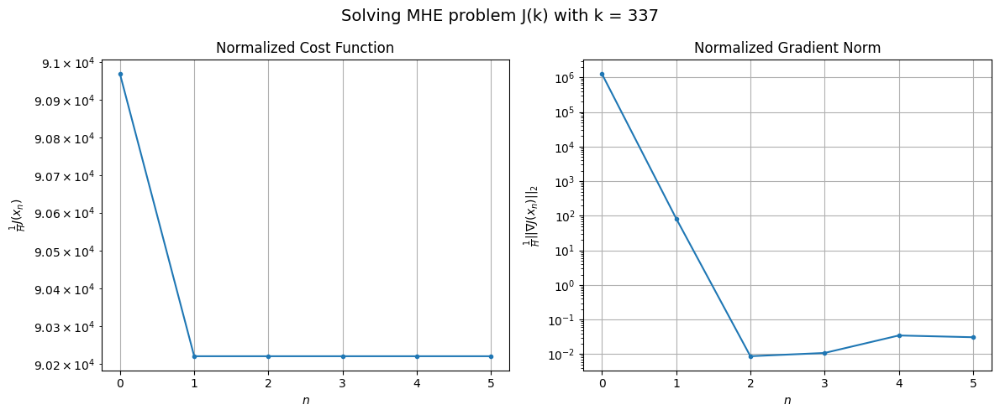

Windows:  81%|████████  | 239/296 [1:07:23<15:00, 15.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8536451.326375578
Gradient norm: 120111718.65706237
Global estimation error: 223.79687517152828
Initial conditions estimation errors: 111.7498938823738 m, 112.09126833044105 m, 111.38481561025488 m, 112.36486931183487 m
Position estimation errors: 71.57558823201973 m, 71.47140759767623 m, 71.71004938993944 m, 71.43581055664627 m

[Gauss-Newton] Iteration 1
Cost function: 8469677.512610616 (-0.78%)
Gradient norm: 7362.0528542124375 (-99.99%)
Global estimation error: 235.3613551145866 (5.17%)
Initial conditions estimation errors: 117.61441749710987 m, 117.89999564926676 m, 117.15550842038347 m, 118.05030829099523 m
Position estimation errors: 63.553098498725774 m, 63.549328461623055 m, 63.74494595997475 m, 63.527626854649874 m

[Gauss-Newton] Iteration 2
Cost function: 8469677.514553575 (0.00%)
Gradient norm: 6.288724048467243 (-99.91%)
Global estimation error: 235.36121036760048 (-0.00%)
Initial conditions estimation errors: 11

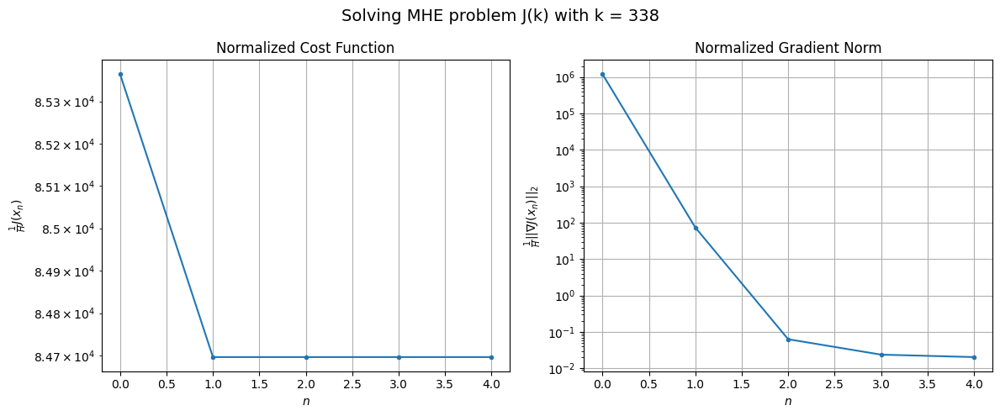

Windows:  81%|████████  | 240/296 [1:07:35<13:36, 14.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8011085.224800749
Gradient norm: 113469776.94919348
Global estimation error: 215.1474426835575
Initial conditions estimation errors: 107.51807868023425 m, 107.77133632933491 m, 107.05888326393885 m, 107.94401342221948 m
Position estimation errors: 68.15624944536864 m, 68.16477466704936 m, 68.32328253041659 m, 68.18206630142475 m

[Gauss-Newton] Iteration 1
Cost function: 7952570.16924845 (-0.73%)
Gradient norm: 6355.642880080501 (-99.99%)
Global estimation error: 225.49824376018074 (4.81%)
Initial conditions estimation errors: 112.94388360096818 m, 112.84648080007015 m, 112.19575813872375 m, 113.00797447360361 m
Position estimation errors: 60.987637214200085 m, 61.07406192798383 m, 61.17044620668215 m, 61.08911228993973 m

[Gauss-Newton] Iteration 2
Cost function: 7952570.169595531 (0.00%)
Gradient norm: 1.8425767491312104 (-99.97%)
Global estimation error: 225.49825842869652 (0.00%)
Initial conditions estimation errors: 112.9

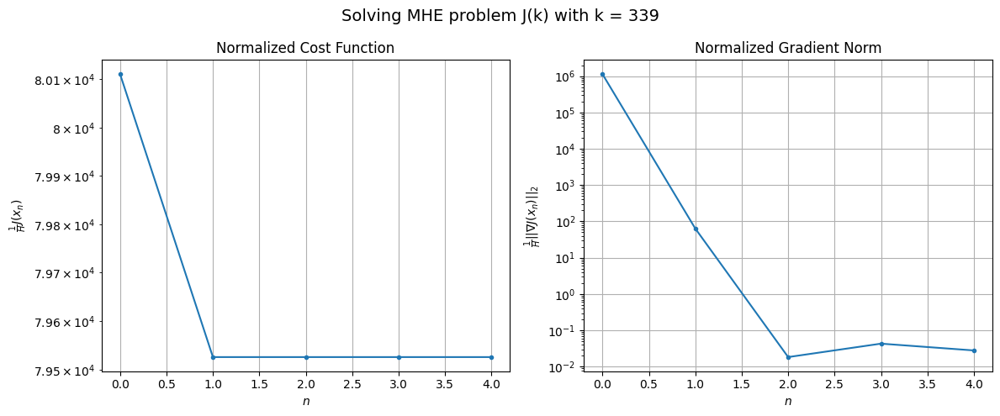

Windows:  81%|████████▏ | 241/296 [1:07:46<12:29, 13.62s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 7524163.139832574
Gradient norm: 105713239.28680906
Global estimation error: 205.42707351940786
Initial conditions estimation errors: 102.91107706299327 m, 102.79780187934665 m, 102.17135657989763 m, 102.97140941575022 m
Position estimation errors: 64.83608470591172 m, 64.92546899035247 m, 64.97901257792314 m, 64.98819017766935 m

[Gauss-Newton] Iteration 1
Cost function: 7473823.598092642 (-0.67%)
Gradient norm: 5381.528843404361 (-99.99%)
Global estimation error: 215.68945137448947 (5.00%)
Initial conditions estimation errors: 107.880801557832 m, 107.93582910183119 m, 107.28101604336486 m, 108.27832884305495 m
Position estimation errors: 58.5731151494801 m, 58.65975694205517 m, 58.67647008193677 m, 58.728048410434575 m

[Gauss-Newton] Iteration 2
Cost function: 7473823.598077116 (-0.00%)
Gradient norm: 2.247141393009439 (-99.96%)
Global estimation error: 215.68954454236146 (0.00%)
Initial conditions estimation errors: 107.88

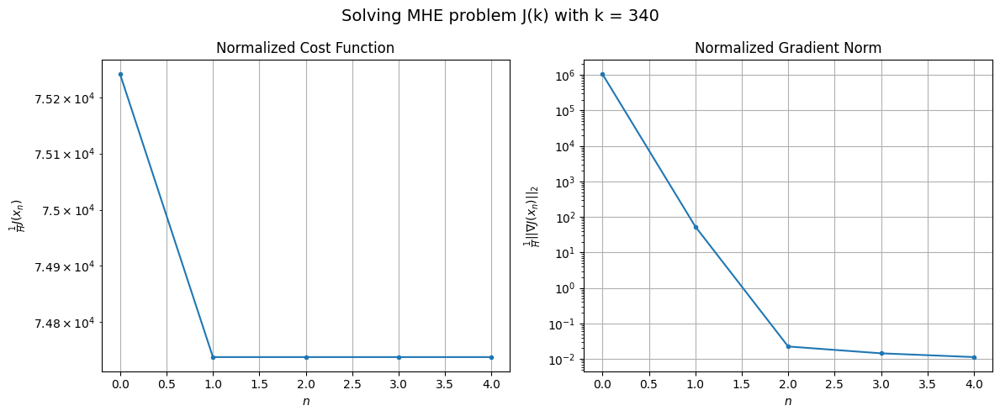

Windows:  82%|████████▏ | 242/296 [1:07:57<11:31, 12.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 7080564.137337917
Gradient norm: 97519918.59897412
Global estimation error: 195.90709681748763
Initial conditions estimation errors: 97.99918368130537 m, 98.031694904331 m, 97.40412709521911 m, 98.37616245439753 m
Position estimation errors: 61.59523835924429 m, 61.68556012180418 m, 61.654011965986236 m, 61.8136465532409 m

[Gauss-Newton] Iteration 1
Cost function: 7037757.641285568 (-0.60%)
Gradient norm: 4532.898818942899 (-100.00%)
Global estimation error: 205.1397630367901 (4.71%)
Initial conditions estimation errors: 102.52481017905912 m, 102.75327889492063 m, 102.02054135306814 m, 102.97789413890875 m
Position estimation errors: 56.254122202411416 m, 56.341568544605614 m, 56.2695744983194 m, 56.50905415837051 m

[Gauss-Newton] Iteration 2
Cost function: 7037757.641637954 (0.00%)
Gradient norm: 1.4277059917108643 (-99.97%)
Global estimation error: 205.13975422814582 (-0.00%)
Initial conditions estimation errors: 102.52480

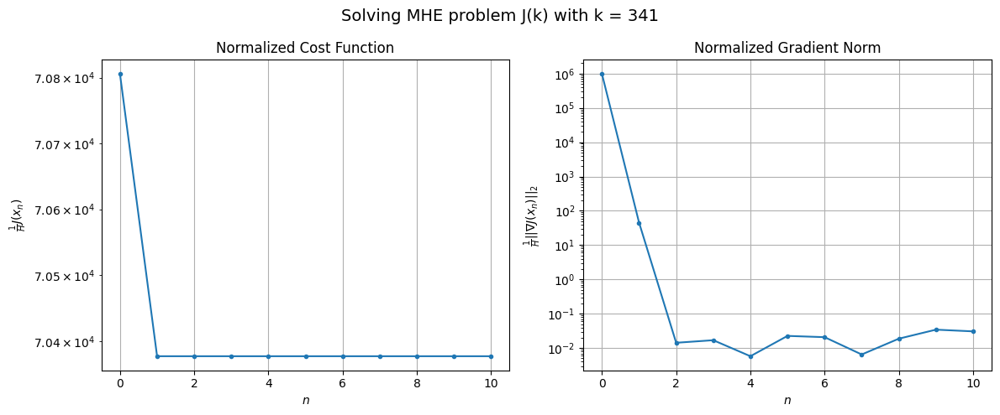

Windows:  82%|████████▏ | 243/296 [1:08:20<14:02, 15.90s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6682137.4942621775
Gradient norm: 88752075.25480422
Global estimation error: 185.7882455891851
Initial conditions estimation errors: 92.8621517807457 m, 93.06157429126283 m, 92.36002655292637 m, 93.28967005635813 m
Position estimation errors: 58.42627669170458 m, 58.516627986604306 m, 58.38978145607565 m, 58.74770112911798 m

[Gauss-Newton] Iteration 1
Cost function: 6646608.024061249 (-0.53%)
Gradient norm: 3716.6265548861948 (-100.00%)
Global estimation error: 193.68891406011542 (4.25%)
Initial conditions estimation errors: 96.92495624179394 m, 96.8200588247822 m, 96.35350327859658 m, 97.27651682583269 m
Position estimation errors: 54.02314105495946 m, 54.01848233063261 m, 53.97425848592065 m, 54.29495525417043 m

[Gauss-Newton] Iteration 2
Cost function: 6646608.023937561 (-0.00%)
Gradient norm: 2.4871834333312046 (-99.93%)
Global estimation error: 193.6889081233357 (-0.00%)
Initial conditions estimation errors: 96.92494868

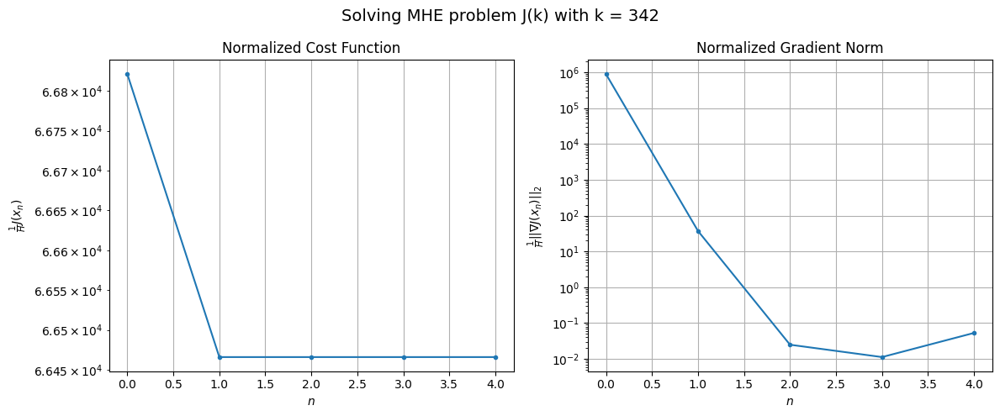

Windows:  82%|████████▏ | 244/296 [1:08:31<12:38, 14.58s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6328704.814535453
Gradient norm: 78389032.96831039
Global estimation error: 174.8929268844747
Initial conditions estimation errors: 87.53532328227463 m, 87.41654916006777 m, 86.97177837672845 m, 87.85935435407495 m
Position estimation errors: 55.388415935178266 m, 55.364324130568114 m, 55.27856349496904 m, 55.71061276300551 m

[Gauss-Newton] Iteration 1
Cost function: 6300298.519593774 (-0.45%)
Gradient norm: 2938.5735323657673 (-100.00%)
Global estimation error: 182.16613784240852 (4.16%)
Initial conditions estimation errors: 91.11137494115212 m, 90.98273581603866 m, 90.63767233642415 m, 91.59734464661348 m
Position estimation errors: 51.94812439603641 m, 51.87330306830877 m, 51.87557654399958 m, 52.34170338496846 m

[Gauss-Newton] Iteration 2
Cost function: 6300298.519269821 (-0.00%)
Gradient norm: 3.024243609165497 (-99.90%)
Global estimation error: 182.16621288178138 (0.00%)
Initial conditions estimation errors: 91.1113685

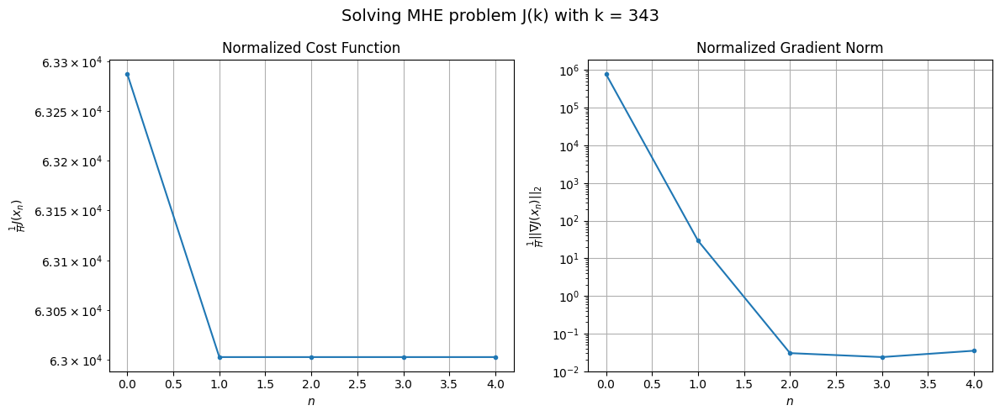

Windows:  83%|████████▎ | 245/296 [1:08:43<11:32, 13.59s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6024044.97071917
Gradient norm: 67965664.65626486
Global estimation error: 163.96392881924663
Initial conditions estimation errors: 82.02117321118 m, 81.87893175377027 m, 81.55304243251966 m, 82.47151636300677 m
Position estimation errors: 52.65007254693839 m, 52.5343062775201 m, 52.51602691908218 m, 53.08135514306631 m

[Gauss-Newton] Iteration 1
Cost function: 6001961.869341905 (-0.37%)
Gradient norm: 2277.524467387511 (-100.00%)
Global estimation error: 170.03966633724758 (3.71%)
Initial conditions estimation errors: 85.11522489507698 m, 85.07131603843098 m, 84.43202099883362 m, 85.45699807646284 m
Position estimation errors: 50.12911630673755 m, 50.077245456637094 m, 49.85244992041829 m, 50.50238774395217 m

[Gauss-Newton] Iteration 2
Cost function: 6001961.869140403 (-0.00%)
Gradient norm: 3.765414405891601 (-99.83%)
Global estimation error: 170.03945353869943 (-0.00%)
Initial conditions estimation errors: 85.115219681578

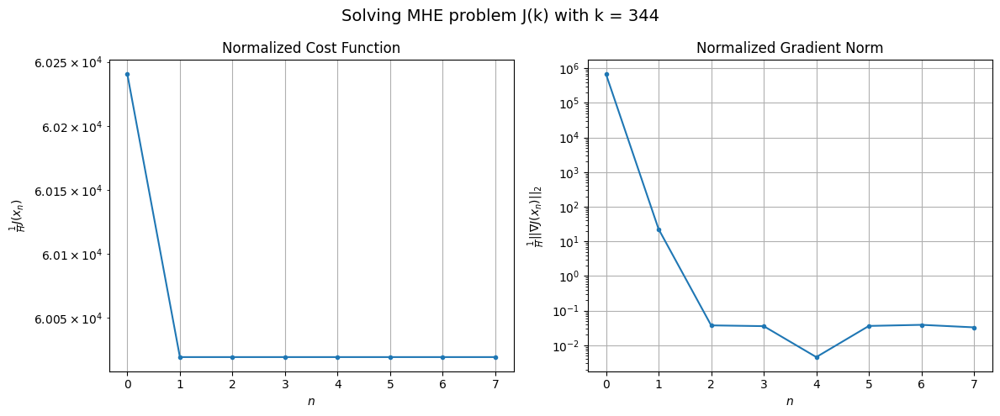

Windows:  83%|████████▎ | 246/296 [1:09:00<12:21, 14.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5767330.872477313
Gradient norm: 57302791.99009622
Global estimation error: 152.42700474752183
Initial conditions estimation errors: 76.31579986714054 m, 76.25815620057737 m, 75.64742667551964 m, 76.62876956164088 m
Position estimation errors: 50.39947518268279 m, 50.29645176042559 m, 50.03185900015716 m, 50.77219718305133 m

[Gauss-Newton] Iteration 1
Cost function: 5750851.941179978 (-0.29%)
Gradient norm: 1680.7136487611863 (-100.00%)
Global estimation error: 157.59151823454715 (3.39%)
Initial conditions estimation errors: 78.92662880079784 m, 78.84727686800149 m, 78.24148886182124 m, 79.16415339974897 m
Position estimation errors: 48.7301526564235 m, 48.571214357184 m, 48.42204689407694 m, 49.022489285705596 m

[Gauss-Newton] Iteration 2
Cost function: 5750851.941201157 (0.00%)
Gradient norm: 5.254897163234775 (-99.69%)
Global estimation error: 157.59151139663118 (-0.00%)
Initial conditions estimation errors: 78.9266247071

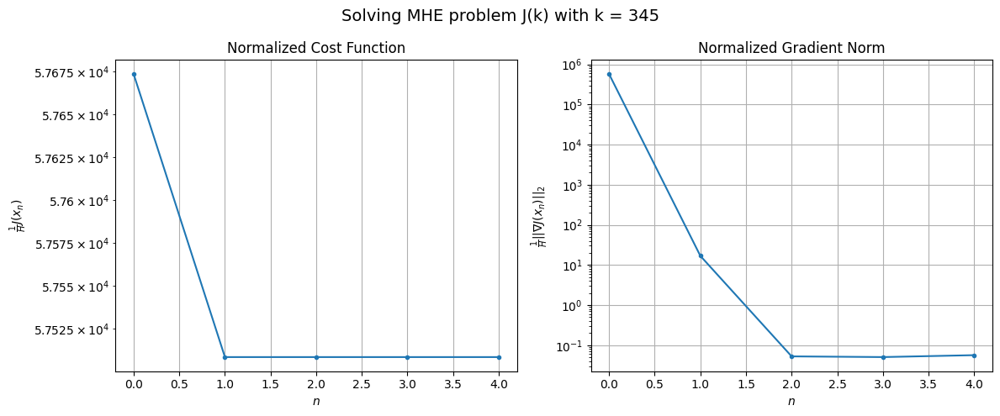

Windows:  83%|████████▎ | 247/296 [1:09:12<11:16, 13.80s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5559495.473845798
Gradient norm: 45787829.94562925
Global estimation error: 140.52301830717332
Initial conditions estimation errors: 70.39676007865188 m, 70.30815124448951 m, 69.72647830577591 m, 70.61104129956306 m
Position estimation errors: 48.86858593948832 m, 48.63164967489426 m, 48.45235798310825 m, 49.109952436799134 m

[Gauss-Newton] Iteration 1
Cost function: 5547959.561206535 (-0.21%)
Gradient norm: 1164.4071929312468 (-100.00%)
Global estimation error: 144.76979628608555 (3.02%)
Initial conditions estimation errors: 72.51721568837615 m, 72.46121660789524 m, 71.79988201076773 m, 72.75723275834663 m
Position estimation errors: 47.944459293837305 m, 47.70059093262275 m, 47.443658220073516 m, 48.15498861185058 m

[Gauss-Newton] Iteration 2
Cost function: 5547959.560707688 (-0.00%)
Gradient norm: 4.1979869656036515 (-99.64%)
Global estimation error: 144.7697448000035 (-0.00%)
Initial conditions estimation errors: 72.5172

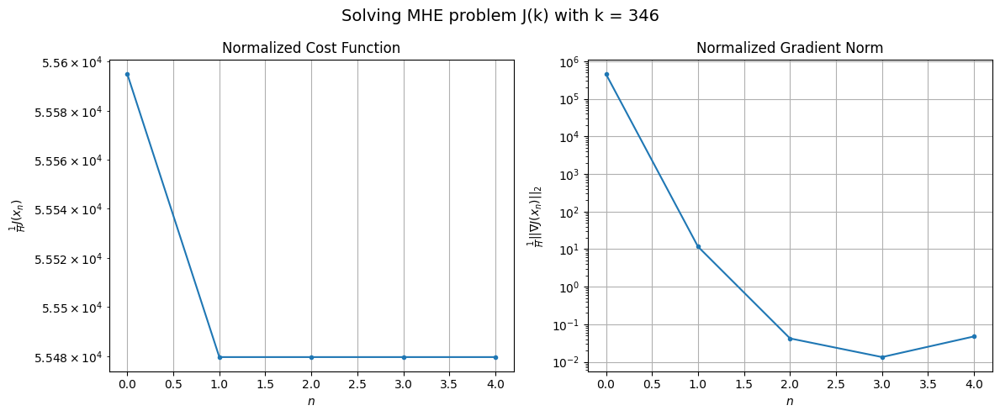

Windows:  84%|████████▍ | 248/296 [1:09:23<10:29, 13.12s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5402404.685378984
Gradient norm: 33947343.20052699
Global estimation error: 128.23716880708145
Initial conditions estimation errors: 64.25295042390013 m, 64.18882536678254 m, 63.560036740118434 m, 64.46838959056284 m
Position estimation errors: 48.3030470130926 m, 47.958603059838744 m, 47.696429423013576 m, 48.41618605311794 m

[Gauss-Newton] Iteration 1
Cost function: 5395022.104729143 (-0.14%)
Gradient norm: 713.3577278791699 (-100.00%)
Global estimation error: 131.90193012481708 (2.86%)
Initial conditions estimation errors: 65.87322613909726 m, 66.04864705969727 m, 65.40070243215172 m, 66.47620322460959 m
Position estimation errors: 47.94246041382853 m, 47.85644734865204 m, 47.59276473958242 m, 48.551305815354404 m

[Gauss-Newton] Iteration 2
Cost function: 5395022.104122625 (-0.00%)
Gradient norm: 0.8185169150334514 (-99.89%)
Global estimation error: 131.90206182086837 (0.00%)
Initial conditions estimation errors: 65.87322

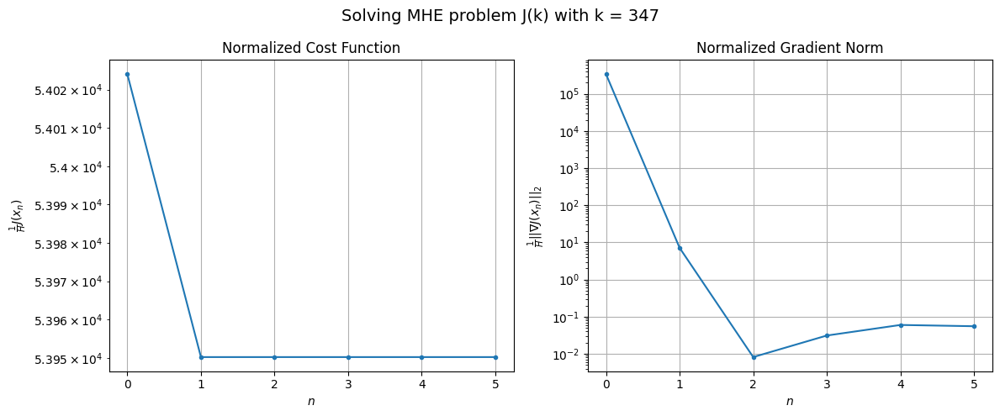

Windows:  84%|████████▍ | 249/296 [1:09:36<10:15, 13.10s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5298692.018441146
Gradient norm: 22225285.145067506
Global estimation error: 115.941546439536
Initial conditions estimation errors: 57.90850445483026 m, 58.06221901702004 m, 57.449484784227685 m, 58.45780452297943 m
Position estimation errors: 48.87183614295705 m, 48.70110990432849 m, 48.462573099815565 m, 49.38483616404835 m

[Gauss-Newton] Iteration 1
Cost function: 5294468.63165469 (-0.08%)
Gradient norm: 405.26471760759495 (-100.00%)
Global estimation error: 118.21629985487401 (1.96%)
Initial conditions estimation errors: 59.03997870267155 m, 59.198956709534464 m, 58.553859659349484 m, 59.63416456810784 m
Position estimation errors: 48.84405806740812 m, 48.700835128760026 m, 48.3996815820309 m, 49.41992534831474 m

[Gauss-Newton] Iteration 2
Cost function: 5294468.631837985 (0.00%)
Gradient norm: 0.6099849245608691 (-99.85%)
Global estimation error: 118.21627203503247 (-0.00%)
Initial conditions estimation errors: 59.03997

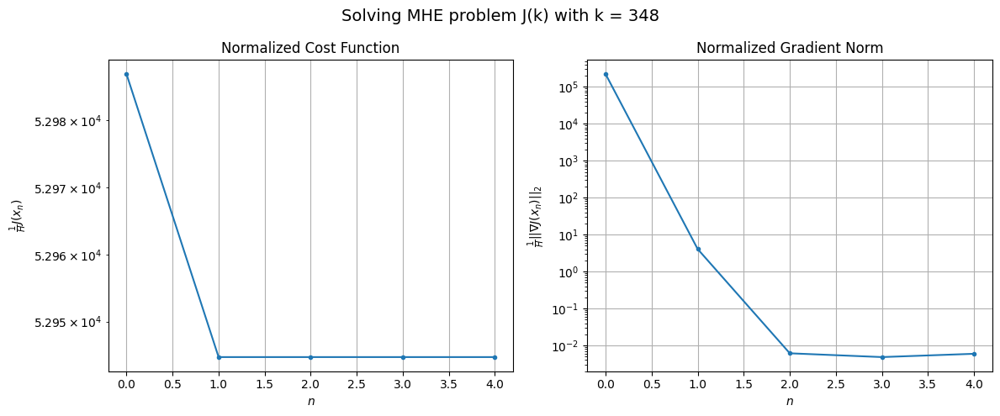

Windows:  84%|████████▍ | 250/296 [1:09:47<09:31, 12.43s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5247422.853327089
Gradient norm: 10609636.329885902
Global estimation error: 103.02843191797267
Initial conditions estimation errors: 51.46255246595841 m, 51.60155257888593 m, 50.99930882836866 m, 51.98800134307944 m
Position estimation errors: 50.612653302347915 m, 50.36835134626586 m, 50.12197082849426 m, 51.06602864955436 m

[Gauss-Newton] Iteration 1
Cost function: 5245352.483295137 (-0.04%)
Gradient norm: 188.55174676740765 (-100.00%)
Global estimation error: 104.35087461612531 (1.28%)
Initial conditions estimation errors: 52.123844652420644 m, 52.29291488562618 m, 51.573726119769184 m, 52.70435340693174 m
Position estimation errors: 50.67061922497639 m, 50.47093100928263 m, 50.046145302337386 m, 51.24538401898089 m

[Gauss-Newton] Iteration 2
Cost function: 5245352.4835492475 (0.00%)
Gradient norm: 1.133907268596924 (-99.40%)
Global estimation error: 104.35085342580508 (-0.00%)
Initial conditions estimation errors: 52.12

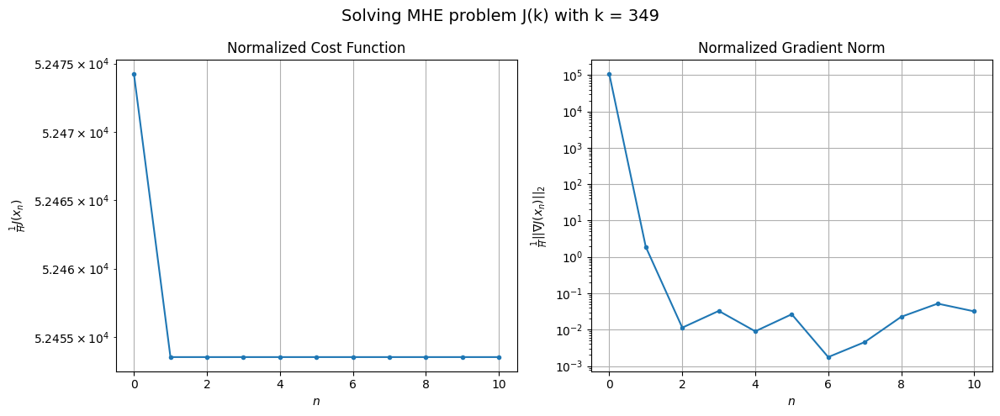

Windows:  85%|████████▍ | 251/296 [1:10:11<11:52, 15.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5252701.778712455
Gradient norm: 1665690.149710002
Global estimation error: 90.26838050967905
Initial conditions estimation errors: 45.09861835413331 m, 45.25097082949929 m, 44.59645701694449 m, 45.58450536118009 m
Position estimation errors: 53.42887716781229 m, 53.14404385945553 m, 52.751912681447415 m, 53.8667285148394 m

[Gauss-Newton] Iteration 1
Cost function: 5251769.477966854 (-0.02%)
Gradient norm: 73.89729901880976 (-100.00%)
Global estimation error: 90.71427378099723 (0.49%)
Initial conditions estimation errors: 45.319746956571386 m, 45.49681320525306 m, 44.813891777966944 m, 45.7919291600859 m
Position estimation errors: 53.335721400854176 m, 53.0801064649355 m, 52.73590350890527 m, 53.771472847593685 m

[Gauss-Newton] Iteration 2
Cost function: 5251769.477873434 (-0.00%)
Gradient norm: 2.6443983528288406 (-96.42%)
Global estimation error: 90.71429719771278 (0.00%)
Initial conditions estimation errors: 45.319747009

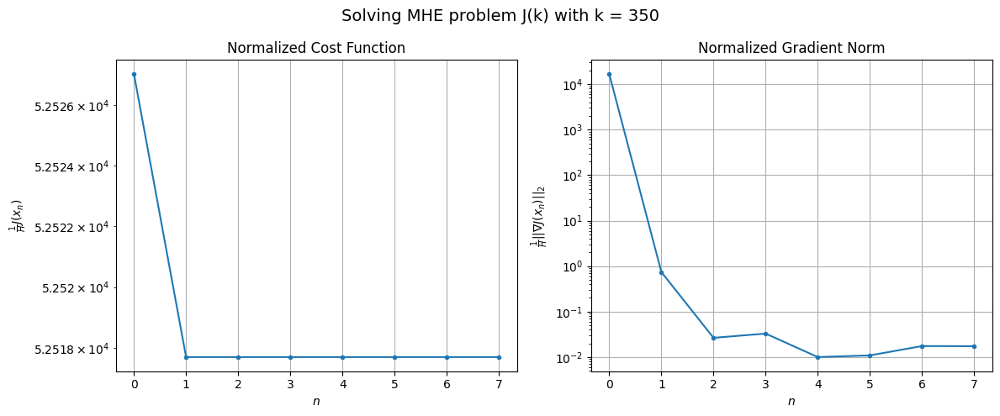

Windows:  85%|████████▌ | 252/296 [1:10:28<11:56, 16.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5312001.276800792
Gradient norm: 11745397.5777035
Global estimation error: 78.24214831234644
Initial conditions estimation errors: 39.10238732817508 m, 39.26107346829889 m, 38.668751052398115 m, 39.447284308149854 m
Position estimation errors: 57.133717902439344 m, 56.80589781576356 m, 56.47862981358394 m, 57.40793582726684 m

[Gauss-Newton] Iteration 1
Cost function: 5311132.792212076 (-0.02%)
Gradient norm: 68.2240158028665 (-100.00%)
Global estimation error: 77.93771893667024 (-0.39%)
Initial conditions estimation errors: 38.983195348351934 m, 39.16132282438854 m, 38.50480757038133 m, 39.2214801850304 m
Position estimation errors: 56.716609373265804 m, 56.36939281877241 m, 55.81632806398656 m, 56.657572947385525 m

[Gauss-Newton] Iteration 2
Cost function: 5311132.791907788 (-0.00%)
Gradient norm: 2.2913445539587523 (-96.64%)
Global estimation error: 77.9376629924809 (-0.00%)
Initial conditions estimation errors: 38.9831957

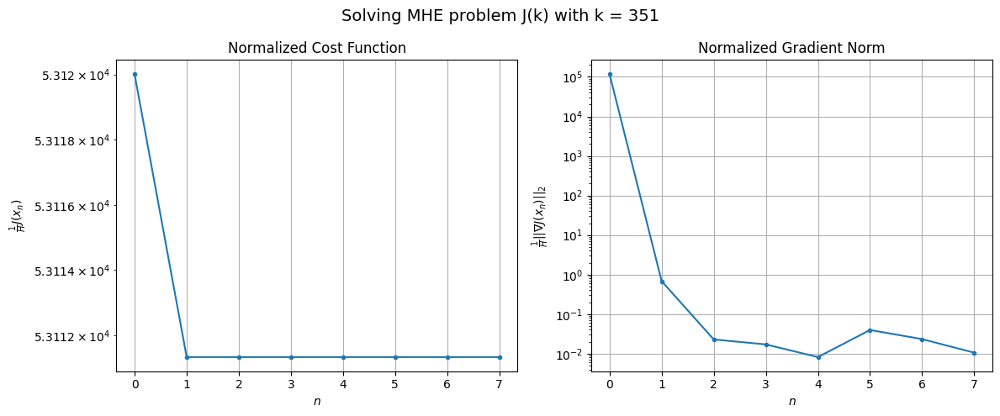

Windows:  85%|████████▌ | 253/296 [1:10:46<12:01, 16.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5425274.940805205
Gradient norm: 22496875.899232697
Global estimation error: 67.76563676760382
Initial conditions estimation errors: 33.90161748815385 m, 34.062746202639445 m, 33.5631396827394 m, 34.00105551668161 m
Position estimation errors: 61.535991253076986 m, 61.1527258076405 m, 60.59715461888744 m, 61.32711664430372 m

[Gauss-Newton] Iteration 1
Cost function: 5423318.8998096865 (-0.04%)
Gradient norm: 213.07023387912815 (-100.00%)
Global estimation error: 67.1682727991641 (-0.88%)
Initial conditions estimation errors: 33.61446670225704 m, 33.73577591319039 m, 33.27983438896512 m, 33.704006520516444 m
Position estimation errors: 60.64177571120928 m, 60.14873343141648 m, 59.47524936277716 m, 60.61653215070481 m

[Gauss-Newton] Iteration 2
Cost function: 5423318.899502337 (-0.00%)
Gradient norm: 2.310620241737069 (-98.92%)
Global estimation error: 67.16827689561663 (0.00%)
Initial conditions estimation errors: 33.61446716

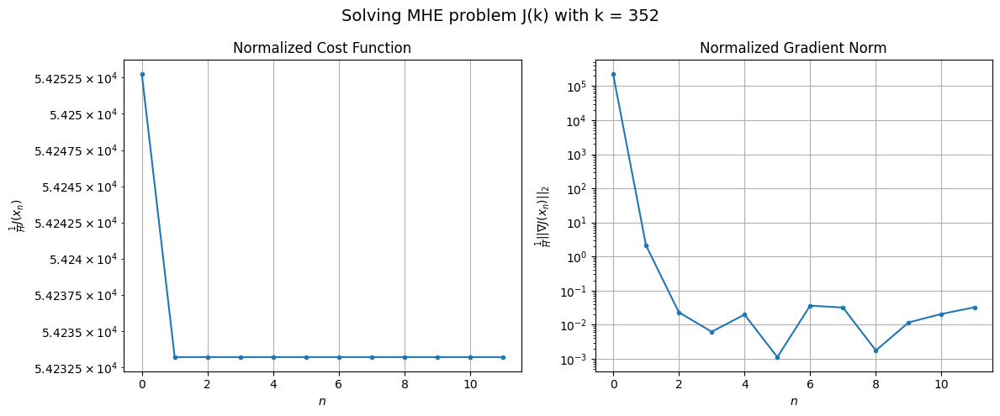

Windows:  86%|████████▌ | 254/296 [1:11:13<13:47, 19.69s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5587393.350084527
Gradient norm: 32022947.492602333
Global estimation error: 60.03944814974199
Initial conditions estimation errors: 30.033803484754934 m, 30.16409186537773 m, 29.93717347495405 m, 29.942834238023508 m
Position estimation errors: 66.4041923032034 m, 65.86611079832463 m, 65.19705368161009 m, 66.23210873095556 m

[Gauss-Newton] Iteration 1
Cost function: 5583329.3084254125 (-0.07%)
Gradient norm: 502.502875975775 (-100.00%)
Global estimation error: 59.84867112910307 (-0.32%)
Initial conditions estimation errors: 29.914450363684132 m, 30.047522229903525 m, 29.939652850422732 m, 29.79475970274416 m
Position estimation errors: 64.9735584733736 m, 64.47939463627183 m, 63.63135177590718 m, 64.63683325432325 m

[Gauss-Newton] Iteration 2
Cost function: 5583329.3085260885 (0.00%)
Gradient norm: 0.3567624276852494 (-99.93%)
Global estimation error: 59.848674778567776 (0.00%)
Initial conditions estimation errors: 29.91445

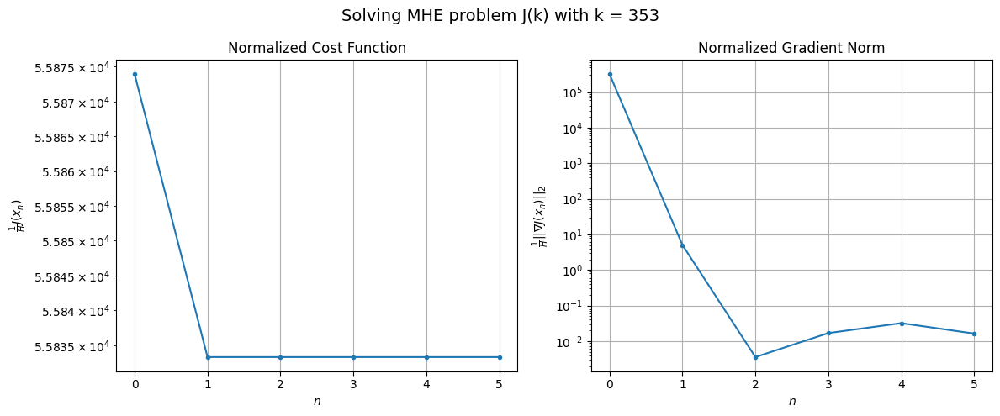

Windows:  86%|████████▌ | 255/296 [1:11:26<12:12, 17.88s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5795135.535424783
Gradient norm: 41069635.975732684
Global estimation error: 56.29717537220289
Initial conditions estimation errors: 28.10495068150828 m, 28.239090902308025 m, 28.419230923850307 m, 27.827451994436455 m
Position estimation errors: 71.52638804749266 m, 71.00823007472536 m, 70.19407226622113 m, 71.0593871720116 m

[Gauss-Newton] Iteration 1
Cost function: 5787908.8720888635 (-0.12%)
Gradient norm: 907.168937398703 (-100.00%)
Global estimation error: 57.23545752446024 (1.67%)
Initial conditions estimation errors: 28.578618844482417 m, 28.651240419166825 m, 28.925716006557654 m, 28.311708256381866 m
Position estimation errors: 69.51906880324506 m, 69.14543491281925 m, 68.34239442912228 m, 68.78607284045461 m

[Gauss-Newton] Iteration 2
Cost function: 5787908.8726769695 (0.00%)
Gradient norm: 1.106622058874629 (-99.88%)
Global estimation error: 57.235486573049094 (0.00%)
Initial conditions estimation errors: 28.5786

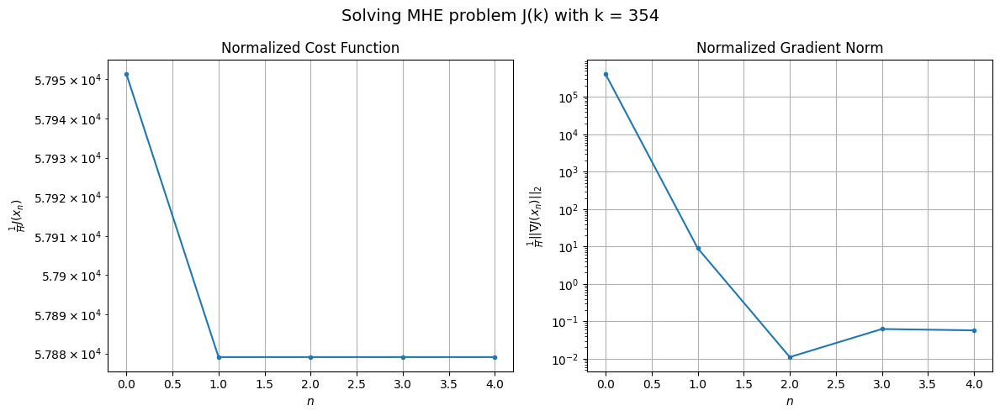

Windows:  86%|████████▋ | 256/296 [1:11:38<10:39, 15.98s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6039977.279569384
Gradient norm: 48424491.03136653
Global estimation error: 57.067130230021206
Initial conditions estimation errors: 28.45853430290174 m, 28.51869178640399 m, 29.03501640390811 m, 28.114236258274172 m
Position estimation errors: 76.61533654974046 m, 76.20870095257334 m, 75.46458592152119 m, 75.76474924481428 m

[Gauss-Newton] Iteration 1
Cost function: 6028792.622698622 (-0.19%)
Gradient norm: 1471.0796650123093 (-100.00%)
Global estimation error: 59.803128936975725 (4.79%)
Initial conditions estimation errors: 29.876920382202034 m, 29.79485534675923 m, 30.408700333829998 m, 29.51866172782426 m
Position estimation errors: 74.05202148797815 m, 73.85243004260514 m, 73.09156069788052 m, 73.19131322813487 m

[Gauss-Newton] Iteration 2
Cost function: 6028792.62292623 (0.00%)
Gradient norm: 2.843027561180509 (-99.81%)
Global estimation error: 59.80314471147213 (0.00%)
Initial conditions estimation errors: 29.87691896

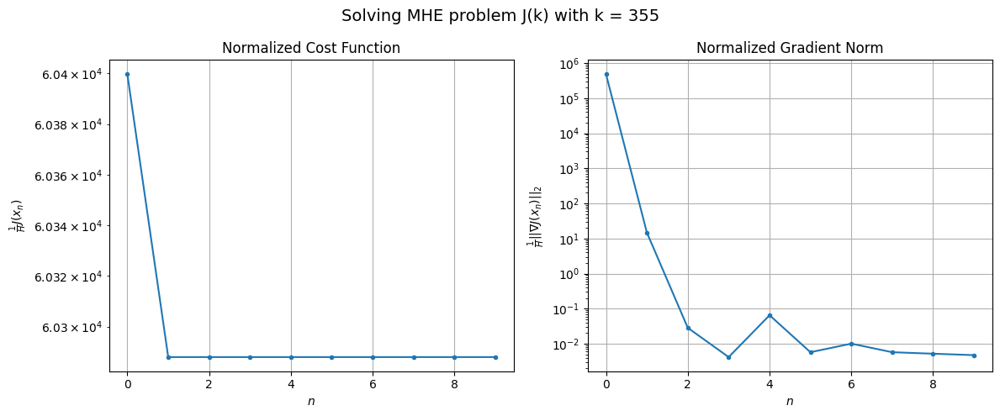

Windows:  87%|████████▋ | 257/296 [1:12:00<11:30, 17.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6315771.929894367
Gradient norm: 54410526.868100695
Global estimation error: 61.89233288774189
Initial conditions estimation errors: 30.89585167620612 m, 30.796071252559994 m, 31.564397865233442 m, 30.51871406832158 m
Position estimation errors: 81.40039131815195 m, 81.18327814790509 m, 80.48332181372757 m, 80.4427472494539 m

[Gauss-Newton] Iteration 1
Cost function: 6299939.377167856 (-0.25%)
Gradient norm: 2138.3956420116783 (-100.00%)
Global estimation error: 67.04547505507622 (8.33%)
Initial conditions estimation errors: 33.36401366336841 m, 33.42127440981784 m, 34.270572741214934 m, 33.02240223988853 m
Position estimation errors: 78.31422927799908 m, 77.81847516817734 m, 77.04484143799407 m, 77.27722446700491 m

[Gauss-Newton] Iteration 2
Cost function: 6299939.376998665 (-0.00%)
Gradient norm: 5.251702143583217 (-99.75%)
Global estimation error: 67.0454995883802 (0.00%)
Initial conditions estimation errors: 33.364011556

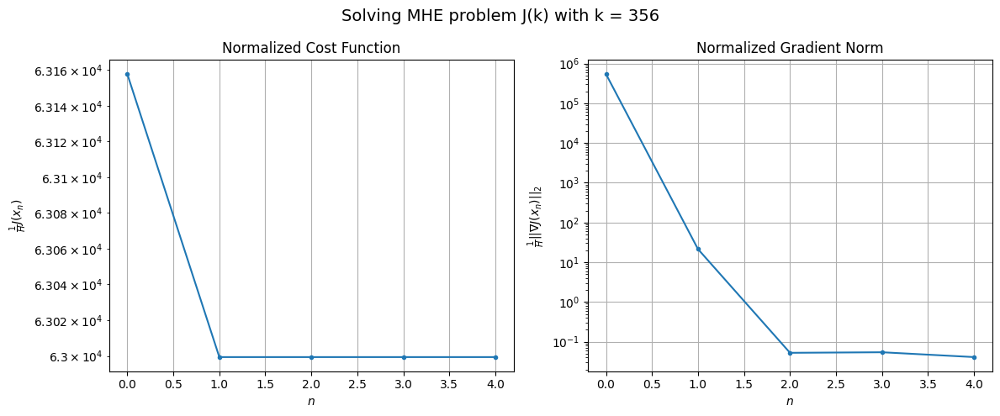

Windows:  87%|████████▋ | 258/296 [1:12:11<10:04, 15.91s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6610111.126960338
Gradient norm: 58927553.50111961
Global estimation error: 69.98925979922531
Initial conditions estimation errors: 34.79736801347677 m, 34.875923712278464 m, 35.81112143712507 m, 34.4799856035107 m
Position estimation errors: 85.6788170598538 m, 85.16461519059075 m, 84.42240582874273 m, 84.57144824879236 m

[Gauss-Newton] Iteration 1
Cost function: 6589198.522132342 (-0.32%)
Gradient norm: 2934.640585969038 (-100.00%)
Global estimation error: 76.88542820409424 (9.85%)
Initial conditions estimation errors: 38.24779303528137 m, 38.30474363549359 m, 39.18513964099707 m, 38.02292861453822 m
Position estimation errors: 82.12440512637771 m, 81.66105765171454 m, 81.04314185810225 m, 80.93018869828425 m

[Gauss-Newton] Iteration 2
Cost function: 6589198.522242404 (0.00%)
Gradient norm: 0.9567720946575107 (-99.97%)
Global estimation error: 76.88550946225675 (0.00%)
Initial conditions estimation errors: 38.2477905039395

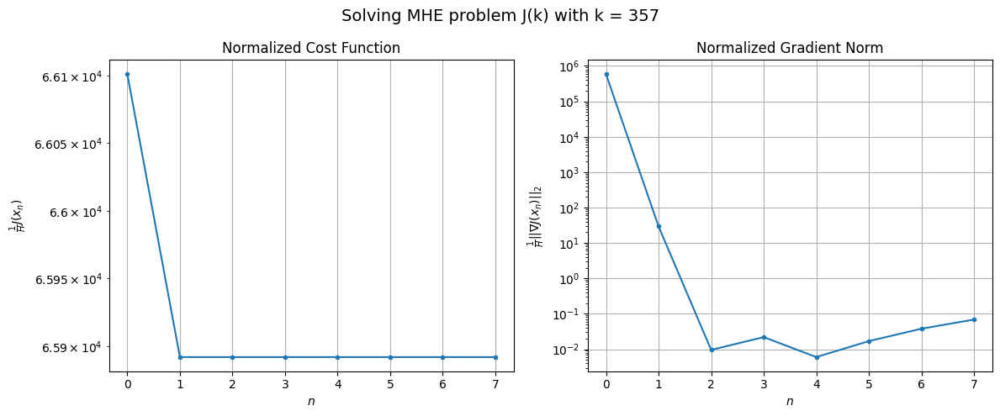

Windows:  88%|████████▊ | 259/296 [1:12:29<10:06, 16.40s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6915776.2616157215
Gradient norm: 62698242.63869119
Global estimation error: 79.47498138855822
Initial conditions estimation errors: 39.5047185330745 m, 39.595452209265986 m, 40.50378981928695 m, 39.33559149885892 m
Position estimation errors: 89.38498710131368 m, 88.91728834622837 m, 88.34818206420276 m, 88.13706670496008 m

[Gauss-Newton] Iteration 1
Cost function: 6889528.057163767 (-0.38%)
Gradient norm: 3777.0970142350766 (-99.99%)
Global estimation error: 88.13270932590785 (10.89%)
Initial conditions estimation errors: 43.79661990801903 m, 43.862408715702486 m, 44.86578452934556 m, 43.73071957954686 m
Position estimation errors: 85.40941930195133 m, 84.90916896237172 m, 84.1950784269933 m, 84.03724295179191 m

[Gauss-Newton] Iteration 2
Cost function: 6889528.0563691305 (-0.00%)
Gradient norm: 1.4043447936020035 (-99.96%)
Global estimation error: 88.13259394673125 (-0.00%)
Initial conditions estimation errors: 43.7966172

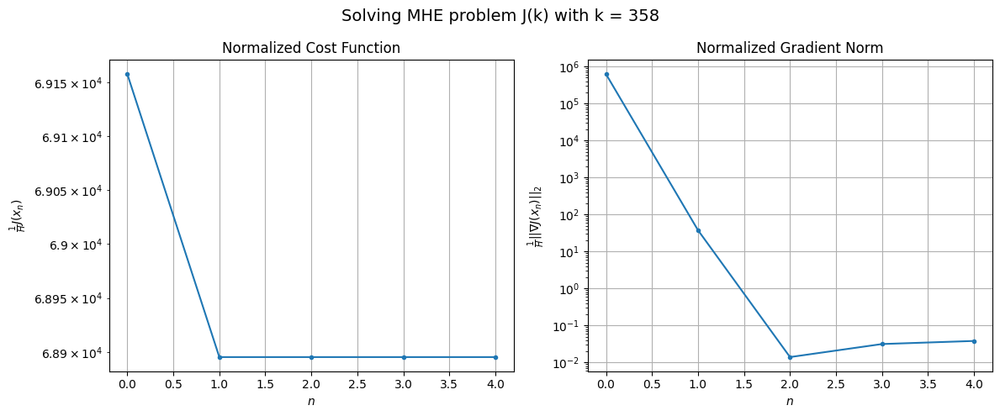

Windows:  88%|████████▊ | 260/296 [1:12:41<08:58, 14.97s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 7219516.27360204
Gradient norm: 65836037.87106704
Global estimation error: 89.56278543792173
Initial conditions estimation errors: 44.468228680842316 m, 44.57803200385757 m, 45.59083156412325 m, 44.478495548855285 m
Position estimation errors: 92.52067714411848 m, 92.0168668808126 m, 91.33526246923002 m, 91.07528088130508 m

[Gauss-Newton] Iteration 1
Cost function: 7187764.102172094 (-0.44%)
Gradient norm: 4706.389603382577 (-99.99%)
Global estimation error: 99.39647936401299 (10.98%)
Initial conditions estimation errors: 49.49511450388362 m, 49.57423349480739 m, 50.342882981245054 m, 49.374829026839336 m
Position estimation errors: 88.1709598605664 m, 87.69952556358905 m, 87.27426422518126 m, 86.9317686513403 m

[Gauss-Newton] Iteration 2
Cost function: 7187764.10250923 (0.00%)
Gradient norm: 4.189353576410838 (-99.91%)
Global estimation error: 99.3965539861285 (0.00%)
Initial conditions estimation errors: 49.49511189010179 

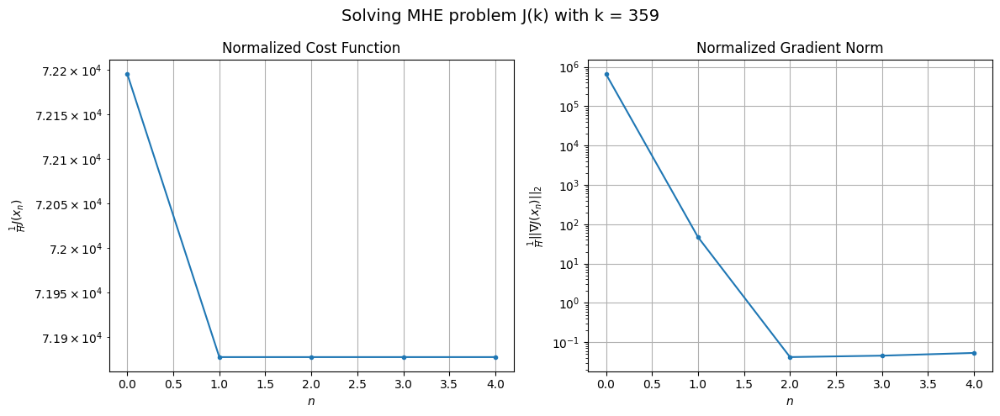

Windows:  88%|████████▊ | 261/296 [1:12:52<08:05, 13.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 7516197.825280651
Gradient norm: 68181861.68755554
Global estimation error: 99.11699104942323
Initial conditions estimation errors: 49.314921555997834 m, 49.444699106858295 m, 50.196277787452814 m, 49.27229214225567 m
Position estimation errors: 95.09778635905842 m, 94.63129647477419 m, 94.23387332261687 m, 93.79475287802755 m

[Gauss-Newton] Iteration 1
Cost function: 7479189.474515032 (-0.49%)
Gradient norm: 5574.295082491624 (-99.99%)
Global estimation error: 110.27311504951751 (11.26%)
Initial conditions estimation errors: 54.954325164665896 m, 55.120322569267756 m, 55.654846943252494 m, 54.81290085118773 m
Position estimation errors: 90.42807546528402 m, 89.83439505168988 m, 89.71347102693947 m, 89.25025945576205 m

[Gauss-Newton] Iteration 2
Cost function: 7479189.47388894 (-0.00%)
Gradient norm: 2.38921605933979 (-99.96%)
Global estimation error: 110.2732209033854 (0.00%)
Initial conditions estimation errors: 54.9543228

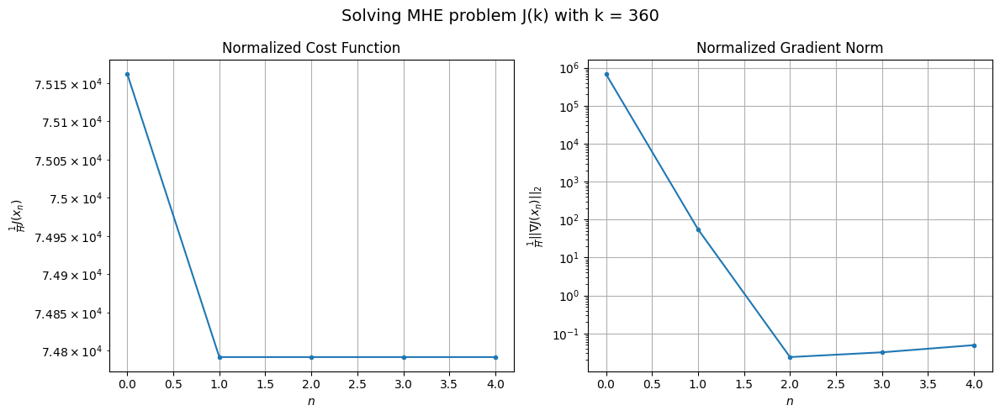

Windows:  89%|████████▊ | 262/296 [1:13:03<07:26, 13.14s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 7799347.298715642
Gradient norm: 70011287.95525612
Global estimation error: 108.04098330153482
Initial conditions estimation errors: 53.79945934417384 m, 54.023561651906256 m, 54.521203624181766 m, 53.73403267020711 m
Position estimation errors: 97.14602331109239 m, 96.51745686783495 m, 96.45280836757699 m, 95.8868228007249 m

[Gauss-Newton] Iteration 1
Cost function: 7757328.597108156 (-0.54%)
Gradient norm: 6459.132712383453 (-99.99%)
Global estimation error: 120.28486966700332 (11.33%)
Initial conditions estimation errors: 59.96873616310421 m, 60.126621647472746 m, 60.57494909829088 m, 59.896933817284385 m
Position estimation errors: 92.19855218302686 m, 91.69682506354509 m, 91.6036978672947 m, 91.00321391651056 m

[Gauss-Newton] Iteration 2
Cost function: 7757328.597195433 (0.00%)
Gradient norm: 4.653431420018948 (-99.93%)
Global estimation error: 120.2849056374458 (0.00%)
Initial conditions estimation errors: 59.968734368

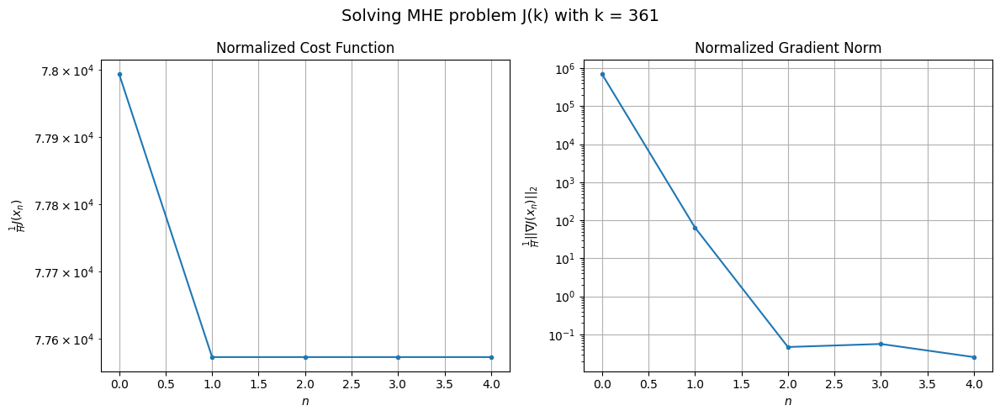

Windows:  89%|████████▉ | 263/296 [1:13:15<06:58, 12.69s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8064465.741252107
Gradient norm: 71755828.43582603
Global estimation error: 116.13280579284347
Initial conditions estimation errors: 57.859260220629544 m, 58.06799096199529 m, 58.47951025405748 m, 57.85642045431988 m
Position estimation errors: 98.72986318767072 m, 98.20607097502794 m, 98.1648943613242 m, 97.45474481465722 m

[Gauss-Newton] Iteration 1
Cost function: 8017848.925229018 (-0.58%)
Gradient norm: 7257.566814691029 (-99.99%)
Global estimation error: 129.28733873473558 (11.33%)
Initial conditions estimation errors: 64.47969726891594 m, 64.80885917924495 m, 64.95137164404647 m, 64.33262733152596 m
Position estimation errors: 93.54144272460785 m, 92.9261103992265 m, 93.17813017793672 m, 92.5685679976778 m

[Gauss-Newton] Iteration 2
Cost function: 8017848.926640433 (0.00%)
Gradient norm: 0.6130470912356102 (-99.99%)
Global estimation error: 129.2875677870825 (0.00%)
Initial conditions estimation errors: 64.479696153718

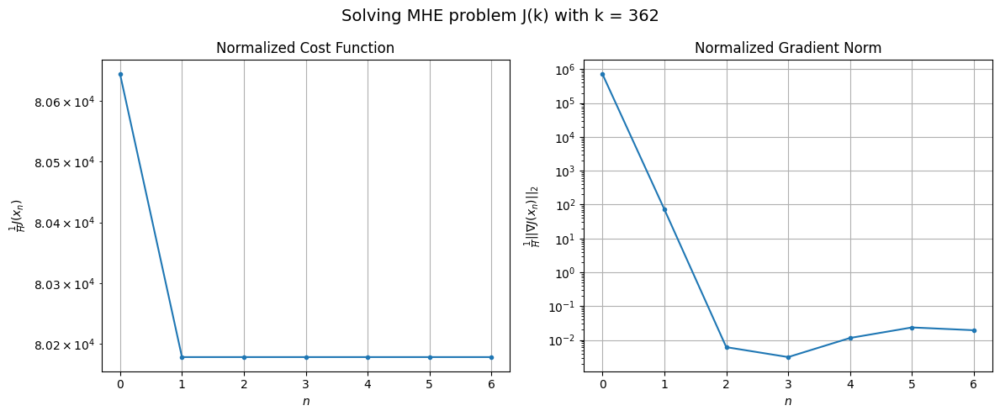

Windows:  89%|████████▉ | 264/296 [1:13:30<07:10, 13.45s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8307334.424330009
Gradient norm: 73066483.82343946
Global estimation error: 123.43674924545512
Initial conditions estimation errors: 61.526258026610954 m, 61.91096914711088 m, 62.00312474153795 m, 61.43098568887285 m
Position estimation errors: 99.94183339624105 m, 99.32845248346734 m, 99.64211229674325 m, 98.93092561097352 m

[Gauss-Newton] Iteration 1
Cost function: 8256218.886151721 (-0.62%)
Gradient norm: 8014.835661466242 (-99.99%)
Global estimation error: 137.73155183378947 (11.58%)
Initial conditions estimation errors: 68.56163895591624 m, 69.12432843544244 m, 69.07673617266458 m, 68.69847050972196 m
Position estimation errors: 94.5286779601031 m, 93.66342886337674 m, 94.08655965496013 m, 93.25988213584078 m

[Gauss-Newton] Iteration 2
Cost function: 8256218.886665535 (0.00%)
Gradient norm: 4.258039733694417 (-99.95%)
Global estimation error: 137.7314887464862 (-0.00%)
Initial conditions estimation errors: 68.5616387197

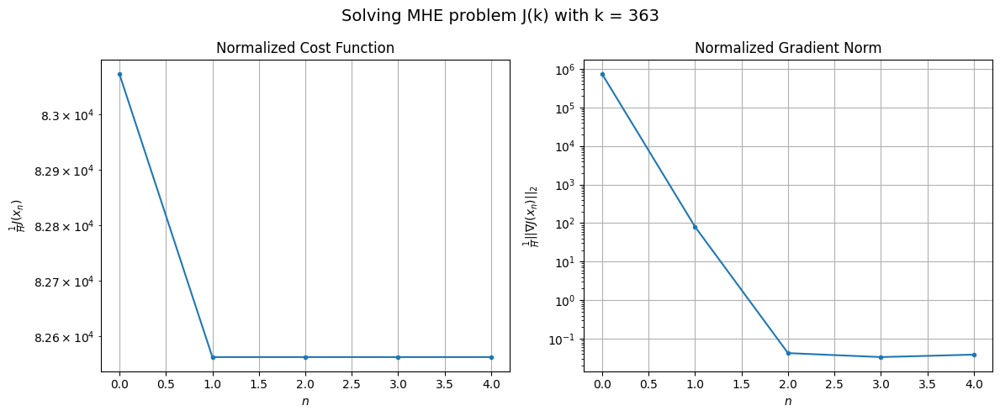

Windows:  90%|████████▉ | 265/296 [1:13:41<06:34, 12.73s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8527767.759909973
Gradient norm: 73807844.6013542
Global estimation error: 130.46140058348905
Initial conditions estimation errors: 64.89366746439345 m, 65.51980800993186 m, 65.41747184339913 m, 65.08966882343024 m
Position estimation errors: 100.82310132982435 m, 99.99502840566137 m, 100.43891527266143 m, 99.5615726950527 m

[Gauss-Newton] Iteration 1
Cost function: 8472760.239547975 (-0.65%)
Gradient norm: 8706.025905801787 (-99.99%)
Global estimation error: 145.12839880861677 (11.24%)
Initial conditions estimation errors: 72.27840511020476 m, 72.74001361970251 m, 72.795798454919 m, 72.44106510411041 m
Position estimation errors: 95.22537351657425 m, 94.46393216735841 m, 94.72418842894749 m, 93.88879403408883 m

[Gauss-Newton] Iteration 2
Cost function: 8472760.239190495 (-0.00%)
Gradient norm: 1.768275665122626 (-99.98%)
Global estimation error: 145.1283379829317 (-0.00%)
Initial conditions estimation errors: 72.27840586401

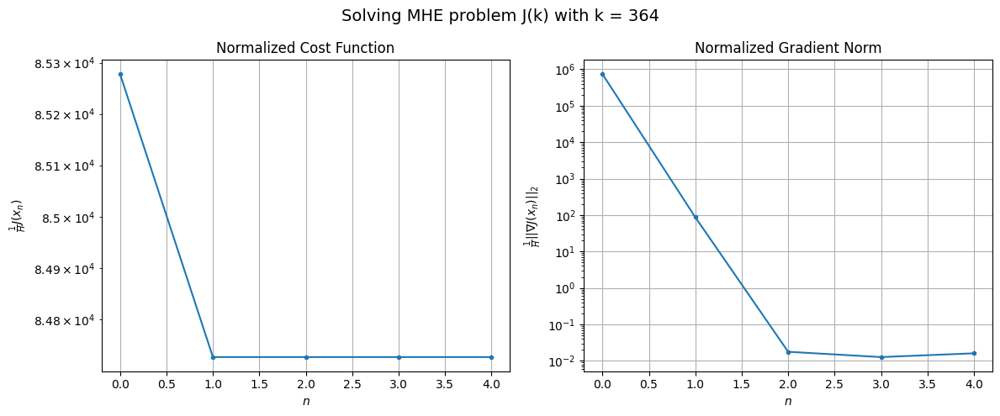

Windows:  90%|████████▉ | 266/296 [1:13:53<06:10, 12.37s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8726473.453260072
Gradient norm: 74836202.97772433
Global estimation error: 136.66406056860174
Initial conditions estimation errors: 68.01613067348435 m, 68.53198865138015 m, 68.54555598818438 m, 68.23274842283776 m
Position estimation errors: 101.37598926782847 m, 100.63417200169837 m, 100.92362949252059 m, 100.01498465618948 m

[Gauss-Newton] Iteration 1
Cost function: 8667911.559933277 (-0.67%)
Gradient norm: 9307.084161454404 (-99.99%)
Global estimation error: 151.652324312598 (10.97%)
Initial conditions estimation errors: 75.70096056619282 m, 75.94741674731613 m, 75.99003002402259 m, 75.66541377296714 m
Position estimation errors: 95.61437383801527 m, 95.22139204956369 m, 95.42754531911513 m, 94.63710107941368 m

[Gauss-Newton] Iteration 2
Cost function: 8667911.559669714 (-0.00%)
Gradient norm: 3.0750009481112515 (-99.97%)
Global estimation error: 151.6525970435278 (0.00%)
Initial conditions estimation errors: 75.7009624

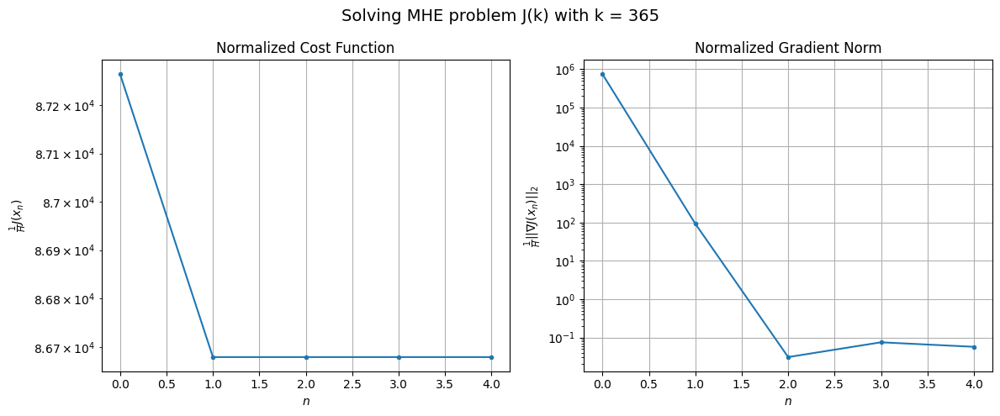

Windows:  90%|█████████ | 267/296 [1:14:04<05:51, 12.10s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8896548.065344121
Gradient norm: 74885237.38761516
Global estimation error: 142.16142824406268
Initial conditions estimation errors: 70.94443632385219 m, 71.21615995616735 m, 71.22767643246964 m, 70.93373821134111 m
Position estimation errors: 101.550997778741 m, 101.20658092263001 m, 101.40949301785221 m, 100.56794380132192 m

[Gauss-Newton] Iteration 1
Cost function: 8834788.701387964 (-0.69%)
Gradient norm: 9863.40935897469 (-99.99%)
Global estimation error: 158.29563629046112 (11.35%)
Initial conditions estimation errors: 78.89960007148782 m, 79.38779227331052 m, 79.28129805626054 m, 79.02132370489339 m
Position estimation errors: 95.65700332898908 m, 94.90282145134458 m, 95.31663383292307 m, 94.5153435837664 m

[Gauss-Newton] Iteration 2
Cost function: 8834788.701046271 (-0.00%)
Gradient norm: 3.9796986846975373 (-99.96%)
Global estimation error: 158.29557091829662 (-0.00%)
Initial conditions estimation errors: 78.8996031

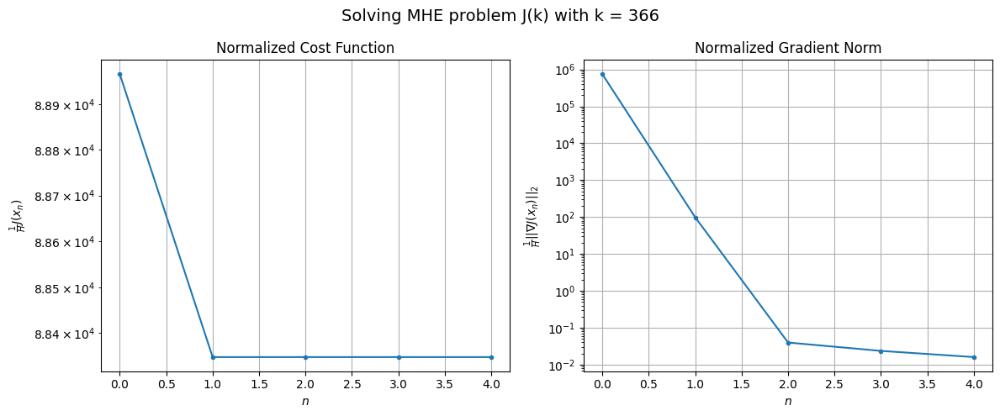

Windows:  91%|█████████ | 268/296 [1:14:16<05:32, 11.86s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 9038823.737316698
Gradient norm: 75156784.9747954
Global estimation error: 147.92662036135005
Initial conditions estimation errors: 73.69870658268742 m, 74.2237788809166 m, 74.07813807256878 m, 73.85121297132609 m
Position estimation errors: 101.32850767638104 m, 100.62342539789162 m, 101.03299462548533 m, 100.19651735536162 m

[Gauss-Newton] Iteration 1
Cost function: 8974336.219737748 (-0.71%)
Gradient norm: 10346.738279850508 (-99.99%)
Global estimation error: 164.2931080424963 (11.06%)
Initial conditions estimation errors: 81.87249332335125 m, 82.37415924192125 m, 82.24204717635178 m, 82.09636497765219 m
Position estimation errors: 95.32351408873987 m, 94.62480369075526 m, 94.94161843615984 m, 94.09924947165777 m

[Gauss-Newton] Iteration 2
Cost function: 8974336.218463331 (-0.00%)
Gradient norm: 1.506693135453014 (-99.99%)
Global estimation error: 164.29310901664084 (0.00%)
Initial conditions estimation errors: 81.8724976

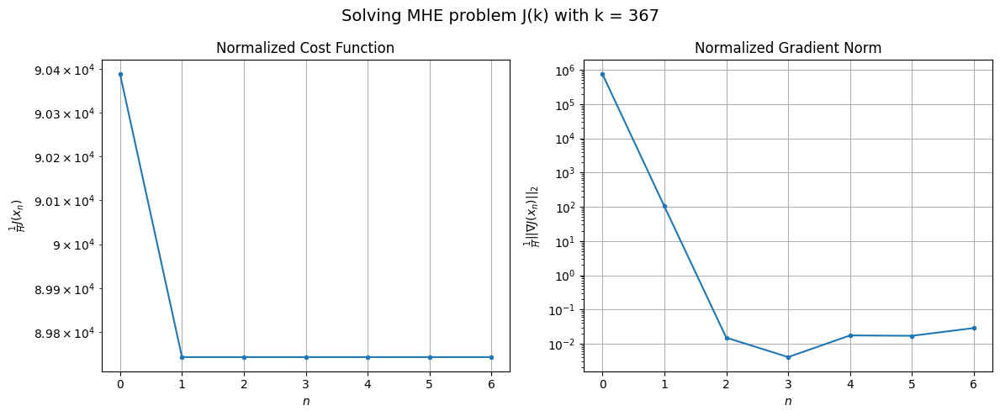

Windows:  91%|█████████ | 269/296 [1:14:31<05:48, 12.90s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 9146972.007514577
Gradient norm: 75131608.13446064
Global estimation error: 153.0018781617511
Initial conditions estimation errors: 76.21293220271622 m, 76.74218026326308 m, 76.57789398282536 m, 76.4694606487048 m
Position estimation errors: 100.71578482196044 m, 100.08497207630117 m, 100.3803950822459 m, 99.52607530851961 m

[Gauss-Newton] Iteration 1
Cost function: 9080079.586667 (-0.73%)
Gradient norm: 10775.800240609438 (-99.99%)
Global estimation error: 169.37000212315627 (10.70%)
Initial conditions estimation errors: 84.57805194995032 m, 84.76629447589715 m, 84.82202030726822 m, 84.5730142466049 m
Position estimation errors: 94.62066861610006 m, 94.45709716771461 m, 94.49619262011402 m, 93.80238425671392 m

[Gauss-Newton] Iteration 2
Cost function: 9080079.58676793 (0.00%)
Gradient norm: 1.4200677475569798 (-99.99%)
Global estimation error: 169.37022304250144 (0.00%)
Initial conditions estimation errors: 84.5780575100557

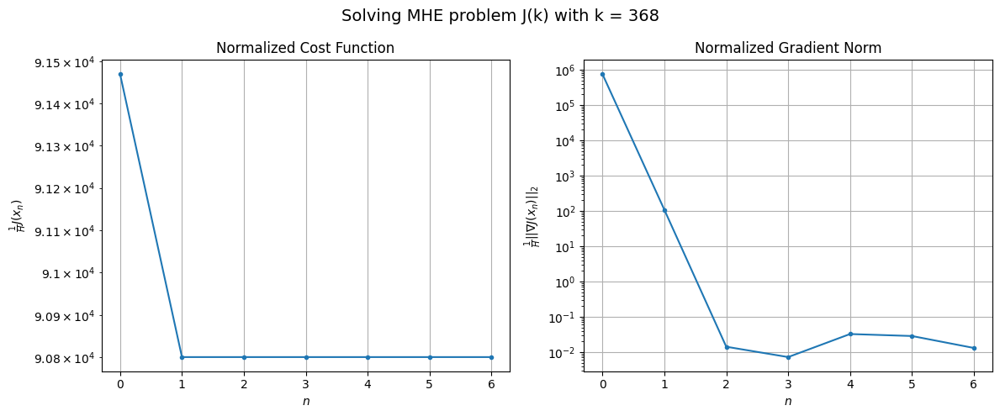

Windows:  91%|█████████ | 270/296 [1:14:46<05:55, 13.69s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 9219257.878872894
Gradient norm: 74384917.53561705
Global estimation error: 157.07579769911635
Initial conditions estimation errors: 78.43280364634482 m, 78.6231918520786 m, 78.65381510774661 m, 78.4411747167624 m
Position estimation errors: 99.7435310916504 m, 99.64531564911377 m, 99.69524922664722 m, 98.94432160356538 m

[Gauss-Newton] Iteration 1
Cost function: 9150648.060988793 (-0.74%)
Gradient norm: 11110.331855018538 (-99.99%)
Global estimation error: 174.0601481929938 (10.81%)
Initial conditions estimation errors: 86.93907667243262 m, 87.07854726982984 m, 87.0765185230929 m, 87.02572315023069 m
Position estimation errors: 93.59094607789422 m, 93.55653412813615 m, 93.613592454632 m, 92.71673674466894 m

[Gauss-Newton] Iteration 2
Cost function: 9150648.06020112 (-0.00%)
Gradient norm: 2.275296244644108 (-99.98%)
Global estimation error: 174.0601962018045 (0.00%)
Initial conditions estimation errors: 86.93908351302767 m,

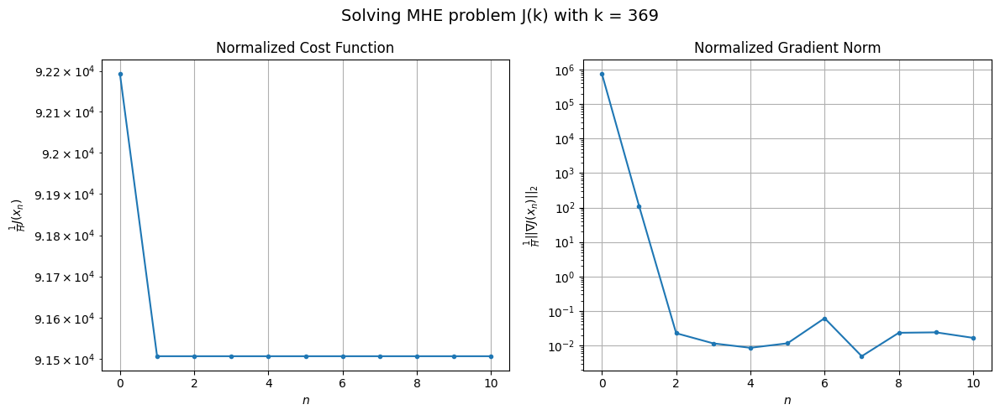

Windows:  92%|█████████▏| 271/296 [1:15:10<06:57, 16.70s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 9257635.122411462
Gradient norm: 74033982.2356426
Global estimation error: 160.8341804231839
Initial conditions estimation errors: 80.33519239340063 m, 80.4631501677851 m, 80.44040786022545 m, 80.4291806254811 m
Position estimation errors: 98.4613120277611 m, 98.49278470647535 m, 98.55802986658387 m, 97.62809547947833 m

[Gauss-Newton] Iteration 1
Cost function: 9187706.57659068 (-0.76%)
Gradient norm: 11363.762115508134 (-99.98%)
Global estimation error: 178.0718373124332 (10.72%)
Initial conditions estimation errors: 88.94565165236315 m, 89.07093970140797 m, 89.09601451774905 m, 89.03061700318909 m
Position estimation errors: 92.2649978671737 m, 92.35180940384407 m, 92.20334247763107 m, 91.4845059050263 m

[Gauss-Newton] Iteration 2
Cost function: 9187706.576617198 (0.00%)
Gradient norm: 0.2897518065087694 (-100.00%)
Global estimation error: 178.07179835748715 (-0.00%)
Initial conditions estimation errors: 88.94565970889266 

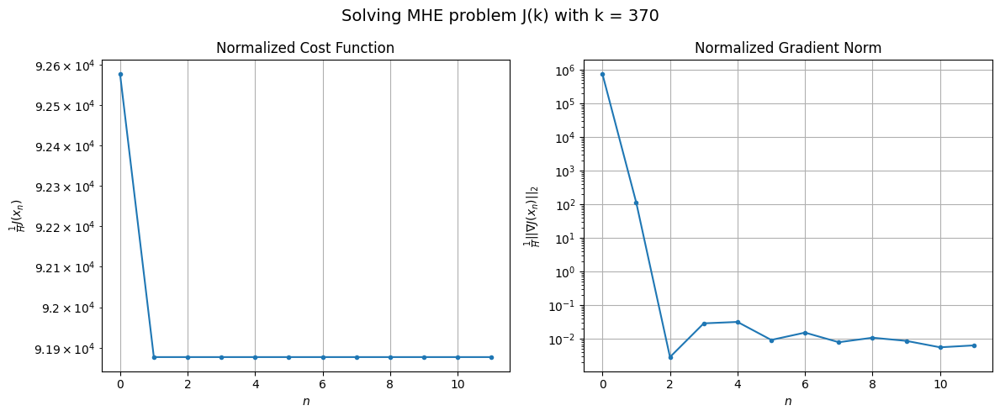

Windows:  92%|█████████▏| 272/296 [1:15:36<07:44, 19.36s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 9263060.407885095
Gradient norm: 72984361.0415873
Global estimation error: 164.06422974043167
Initial conditions estimation errors: 81.95592212486348 m, 82.05825315895386 m, 82.07837567059087 m, 82.03546721274837 m
Position estimation errors: 96.89516368073153 m, 97.03641358370844 m, 96.90580720616661 m, 96.16481702464372 m

[Gauss-Newton] Iteration 1
Cost function: 9192347.690775268 (-0.76%)
Gradient norm: 11543.359170897153 (-99.98%)
Global estimation error: 181.21903088019363 (10.46%)
Initial conditions estimation errors: 90.6366810333385 m, 90.5424356584329 m, 90.66490417945464 m, 90.59359726354138 m
Position estimation errors: 90.68228234951613 m, 91.12598566428919 m, 90.74898459213237 m, 90.07400469540505 m

[Gauss-Newton] Iteration 2
Cost function: 9192347.691539755 (0.00%)
Gradient norm: 0.8594148439419756 (-99.99%)
Global estimation error: 181.21917475170798 (0.00%)
Initial conditions estimation errors: 90.63669025834

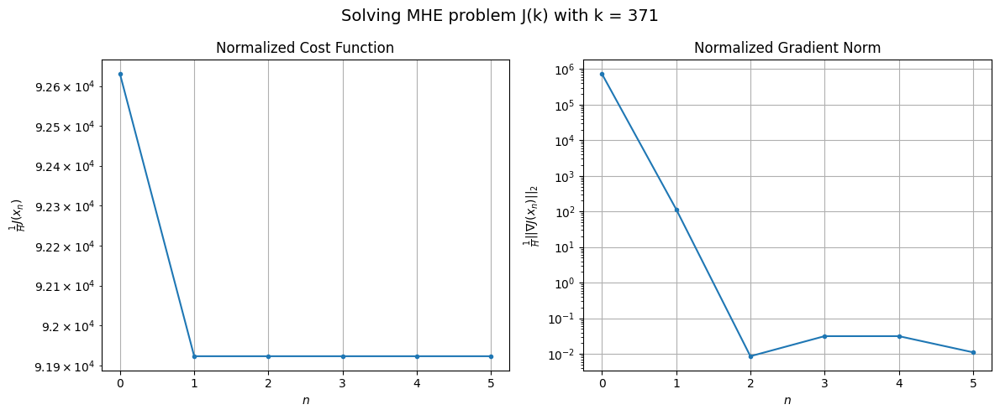

Windows:  92%|█████████▏| 273/296 [1:15:50<06:49, 17.82s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 9230993.013855197
Gradient norm: 71284845.78409399
Global estimation error: 166.55439800859895
Initial conditions estimation errors: 83.32223414074262 m, 83.19546706091846 m, 83.32077795720194 m, 83.26984556874285 m
Position estimation errors: 95.08008009384908 m, 95.58334160017314 m, 95.20884230767255 m, 94.49535092807106 m

[Gauss-Newton] Iteration 1
Cost function: 9160005.993055535 (-0.77%)
Gradient norm: 11670.583270302945 (-99.98%)
Global estimation error: 184.0807165827358 (10.52%)
Initial conditions estimation errors: 92.04803900231124 m, 92.02330107898415 m, 92.05075403574044 m, 92.0389224322742 m
Position estimation errors: 88.88352820905033 m, 89.14785111875354 m, 89.00292115028783 m, 88.36103877458193 m

[Gauss-Newton] Iteration 2
Cost function: 9160005.992387593 (-0.00%)
Gradient norm: 2.2987264437589765 (-99.98%)
Global estimation error: 184.08067478362918 (-0.00%)
Initial conditions estimation errors: 92.04804933

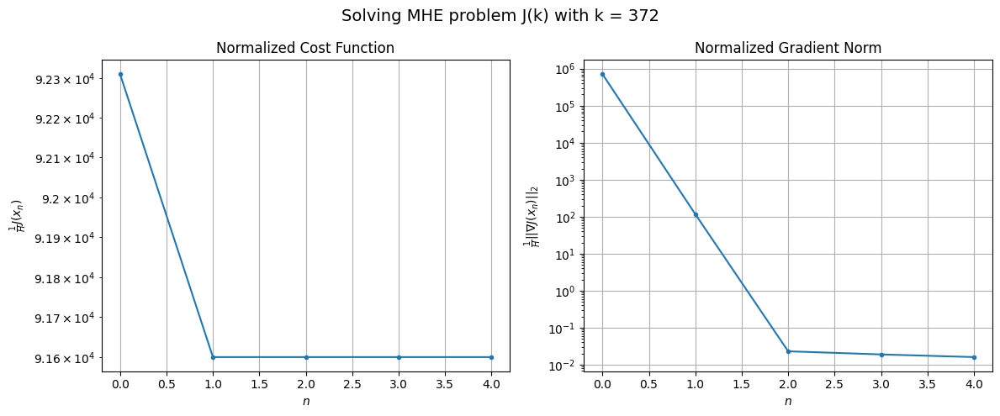

Windows:  93%|█████████▎| 274/296 [1:16:01<05:49, 15.87s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 9169252.358543942
Gradient norm: 70283200.58769345
Global estimation error: 168.8051895562534
Initial conditions estimation errors: 84.42941977674522 m, 84.38023513816059 m, 84.39712364447712 m, 84.40316405118061 m
Position estimation errors: 93.05630239178025 m, 93.35746434720967 m, 93.23606091697891 m, 92.5789954814861 m

[Gauss-Newton] Iteration 1
Cost function: 9098198.08525767 (-0.77%)
Gradient norm: 11717.738998437444 (-99.98%)
Global estimation error: 186.23888241374755 (10.33%)
Initial conditions estimation errors: 93.17475000389804 m, 93.00310613484402 m, 93.1768232751299 m, 93.1225425526478 m
Position estimation errors: 86.87987427965913 m, 87.59636033241127 m, 87.01705948021126 m, 86.56998836312498 m

[Gauss-Newton] Iteration 2
Cost function: 9098198.085437443 (0.00%)
Gradient norm: 8.31887740037196 (-99.93%)
Global estimation error: 186.23888420152073 (0.00%)
Initial conditions estimation errors: 93.1747613333105 m

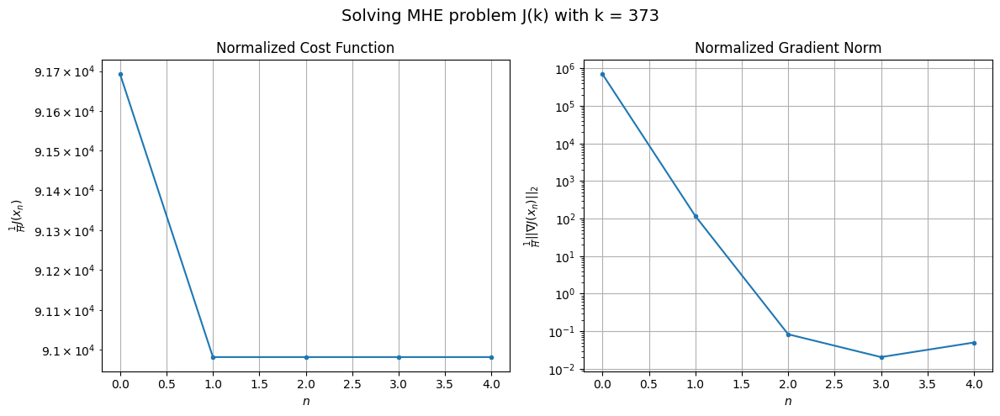

Windows:  93%|█████████▎| 275/296 [1:16:13<05:08, 14.69s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 9076622.535696
Gradient norm: 68273841.10076143
Global estimation error: 170.32743878585035
Initial conditions estimation errors: 85.24585461998575 m, 85.03360054702424 m, 85.20748158589363 m, 85.1673342610419 m
Position estimation errors: 90.83808398853249 m, 91.56851596900633 m, 91.05656805215027 m, 90.5878026762471 m

[Gauss-Newton] Iteration 1
Cost function: 9006281.047017328 (-0.77%)
Gradient norm: 11686.961830431621 (-99.98%)
Global estimation error: 187.83019271773372 (10.28%)
Initial conditions estimation errors: 93.96665507279563 m, 93.79255877415928 m, 93.91496311728724 m, 93.98562652821802 m
Position estimation errors: 84.7264535365268 m, 85.4721292016352 m, 84.95930249158742 m, 84.33027654423522 m

[Gauss-Newton] Iteration 2
Cost function: 9006281.046625981 (-0.00%)
Gradient norm: 2.0273303239483416 (-99.98%)
Global estimation error: 187.83009968392105 (-0.00%)
Initial conditions estimation errors: 93.9666672576968

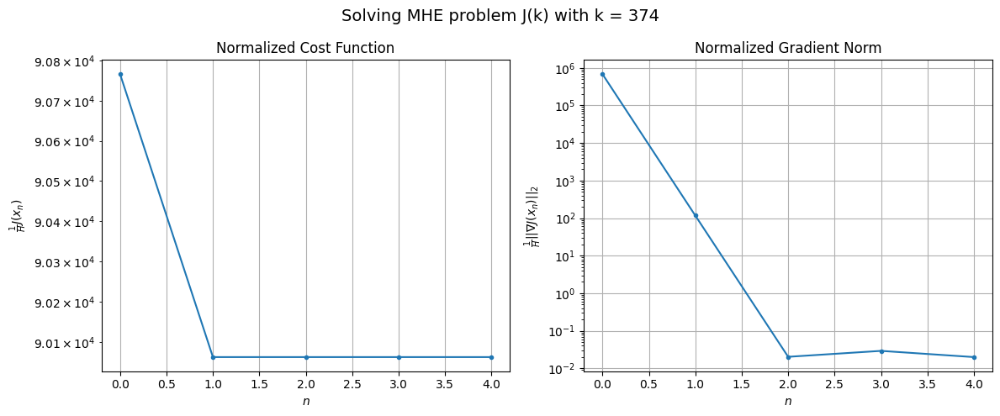

Windows:  93%|█████████▎| 276/296 [1:16:25<04:35, 13.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8956451.737745887
Gradient norm: 66756663.24699692
Global estimation error: 171.2764247080708
Initial conditions estimation errors: 85.71564015466137 m, 85.50586355151736 m, 85.61885874737217 m, 85.71182964093883 m
Position estimation errors: 88.48352623117488 m, 89.25794931652713 m, 88.8147572794368 m, 88.17179589133345 m

[Gauss-Newton] Iteration 1
Cost function: 8886966.168735085 (-0.78%)
Gradient norm: 11608.314956933913 (-99.98%)
Global estimation error: 188.80461073439477 (10.23%)
Initial conditions estimation errors: 94.4008695053823 m, 94.37195323528191 m, 94.31836891260794 m, 94.51742777392306 m
Position estimation errors: 82.4501920851309 m, 82.95590152338038 m, 82.70776868432927 m, 81.86214521168036 m

[Gauss-Newton] Iteration 2
Cost function: 8886966.168662628 (-0.00%)
Gradient norm: 2.7884915736527236 (-99.98%)
Global estimation error: 188.80453328376024 (-0.00%)
Initial conditions estimation errors: 94.4008824161

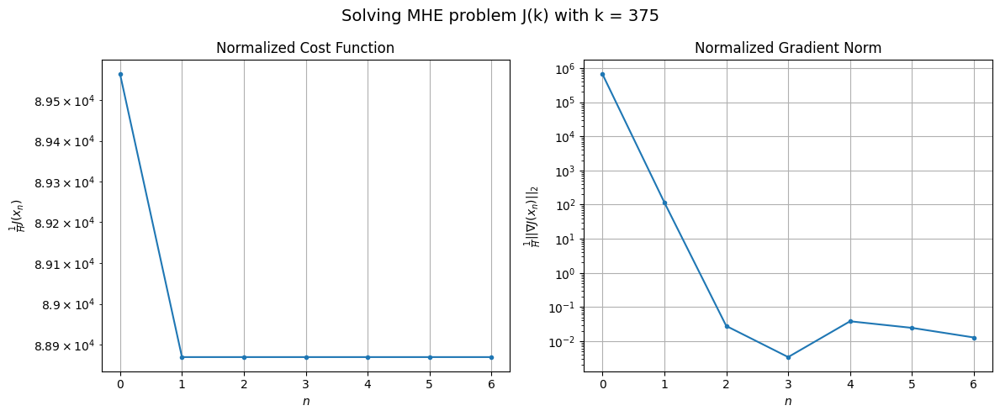

Windows:  94%|█████████▎| 277/296 [1:16:40<04:31, 14.30s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8810578.045144495
Gradient norm: 64207640.09780228
Global estimation error: 171.62070842437632
Initial conditions estimation errors: 85.83095608570937 m, 85.77452121542392 m, 85.70429664974239 m, 85.93096735736047 m
Position estimation errors: 86.00245187213817 m, 86.54254800140842 m, 86.35801922565975 m, 85.5078485562392 m

[Gauss-Newton] Iteration 1
Cost function: 8742506.700876059 (-0.77%)
Gradient norm: 11457.173404801935 (-99.98%)
Global estimation error: 188.9140256832881 (10.08%)
Initial conditions estimation errors: 94.44970427792664 m, 94.41915761860461 m, 94.36908142942181 m, 94.5894492063394 m
Position estimation errors: 80.08627569745113 m, 80.40736721624486 m, 80.2905535125934 m, 79.40885860799081 m

[Gauss-Newton] Iteration 2
Cost function: 8742506.700632019 (-0.00%)
Gradient norm: 3.3851286165585748 (-99.97%)
Global estimation error: 188.91384362693418 (-0.00%)
Initial conditions estimation errors: 94.4497178019

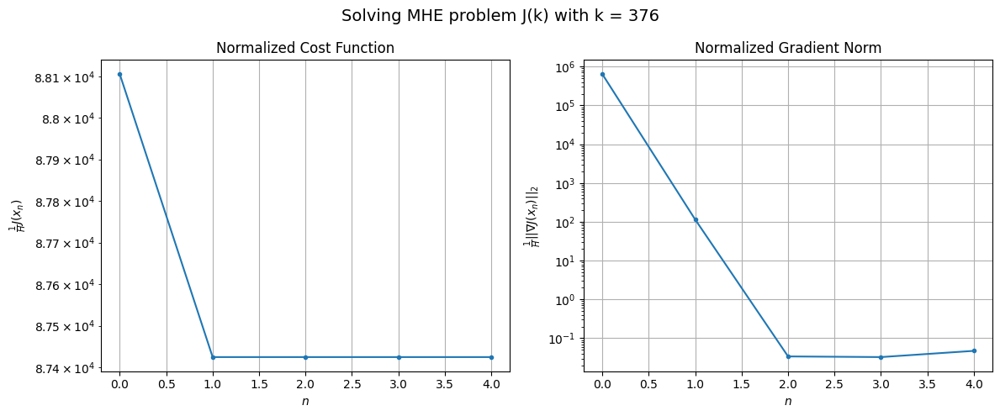

Windows:  94%|█████████▍| 278/296 [1:16:52<04:00, 13.36s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8643172.607160166
Gradient norm: 61378907.65938059
Global estimation error: 171.20266099701163
Initial conditions estimation errors: 85.61178393732152 m, 85.56684928020526 m, 85.48903649239074 m, 85.73692598455186 m
Position estimation errors: 83.40158670185946 m, 83.75069048216045 m, 83.7300890459848 m, 82.82723189191483 m

[Gauss-Newton] Iteration 1
Cost function: 8577022.428780673 (-0.77%)
Gradient norm: 11227.754620143985 (-99.98%)
Global estimation error: 188.05631305224708 (9.84%)
Initial conditions estimation errors: 94.12992123959216 m, 93.84841172877296 m, 93.98396545769876 m, 94.14947313116399 m
Position estimation errors: 77.63888517420989 m, 78.33996939493123 m, 77.72263079731779 m, 77.2212511748854 m

[Gauss-Newton] Iteration 2
Cost function: 8577022.428957107 (0.00%)
Gradient norm: 1.2990066384211232 (-99.99%)
Global estimation error: 188.05623033691438 (-0.00%)
Initial conditions estimation errors: 94.1299351759

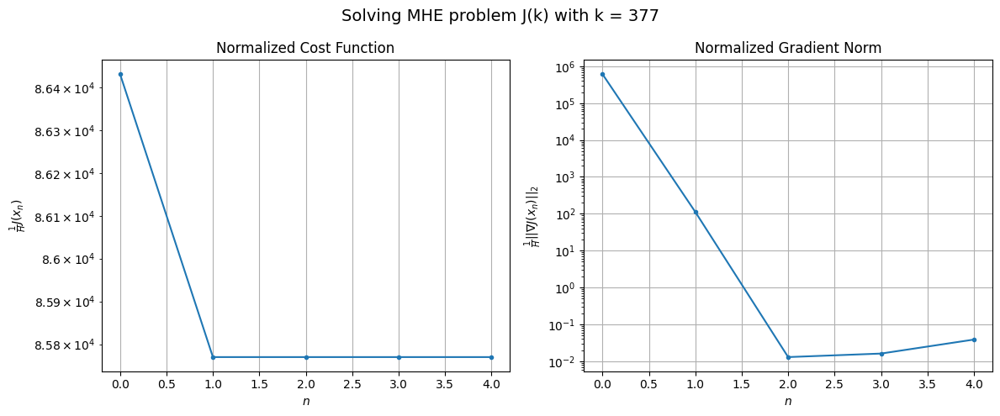

Windows:  94%|█████████▍| 279/296 [1:17:03<03:37, 12.77s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8458688.5348502
Gradient norm: 58105468.45594745
Global estimation error: 169.99961828316185
Initial conditions estimation errors: 85.11733465228292 m, 84.82303136958853 m, 84.94285332867963 m, 85.11510229702752 m
Position estimation errors: 80.66497460582039 m, 81.38065835812986 m, 80.86133808434715 m, 80.34740994526788 m

[Gauss-Newton] Iteration 1
Cost function: 8394898.982411873 (-0.75%)
Gradient norm: 10902.056183569724 (-99.98%)
Global estimation error: 186.7751532649337 (9.87%)
Initial conditions estimation errors: 93.5017183664459 m, 93.28390869449413 m, 93.3530728449153 m, 93.41091757443715 m
Position estimation errors: 75.08989797125429 m, 75.64961157909957 m, 75.16552022894328 m, 74.92638644866591 m

[Gauss-Newton] Iteration 2
Cost function: 8394898.98191744 (-0.00%)
Gradient norm: 5.496823499238415 (-99.95%)
Global estimation error: 186.7750880046896 (-0.00%)
Initial conditions estimation errors: 93.50173256495019 

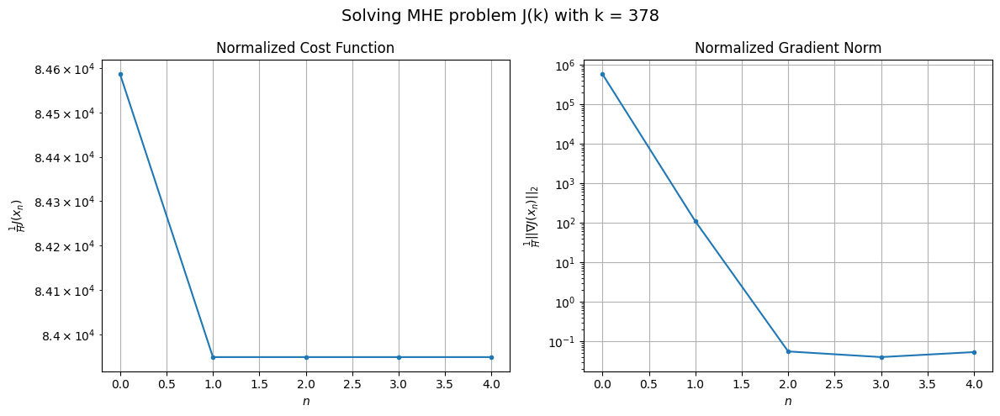

Windows:  95%|█████████▍| 280/296 [1:17:14<03:16, 12.30s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8258526.078602382
Gradient norm: 54661814.61212034
Global estimation error: 168.54268553185312
Initial conditions estimation errors: 84.39826835913328 m, 84.17476055847104 m, 84.2216069433434 m, 84.29000421318129 m
Position estimation errors: 77.78559873848242 m, 78.35131050522679 m, 77.98370702983775 m, 77.6902156991271 m

[Gauss-Newton] Iteration 1
Cost function: 8197370.118096504 (-0.74%)
Gradient norm: 10541.850214840819 (-99.98%)
Global estimation error: 185.0495529922617 (9.79%)
Initial conditions estimation errors: 92.626363812427 m, 92.48002716316873 m, 92.4291937075088 m, 92.56283489736784 m
Position estimation errors: 72.43003266803501 m, 72.89878768197839 m, 72.60677309607489 m, 72.30929421252276 m

[Gauss-Newton] Iteration 2
Cost function: 8197370.118562794 (0.00%)
Gradient norm: 1.2982508859541133 (-99.99%)
Global estimation error: 185.04961564163816 (0.00%)
Initial conditions estimation errors: 92.62637809607794 

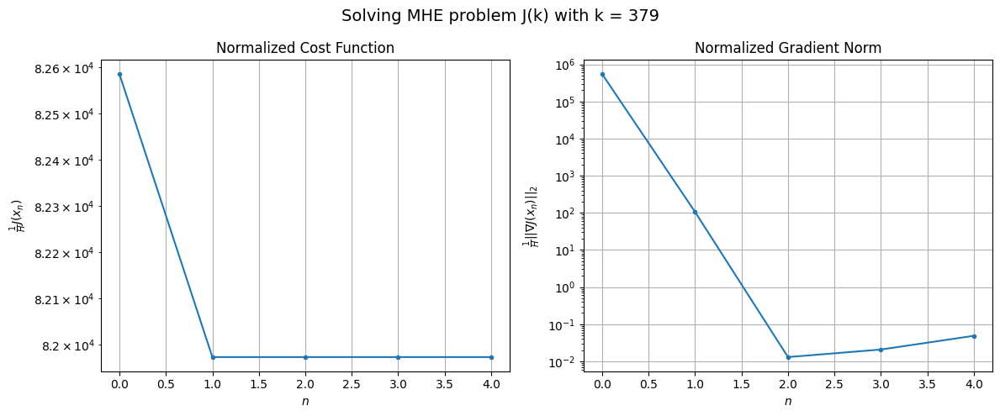

Windows:  95%|█████████▍| 281/296 [1:17:25<03:00, 12.01s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 8046572.316379157
Gradient norm: 50966028.50806616
Global estimation error: 166.72053122278112
Initial conditions estimation errors: 83.47355387799932 m, 83.32374274146761 m, 83.25028691406467 m, 83.39274033637138 m
Position estimation errors: 74.78055759110127 m, 75.24135295834105 m, 75.06401138138948 m, 74.73142696002145 m

[Gauss-Newton] Iteration 1
Cost function: 7988552.577857248 (-0.72%)
Gradient norm: 10038.320931371882 (-99.98%)
Global estimation error: 182.67712366663636 (9.57%)
Initial conditions estimation errors: 91.50235119898105 m, 91.23437696967285 m, 91.24388292704626 m, 91.37279917504566 m
Position estimation errors: 69.68346587856186 m, 71.09930298442228 m, 70.24099824013057 m, 70.243151351049 m

[Gauss-Newton] Iteration 2
Cost function: 7988552.577645851 (-0.00%)
Gradient norm: 4.891187830510807 (-99.95%)
Global estimation error: 182.6772845094862 (0.00%)
Initial conditions estimation errors: 91.502365371459

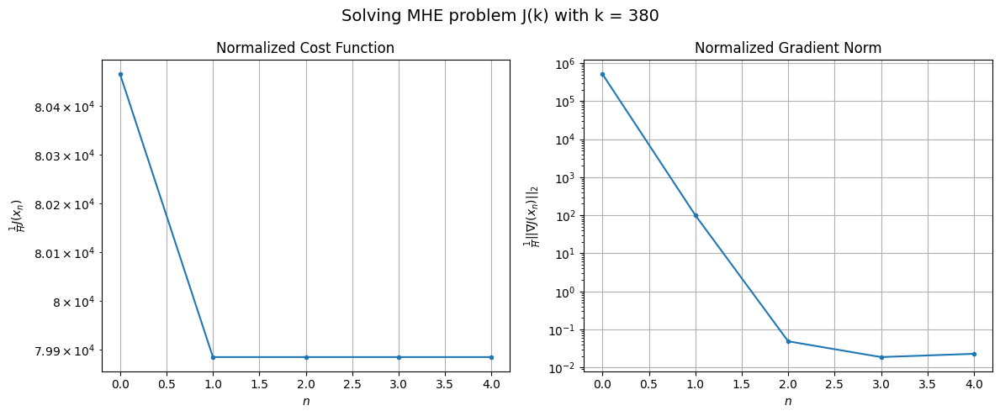

Windows:  95%|█████████▌| 282/296 [1:17:37<02:45, 11.84s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 7827477.591170853
Gradient norm: 46378891.7574529
Global estimation error: 164.29507692448982
Initial conditions estimation errors: 82.32540483146114 m, 82.04898916935727 m, 82.04216741926471 m, 82.17268004510976 m
Position estimation errors: 71.69385311818347 m, 73.08275363337974 m, 72.33524423467343 m, 72.32510766522074 m

[Gauss-Newton] Iteration 1
Cost function: 7772902.502679123 (-0.70%)
Gradient norm: 9594.977612149232 (-99.98%)
Global estimation error: 179.9685567327051 (9.54%)
Initial conditions estimation errors: 90.13248421006982 m, 89.94920550549939 m, 89.83400766547959 m, 90.02056670089581 m
Position estimation errors: 66.89664396736107 m, 68.26619373310113 m, 68.10453160564845 m, 67.85971577700738 m

[Gauss-Newton] Iteration 2
Cost function: 7772902.501168137 (-0.00%)
Gradient norm: 1.4705951340127073 (-99.98%)
Global estimation error: 179.96856811443322 (0.00%)
Initial conditions estimation errors: 90.13249812869

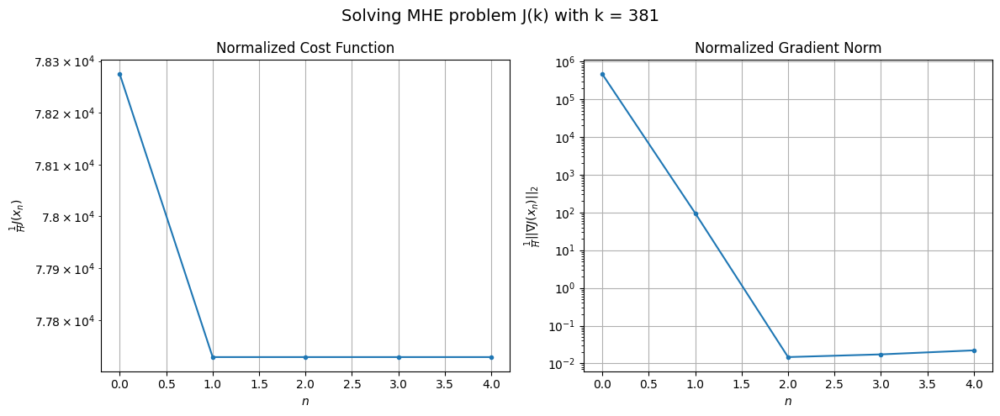

Windows:  96%|█████████▌| 283/296 [1:17:48<02:32, 11.76s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 7602135.547885639
Gradient norm: 41943226.35890805
Global estimation error: 161.587841308915
Initial conditions estimation errors: 80.95287128604322 m, 80.76292345474896 m, 80.63385954963292 m, 80.82509530348398 m
Position estimation errors: 68.58427253172937 m, 69.95461789965917 m, 69.86167813283899 m, 69.6129218399462 m

[Gauss-Newton] Iteration 1
Cost function: 7551039.894401365 (-0.67%)
Gradient norm: 9085.22943991965 (-99.98%)
Global estimation error: 176.754553233113 (9.39%)
Initial conditions estimation errors: 88.52606140963222 m, 88.3314388205249 m, 88.21514672433052 m, 88.4355513317507 m
Position estimation errors: 64.11081657760477 m, 65.78493775550346 m, 65.72473312384098 m, 65.17706865828103 m

[Gauss-Newton] Iteration 2
Cost function: 7551039.894659448 (0.00%)
Gradient norm: 0.42931701031695463 (-100.00%)
Global estimation error: 176.75462638853026 (0.00%)
Initial conditions estimation errors: 88.52607489691155 m

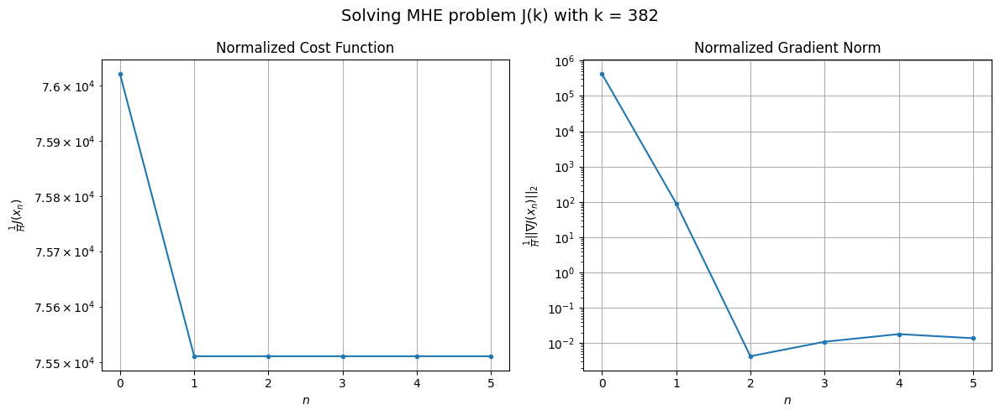

Windows:  96%|█████████▌| 284/296 [1:18:02<02:27, 12.26s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 7375202.507073618
Gradient norm: 36681038.80835572
Global estimation error: 158.34668679154007
Initial conditions estimation errors: 79.32449854677728 m, 79.13570942655423 m, 79.00100460097539 m, 79.23116756196663 m
Position estimation errors: 65.50772753391651 m, 67.1681281579344 m, 67.18875150983851 m, 66.64105091648958 m

[Gauss-Newton] Iteration 1
Cost function: 7328035.903036043 (-0.64%)
Gradient norm: 8493.308704382387 (-99.98%)
Global estimation error: 172.93604604245292 (9.21%)
Initial conditions estimation errors: 86.62023493922445 m, 86.40470794414246 m, 86.28029136178722 m, 86.5658149042373 m
Position estimation errors: 61.4002253102207 m, 63.08591244281255 m, 63.13990653095117 m, 62.45085461177175 m

[Gauss-Newton] Iteration 2
Cost function: 7328035.902284178 (-0.00%)
Gradient norm: 4.620095041475006 (-99.95%)
Global estimation error: 172.9361197536376 (0.00%)
Initial conditions estimation errors: 86.62024786185842

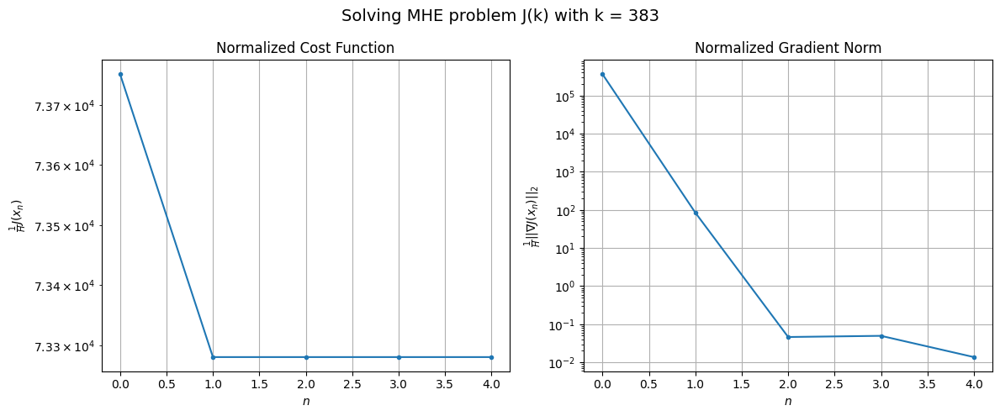

Windows:  96%|█████████▋| 285/296 [1:18:13<02:12, 12.06s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 7148152.292355189
Gradient norm: 32019093.9459688
Global estimation error: 154.38420494218886
Initial conditions estimation errors: 77.33948234997841 m, 77.14025655081213 m, 76.99658428995826 m, 77.29095349735239 m
Position estimation errors: 62.55058986174301 m, 64.21613193048692 m, 64.35348223015426 m, 63.68074694750399 m

[Gauss-Newton] Iteration 1
Cost function: 7104338.240358408 (-0.61%)
Gradient norm: 7981.997094195504 (-99.98%)
Global estimation error: 168.5488608924165 (9.17%)
Initial conditions estimation errors: 84.3909141699098 m, 84.24880957255178 m, 84.03545400108696 m, 84.42133528400883 m
Position estimation errors: 58.80793491847155 m, 60.24041976203952 m, 60.488264031031875 m, 59.62872018194271 m

[Gauss-Newton] Iteration 2
Cost function: 7104338.240490248 (0.00%)
Gradient norm: 0.43664535274543936 (-99.99%)
Global estimation error: 168.54895499483627 (0.00%)
Initial conditions estimation errors: 84.39092645839

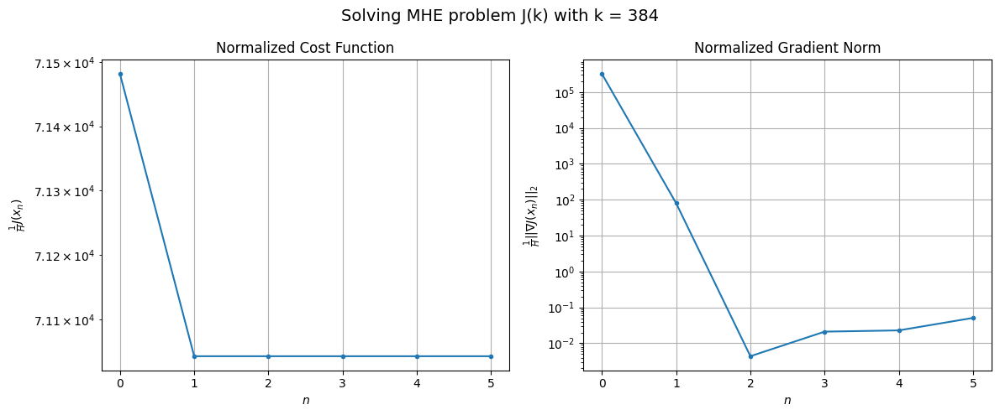

Windows:  97%|█████████▋| 286/296 [1:18:27<02:04, 12.43s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6926710.720241306
Gradient norm: 26498127.10128765
Global estimation error: 149.80237025537855
Initial conditions estimation errors: 75.01174243434693 m, 74.88208045328277 m, 74.66435575178105 m, 75.04527097330703 m
Position estimation errors: 59.749690664554215 m, 61.18037193493751 m, 61.486025978593915 m, 60.67459656939996 m

[Gauss-Newton] Iteration 1
Cost function: 6886880.336169154 (-0.58%)
Gradient norm: 7350.924254237945 (-99.97%)
Global estimation error: 163.28685252098887 (9.00%)
Initial conditions estimation errors: 81.75021002502194 m, 81.61651456026897 m, 81.40616550225815 m, 81.79956046228813 m
Position estimation errors: 56.4142630431767 m, 58.13992906422995 m, 58.16075848164906 m, 57.54652157694843 m

[Gauss-Newton] Iteration 2
Cost function: 6886880.335205334 (-0.00%)
Gradient norm: 5.058853194529009 (-99.93%)
Global estimation error: 163.28682155251127 (-0.00%)
Initial conditions estimation errors: 81.75022154

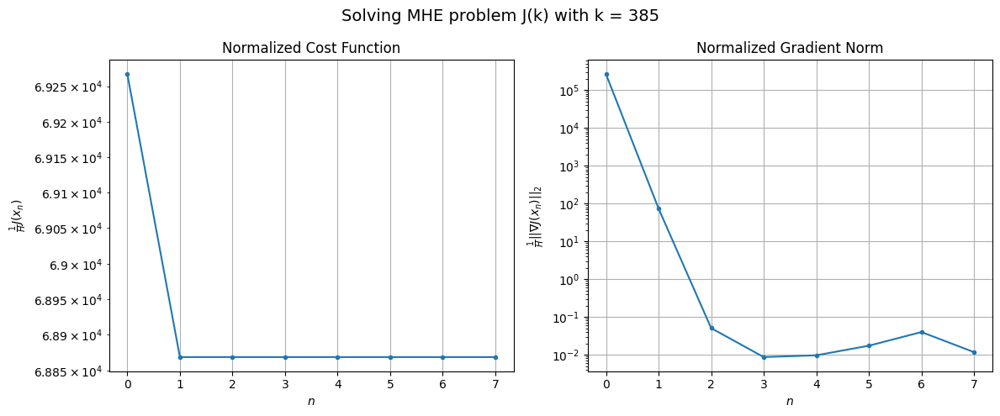

Windows:  97%|█████████▋| 287/296 [1:18:45<02:08, 14.29s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6714741.596393511
Gradient norm: 20671649.08631665
Global estimation error: 144.49347318523027
Initial conditions estimation errors: 72.34365452189124 m, 72.22552532422205 m, 72.01807894580503 m, 72.39838371887308 m
Position estimation errors: 57.18988348695465 m, 58.92195405592282 m, 59.004917134516674 m, 58.43987656007126 m

[Gauss-Newton] Iteration 1
Cost function: 6679042.550985138 (-0.53%)
Gradient norm: 6695.118544910243 (-99.97%)
Global estimation error: 157.30823099346148 (8.87%)
Initial conditions estimation errors: 78.73450438567863 m, 78.70293546263757 m, 78.43230334319195 m, 78.74559250590706 m
Position estimation errors: 54.279844768052094 m, 55.88082328494824 m, 56.182513774994746 m, 55.12048966731373 m

[Gauss-Newton] Iteration 2
Cost function: 6679042.550602464 (-0.00%)
Gradient norm: 2.2721454153406397 (-99.97%)
Global estimation error: 157.3083392660171 (0.00%)
Initial conditions estimation errors: 78.7345150

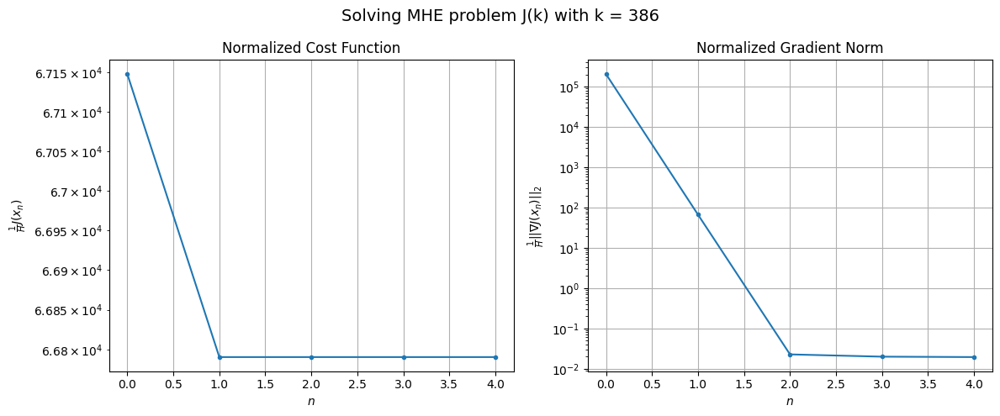

Windows:  97%|█████████▋| 288/296 [1:18:57<01:47, 13.44s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6520449.797442816
Gradient norm: 14967187.517718013
Global estimation error: 138.65854311536322
Initial conditions estimation errors: 69.39505742335831 m, 69.37919000130911 m, 69.12248687256994 m, 69.41920520605855 m
Position estimation errors: 54.96110227597167 m, 56.56025086754249 m, 56.9378582893258 m, 55.88759797150294 m

[Gauss-Newton] Iteration 1
Cost function: 6488859.005799804 (-0.48%)
Gradient norm: 6005.651048177919 (-99.96%)
Global estimation error: 150.56554833415726 (8.59%)
Initial conditions estimation errors: 75.40480126254556 m, 75.26830688011249 m, 75.07980204702442 m, 75.37703467053358 m
Position estimation errors: 52.46565520824424 m, 54.09843188090084 m, 54.226472243990976 m, 53.3307557842478 m

[Gauss-Newton] Iteration 2
Cost function: 6488859.005781056 (-0.00%)
Gradient norm: 0.8137905665758143 (-99.99%)
Global estimation error: 150.56556134766134 (0.00%)
Initial conditions estimation errors: 75.404810977

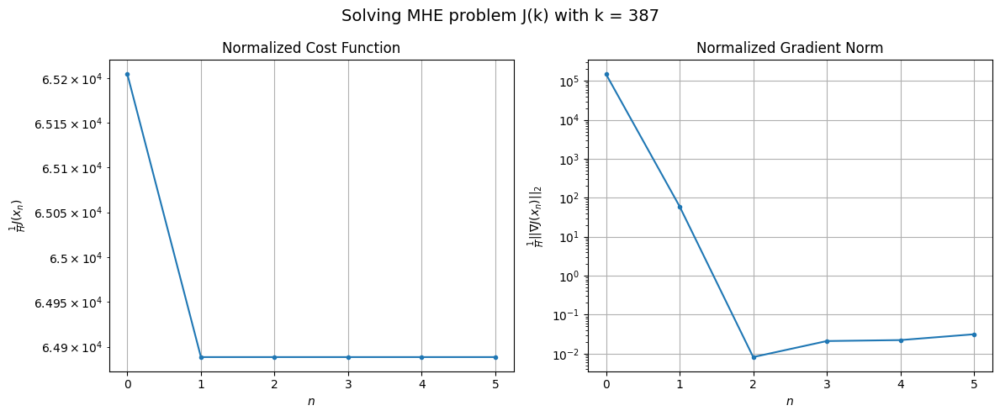

Windows:  98%|█████████▊| 289/296 [1:19:11<01:34, 13.56s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6346688.646024763
Gradient norm: 9488264.477270734
Global estimation error: 132.14279996115243
Initial conditions estimation errors: 66.17133631253803 m, 66.06460710136895 m, 65.88202623958901 m, 66.16646191900193 m
Position estimation errors: 53.14095872967332 m, 54.74522352218214 m, 54.979611166104185 m, 54.078326305412745 m

[Gauss-Newton] Iteration 1
Cost function: 6318906.397398651 (-0.44%)
Gradient norm: 5336.314172289167 (-99.94%)
Global estimation error: 143.3587400087007 (8.49%)
Initial conditions estimation errors: 71.79825174504175 m, 71.63636674624509 m, 71.44193288848788 m, 71.83950589032713 m
Position estimation errors: 51.039166467433546 m, 52.23670386493675 m, 52.562082414010504 m, 51.99842387089633 m

[Gauss-Newton] Iteration 2
Cost function: 6318906.397614281 (0.00%)
Gradient norm: 2.4318227806537775 (-99.95%)
Global estimation error: 143.3587372328311 (-0.00%)
Initial conditions estimation errors: 71.7982605

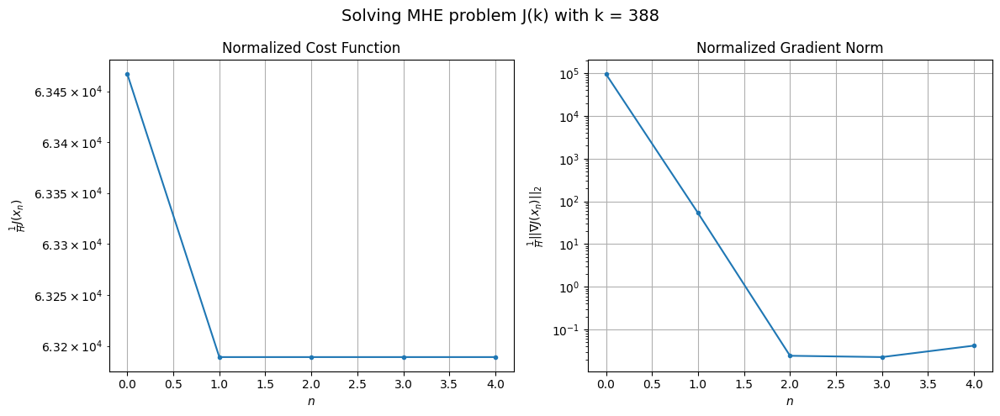

Windows:  98%|█████████▊| 290/296 [1:19:22<01:18, 13.01s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6195517.724245262
Gradient norm: 3807238.540097461
Global estimation error: 125.16018240207572
Initial conditions estimation errors: 62.67586755852026 m, 62.54145489239286 m, 62.36029151569479 m, 62.741292150313164 m
Position estimation errors: 51.759674261616674 m, 52.92624806614266 m, 53.350629752516866 m, 52.81408498565536 m

[Gauss-Newton] Iteration 1
Cost function: 6171376.203357601 (-0.39%)
Gradient norm: 4685.840547901625 (-99.88%)
Global estimation error: 135.62927685424276 (8.36%)
Initial conditions estimation errors: 67.90506877756282 m, 67.71652627315956 m, 67.5974619440398 m, 68.03788541716457 m
Position estimation errors: 50.027491812167895 m, 51.33662350194785 m, 52.04297286173527 m, 51.85890366756057 m

[Gauss-Newton] Iteration 2
Cost function: 6171376.203472282 (0.00%)
Gradient norm: 5.160775781777997 (-99.89%)
Global estimation error: 135.62926773924542 (-0.00%)
Initial conditions estimation errors: 67.9050766

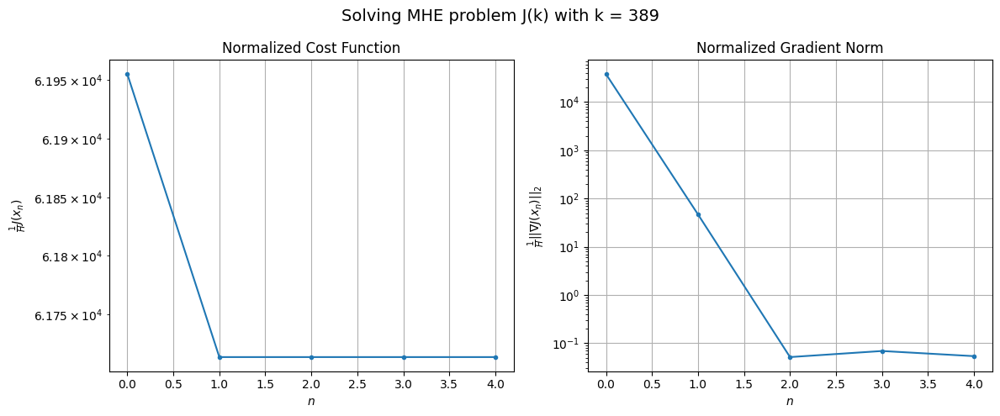

Windows:  98%|█████████▊| 291/296 [1:19:34<01:02, 12.50s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 6070570.241944292
Gradient norm: 3355730.235936638
Global estimation error: 117.73882115495383
Initial conditions estimation errors: 58.92394771444308 m, 58.77146499244068 m, 58.67736637151589 m, 59.103168811146915 m
Position estimation errors: 50.79597715857155 m, 52.06588708573854 m, 52.87202457785625 m, 52.73634248800497 m

[Gauss-Newton] Iteration 1
Cost function: 6049952.172288599 (-0.34%)
Gradient norm: 4042.432067653061 (-99.88%)
Global estimation error: 127.40580211957004 (8.21%)
Initial conditions estimation errors: 63.726036348215075 m, 63.67278776659468 m, 63.47199389061124 m, 63.93912625823446 m
Position estimation errors: 49.392227088376956 m, 51.2939571710161 m, 51.35958591083877 m, 51.748941481386176 m

[Gauss-Newton] Iteration 2
Cost function: 6049952.172366689 (0.00%)
Gradient norm: 1.5999886423534289 (-99.96%)
Global estimation error: 127.40580725874892 (0.00%)
Initial conditions estimation errors: 63.7260432

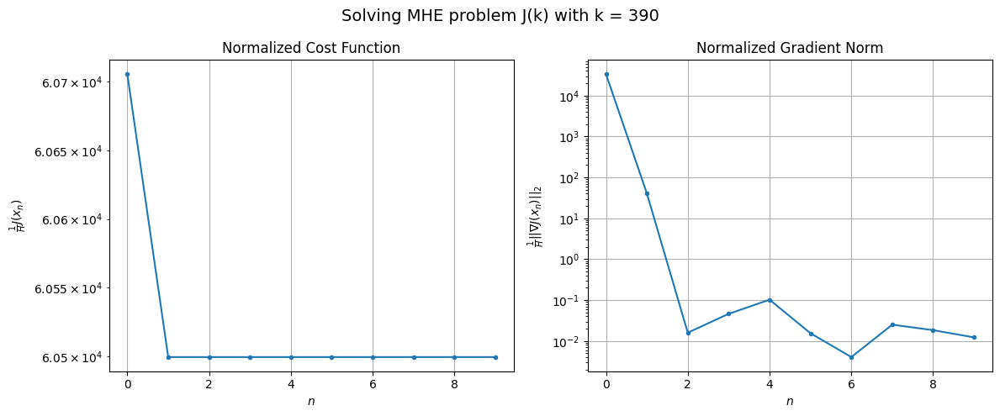

Windows:  99%|█████████▊| 292/296 [1:19:55<01:00, 15.20s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5973612.935827781
Gradient norm: 9735048.508866621
Global estimation error: 109.90071773419155
Initial conditions estimation errors: 54.92299881727084 m, 54.927225523062084 m, 54.739259327557754 m, 55.210070939541 m
Position estimation errors: 50.22976269101123 m, 52.078791559208916 m, 52.25276980461909 m, 52.68659590902345 m

[Gauss-Newton] Iteration 1
Cost function: 5956453.520554834 (-0.29%)
Gradient norm: 3393.9809537941383 (-99.97%)
Global estimation error: 118.45412830280054 (7.78%)
Initial conditions estimation errors: 59.25668808426038 m, 59.177551472204236 m, 59.04686992998947 m, 59.42568352381732 m
Position estimation errors: 49.1082501950521 m, 50.60326137775935 m, 50.669632222881496 m, 51.13518326555836 m

[Gauss-Newton] Iteration 2
Cost function: 5956453.5202577785 (-0.00%)
Gradient norm: 0.8038925263105796 (-99.98%)
Global estimation error: 118.4541051749583 (-0.00%)
Initial conditions estimation errors: 59.25669

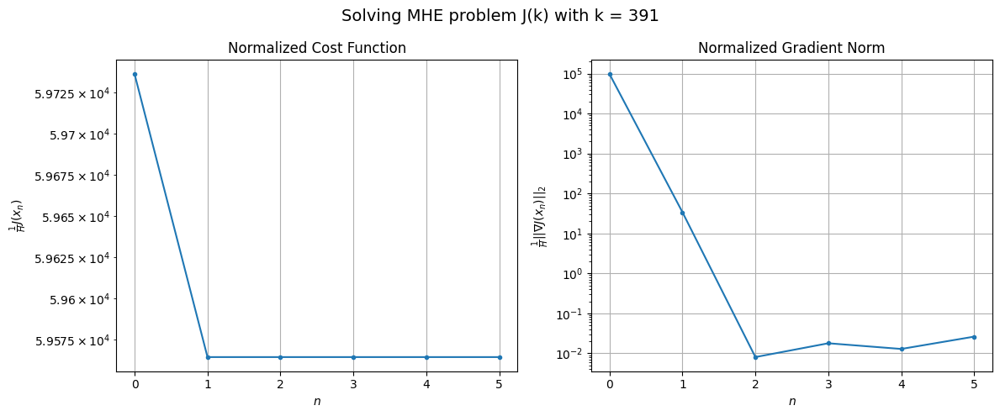

Windows:  99%|█████████▉| 293/296 [1:20:09<00:44, 14.78s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5905277.026178339
Gradient norm: 17160831.79455221
Global estimation error: 101.3024672450384
Initial conditions estimation errors: 50.62763562006968 m, 50.60994267641344 m, 50.4816810580994 m, 50.88392735619207 m
Position estimation errors: 50.12090428627461 m, 51.52701340182108 m, 51.757054014322 m, 52.20377032490768 m

[Gauss-Newton] Iteration 1
Cost function: 5891050.905524307 (-0.24%)
Gradient norm: 2808.458274360986 (-99.98%)
Global estimation error: 109.01872610084074 (7.62%)
Initial conditions estimation errors: 54.50433080364854 m, 54.58694698006301 m, 54.27201157581867 m, 54.672465007776474 m
Position estimation errors: 49.205097632815864 m, 51.30970820782223 m, 50.287229122580506 m, 51.19739662227569 m

[Gauss-Newton] Iteration 2
Cost function: 5891050.90565542 (0.00%)
Gradient norm: 1.2562561984357892 (-99.96%)
Global estimation error: 109.01871092735156 (-0.00%)
Initial conditions estimation errors: 54.50433592231

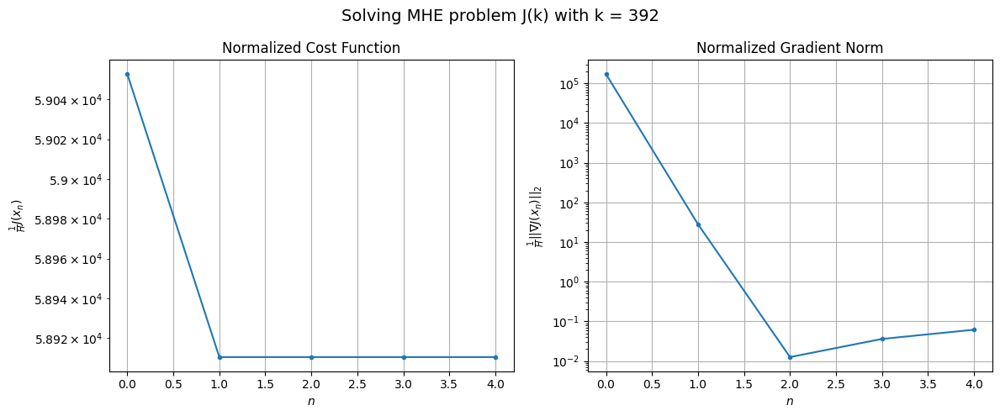

Windows:  99%|█████████▉| 294/296 [1:20:20<00:27, 13.72s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5870798.349875183
Gradient norm: 24283966.163642894
Global estimation error: 92.22113623611723
Initial conditions estimation errors: 46.04028363841881 m, 46.21791683433291 m, 45.86603154915817 m, 46.315782748092545 m
Position estimation errors: 50.56954601955606 m, 52.56210392350561 m, 51.72183030416966 m, 52.56874518621171 m

[Gauss-Newton] Iteration 1
Cost function: 5859274.410738637 (-0.20%)
Gradient norm: 2218.5577504885637 (-99.99%)
Global estimation error: 98.84497719245154 (7.18%)
Initial conditions estimation errors: 49.410768642504415 m, 49.470210611262665 m, 49.20800563836764 m, 49.599219104160696 m
Position estimation errors: 49.76065680223331 m, 50.99146181953915 m, 50.65820572458745 m, 51.410336782241785 m

[Gauss-Newton] Iteration 2
Cost function: 5859274.410626436 (-0.00%)
Gradient norm: 1.91364461281602 (-99.91%)
Global estimation error: 98.84499473133806 (0.00%)
Initial conditions estimation errors: 49.4107729

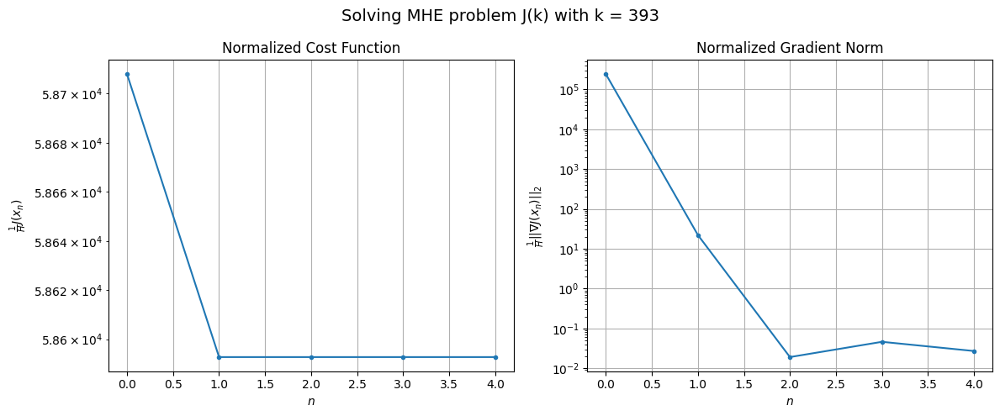

Windows: 100%|█████████▉| 295/296 [1:20:31<00:12, 12.96s/it]

[Gauss-Newton] Before applying the algorithm
Cost function: 5870428.626508884
Gradient norm: 31674590.814586982
Global estimation error: 82.50197080136023
Initial conditions estimation errors: 41.180554928572484 m, 41.30733135745847 m, 41.0392498306986 m, 41.474522862043855 m
Position estimation errors: 51.6608192248382 m, 52.767299821377826 m, 52.63324683011149 m, 53.279186568333 m

[Gauss-Newton] Iteration 1
Cost function: 5861105.737351907 (-0.16%)
Gradient norm: 1700.393899216571 (-99.99%)
Global estimation error: 87.98689237345047 (6.65%)
Initial conditions estimation errors: 44.023999361338966 m, 44.06739067081183 m, 43.82325411990744 m, 44.05769100854068 m
Position estimation errors: 50.846434522148634 m, 51.93606523971954 m, 51.70958772184569 m, 52.0315506433777 m

[Gauss-Newton] Iteration 2
Cost function: 5861105.737441171 (0.00%)
Gradient norm: 1.910160454547365 (-99.89%)
Global estimation error: 87.98690940623675 (0.00%)
Initial conditions estimation errors: 44.0240029583997

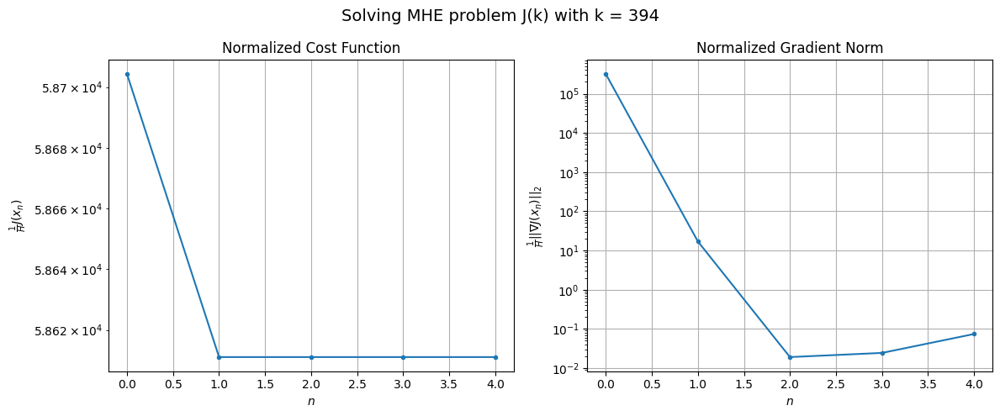

This Monte Carlo run RMSE for 296 timestamps:
RMSE_1 = 96.87197308620264
RMSE_2 = 96.72920596722903
RMSE_3 = 96.89417757988285
RMSE_4 = 96.56343566832557
CentralizedNewton applied to J(H - 1) converged with [] iterations.
CentralizedNewton applied to J(k) with k = H, ..., K - 1 converged with nan iterations on average.


/usr/local/lib/python3.10/dist-packages/numpy/core/fromnumeric.py:3504: RuntimeWarning: Mean of empty slice.
  return _methods._mean(a, axis=axis, dtype=dtype,
/usr/local/lib/python3.10/dist-packages/numpy/core/_methods.py:129: RuntimeWarning: invalid value encountered in scalar divide
  ret = ret.dtype.type(ret / rcount)


In [7]:
first_round_stop_iteration = []
K_minus_H_next_rounds_stop_iteration = []

# Cold-start
x_init = X_initial + np.random.multivariate_normal(np.zeros(n), P_0).reshape((n, 1))

# Apply the algorithm
X_est = np.zeros((n, 1, K))
for k in tqdm(range(H - 1, K), desc="Windows", leave=False):
    centralized_newton.cost_values, centralized_newton.gradient_norm_values = [], []
    x_init, x_est = centralized_newton.solve_MHE_problem(k, dt, Y, x_init, X_true[:, :, k - H + 1],  X_true[:, :, k])
    X_est[:, :, k] = x_est
    
    plots(k, centralized_newton)

    # Warm-start
    x_init = dyn.f(dt, x_init)

# After each Monte Carlo Run compute the RMSE_m for each K - H + 1 timestamps
position_estimation_error_1, position_estimation_error_2, position_estimation_error_3, position_estimation_error_4 = [], [], [], []
for k in range(H - 1, K):
    position_estimation_error_1.append(np.linalg.norm(X_est[:n_p, :, k] - X_true[:n_p, :, k]))
    position_estimation_error_2.append(np.linalg.norm(X_est[n_x:n_x + n_p, :, k] - X_true[n_x:n_x + n_p, :, k]))
    position_estimation_error_3.append(np.linalg.norm(X_est[2*n_x:2*n_x + n_p, :, k] - X_true[2*n_x:2*n_x + n_p, :, k]))
    position_estimation_error_4.append(np.linalg.norm(X_est[3*n_x:3*n_x + n_p, :, k] - X_true[3*n_x:3*n_x + n_p, :, k]))
rmse_1 = np.sqrt(np.mean(np.array(position_estimation_error_1) ** 2))
rmse_2 = np.sqrt(np.mean(np.array(position_estimation_error_2) ** 2))
rmse_3 = np.sqrt(np.mean(np.array(position_estimation_error_3) ** 2))
rmse_4 = np.sqrt(np.mean(np.array(position_estimation_error_4) ** 2))
print(f'This Monte Carlo run RMSE for {K - H + 1} timestamps:')
print(f'RMSE_1 = {np.mean(rmse_1)}\nRMSE_2 = {np.mean(rmse_2)}\nRMSE_3 = {np.mean(rmse_3)}\nRMSE_4 = {np.mean(rmse_4)}')
print(f'CentralizedNewton applied to J(H - 1) converged with {first_round_stop_iteration} iterations.')
print(f'CentralizedNewton applied to J(k) with k = H, ..., K - 1 converged with {np.mean(K_minus_H_next_rounds_stop_iteration)} iterations on average.')

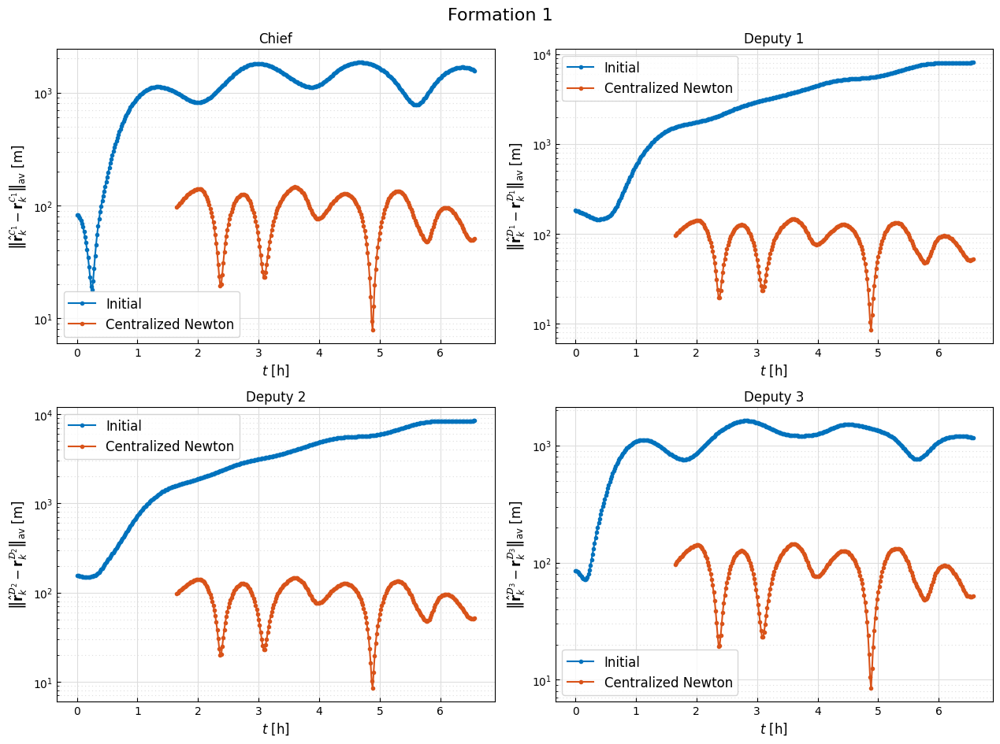

In [8]:
# MATLAB default color cycle
matlab_default_colors = [
    [0, 0.4470, 0.7410],  # blue
    [0.8500, 0.3250, 0.0980],  # orange
    [0.9290, 0.6940, 0.1250],  # yellow
    [0.4940, 0.1840, 0.5560],  # purple
    [0.4660, 0.6740, 0.1880],  # green
    [0.3010, 0.7450, 0.9330],  # light blue
    [0.6350, 0.0780, 0.1840],  # red
]
# Set the color cycle in Matplotlib to match MATLAB's default
plt.rcParams["axes.prop_cycle"] = plt.cycler(color=matlab_default_colors)

time = np.arange(0, K) / dt
algorithm = "Centralized Newton"

# Plot positions based on screen size
fig_width = 2 * 6.4  # in inchesa
fig_height = 2 * 4.8  # in inches

# Create a 2 by 2 figure
fig, axs = plt.subplots(2, 2, figsize=(fig_width, fig_height))

# Plot 1: Chief
axs[0, 0].plot(time, position_estimation_error_1_initial, ".-", label="Initial")
axs[0, 0].plot(time[H - 1:], position_estimation_error_1, ".-", label=algorithm)
axs[0, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 0].grid(True, which="both")
axs[0, 0].set_yscale("log")
axs[0, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{C}_1} - \\mathbf{r}_k^{\\mathcal{C}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[0, 0].set_ylim([1e-2, 1e3])
axs[0, 0].tick_params(axis="both", which="both", direction="in")
axs[0, 0].legend(fontsize=12)
axs[0, 0].set_title("Chief")

# Plot 2: Deputy 1
axs[0, 1].plot(time, position_estimation_error_2_initial, ".-", label="Initial")
axs[0, 1].plot(time[H - 1:], position_estimation_error_2, ".-", label=algorithm)
axs[0, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[0, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[0, 1].grid(True, which="both")
axs[0, 1].set_yscale("log")
axs[0, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[0, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_1} - \\mathbf{r}_k^{\\mathcal{D}_1}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[0, 1].set_ylim([1e-1, 1e3])
axs[0, 1].tick_params(axis="both", which="both", direction="in")
axs[0, 1].legend(fontsize=12)
axs[0, 1].set_title("Deputy 1")

# Plot 3: Deputy 2
axs[1, 0].plot(time, position_estimation_error_3_initial, ".-", label="Initial")
axs[1, 0].plot(time[H - 1:], position_estimation_error_3, ".-", label=algorithm)
axs[1, 0].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 0].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 0].grid(True, which="both")
axs[1, 0].set_yscale("log")
axs[1, 0].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 0].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_2} - \\mathbf{r}_k^{\\mathcal{D}_2}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[1, 0].set_ylim([1e-1, 1e3])
axs[1, 0].tick_params(axis="both", which="both", direction="in")
axs[1, 0].legend(fontsize=12)
axs[1, 0].set_title("Deputy 2")

# Plot 4: Deputy 3
axs[1, 1].plot(time, position_estimation_error_4_initial, ".-", label="Initial")
axs[1, 1].plot(time[H - 1:], position_estimation_error_4, ".-", label=algorithm)
axs[1, 1].grid(which="major", color="#DDDDDD", zorder=1)
axs[1, 1].grid(which="minor", color="#DDDDDD", linestyle=(0, (1, 3)), zorder=2)
axs[1, 1].grid(True, which="both")
axs[1, 1].set_yscale("log")
axs[1, 1].set_xlabel("$t$ [h]", fontsize=12)
axs[1, 1].set_ylabel(
    "$\\left\\|\\hat{\\mathbf{r}}_k^{\\mathcal{D}_3} - \\mathbf{r}_k^{\\mathcal{D}_3}\\right\\|_\\mathrm{av}$ [m]",
    fontsize=12,
)
# axs[1, 1].set_ylim([1e-1, 1e3])
axs[1, 1].tick_params(axis="both", which="both", direction="in")
axs[1, 1].legend(fontsize=12)
axs[1, 1].set_title("Deputy 3")

fig.suptitle(f"Formation {formation}", fontsize=16)
plt.tight_layout(rect=[0, 0, 1, 1])
plt.show()

In [9]:
import pickle
from datetime import datetime

# Fill the dictionary
data = {}
data["H"] = H
data["true"] = X_true
data[0] = X_est

# Save to pickle file
with open(f'gauss_newton_H{H}_form{formation}_{datetime.now().strftime("%Y%m%d_%H%M%S")}.pkl', "wb") as file:
    pickle.dump(data, file)